# The Housing Price Project

## Prelude:

House forms the most basic need for any human. The real estate market all over the world is considered to be the most lucrative and sustainable business. It is a huge market and contributes majorly to economy of any country. 
An US-based company "Surprise Housing" is planning to penetrate Australian market.
A new world strategy is to use data science for decision making even in this domain. The data science role in this field would be majorly to find the necessary variables impacting the sale price of the houses. 

## About the variables:
The independent variables:

Id - A unque identifier variable

MSSubClass -  A numeric categorical variable

MSZoning  - A categorical variable

LotFrontage  - A numeric categorical variable   

LotArea  - A continuous variable

Street - A categorical variable

Alley  - A categorical variable

LotShape - A categorical variable
    
LandContour  - A categorical variable

Utilities - A categorical variable

LotConfig   - A categorical variable

LandSlope - A categorical variable

Neighborhood - A categorical variable

Condition1  - A categorical variable

Condition2 - A categorical variable    

BldgType  - A categorical variable   
 
HouseStyle  - A categorical variable

OverallQual - A numeric categorical variable

OverallCond  - A numeric categorical variable

YearBuilt - A numeric categorical variable

YearRemodAdd - A numeric categorical variable 

RoofStyle - A categorical variable

RoofMatl    - A categorical variable

Exterior1st    - A categorical variable

Exterior2nd   - A categorical variable 

MasVnrType   - A categorical variable 

MasVnrArea   - A numeric categorical variable 

ExterQual  - A categorical variable 

ExterCond  - A categorical variable 

Foundation - A categorical variable 

BsmtQual  - A categorical variable 

BsmtCond - A categorical variable 

BsmtExposure - A categorical variable 

BsmtFinType1  - A categorical variable 

BsmtFinSF1 -  A numeric categorical variable

BsmtFinType2 - A categorical variable 

BsmtFinSF2    -  A numeric categorical variable

BsmtUnfSF - A numeric variable

TotalBsmtSF - A numeric variable

Heating  -  A  categorical variable

HeatingQC -  A categorical variable

CentralAir  - A categorical variable

Electrical   - A categorical variable

1stFlrSF - A numeric variable

2ndFlrSF -  A numeric categorical variable  

LowQualFinSF 

GrLivArea     

BsmtFullBath

BsmtHalfBath  

FullBath

HalfBath  

BedroomAbvGr   

KitchenAbvGr 

KitchenQual   

TotRmsAbvGrd 

Functional  

Fireplaces

FireplaceQu  

GarageType 

GarageYrBlt 

GarageFinish   

GarageCars    

GarageArea    

GarageQual     

GarageCond   

PavedDrive    

WoodDeckSF    

OpenPorchSF    

EnclosedPorch  

3SsnPorch      

ScreenPorch 

PoolArea     

PoolQC   

Fence   

MiscFeature   

MiscVal        

MoSold 

YrSold        

SaleType  

SaleCondition 

The dependent variable:

SalePrice - A continuous dependent variable

## Problem Statement:

We are to build a prediction model to predict the sale price of the property in order to maximize profits with available independent variables.

In [1]:
# Importing necessary packages

# Importing fundamental packages
import warnings
warnings.filterwarnings("ignore")
from IPython.core.interactiveshell import InteractiveShell        ## To display multiple outputs
InteractiveShell.ast_node_interactivity = "all"
import pyforest            

## For visualization
import matplotlib.pyplot as plt                                         
%matplotlib inline

import seaborn as sns

from plotly.subplots import make_subplots
import plotly.graph_objects as go
import plotly.express as px

## Data Pre-Processing Packages
from scipy.stats import chi2_contingency
from sklearn import metrics
from sklearn import preprocessing
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import RobustScaler
from scipy.stats import zscore
from sklearn.decomposition import PCA
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import OrdinalEncoder
from sklearn.preprocessing import LabelBinarizer
from sklearn.preprocessing import LabelEncoder
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer
from sklearn.impute import KNNImputer
from sklearn.datasets import make_blobs
from sklearn.cluster import DBSCAN
from collections import Counter
from sklearn.cluster import KMeans
from sklearn.cluster import MiniBatchKMeans
from sklearn.preprocessing import PowerTransformer
from sklearn.model_selection import KFold
from sklearn.feature_selection import RFE
from sklearn.preprocessing import scale
from sklearn.datasets import make_classification
from imblearn.over_sampling import RandomOverSampler
from imblearn.over_sampling import SMOTE

## To create copy of data
import copy

## Pipeline Packages

from sklearn.pipeline import Pipeline
from sklearn.pipeline import make_pipeline


## Ensemble Learning Algorithms Packages

from sklearn.ensemble import RandomForestClassifier
from sklearn import tree
import xgboost as xgb
from sklearn.linear_model import LogisticRegression
from sklearn.naive_bayes import GaussianNB
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.discriminant_analysis import QuadraticDiscriminantAnalysis
from sklearn.model_selection import RepeatedStratifiedKFold
from sklearn.model_selection import RandomizedSearchCV
from scipy.stats import loguniform
from sklearn.linear_model import Ridge
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import Lasso
from sklearn.linear_model import ElasticNet
from sklearn.svm import SVR
from sklearn.ensemble import RandomForestRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import AdaBoostClassifier
from sklearn.ensemble import AdaBoostRegressor
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.ensemble import GradientBoostingRegressor

## Evaluation Metrics Packages
import statsmodels.api as sm
from scipy.stats import f
from statsmodels.formula.api import ols
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import RandomizedSearchCV
from sklearn.utils import resample
from sklearn import metrics
from statsmodels.stats.outliers_influence import variance_inflation_factor
from sklearn import preprocessing
from sklearn.metrics import average_precision_score, confusion_matrix, accuracy_score, classification_report, plot_confusion_matrix
from sklearn.metrics import roc_curve, auc
from sklearn.metrics import silhouette_score
from sklearn.metrics import accuracy_score
from sklearn.model_selection import cross_val_score
from sklearn.metrics import mean_squared_error as mse

# Bagging and Boosting
from sklearn.ensemble import BaggingClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import cross_val_score
from sklearn.ensemble import AdaBoostClassifier                           

# Saving the model
import pickle

In [2]:
def read(link):
    global data

    data=pd.read_csv(link)
    
    data=pd.DataFrame(data)
    print(data)

In [3]:
read(link="train.csv")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

       Id  MSSubClass MSZoning  LotFrontage  LotArea Street Alley LotShape  \
0     127         120       RL          NaN     4928   Pave   NaN      IR1   
1     889          20       RL         95.0    15865   Pave   NaN      IR1   
2     793          60       RL         92.0     9920   Pave   NaN      IR1   
3     110          20       RL        105.0    11751   Pave   NaN      IR1   
4     422          20       RL          NaN    16635   Pave   NaN      IR1   
...   ...         ...      ...          ...      ...    ...   ...      ...   
1163  289          20       RL          NaN     9819   Pave   NaN      IR1   
1164  554          20       RL         67.0     8777   Pave   NaN      Reg   
1165  196         160       RL         24.0     2280   Pave   NaN      Reg   
1166   31          70  C (all)         50.0     8500   Pave  Pave      Reg   
1167  617          60       RL          NaN     7861   Pave   NaN      IR1   

     LandContour Utilities  ... PoolArea PoolQC  Fence MiscFeat

In [4]:
def read(link):
    global data_test

    data_test=pd.read_csv(link)
    
    data_test=pd.DataFrame(data_test)
    print(data_test)

In [5]:
read(link="test_data.csv")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

       Id  MSSubClass MSZoning  LotFrontage  LotArea Street Alley LotShape  \
0     337          20       RL         86.0    14157   Pave   NaN      IR1   
1    1018         120       RL          NaN     5814   Pave   NaN      IR1   
2     929          20       RL          NaN    11838   Pave   NaN      Reg   
3    1148          70       RL         75.0    12000   Pave   NaN      Reg   
4    1227          60       RL         86.0    14598   Pave   NaN      IR1   
..    ...         ...      ...          ...      ...    ...   ...      ...   
287    83          20       RL         78.0    10206   Pave   NaN      Reg   
288  1048          20       RL         57.0     9245   Pave   NaN      IR2   
289    17          20       RL          NaN    11241   Pave   NaN      IR1   
290   523          50       RM         50.0     5000   Pave   NaN      Reg   
291  1379         160       RM         21.0     1953   Pave   NaN      Reg   

    LandContour Utilities  ... ScreenPorch PoolArea PoolQC Fenc

In [6]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1168 entries, 0 to 1167
Data columns (total 81 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Id             1168 non-null   int64  
 1   MSSubClass     1168 non-null   int64  
 2   MSZoning       1168 non-null   object 
 3   LotFrontage    954 non-null    float64
 4   LotArea        1168 non-null   int64  
 5   Street         1168 non-null   object 
 6   Alley          77 non-null     object 
 7   LotShape       1168 non-null   object 
 8   LandContour    1168 non-null   object 
 9   Utilities      1168 non-null   object 
 10  LotConfig      1168 non-null   object 
 11  LandSlope      1168 non-null   object 
 12  Neighborhood   1168 non-null   object 
 13  Condition1     1168 non-null   object 
 14  Condition2     1168 non-null   object 
 15  BldgType       1168 non-null   object 
 16  HouseStyle     1168 non-null   object 
 17  OverallQual    1168 non-null   int64  
 18  OverallC

For Training Data:

- There are 1168 rows and 81 columns
- There are 43 categorical/object data variables and 38 numeric data variables 
- Data has missing values

In [7]:
data_test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 292 entries, 0 to 291
Data columns (total 80 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Id             292 non-null    int64  
 1   MSSubClass     292 non-null    int64  
 2   MSZoning       292 non-null    object 
 3   LotFrontage    247 non-null    float64
 4   LotArea        292 non-null    int64  
 5   Street         292 non-null    object 
 6   Alley          14 non-null     object 
 7   LotShape       292 non-null    object 
 8   LandContour    292 non-null    object 
 9   Utilities      292 non-null    object 
 10  LotConfig      292 non-null    object 
 11  LandSlope      292 non-null    object 
 12  Neighborhood   292 non-null    object 
 13  Condition1     292 non-null    object 
 14  Condition2     292 non-null    object 
 15  BldgType       292 non-null    object 
 16  HouseStyle     292 non-null    object 
 17  OverallQual    292 non-null    int64  
 18  OverallCon

For Testing Data:

- There are 292 rows and 80 columns
- There are 42 categorical/object data variables and 38 numeric data variables 
- Data has missing values

## Exploratory Data Analysis (EDA)

In [8]:
data.head()

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,127,120,RL,NaN,4928,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,2,2007,WD,Normal,128000
1,889,20,RL,95.0,15865,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,10,2007,WD,Normal,268000
2,793,60,RL,92.0,9920,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,6,2007,WD,Normal,269790
3,110,20,RL,105.0,11751,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,MnPrv,NaN,0,1,2010,COD,Normal,190000
4,422,20,RL,NaN,16635,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,6,2009,WD,Normal,215000


In [9]:
data.tail()

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
1163,289,20,RL,NaN,9819,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,MnPrv,NaN,0,2,2010,WD,Normal,122000
1164,554,20,RL,67.0,8777,Pave,NaN,Reg,Lvl,AllPub,...,0,NaN,MnPrv,NaN,0,5,2009,WD,Normal,108000
1165,196,160,RL,24.0,2280,Pave,NaN,Reg,Lvl,AllPub,...,0,NaN,NaN,NaN,0,7,2009,WD,Normal,148500
1166,31,70,C (all),50.0,8500,Pave,Pave,Reg,Lvl,AllPub,...,0,NaN,MnPrv,NaN,0,7,2008,WD,Normal,40000
1167,617,60,RL,NaN,7861,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,6,2006,WD,Normal,183200


In [10]:
for i in data:
    print("For ",i,":" , "\n")
    print("The Unique values for " ,i ," = ", data[i].nunique(),"\n")
    print(data[i].value_counts())
    print("\n","\n","XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX","\n")

For  Id : 

The Unique values for  Id  =  1168 

127     1
1391    1
1389    1
448     1
1179    1
       ..
1402    1
661     1
101     1
415     1
617     1
Name: Id, Length: 1168, dtype: int64

 
 XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX 

For  MSSubClass : 

The Unique values for  MSSubClass  =  15 

20     428
60     244
50     113
120     69
70      53
30      52
160     47
80      43
90      41
190     26
85      19
75      14
45      10
180      6
40       3
Name: MSSubClass, dtype: int64

 
 XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX 

For  MSZoning : 

The Unique values for  MSZoning  =  5 

RL         928
RM         163
FV          52
RH          16
C (all)      9
Name: MSZoning, dtype: int64

 
 XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX 

For  LotFrontage : 

The Unique values for  LotFrontage  =  106 

60.0     111
80.0      60
70.0      58
75.0      46
50.0      44
        ... 
102.0      1
144.0      1
112.0      1
149.0      

Columns: Alley, PoolQC, Fence and MiscFeature has less than 25% of values. Which means we would need to impute more than 75% of the values. This will result in changing the character of the dataset and will make the model faulty. Due to data inconsistency I am dropping those columns.

Even "Id" column is just an identifier having 1168 unique values which does not contribute anything significantly so it's safe to drop that variable too.

In [11]:
data= data.drop(["Id","Alley","PoolQC","Fence","MiscFeature"],axis=1)

In [12]:
data_test= data_test.drop(["Id","Alley","PoolQC","Fence","MiscFeature"],axis=1)

Before data pre-processing let us first see the significant vriables and check their multi-collinearity

In [13]:
data_cat = pd.DataFrame()
data_num = pd.DataFrame()
for i in data.columns:
    if data[i].dtype == "O":
        data_cat[i] = data[i]
    else:
        data_num[i] = data[i]
        


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [14]:
data_cat.describe().transpose()

,count,unique,top,freq
MSZoning,1168,5,RL,928
Street,1168,2,Pave,1164
LotShape,1168,4,Reg,740
LandContour,1168,4,Lvl,1046
Utilities,1168,1,AllPub,1168
LotConfig,1168,5,Inside,842
LandSlope,1168,3,Gtl,1105
Neighborhood,1168,25,NAmes,182
Condition1,1168,9,Norm,1005
Condition2,1168,8,Norm,1154


In [15]:
data_num.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
MSSubClass,1168.0,56.767979,41.940650,20.0,20.00,50.0,70.0,190.0
LotFrontage,954.0,70.988470,24.828750,21.0,60.00,70.0,80.0,313.0
LotArea,1168.0,10484.749144,8957.442311,1300.0,7621.50,9522.5,11515.5,164660.0
OverallQual,1168.0,6.104452,1.390153,1.0,5.00,6.0,7.0,10.0
OverallCond,1168.0,5.595890,1.124343,1.0,5.00,5.0,6.0,9.0
YearBuilt,1168.0,1970.930651,30.145255,1875.0,1954.00,1972.0,2000.0,2010.0
YearRemodAdd,1168.0,1984.758562,20.785185,1950.0,1966.00,1993.0,2004.0,2010.0
MasVnrArea,1161.0,102.310078,182.595606,0.0,0.00,0.0,160.0,1600.0
BsmtFinSF1,1168.0,444.726027,462.664785,0.0,0.00,385.5,714.5,5644.0
BsmtFinSF2,1168.0,46.647260,163.520016,0.0,0.00,0.0,0.0,1474.0


In [16]:
data_anova= pd.DataFrame()
data_anova= pd.concat([data_cat,data_num["SalePrice"]],axis=1)

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [17]:
for i in data_anova:
    print("Title: ",i, "with SalePrice" )
    data_anova.groupby(["SalePrice"]).describe().transpose()
    print("\n","\n")
    data_anova.groupby(["SalePrice"]).sum().transpose()
    print("XXXXXXX###############XXXXXXXXXX")

Title:  MSZoning with SalePrice


SalePrice              34900    35311    37900   39300    40000   52000   \
MSZoning      count         1        1        1       1        1       1   
              unique        1        1        1       1        1       1   
              top     C (all)  C (all)       RM      RL  C (all)      RL   
              freq          1        1        1       1        1       1   
Street        count         1        1        1       1        1       1   
...                       ...      ...      ...     ...      ...     ...   
SaleType      freq          1        1        1       1        1       1   
SaleCondition count         1        1        1       1        1       1   
              unique        1        1        1       1        1       1   
              top     Abnorml  Abnorml  Abnorml  Normal   Normal  Normal   
              freq          1        1        1       1        1       1   

SalePrice             52500   55000    55993   58500   ...  466500  475000  \
MSZoning      count        1       1        1       1  ...       1       1   
              unique       1       1        1       1  ...       1       1   
              top         RM      RM  C (all)      RL  ...      RL      RM   
              freq         1       1        1       1  ...       1       1   
Street        count        1       1        1       1  ...       1       1   
...                      ...     ...      ...     ...  ...     ...     ...   
SaleType      freq         1       1        1       1  ...       1       1   
SaleCondition count        1       1        1       1  ...       1       1   
              unique       1       1        1       1  ...       1       1   
              top     Normal  Normal   Alloca  Normal  ...  Normal  Normal   
              freq         1       1        1       1  ...       1       1   

SalePrice              485000   501837   556581   582933   611657  625000  \
MSZoning      count         1        1        1        1        1       1   
              unique        1        1        1        1        1       1   
              top          RL       RL       RL       RL       RL      RL   
              freq          1        1        1        1        1       1   
Street        count         1        1        1        1        1       1   
...                       ...      ...      ...      ...      ...     ...   
SaleType      freq          1        1        1        1        1       1   
SaleCondition count         1        1        1        1        1       1   
              unique        1        1        1        1        1       1   
              top     Partial  Partial  Partial  Partial  Partial  Normal   
              freq          1        1        1        1        1       1   

SalePrice              745000  755000  
MSZoning      count         1       1  
              unique        1       1  
              top          RL      RL  
              freq          1       1  
Street        count         1       1  
...                       ...     ...  
SaleType      freq          1       1  
SaleCondition count         1       1  
              unique        1       1  
              top     Abnorml  Normal  
              freq          1       1  

[156 rows x 581 columns]

SalePrice,34900,35311,37900,39300,40000,52000,52500,55000,55993,58500,...,466500,475000,485000,501837,556581,582933,611657,625000,745000,755000
MSZoning,C (all),C (all),RM,RL,C (all),RL,RM,RM,C (all),RL,...,RL,RM,RL,RL,RL,RL,RL,RL,RL,RL
Street,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Grvl,Pave,...,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave
LotShape,Reg,Reg,Reg,Reg,Reg,IR1,IR1,Reg,Reg,Reg,...,Reg,IR2,Reg,IR1,IR1,Reg,IR1,IR1,IR1,IR1
LandContour,Lvl,Lvl,Lvl,Low,Lvl,Lvl,Bnk,Lvl,Bnk,Lvl,...,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl
Utilities,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,...,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub
LotConfig,Inside,Inside,Inside,Inside,Inside,Inside,Corner,Inside,Inside,Inside,...,Inside,Inside,Inside,CulDSac,Inside,Inside,Inside,CulDSac,Corner,Corner
LandSlope,Gtl,Gtl,Gtl,Mod,Gtl,Gtl,Mod,Gtl,Mod,Gtl,...,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl
Neighborhood,IDOTRR,IDOTRR,OldTown,BrkSide,IDOTRR,BrkSide,OldTown,IDOTRR,IDOTRR,Edwards,...,NoRidge,OldTown,NridgHt,StoneBr,StoneBr,NridgHt,NridgHt,NoRidge,NoRidge,NoRidge
Condition1,Norm,Norm,Norm,Norm,Feedr,Norm,Feedr,Norm,Norm,Norm,...,Norm,Artery,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm
Condition2,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,...,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm


XXXXXXX###############XXXXXXXXXX
Title:  Street with SalePrice


SalePrice              34900    35311    37900   39300    40000   52000   \
MSZoning      count         1        1        1       1        1       1   
              unique        1        1        1       1        1       1   
              top     C (all)  C (all)       RM      RL  C (all)      RL   
              freq          1        1        1       1        1       1   
Street        count         1        1        1       1        1       1   
...                       ...      ...      ...     ...      ...     ...   
SaleType      freq          1        1        1       1        1       1   
SaleCondition count         1        1        1       1        1       1   
              unique        1        1        1       1        1       1   
              top     Abnorml  Abnorml  Abnorml  Normal   Normal  Normal   
              freq          1        1        1       1        1       1   

SalePrice             52500   55000    55993   58500   ...  466500  475000  \
MSZoning      count        1       1        1       1  ...       1       1   
              unique       1       1        1       1  ...       1       1   
              top         RM      RM  C (all)      RL  ...      RL      RM   
              freq         1       1        1       1  ...       1       1   
Street        count        1       1        1       1  ...       1       1   
...                      ...     ...      ...     ...  ...     ...     ...   
SaleType      freq         1       1        1       1  ...       1       1   
SaleCondition count        1       1        1       1  ...       1       1   
              unique       1       1        1       1  ...       1       1   
              top     Normal  Normal   Alloca  Normal  ...  Normal  Normal   
              freq         1       1        1       1  ...       1       1   

SalePrice              485000   501837   556581   582933   611657  625000  \
MSZoning      count         1        1        1        1        1       1   
              unique        1        1        1        1        1       1   
              top          RL       RL       RL       RL       RL      RL   
              freq          1        1        1        1        1       1   
Street        count         1        1        1        1        1       1   
...                       ...      ...      ...      ...      ...     ...   
SaleType      freq          1        1        1        1        1       1   
SaleCondition count         1        1        1        1        1       1   
              unique        1        1        1        1        1       1   
              top     Partial  Partial  Partial  Partial  Partial  Normal   
              freq          1        1        1        1        1       1   

SalePrice              745000  755000  
MSZoning      count         1       1  
              unique        1       1  
              top          RL      RL  
              freq          1       1  
Street        count         1       1  
...                       ...     ...  
SaleType      freq          1       1  
SaleCondition count         1       1  
              unique        1       1  
              top     Abnorml  Normal  
              freq          1       1  

[156 rows x 581 columns]

SalePrice,34900,35311,37900,39300,40000,52000,52500,55000,55993,58500,...,466500,475000,485000,501837,556581,582933,611657,625000,745000,755000
MSZoning,C (all),C (all),RM,RL,C (all),RL,RM,RM,C (all),RL,...,RL,RM,RL,RL,RL,RL,RL,RL,RL,RL
Street,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Grvl,Pave,...,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave
LotShape,Reg,Reg,Reg,Reg,Reg,IR1,IR1,Reg,Reg,Reg,...,Reg,IR2,Reg,IR1,IR1,Reg,IR1,IR1,IR1,IR1
LandContour,Lvl,Lvl,Lvl,Low,Lvl,Lvl,Bnk,Lvl,Bnk,Lvl,...,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl
Utilities,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,...,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub
LotConfig,Inside,Inside,Inside,Inside,Inside,Inside,Corner,Inside,Inside,Inside,...,Inside,Inside,Inside,CulDSac,Inside,Inside,Inside,CulDSac,Corner,Corner
LandSlope,Gtl,Gtl,Gtl,Mod,Gtl,Gtl,Mod,Gtl,Mod,Gtl,...,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl
Neighborhood,IDOTRR,IDOTRR,OldTown,BrkSide,IDOTRR,BrkSide,OldTown,IDOTRR,IDOTRR,Edwards,...,NoRidge,OldTown,NridgHt,StoneBr,StoneBr,NridgHt,NridgHt,NoRidge,NoRidge,NoRidge
Condition1,Norm,Norm,Norm,Norm,Feedr,Norm,Feedr,Norm,Norm,Norm,...,Norm,Artery,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm
Condition2,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,...,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm


XXXXXXX###############XXXXXXXXXX
Title:  LotShape with SalePrice


SalePrice              34900    35311    37900   39300    40000   52000   \
MSZoning      count         1        1        1       1        1       1   
              unique        1        1        1       1        1       1   
              top     C (all)  C (all)       RM      RL  C (all)      RL   
              freq          1        1        1       1        1       1   
Street        count         1        1        1       1        1       1   
...                       ...      ...      ...     ...      ...     ...   
SaleType      freq          1        1        1       1        1       1   
SaleCondition count         1        1        1       1        1       1   
              unique        1        1        1       1        1       1   
              top     Abnorml  Abnorml  Abnorml  Normal   Normal  Normal   
              freq          1        1        1       1        1       1   

SalePrice             52500   55000    55993   58500   ...  466500  475000  \
MSZoning      count        1       1        1       1  ...       1       1   
              unique       1       1        1       1  ...       1       1   
              top         RM      RM  C (all)      RL  ...      RL      RM   
              freq         1       1        1       1  ...       1       1   
Street        count        1       1        1       1  ...       1       1   
...                      ...     ...      ...     ...  ...     ...     ...   
SaleType      freq         1       1        1       1  ...       1       1   
SaleCondition count        1       1        1       1  ...       1       1   
              unique       1       1        1       1  ...       1       1   
              top     Normal  Normal   Alloca  Normal  ...  Normal  Normal   
              freq         1       1        1       1  ...       1       1   

SalePrice              485000   501837   556581   582933   611657  625000  \
MSZoning      count         1        1        1        1        1       1   
              unique        1        1        1        1        1       1   
              top          RL       RL       RL       RL       RL      RL   
              freq          1        1        1        1        1       1   
Street        count         1        1        1        1        1       1   
...                       ...      ...      ...      ...      ...     ...   
SaleType      freq          1        1        1        1        1       1   
SaleCondition count         1        1        1        1        1       1   
              unique        1        1        1        1        1       1   
              top     Partial  Partial  Partial  Partial  Partial  Normal   
              freq          1        1        1        1        1       1   

SalePrice              745000  755000  
MSZoning      count         1       1  
              unique        1       1  
              top          RL      RL  
              freq          1       1  
Street        count         1       1  
...                       ...     ...  
SaleType      freq          1       1  
SaleCondition count         1       1  
              unique        1       1  
              top     Abnorml  Normal  
              freq          1       1  

[156 rows x 581 columns]

SalePrice,34900,35311,37900,39300,40000,52000,52500,55000,55993,58500,...,466500,475000,485000,501837,556581,582933,611657,625000,745000,755000
MSZoning,C (all),C (all),RM,RL,C (all),RL,RM,RM,C (all),RL,...,RL,RM,RL,RL,RL,RL,RL,RL,RL,RL
Street,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Grvl,Pave,...,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave
LotShape,Reg,Reg,Reg,Reg,Reg,IR1,IR1,Reg,Reg,Reg,...,Reg,IR2,Reg,IR1,IR1,Reg,IR1,IR1,IR1,IR1
LandContour,Lvl,Lvl,Lvl,Low,Lvl,Lvl,Bnk,Lvl,Bnk,Lvl,...,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl
Utilities,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,...,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub
LotConfig,Inside,Inside,Inside,Inside,Inside,Inside,Corner,Inside,Inside,Inside,...,Inside,Inside,Inside,CulDSac,Inside,Inside,Inside,CulDSac,Corner,Corner
LandSlope,Gtl,Gtl,Gtl,Mod,Gtl,Gtl,Mod,Gtl,Mod,Gtl,...,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl
Neighborhood,IDOTRR,IDOTRR,OldTown,BrkSide,IDOTRR,BrkSide,OldTown,IDOTRR,IDOTRR,Edwards,...,NoRidge,OldTown,NridgHt,StoneBr,StoneBr,NridgHt,NridgHt,NoRidge,NoRidge,NoRidge
Condition1,Norm,Norm,Norm,Norm,Feedr,Norm,Feedr,Norm,Norm,Norm,...,Norm,Artery,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm
Condition2,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,...,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm


XXXXXXX###############XXXXXXXXXX
Title:  LandContour with SalePrice


SalePrice              34900    35311    37900   39300    40000   52000   \
MSZoning      count         1        1        1       1        1       1   
              unique        1        1        1       1        1       1   
              top     C (all)  C (all)       RM      RL  C (all)      RL   
              freq          1        1        1       1        1       1   
Street        count         1        1        1       1        1       1   
...                       ...      ...      ...     ...      ...     ...   
SaleType      freq          1        1        1       1        1       1   
SaleCondition count         1        1        1       1        1       1   
              unique        1        1        1       1        1       1   
              top     Abnorml  Abnorml  Abnorml  Normal   Normal  Normal   
              freq          1        1        1       1        1       1   

SalePrice             52500   55000    55993   58500   ...  466500  475000  \
MSZoning      count        1       1        1       1  ...       1       1   
              unique       1       1        1       1  ...       1       1   
              top         RM      RM  C (all)      RL  ...      RL      RM   
              freq         1       1        1       1  ...       1       1   
Street        count        1       1        1       1  ...       1       1   
...                      ...     ...      ...     ...  ...     ...     ...   
SaleType      freq         1       1        1       1  ...       1       1   
SaleCondition count        1       1        1       1  ...       1       1   
              unique       1       1        1       1  ...       1       1   
              top     Normal  Normal   Alloca  Normal  ...  Normal  Normal   
              freq         1       1        1       1  ...       1       1   

SalePrice              485000   501837   556581   582933   611657  625000  \
MSZoning      count         1        1        1        1        1       1   
              unique        1        1        1        1        1       1   
              top          RL       RL       RL       RL       RL      RL   
              freq          1        1        1        1        1       1   
Street        count         1        1        1        1        1       1   
...                       ...      ...      ...      ...      ...     ...   
SaleType      freq          1        1        1        1        1       1   
SaleCondition count         1        1        1        1        1       1   
              unique        1        1        1        1        1       1   
              top     Partial  Partial  Partial  Partial  Partial  Normal   
              freq          1        1        1        1        1       1   

SalePrice              745000  755000  
MSZoning      count         1       1  
              unique        1       1  
              top          RL      RL  
              freq          1       1  
Street        count         1       1  
...                       ...     ...  
SaleType      freq          1       1  
SaleCondition count         1       1  
              unique        1       1  
              top     Abnorml  Normal  
              freq          1       1  

[156 rows x 581 columns]

SalePrice,34900,35311,37900,39300,40000,52000,52500,55000,55993,58500,...,466500,475000,485000,501837,556581,582933,611657,625000,745000,755000
MSZoning,C (all),C (all),RM,RL,C (all),RL,RM,RM,C (all),RL,...,RL,RM,RL,RL,RL,RL,RL,RL,RL,RL
Street,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Grvl,Pave,...,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave
LotShape,Reg,Reg,Reg,Reg,Reg,IR1,IR1,Reg,Reg,Reg,...,Reg,IR2,Reg,IR1,IR1,Reg,IR1,IR1,IR1,IR1
LandContour,Lvl,Lvl,Lvl,Low,Lvl,Lvl,Bnk,Lvl,Bnk,Lvl,...,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl
Utilities,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,...,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub
LotConfig,Inside,Inside,Inside,Inside,Inside,Inside,Corner,Inside,Inside,Inside,...,Inside,Inside,Inside,CulDSac,Inside,Inside,Inside,CulDSac,Corner,Corner
LandSlope,Gtl,Gtl,Gtl,Mod,Gtl,Gtl,Mod,Gtl,Mod,Gtl,...,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl
Neighborhood,IDOTRR,IDOTRR,OldTown,BrkSide,IDOTRR,BrkSide,OldTown,IDOTRR,IDOTRR,Edwards,...,NoRidge,OldTown,NridgHt,StoneBr,StoneBr,NridgHt,NridgHt,NoRidge,NoRidge,NoRidge
Condition1,Norm,Norm,Norm,Norm,Feedr,Norm,Feedr,Norm,Norm,Norm,...,Norm,Artery,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm
Condition2,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,...,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm


XXXXXXX###############XXXXXXXXXX
Title:  Utilities with SalePrice


SalePrice              34900    35311    37900   39300    40000   52000   \
MSZoning      count         1        1        1       1        1       1   
              unique        1        1        1       1        1       1   
              top     C (all)  C (all)       RM      RL  C (all)      RL   
              freq          1        1        1       1        1       1   
Street        count         1        1        1       1        1       1   
...                       ...      ...      ...     ...      ...     ...   
SaleType      freq          1        1        1       1        1       1   
SaleCondition count         1        1        1       1        1       1   
              unique        1        1        1       1        1       1   
              top     Abnorml  Abnorml  Abnorml  Normal   Normal  Normal   
              freq          1        1        1       1        1       1   

SalePrice             52500   55000    55993   58500   ...  466500  475000  \
MSZoning      count        1       1        1       1  ...       1       1   
              unique       1       1        1       1  ...       1       1   
              top         RM      RM  C (all)      RL  ...      RL      RM   
              freq         1       1        1       1  ...       1       1   
Street        count        1       1        1       1  ...       1       1   
...                      ...     ...      ...     ...  ...     ...     ...   
SaleType      freq         1       1        1       1  ...       1       1   
SaleCondition count        1       1        1       1  ...       1       1   
              unique       1       1        1       1  ...       1       1   
              top     Normal  Normal   Alloca  Normal  ...  Normal  Normal   
              freq         1       1        1       1  ...       1       1   

SalePrice              485000   501837   556581   582933   611657  625000  \
MSZoning      count         1        1        1        1        1       1   
              unique        1        1        1        1        1       1   
              top          RL       RL       RL       RL       RL      RL   
              freq          1        1        1        1        1       1   
Street        count         1        1        1        1        1       1   
...                       ...      ...      ...      ...      ...     ...   
SaleType      freq          1        1        1        1        1       1   
SaleCondition count         1        1        1        1        1       1   
              unique        1        1        1        1        1       1   
              top     Partial  Partial  Partial  Partial  Partial  Normal   
              freq          1        1        1        1        1       1   

SalePrice              745000  755000  
MSZoning      count         1       1  
              unique        1       1  
              top          RL      RL  
              freq          1       1  
Street        count         1       1  
...                       ...     ...  
SaleType      freq          1       1  
SaleCondition count         1       1  
              unique        1       1  
              top     Abnorml  Normal  
              freq          1       1  

[156 rows x 581 columns]

SalePrice,34900,35311,37900,39300,40000,52000,52500,55000,55993,58500,...,466500,475000,485000,501837,556581,582933,611657,625000,745000,755000
MSZoning,C (all),C (all),RM,RL,C (all),RL,RM,RM,C (all),RL,...,RL,RM,RL,RL,RL,RL,RL,RL,RL,RL
Street,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Grvl,Pave,...,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave
LotShape,Reg,Reg,Reg,Reg,Reg,IR1,IR1,Reg,Reg,Reg,...,Reg,IR2,Reg,IR1,IR1,Reg,IR1,IR1,IR1,IR1
LandContour,Lvl,Lvl,Lvl,Low,Lvl,Lvl,Bnk,Lvl,Bnk,Lvl,...,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl
Utilities,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,...,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub
LotConfig,Inside,Inside,Inside,Inside,Inside,Inside,Corner,Inside,Inside,Inside,...,Inside,Inside,Inside,CulDSac,Inside,Inside,Inside,CulDSac,Corner,Corner
LandSlope,Gtl,Gtl,Gtl,Mod,Gtl,Gtl,Mod,Gtl,Mod,Gtl,...,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl
Neighborhood,IDOTRR,IDOTRR,OldTown,BrkSide,IDOTRR,BrkSide,OldTown,IDOTRR,IDOTRR,Edwards,...,NoRidge,OldTown,NridgHt,StoneBr,StoneBr,NridgHt,NridgHt,NoRidge,NoRidge,NoRidge
Condition1,Norm,Norm,Norm,Norm,Feedr,Norm,Feedr,Norm,Norm,Norm,...,Norm,Artery,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm
Condition2,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,...,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm


XXXXXXX###############XXXXXXXXXX
Title:  LotConfig with SalePrice


SalePrice              34900    35311    37900   39300    40000   52000   \
MSZoning      count         1        1        1       1        1       1   
              unique        1        1        1       1        1       1   
              top     C (all)  C (all)       RM      RL  C (all)      RL   
              freq          1        1        1       1        1       1   
Street        count         1        1        1       1        1       1   
...                       ...      ...      ...     ...      ...     ...   
SaleType      freq          1        1        1       1        1       1   
SaleCondition count         1        1        1       1        1       1   
              unique        1        1        1       1        1       1   
              top     Abnorml  Abnorml  Abnorml  Normal   Normal  Normal   
              freq          1        1        1       1        1       1   

SalePrice             52500   55000    55993   58500   ...  466500  475000  \
MSZoning      count        1       1        1       1  ...       1       1   
              unique       1       1        1       1  ...       1       1   
              top         RM      RM  C (all)      RL  ...      RL      RM   
              freq         1       1        1       1  ...       1       1   
Street        count        1       1        1       1  ...       1       1   
...                      ...     ...      ...     ...  ...     ...     ...   
SaleType      freq         1       1        1       1  ...       1       1   
SaleCondition count        1       1        1       1  ...       1       1   
              unique       1       1        1       1  ...       1       1   
              top     Normal  Normal   Alloca  Normal  ...  Normal  Normal   
              freq         1       1        1       1  ...       1       1   

SalePrice              485000   501837   556581   582933   611657  625000  \
MSZoning      count         1        1        1        1        1       1   
              unique        1        1        1        1        1       1   
              top          RL       RL       RL       RL       RL      RL   
              freq          1        1        1        1        1       1   
Street        count         1        1        1        1        1       1   
...                       ...      ...      ...      ...      ...     ...   
SaleType      freq          1        1        1        1        1       1   
SaleCondition count         1        1        1        1        1       1   
              unique        1        1        1        1        1       1   
              top     Partial  Partial  Partial  Partial  Partial  Normal   
              freq          1        1        1        1        1       1   

SalePrice              745000  755000  
MSZoning      count         1       1  
              unique        1       1  
              top          RL      RL  
              freq          1       1  
Street        count         1       1  
...                       ...     ...  
SaleType      freq          1       1  
SaleCondition count         1       1  
              unique        1       1  
              top     Abnorml  Normal  
              freq          1       1  

[156 rows x 581 columns]

SalePrice,34900,35311,37900,39300,40000,52000,52500,55000,55993,58500,...,466500,475000,485000,501837,556581,582933,611657,625000,745000,755000
MSZoning,C (all),C (all),RM,RL,C (all),RL,RM,RM,C (all),RL,...,RL,RM,RL,RL,RL,RL,RL,RL,RL,RL
Street,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Grvl,Pave,...,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave
LotShape,Reg,Reg,Reg,Reg,Reg,IR1,IR1,Reg,Reg,Reg,...,Reg,IR2,Reg,IR1,IR1,Reg,IR1,IR1,IR1,IR1
LandContour,Lvl,Lvl,Lvl,Low,Lvl,Lvl,Bnk,Lvl,Bnk,Lvl,...,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl
Utilities,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,...,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub
LotConfig,Inside,Inside,Inside,Inside,Inside,Inside,Corner,Inside,Inside,Inside,...,Inside,Inside,Inside,CulDSac,Inside,Inside,Inside,CulDSac,Corner,Corner
LandSlope,Gtl,Gtl,Gtl,Mod,Gtl,Gtl,Mod,Gtl,Mod,Gtl,...,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl
Neighborhood,IDOTRR,IDOTRR,OldTown,BrkSide,IDOTRR,BrkSide,OldTown,IDOTRR,IDOTRR,Edwards,...,NoRidge,OldTown,NridgHt,StoneBr,StoneBr,NridgHt,NridgHt,NoRidge,NoRidge,NoRidge
Condition1,Norm,Norm,Norm,Norm,Feedr,Norm,Feedr,Norm,Norm,Norm,...,Norm,Artery,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm
Condition2,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,...,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm


XXXXXXX###############XXXXXXXXXX
Title:  LandSlope with SalePrice


SalePrice              34900    35311    37900   39300    40000   52000   \
MSZoning      count         1        1        1       1        1       1   
              unique        1        1        1       1        1       1   
              top     C (all)  C (all)       RM      RL  C (all)      RL   
              freq          1        1        1       1        1       1   
Street        count         1        1        1       1        1       1   
...                       ...      ...      ...     ...      ...     ...   
SaleType      freq          1        1        1       1        1       1   
SaleCondition count         1        1        1       1        1       1   
              unique        1        1        1       1        1       1   
              top     Abnorml  Abnorml  Abnorml  Normal   Normal  Normal   
              freq          1        1        1       1        1       1   

SalePrice             52500   55000    55993   58500   ...  466500  475000  \
MSZoning      count        1       1        1       1  ...       1       1   
              unique       1       1        1       1  ...       1       1   
              top         RM      RM  C (all)      RL  ...      RL      RM   
              freq         1       1        1       1  ...       1       1   
Street        count        1       1        1       1  ...       1       1   
...                      ...     ...      ...     ...  ...     ...     ...   
SaleType      freq         1       1        1       1  ...       1       1   
SaleCondition count        1       1        1       1  ...       1       1   
              unique       1       1        1       1  ...       1       1   
              top     Normal  Normal   Alloca  Normal  ...  Normal  Normal   
              freq         1       1        1       1  ...       1       1   

SalePrice              485000   501837   556581   582933   611657  625000  \
MSZoning      count         1        1        1        1        1       1   
              unique        1        1        1        1        1       1   
              top          RL       RL       RL       RL       RL      RL   
              freq          1        1        1        1        1       1   
Street        count         1        1        1        1        1       1   
...                       ...      ...      ...      ...      ...     ...   
SaleType      freq          1        1        1        1        1       1   
SaleCondition count         1        1        1        1        1       1   
              unique        1        1        1        1        1       1   
              top     Partial  Partial  Partial  Partial  Partial  Normal   
              freq          1        1        1        1        1       1   

SalePrice              745000  755000  
MSZoning      count         1       1  
              unique        1       1  
              top          RL      RL  
              freq          1       1  
Street        count         1       1  
...                       ...     ...  
SaleType      freq          1       1  
SaleCondition count         1       1  
              unique        1       1  
              top     Abnorml  Normal  
              freq          1       1  

[156 rows x 581 columns]

SalePrice,34900,35311,37900,39300,40000,52000,52500,55000,55993,58500,...,466500,475000,485000,501837,556581,582933,611657,625000,745000,755000
MSZoning,C (all),C (all),RM,RL,C (all),RL,RM,RM,C (all),RL,...,RL,RM,RL,RL,RL,RL,RL,RL,RL,RL
Street,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Grvl,Pave,...,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave
LotShape,Reg,Reg,Reg,Reg,Reg,IR1,IR1,Reg,Reg,Reg,...,Reg,IR2,Reg,IR1,IR1,Reg,IR1,IR1,IR1,IR1
LandContour,Lvl,Lvl,Lvl,Low,Lvl,Lvl,Bnk,Lvl,Bnk,Lvl,...,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl
Utilities,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,...,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub
LotConfig,Inside,Inside,Inside,Inside,Inside,Inside,Corner,Inside,Inside,Inside,...,Inside,Inside,Inside,CulDSac,Inside,Inside,Inside,CulDSac,Corner,Corner
LandSlope,Gtl,Gtl,Gtl,Mod,Gtl,Gtl,Mod,Gtl,Mod,Gtl,...,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl
Neighborhood,IDOTRR,IDOTRR,OldTown,BrkSide,IDOTRR,BrkSide,OldTown,IDOTRR,IDOTRR,Edwards,...,NoRidge,OldTown,NridgHt,StoneBr,StoneBr,NridgHt,NridgHt,NoRidge,NoRidge,NoRidge
Condition1,Norm,Norm,Norm,Norm,Feedr,Norm,Feedr,Norm,Norm,Norm,...,Norm,Artery,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm
Condition2,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,...,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm


XXXXXXX###############XXXXXXXXXX
Title:  Neighborhood with SalePrice


SalePrice              34900    35311    37900   39300    40000   52000   \
MSZoning      count         1        1        1       1        1       1   
              unique        1        1        1       1        1       1   
              top     C (all)  C (all)       RM      RL  C (all)      RL   
              freq          1        1        1       1        1       1   
Street        count         1        1        1       1        1       1   
...                       ...      ...      ...     ...      ...     ...   
SaleType      freq          1        1        1       1        1       1   
SaleCondition count         1        1        1       1        1       1   
              unique        1        1        1       1        1       1   
              top     Abnorml  Abnorml  Abnorml  Normal   Normal  Normal   
              freq          1        1        1       1        1       1   

SalePrice             52500   55000    55993   58500   ...  466500  475000  \
MSZoning      count        1       1        1       1  ...       1       1   
              unique       1       1        1       1  ...       1       1   
              top         RM      RM  C (all)      RL  ...      RL      RM   
              freq         1       1        1       1  ...       1       1   
Street        count        1       1        1       1  ...       1       1   
...                      ...     ...      ...     ...  ...     ...     ...   
SaleType      freq         1       1        1       1  ...       1       1   
SaleCondition count        1       1        1       1  ...       1       1   
              unique       1       1        1       1  ...       1       1   
              top     Normal  Normal   Alloca  Normal  ...  Normal  Normal   
              freq         1       1        1       1  ...       1       1   

SalePrice              485000   501837   556581   582933   611657  625000  \
MSZoning      count         1        1        1        1        1       1   
              unique        1        1        1        1        1       1   
              top          RL       RL       RL       RL       RL      RL   
              freq          1        1        1        1        1       1   
Street        count         1        1        1        1        1       1   
...                       ...      ...      ...      ...      ...     ...   
SaleType      freq          1        1        1        1        1       1   
SaleCondition count         1        1        1        1        1       1   
              unique        1        1        1        1        1       1   
              top     Partial  Partial  Partial  Partial  Partial  Normal   
              freq          1        1        1        1        1       1   

SalePrice              745000  755000  
MSZoning      count         1       1  
              unique        1       1  
              top          RL      RL  
              freq          1       1  
Street        count         1       1  
...                       ...     ...  
SaleType      freq          1       1  
SaleCondition count         1       1  
              unique        1       1  
              top     Abnorml  Normal  
              freq          1       1  

[156 rows x 581 columns]

SalePrice,34900,35311,37900,39300,40000,52000,52500,55000,55993,58500,...,466500,475000,485000,501837,556581,582933,611657,625000,745000,755000
MSZoning,C (all),C (all),RM,RL,C (all),RL,RM,RM,C (all),RL,...,RL,RM,RL,RL,RL,RL,RL,RL,RL,RL
Street,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Grvl,Pave,...,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave
LotShape,Reg,Reg,Reg,Reg,Reg,IR1,IR1,Reg,Reg,Reg,...,Reg,IR2,Reg,IR1,IR1,Reg,IR1,IR1,IR1,IR1
LandContour,Lvl,Lvl,Lvl,Low,Lvl,Lvl,Bnk,Lvl,Bnk,Lvl,...,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl
Utilities,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,...,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub
LotConfig,Inside,Inside,Inside,Inside,Inside,Inside,Corner,Inside,Inside,Inside,...,Inside,Inside,Inside,CulDSac,Inside,Inside,Inside,CulDSac,Corner,Corner
LandSlope,Gtl,Gtl,Gtl,Mod,Gtl,Gtl,Mod,Gtl,Mod,Gtl,...,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl
Neighborhood,IDOTRR,IDOTRR,OldTown,BrkSide,IDOTRR,BrkSide,OldTown,IDOTRR,IDOTRR,Edwards,...,NoRidge,OldTown,NridgHt,StoneBr,StoneBr,NridgHt,NridgHt,NoRidge,NoRidge,NoRidge
Condition1,Norm,Norm,Norm,Norm,Feedr,Norm,Feedr,Norm,Norm,Norm,...,Norm,Artery,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm
Condition2,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,...,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm


XXXXXXX###############XXXXXXXXXX
Title:  Condition1 with SalePrice


SalePrice              34900    35311    37900   39300    40000   52000   \
MSZoning      count         1        1        1       1        1       1   
              unique        1        1        1       1        1       1   
              top     C (all)  C (all)       RM      RL  C (all)      RL   
              freq          1        1        1       1        1       1   
Street        count         1        1        1       1        1       1   
...                       ...      ...      ...     ...      ...     ...   
SaleType      freq          1        1        1       1        1       1   
SaleCondition count         1        1        1       1        1       1   
              unique        1        1        1       1        1       1   
              top     Abnorml  Abnorml  Abnorml  Normal   Normal  Normal   
              freq          1        1        1       1        1       1   

SalePrice             52500   55000    55993   58500   ...  466500  475000  \
MSZoning      count        1       1        1       1  ...       1       1   
              unique       1       1        1       1  ...       1       1   
              top         RM      RM  C (all)      RL  ...      RL      RM   
              freq         1       1        1       1  ...       1       1   
Street        count        1       1        1       1  ...       1       1   
...                      ...     ...      ...     ...  ...     ...     ...   
SaleType      freq         1       1        1       1  ...       1       1   
SaleCondition count        1       1        1       1  ...       1       1   
              unique       1       1        1       1  ...       1       1   
              top     Normal  Normal   Alloca  Normal  ...  Normal  Normal   
              freq         1       1        1       1  ...       1       1   

SalePrice              485000   501837   556581   582933   611657  625000  \
MSZoning      count         1        1        1        1        1       1   
              unique        1        1        1        1        1       1   
              top          RL       RL       RL       RL       RL      RL   
              freq          1        1        1        1        1       1   
Street        count         1        1        1        1        1       1   
...                       ...      ...      ...      ...      ...     ...   
SaleType      freq          1        1        1        1        1       1   
SaleCondition count         1        1        1        1        1       1   
              unique        1        1        1        1        1       1   
              top     Partial  Partial  Partial  Partial  Partial  Normal   
              freq          1        1        1        1        1       1   

SalePrice              745000  755000  
MSZoning      count         1       1  
              unique        1       1  
              top          RL      RL  
              freq          1       1  
Street        count         1       1  
...                       ...     ...  
SaleType      freq          1       1  
SaleCondition count         1       1  
              unique        1       1  
              top     Abnorml  Normal  
              freq          1       1  

[156 rows x 581 columns]

SalePrice,34900,35311,37900,39300,40000,52000,52500,55000,55993,58500,...,466500,475000,485000,501837,556581,582933,611657,625000,745000,755000
MSZoning,C (all),C (all),RM,RL,C (all),RL,RM,RM,C (all),RL,...,RL,RM,RL,RL,RL,RL,RL,RL,RL,RL
Street,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Grvl,Pave,...,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave
LotShape,Reg,Reg,Reg,Reg,Reg,IR1,IR1,Reg,Reg,Reg,...,Reg,IR2,Reg,IR1,IR1,Reg,IR1,IR1,IR1,IR1
LandContour,Lvl,Lvl,Lvl,Low,Lvl,Lvl,Bnk,Lvl,Bnk,Lvl,...,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl
Utilities,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,...,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub
LotConfig,Inside,Inside,Inside,Inside,Inside,Inside,Corner,Inside,Inside,Inside,...,Inside,Inside,Inside,CulDSac,Inside,Inside,Inside,CulDSac,Corner,Corner
LandSlope,Gtl,Gtl,Gtl,Mod,Gtl,Gtl,Mod,Gtl,Mod,Gtl,...,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl
Neighborhood,IDOTRR,IDOTRR,OldTown,BrkSide,IDOTRR,BrkSide,OldTown,IDOTRR,IDOTRR,Edwards,...,NoRidge,OldTown,NridgHt,StoneBr,StoneBr,NridgHt,NridgHt,NoRidge,NoRidge,NoRidge
Condition1,Norm,Norm,Norm,Norm,Feedr,Norm,Feedr,Norm,Norm,Norm,...,Norm,Artery,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm
Condition2,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,...,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm


XXXXXXX###############XXXXXXXXXX
Title:  Condition2 with SalePrice


SalePrice              34900    35311    37900   39300    40000   52000   \
MSZoning      count         1        1        1       1        1       1   
              unique        1        1        1       1        1       1   
              top     C (all)  C (all)       RM      RL  C (all)      RL   
              freq          1        1        1       1        1       1   
Street        count         1        1        1       1        1       1   
...                       ...      ...      ...     ...      ...     ...   
SaleType      freq          1        1        1       1        1       1   
SaleCondition count         1        1        1       1        1       1   
              unique        1        1        1       1        1       1   
              top     Abnorml  Abnorml  Abnorml  Normal   Normal  Normal   
              freq          1        1        1       1        1       1   

SalePrice             52500   55000    55993   58500   ...  466500  475000  \
MSZoning      count        1       1        1       1  ...       1       1   
              unique       1       1        1       1  ...       1       1   
              top         RM      RM  C (all)      RL  ...      RL      RM   
              freq         1       1        1       1  ...       1       1   
Street        count        1       1        1       1  ...       1       1   
...                      ...     ...      ...     ...  ...     ...     ...   
SaleType      freq         1       1        1       1  ...       1       1   
SaleCondition count        1       1        1       1  ...       1       1   
              unique       1       1        1       1  ...       1       1   
              top     Normal  Normal   Alloca  Normal  ...  Normal  Normal   
              freq         1       1        1       1  ...       1       1   

SalePrice              485000   501837   556581   582933   611657  625000  \
MSZoning      count         1        1        1        1        1       1   
              unique        1        1        1        1        1       1   
              top          RL       RL       RL       RL       RL      RL   
              freq          1        1        1        1        1       1   
Street        count         1        1        1        1        1       1   
...                       ...      ...      ...      ...      ...     ...   
SaleType      freq          1        1        1        1        1       1   
SaleCondition count         1        1        1        1        1       1   
              unique        1        1        1        1        1       1   
              top     Partial  Partial  Partial  Partial  Partial  Normal   
              freq          1        1        1        1        1       1   

SalePrice              745000  755000  
MSZoning      count         1       1  
              unique        1       1  
              top          RL      RL  
              freq          1       1  
Street        count         1       1  
...                       ...     ...  
SaleType      freq          1       1  
SaleCondition count         1       1  
              unique        1       1  
              top     Abnorml  Normal  
              freq          1       1  

[156 rows x 581 columns]

SalePrice,34900,35311,37900,39300,40000,52000,52500,55000,55993,58500,...,466500,475000,485000,501837,556581,582933,611657,625000,745000,755000
MSZoning,C (all),C (all),RM,RL,C (all),RL,RM,RM,C (all),RL,...,RL,RM,RL,RL,RL,RL,RL,RL,RL,RL
Street,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Grvl,Pave,...,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave
LotShape,Reg,Reg,Reg,Reg,Reg,IR1,IR1,Reg,Reg,Reg,...,Reg,IR2,Reg,IR1,IR1,Reg,IR1,IR1,IR1,IR1
LandContour,Lvl,Lvl,Lvl,Low,Lvl,Lvl,Bnk,Lvl,Bnk,Lvl,...,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl
Utilities,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,...,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub
LotConfig,Inside,Inside,Inside,Inside,Inside,Inside,Corner,Inside,Inside,Inside,...,Inside,Inside,Inside,CulDSac,Inside,Inside,Inside,CulDSac,Corner,Corner
LandSlope,Gtl,Gtl,Gtl,Mod,Gtl,Gtl,Mod,Gtl,Mod,Gtl,...,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl
Neighborhood,IDOTRR,IDOTRR,OldTown,BrkSide,IDOTRR,BrkSide,OldTown,IDOTRR,IDOTRR,Edwards,...,NoRidge,OldTown,NridgHt,StoneBr,StoneBr,NridgHt,NridgHt,NoRidge,NoRidge,NoRidge
Condition1,Norm,Norm,Norm,Norm,Feedr,Norm,Feedr,Norm,Norm,Norm,...,Norm,Artery,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm
Condition2,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,...,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm


XXXXXXX###############XXXXXXXXXX
Title:  BldgType with SalePrice


SalePrice              34900    35311    37900   39300    40000   52000   \
MSZoning      count         1        1        1       1        1       1   
              unique        1        1        1       1        1       1   
              top     C (all)  C (all)       RM      RL  C (all)      RL   
              freq          1        1        1       1        1       1   
Street        count         1        1        1       1        1       1   
...                       ...      ...      ...     ...      ...     ...   
SaleType      freq          1        1        1       1        1       1   
SaleCondition count         1        1        1       1        1       1   
              unique        1        1        1       1        1       1   
              top     Abnorml  Abnorml  Abnorml  Normal   Normal  Normal   
              freq          1        1        1       1        1       1   

SalePrice             52500   55000    55993   58500   ...  466500  475000  \
MSZoning      count        1       1        1       1  ...       1       1   
              unique       1       1        1       1  ...       1       1   
              top         RM      RM  C (all)      RL  ...      RL      RM   
              freq         1       1        1       1  ...       1       1   
Street        count        1       1        1       1  ...       1       1   
...                      ...     ...      ...     ...  ...     ...     ...   
SaleType      freq         1       1        1       1  ...       1       1   
SaleCondition count        1       1        1       1  ...       1       1   
              unique       1       1        1       1  ...       1       1   
              top     Normal  Normal   Alloca  Normal  ...  Normal  Normal   
              freq         1       1        1       1  ...       1       1   

SalePrice              485000   501837   556581   582933   611657  625000  \
MSZoning      count         1        1        1        1        1       1   
              unique        1        1        1        1        1       1   
              top          RL       RL       RL       RL       RL      RL   
              freq          1        1        1        1        1       1   
Street        count         1        1        1        1        1       1   
...                       ...      ...      ...      ...      ...     ...   
SaleType      freq          1        1        1        1        1       1   
SaleCondition count         1        1        1        1        1       1   
              unique        1        1        1        1        1       1   
              top     Partial  Partial  Partial  Partial  Partial  Normal   
              freq          1        1        1        1        1       1   

SalePrice              745000  755000  
MSZoning      count         1       1  
              unique        1       1  
              top          RL      RL  
              freq          1       1  
Street        count         1       1  
...                       ...     ...  
SaleType      freq          1       1  
SaleCondition count         1       1  
              unique        1       1  
              top     Abnorml  Normal  
              freq          1       1  

[156 rows x 581 columns]

SalePrice,34900,35311,37900,39300,40000,52000,52500,55000,55993,58500,...,466500,475000,485000,501837,556581,582933,611657,625000,745000,755000
MSZoning,C (all),C (all),RM,RL,C (all),RL,RM,RM,C (all),RL,...,RL,RM,RL,RL,RL,RL,RL,RL,RL,RL
Street,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Grvl,Pave,...,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave
LotShape,Reg,Reg,Reg,Reg,Reg,IR1,IR1,Reg,Reg,Reg,...,Reg,IR2,Reg,IR1,IR1,Reg,IR1,IR1,IR1,IR1
LandContour,Lvl,Lvl,Lvl,Low,Lvl,Lvl,Bnk,Lvl,Bnk,Lvl,...,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl
Utilities,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,...,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub
LotConfig,Inside,Inside,Inside,Inside,Inside,Inside,Corner,Inside,Inside,Inside,...,Inside,Inside,Inside,CulDSac,Inside,Inside,Inside,CulDSac,Corner,Corner
LandSlope,Gtl,Gtl,Gtl,Mod,Gtl,Gtl,Mod,Gtl,Mod,Gtl,...,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl
Neighborhood,IDOTRR,IDOTRR,OldTown,BrkSide,IDOTRR,BrkSide,OldTown,IDOTRR,IDOTRR,Edwards,...,NoRidge,OldTown,NridgHt,StoneBr,StoneBr,NridgHt,NridgHt,NoRidge,NoRidge,NoRidge
Condition1,Norm,Norm,Norm,Norm,Feedr,Norm,Feedr,Norm,Norm,Norm,...,Norm,Artery,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm
Condition2,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,...,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm


XXXXXXX###############XXXXXXXXXX
Title:  HouseStyle with SalePrice


SalePrice              34900    35311    37900   39300    40000   52000   \
MSZoning      count         1        1        1       1        1       1   
              unique        1        1        1       1        1       1   
              top     C (all)  C (all)       RM      RL  C (all)      RL   
              freq          1        1        1       1        1       1   
Street        count         1        1        1       1        1       1   
...                       ...      ...      ...     ...      ...     ...   
SaleType      freq          1        1        1       1        1       1   
SaleCondition count         1        1        1       1        1       1   
              unique        1        1        1       1        1       1   
              top     Abnorml  Abnorml  Abnorml  Normal   Normal  Normal   
              freq          1        1        1       1        1       1   

SalePrice             52500   55000    55993   58500   ...  466500  475000  \
MSZoning      count        1       1        1       1  ...       1       1   
              unique       1       1        1       1  ...       1       1   
              top         RM      RM  C (all)      RL  ...      RL      RM   
              freq         1       1        1       1  ...       1       1   
Street        count        1       1        1       1  ...       1       1   
...                      ...     ...      ...     ...  ...     ...     ...   
SaleType      freq         1       1        1       1  ...       1       1   
SaleCondition count        1       1        1       1  ...       1       1   
              unique       1       1        1       1  ...       1       1   
              top     Normal  Normal   Alloca  Normal  ...  Normal  Normal   
              freq         1       1        1       1  ...       1       1   

SalePrice              485000   501837   556581   582933   611657  625000  \
MSZoning      count         1        1        1        1        1       1   
              unique        1        1        1        1        1       1   
              top          RL       RL       RL       RL       RL      RL   
              freq          1        1        1        1        1       1   
Street        count         1        1        1        1        1       1   
...                       ...      ...      ...      ...      ...     ...   
SaleType      freq          1        1        1        1        1       1   
SaleCondition count         1        1        1        1        1       1   
              unique        1        1        1        1        1       1   
              top     Partial  Partial  Partial  Partial  Partial  Normal   
              freq          1        1        1        1        1       1   

SalePrice              745000  755000  
MSZoning      count         1       1  
              unique        1       1  
              top          RL      RL  
              freq          1       1  
Street        count         1       1  
...                       ...     ...  
SaleType      freq          1       1  
SaleCondition count         1       1  
              unique        1       1  
              top     Abnorml  Normal  
              freq          1       1  

[156 rows x 581 columns]

SalePrice,34900,35311,37900,39300,40000,52000,52500,55000,55993,58500,...,466500,475000,485000,501837,556581,582933,611657,625000,745000,755000
MSZoning,C (all),C (all),RM,RL,C (all),RL,RM,RM,C (all),RL,...,RL,RM,RL,RL,RL,RL,RL,RL,RL,RL
Street,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Grvl,Pave,...,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave
LotShape,Reg,Reg,Reg,Reg,Reg,IR1,IR1,Reg,Reg,Reg,...,Reg,IR2,Reg,IR1,IR1,Reg,IR1,IR1,IR1,IR1
LandContour,Lvl,Lvl,Lvl,Low,Lvl,Lvl,Bnk,Lvl,Bnk,Lvl,...,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl
Utilities,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,...,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub
LotConfig,Inside,Inside,Inside,Inside,Inside,Inside,Corner,Inside,Inside,Inside,...,Inside,Inside,Inside,CulDSac,Inside,Inside,Inside,CulDSac,Corner,Corner
LandSlope,Gtl,Gtl,Gtl,Mod,Gtl,Gtl,Mod,Gtl,Mod,Gtl,...,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl
Neighborhood,IDOTRR,IDOTRR,OldTown,BrkSide,IDOTRR,BrkSide,OldTown,IDOTRR,IDOTRR,Edwards,...,NoRidge,OldTown,NridgHt,StoneBr,StoneBr,NridgHt,NridgHt,NoRidge,NoRidge,NoRidge
Condition1,Norm,Norm,Norm,Norm,Feedr,Norm,Feedr,Norm,Norm,Norm,...,Norm,Artery,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm
Condition2,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,...,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm


XXXXXXX###############XXXXXXXXXX
Title:  RoofStyle with SalePrice


SalePrice              34900    35311    37900   39300    40000   52000   \
MSZoning      count         1        1        1       1        1       1   
              unique        1        1        1       1        1       1   
              top     C (all)  C (all)       RM      RL  C (all)      RL   
              freq          1        1        1       1        1       1   
Street        count         1        1        1       1        1       1   
...                       ...      ...      ...     ...      ...     ...   
SaleType      freq          1        1        1       1        1       1   
SaleCondition count         1        1        1       1        1       1   
              unique        1        1        1       1        1       1   
              top     Abnorml  Abnorml  Abnorml  Normal   Normal  Normal   
              freq          1        1        1       1        1       1   

SalePrice             52500   55000    55993   58500   ...  466500  475000  \
MSZoning      count        1       1        1       1  ...       1       1   
              unique       1       1        1       1  ...       1       1   
              top         RM      RM  C (all)      RL  ...      RL      RM   
              freq         1       1        1       1  ...       1       1   
Street        count        1       1        1       1  ...       1       1   
...                      ...     ...      ...     ...  ...     ...     ...   
SaleType      freq         1       1        1       1  ...       1       1   
SaleCondition count        1       1        1       1  ...       1       1   
              unique       1       1        1       1  ...       1       1   
              top     Normal  Normal   Alloca  Normal  ...  Normal  Normal   
              freq         1       1        1       1  ...       1       1   

SalePrice              485000   501837   556581   582933   611657  625000  \
MSZoning      count         1        1        1        1        1       1   
              unique        1        1        1        1        1       1   
              top          RL       RL       RL       RL       RL      RL   
              freq          1        1        1        1        1       1   
Street        count         1        1        1        1        1       1   
...                       ...      ...      ...      ...      ...     ...   
SaleType      freq          1        1        1        1        1       1   
SaleCondition count         1        1        1        1        1       1   
              unique        1        1        1        1        1       1   
              top     Partial  Partial  Partial  Partial  Partial  Normal   
              freq          1        1        1        1        1       1   

SalePrice              745000  755000  
MSZoning      count         1       1  
              unique        1       1  
              top          RL      RL  
              freq          1       1  
Street        count         1       1  
...                       ...     ...  
SaleType      freq          1       1  
SaleCondition count         1       1  
              unique        1       1  
              top     Abnorml  Normal  
              freq          1       1  

[156 rows x 581 columns]

SalePrice,34900,35311,37900,39300,40000,52000,52500,55000,55993,58500,...,466500,475000,485000,501837,556581,582933,611657,625000,745000,755000
MSZoning,C (all),C (all),RM,RL,C (all),RL,RM,RM,C (all),RL,...,RL,RM,RL,RL,RL,RL,RL,RL,RL,RL
Street,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Grvl,Pave,...,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave
LotShape,Reg,Reg,Reg,Reg,Reg,IR1,IR1,Reg,Reg,Reg,...,Reg,IR2,Reg,IR1,IR1,Reg,IR1,IR1,IR1,IR1
LandContour,Lvl,Lvl,Lvl,Low,Lvl,Lvl,Bnk,Lvl,Bnk,Lvl,...,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl
Utilities,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,...,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub
LotConfig,Inside,Inside,Inside,Inside,Inside,Inside,Corner,Inside,Inside,Inside,...,Inside,Inside,Inside,CulDSac,Inside,Inside,Inside,CulDSac,Corner,Corner
LandSlope,Gtl,Gtl,Gtl,Mod,Gtl,Gtl,Mod,Gtl,Mod,Gtl,...,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl
Neighborhood,IDOTRR,IDOTRR,OldTown,BrkSide,IDOTRR,BrkSide,OldTown,IDOTRR,IDOTRR,Edwards,...,NoRidge,OldTown,NridgHt,StoneBr,StoneBr,NridgHt,NridgHt,NoRidge,NoRidge,NoRidge
Condition1,Norm,Norm,Norm,Norm,Feedr,Norm,Feedr,Norm,Norm,Norm,...,Norm,Artery,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm
Condition2,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,...,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm


XXXXXXX###############XXXXXXXXXX
Title:  RoofMatl with SalePrice


SalePrice              34900    35311    37900   39300    40000   52000   \
MSZoning      count         1        1        1       1        1       1   
              unique        1        1        1       1        1       1   
              top     C (all)  C (all)       RM      RL  C (all)      RL   
              freq          1        1        1       1        1       1   
Street        count         1        1        1       1        1       1   
...                       ...      ...      ...     ...      ...     ...   
SaleType      freq          1        1        1       1        1       1   
SaleCondition count         1        1        1       1        1       1   
              unique        1        1        1       1        1       1   
              top     Abnorml  Abnorml  Abnorml  Normal   Normal  Normal   
              freq          1        1        1       1        1       1   

SalePrice             52500   55000    55993   58500   ...  466500  475000  \
MSZoning      count        1       1        1       1  ...       1       1   
              unique       1       1        1       1  ...       1       1   
              top         RM      RM  C (all)      RL  ...      RL      RM   
              freq         1       1        1       1  ...       1       1   
Street        count        1       1        1       1  ...       1       1   
...                      ...     ...      ...     ...  ...     ...     ...   
SaleType      freq         1       1        1       1  ...       1       1   
SaleCondition count        1       1        1       1  ...       1       1   
              unique       1       1        1       1  ...       1       1   
              top     Normal  Normal   Alloca  Normal  ...  Normal  Normal   
              freq         1       1        1       1  ...       1       1   

SalePrice              485000   501837   556581   582933   611657  625000  \
MSZoning      count         1        1        1        1        1       1   
              unique        1        1        1        1        1       1   
              top          RL       RL       RL       RL       RL      RL   
              freq          1        1        1        1        1       1   
Street        count         1        1        1        1        1       1   
...                       ...      ...      ...      ...      ...     ...   
SaleType      freq          1        1        1        1        1       1   
SaleCondition count         1        1        1        1        1       1   
              unique        1        1        1        1        1       1   
              top     Partial  Partial  Partial  Partial  Partial  Normal   
              freq          1        1        1        1        1       1   

SalePrice              745000  755000  
MSZoning      count         1       1  
              unique        1       1  
              top          RL      RL  
              freq          1       1  
Street        count         1       1  
...                       ...     ...  
SaleType      freq          1       1  
SaleCondition count         1       1  
              unique        1       1  
              top     Abnorml  Normal  
              freq          1       1  

[156 rows x 581 columns]

SalePrice,34900,35311,37900,39300,40000,52000,52500,55000,55993,58500,...,466500,475000,485000,501837,556581,582933,611657,625000,745000,755000
MSZoning,C (all),C (all),RM,RL,C (all),RL,RM,RM,C (all),RL,...,RL,RM,RL,RL,RL,RL,RL,RL,RL,RL
Street,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Grvl,Pave,...,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave
LotShape,Reg,Reg,Reg,Reg,Reg,IR1,IR1,Reg,Reg,Reg,...,Reg,IR2,Reg,IR1,IR1,Reg,IR1,IR1,IR1,IR1
LandContour,Lvl,Lvl,Lvl,Low,Lvl,Lvl,Bnk,Lvl,Bnk,Lvl,...,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl
Utilities,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,...,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub
LotConfig,Inside,Inside,Inside,Inside,Inside,Inside,Corner,Inside,Inside,Inside,...,Inside,Inside,Inside,CulDSac,Inside,Inside,Inside,CulDSac,Corner,Corner
LandSlope,Gtl,Gtl,Gtl,Mod,Gtl,Gtl,Mod,Gtl,Mod,Gtl,...,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl
Neighborhood,IDOTRR,IDOTRR,OldTown,BrkSide,IDOTRR,BrkSide,OldTown,IDOTRR,IDOTRR,Edwards,...,NoRidge,OldTown,NridgHt,StoneBr,StoneBr,NridgHt,NridgHt,NoRidge,NoRidge,NoRidge
Condition1,Norm,Norm,Norm,Norm,Feedr,Norm,Feedr,Norm,Norm,Norm,...,Norm,Artery,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm
Condition2,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,...,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm


XXXXXXX###############XXXXXXXXXX
Title:  Exterior1st with SalePrice


SalePrice              34900    35311    37900   39300    40000   52000   \
MSZoning      count         1        1        1       1        1       1   
              unique        1        1        1       1        1       1   
              top     C (all)  C (all)       RM      RL  C (all)      RL   
              freq          1        1        1       1        1       1   
Street        count         1        1        1       1        1       1   
...                       ...      ...      ...     ...      ...     ...   
SaleType      freq          1        1        1       1        1       1   
SaleCondition count         1        1        1       1        1       1   
              unique        1        1        1       1        1       1   
              top     Abnorml  Abnorml  Abnorml  Normal   Normal  Normal   
              freq          1        1        1       1        1       1   

SalePrice             52500   55000    55993   58500   ...  466500  475000  \
MSZoning      count        1       1        1       1  ...       1       1   
              unique       1       1        1       1  ...       1       1   
              top         RM      RM  C (all)      RL  ...      RL      RM   
              freq         1       1        1       1  ...       1       1   
Street        count        1       1        1       1  ...       1       1   
...                      ...     ...      ...     ...  ...     ...     ...   
SaleType      freq         1       1        1       1  ...       1       1   
SaleCondition count        1       1        1       1  ...       1       1   
              unique       1       1        1       1  ...       1       1   
              top     Normal  Normal   Alloca  Normal  ...  Normal  Normal   
              freq         1       1        1       1  ...       1       1   

SalePrice              485000   501837   556581   582933   611657  625000  \
MSZoning      count         1        1        1        1        1       1   
              unique        1        1        1        1        1       1   
              top          RL       RL       RL       RL       RL      RL   
              freq          1        1        1        1        1       1   
Street        count         1        1        1        1        1       1   
...                       ...      ...      ...      ...      ...     ...   
SaleType      freq          1        1        1        1        1       1   
SaleCondition count         1        1        1        1        1       1   
              unique        1        1        1        1        1       1   
              top     Partial  Partial  Partial  Partial  Partial  Normal   
              freq          1        1        1        1        1       1   

SalePrice              745000  755000  
MSZoning      count         1       1  
              unique        1       1  
              top          RL      RL  
              freq          1       1  
Street        count         1       1  
...                       ...     ...  
SaleType      freq          1       1  
SaleCondition count         1       1  
              unique        1       1  
              top     Abnorml  Normal  
              freq          1       1  

[156 rows x 581 columns]

SalePrice,34900,35311,37900,39300,40000,52000,52500,55000,55993,58500,...,466500,475000,485000,501837,556581,582933,611657,625000,745000,755000
MSZoning,C (all),C (all),RM,RL,C (all),RL,RM,RM,C (all),RL,...,RL,RM,RL,RL,RL,RL,RL,RL,RL,RL
Street,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Grvl,Pave,...,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave
LotShape,Reg,Reg,Reg,Reg,Reg,IR1,IR1,Reg,Reg,Reg,...,Reg,IR2,Reg,IR1,IR1,Reg,IR1,IR1,IR1,IR1
LandContour,Lvl,Lvl,Lvl,Low,Lvl,Lvl,Bnk,Lvl,Bnk,Lvl,...,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl
Utilities,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,...,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub
LotConfig,Inside,Inside,Inside,Inside,Inside,Inside,Corner,Inside,Inside,Inside,...,Inside,Inside,Inside,CulDSac,Inside,Inside,Inside,CulDSac,Corner,Corner
LandSlope,Gtl,Gtl,Gtl,Mod,Gtl,Gtl,Mod,Gtl,Mod,Gtl,...,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl
Neighborhood,IDOTRR,IDOTRR,OldTown,BrkSide,IDOTRR,BrkSide,OldTown,IDOTRR,IDOTRR,Edwards,...,NoRidge,OldTown,NridgHt,StoneBr,StoneBr,NridgHt,NridgHt,NoRidge,NoRidge,NoRidge
Condition1,Norm,Norm,Norm,Norm,Feedr,Norm,Feedr,Norm,Norm,Norm,...,Norm,Artery,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm
Condition2,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,...,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm


XXXXXXX###############XXXXXXXXXX
Title:  Exterior2nd with SalePrice


SalePrice              34900    35311    37900   39300    40000   52000   \
MSZoning      count         1        1        1       1        1       1   
              unique        1        1        1       1        1       1   
              top     C (all)  C (all)       RM      RL  C (all)      RL   
              freq          1        1        1       1        1       1   
Street        count         1        1        1       1        1       1   
...                       ...      ...      ...     ...      ...     ...   
SaleType      freq          1        1        1       1        1       1   
SaleCondition count         1        1        1       1        1       1   
              unique        1        1        1       1        1       1   
              top     Abnorml  Abnorml  Abnorml  Normal   Normal  Normal   
              freq          1        1        1       1        1       1   

SalePrice             52500   55000    55993   58500   ...  466500  475000  \
MSZoning      count        1       1        1       1  ...       1       1   
              unique       1       1        1       1  ...       1       1   
              top         RM      RM  C (all)      RL  ...      RL      RM   
              freq         1       1        1       1  ...       1       1   
Street        count        1       1        1       1  ...       1       1   
...                      ...     ...      ...     ...  ...     ...     ...   
SaleType      freq         1       1        1       1  ...       1       1   
SaleCondition count        1       1        1       1  ...       1       1   
              unique       1       1        1       1  ...       1       1   
              top     Normal  Normal   Alloca  Normal  ...  Normal  Normal   
              freq         1       1        1       1  ...       1       1   

SalePrice              485000   501837   556581   582933   611657  625000  \
MSZoning      count         1        1        1        1        1       1   
              unique        1        1        1        1        1       1   
              top          RL       RL       RL       RL       RL      RL   
              freq          1        1        1        1        1       1   
Street        count         1        1        1        1        1       1   
...                       ...      ...      ...      ...      ...     ...   
SaleType      freq          1        1        1        1        1       1   
SaleCondition count         1        1        1        1        1       1   
              unique        1        1        1        1        1       1   
              top     Partial  Partial  Partial  Partial  Partial  Normal   
              freq          1        1        1        1        1       1   

SalePrice              745000  755000  
MSZoning      count         1       1  
              unique        1       1  
              top          RL      RL  
              freq          1       1  
Street        count         1       1  
...                       ...     ...  
SaleType      freq          1       1  
SaleCondition count         1       1  
              unique        1       1  
              top     Abnorml  Normal  
              freq          1       1  

[156 rows x 581 columns]

SalePrice,34900,35311,37900,39300,40000,52000,52500,55000,55993,58500,...,466500,475000,485000,501837,556581,582933,611657,625000,745000,755000
MSZoning,C (all),C (all),RM,RL,C (all),RL,RM,RM,C (all),RL,...,RL,RM,RL,RL,RL,RL,RL,RL,RL,RL
Street,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Grvl,Pave,...,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave
LotShape,Reg,Reg,Reg,Reg,Reg,IR1,IR1,Reg,Reg,Reg,...,Reg,IR2,Reg,IR1,IR1,Reg,IR1,IR1,IR1,IR1
LandContour,Lvl,Lvl,Lvl,Low,Lvl,Lvl,Bnk,Lvl,Bnk,Lvl,...,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl
Utilities,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,...,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub
LotConfig,Inside,Inside,Inside,Inside,Inside,Inside,Corner,Inside,Inside,Inside,...,Inside,Inside,Inside,CulDSac,Inside,Inside,Inside,CulDSac,Corner,Corner
LandSlope,Gtl,Gtl,Gtl,Mod,Gtl,Gtl,Mod,Gtl,Mod,Gtl,...,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl
Neighborhood,IDOTRR,IDOTRR,OldTown,BrkSide,IDOTRR,BrkSide,OldTown,IDOTRR,IDOTRR,Edwards,...,NoRidge,OldTown,NridgHt,StoneBr,StoneBr,NridgHt,NridgHt,NoRidge,NoRidge,NoRidge
Condition1,Norm,Norm,Norm,Norm,Feedr,Norm,Feedr,Norm,Norm,Norm,...,Norm,Artery,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm
Condition2,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,...,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm


XXXXXXX###############XXXXXXXXXX
Title:  MasVnrType with SalePrice


SalePrice              34900    35311    37900   39300    40000   52000   \
MSZoning      count         1        1        1       1        1       1   
              unique        1        1        1       1        1       1   
              top     C (all)  C (all)       RM      RL  C (all)      RL   
              freq          1        1        1       1        1       1   
Street        count         1        1        1       1        1       1   
...                       ...      ...      ...     ...      ...     ...   
SaleType      freq          1        1        1       1        1       1   
SaleCondition count         1        1        1       1        1       1   
              unique        1        1        1       1        1       1   
              top     Abnorml  Abnorml  Abnorml  Normal   Normal  Normal   
              freq          1        1        1       1        1       1   

SalePrice             52500   55000    55993   58500   ...  466500  475000  \
MSZoning      count        1       1        1       1  ...       1       1   
              unique       1       1        1       1  ...       1       1   
              top         RM      RM  C (all)      RL  ...      RL      RM   
              freq         1       1        1       1  ...       1       1   
Street        count        1       1        1       1  ...       1       1   
...                      ...     ...      ...     ...  ...     ...     ...   
SaleType      freq         1       1        1       1  ...       1       1   
SaleCondition count        1       1        1       1  ...       1       1   
              unique       1       1        1       1  ...       1       1   
              top     Normal  Normal   Alloca  Normal  ...  Normal  Normal   
              freq         1       1        1       1  ...       1       1   

SalePrice              485000   501837   556581   582933   611657  625000  \
MSZoning      count         1        1        1        1        1       1   
              unique        1        1        1        1        1       1   
              top          RL       RL       RL       RL       RL      RL   
              freq          1        1        1        1        1       1   
Street        count         1        1        1        1        1       1   
...                       ...      ...      ...      ...      ...     ...   
SaleType      freq          1        1        1        1        1       1   
SaleCondition count         1        1        1        1        1       1   
              unique        1        1        1        1        1       1   
              top     Partial  Partial  Partial  Partial  Partial  Normal   
              freq          1        1        1        1        1       1   

SalePrice              745000  755000  
MSZoning      count         1       1  
              unique        1       1  
              top          RL      RL  
              freq          1       1  
Street        count         1       1  
...                       ...     ...  
SaleType      freq          1       1  
SaleCondition count         1       1  
              unique        1       1  
              top     Abnorml  Normal  
              freq          1       1  

[156 rows x 581 columns]

SalePrice,34900,35311,37900,39300,40000,52000,52500,55000,55993,58500,...,466500,475000,485000,501837,556581,582933,611657,625000,745000,755000
MSZoning,C (all),C (all),RM,RL,C (all),RL,RM,RM,C (all),RL,...,RL,RM,RL,RL,RL,RL,RL,RL,RL,RL
Street,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Grvl,Pave,...,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave
LotShape,Reg,Reg,Reg,Reg,Reg,IR1,IR1,Reg,Reg,Reg,...,Reg,IR2,Reg,IR1,IR1,Reg,IR1,IR1,IR1,IR1
LandContour,Lvl,Lvl,Lvl,Low,Lvl,Lvl,Bnk,Lvl,Bnk,Lvl,...,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl
Utilities,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,...,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub
LotConfig,Inside,Inside,Inside,Inside,Inside,Inside,Corner,Inside,Inside,Inside,...,Inside,Inside,Inside,CulDSac,Inside,Inside,Inside,CulDSac,Corner,Corner
LandSlope,Gtl,Gtl,Gtl,Mod,Gtl,Gtl,Mod,Gtl,Mod,Gtl,...,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl
Neighborhood,IDOTRR,IDOTRR,OldTown,BrkSide,IDOTRR,BrkSide,OldTown,IDOTRR,IDOTRR,Edwards,...,NoRidge,OldTown,NridgHt,StoneBr,StoneBr,NridgHt,NridgHt,NoRidge,NoRidge,NoRidge
Condition1,Norm,Norm,Norm,Norm,Feedr,Norm,Feedr,Norm,Norm,Norm,...,Norm,Artery,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm
Condition2,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,...,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm


XXXXXXX###############XXXXXXXXXX
Title:  ExterQual with SalePrice


SalePrice              34900    35311    37900   39300    40000   52000   \
MSZoning      count         1        1        1       1        1       1   
              unique        1        1        1       1        1       1   
              top     C (all)  C (all)       RM      RL  C (all)      RL   
              freq          1        1        1       1        1       1   
Street        count         1        1        1       1        1       1   
...                       ...      ...      ...     ...      ...     ...   
SaleType      freq          1        1        1       1        1       1   
SaleCondition count         1        1        1       1        1       1   
              unique        1        1        1       1        1       1   
              top     Abnorml  Abnorml  Abnorml  Normal   Normal  Normal   
              freq          1        1        1       1        1       1   

SalePrice             52500   55000    55993   58500   ...  466500  475000  \
MSZoning      count        1       1        1       1  ...       1       1   
              unique       1       1        1       1  ...       1       1   
              top         RM      RM  C (all)      RL  ...      RL      RM   
              freq         1       1        1       1  ...       1       1   
Street        count        1       1        1       1  ...       1       1   
...                      ...     ...      ...     ...  ...     ...     ...   
SaleType      freq         1       1        1       1  ...       1       1   
SaleCondition count        1       1        1       1  ...       1       1   
              unique       1       1        1       1  ...       1       1   
              top     Normal  Normal   Alloca  Normal  ...  Normal  Normal   
              freq         1       1        1       1  ...       1       1   

SalePrice              485000   501837   556581   582933   611657  625000  \
MSZoning      count         1        1        1        1        1       1   
              unique        1        1        1        1        1       1   
              top          RL       RL       RL       RL       RL      RL   
              freq          1        1        1        1        1       1   
Street        count         1        1        1        1        1       1   
...                       ...      ...      ...      ...      ...     ...   
SaleType      freq          1        1        1        1        1       1   
SaleCondition count         1        1        1        1        1       1   
              unique        1        1        1        1        1       1   
              top     Partial  Partial  Partial  Partial  Partial  Normal   
              freq          1        1        1        1        1       1   

SalePrice              745000  755000  
MSZoning      count         1       1  
              unique        1       1  
              top          RL      RL  
              freq          1       1  
Street        count         1       1  
...                       ...     ...  
SaleType      freq          1       1  
SaleCondition count         1       1  
              unique        1       1  
              top     Abnorml  Normal  
              freq          1       1  

[156 rows x 581 columns]

SalePrice,34900,35311,37900,39300,40000,52000,52500,55000,55993,58500,...,466500,475000,485000,501837,556581,582933,611657,625000,745000,755000
MSZoning,C (all),C (all),RM,RL,C (all),RL,RM,RM,C (all),RL,...,RL,RM,RL,RL,RL,RL,RL,RL,RL,RL
Street,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Grvl,Pave,...,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave
LotShape,Reg,Reg,Reg,Reg,Reg,IR1,IR1,Reg,Reg,Reg,...,Reg,IR2,Reg,IR1,IR1,Reg,IR1,IR1,IR1,IR1
LandContour,Lvl,Lvl,Lvl,Low,Lvl,Lvl,Bnk,Lvl,Bnk,Lvl,...,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl
Utilities,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,...,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub
LotConfig,Inside,Inside,Inside,Inside,Inside,Inside,Corner,Inside,Inside,Inside,...,Inside,Inside,Inside,CulDSac,Inside,Inside,Inside,CulDSac,Corner,Corner
LandSlope,Gtl,Gtl,Gtl,Mod,Gtl,Gtl,Mod,Gtl,Mod,Gtl,...,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl
Neighborhood,IDOTRR,IDOTRR,OldTown,BrkSide,IDOTRR,BrkSide,OldTown,IDOTRR,IDOTRR,Edwards,...,NoRidge,OldTown,NridgHt,StoneBr,StoneBr,NridgHt,NridgHt,NoRidge,NoRidge,NoRidge
Condition1,Norm,Norm,Norm,Norm,Feedr,Norm,Feedr,Norm,Norm,Norm,...,Norm,Artery,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm
Condition2,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,...,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm


XXXXXXX###############XXXXXXXXXX
Title:  ExterCond with SalePrice


SalePrice              34900    35311    37900   39300    40000   52000   \
MSZoning      count         1        1        1       1        1       1   
              unique        1        1        1       1        1       1   
              top     C (all)  C (all)       RM      RL  C (all)      RL   
              freq          1        1        1       1        1       1   
Street        count         1        1        1       1        1       1   
...                       ...      ...      ...     ...      ...     ...   
SaleType      freq          1        1        1       1        1       1   
SaleCondition count         1        1        1       1        1       1   
              unique        1        1        1       1        1       1   
              top     Abnorml  Abnorml  Abnorml  Normal   Normal  Normal   
              freq          1        1        1       1        1       1   

SalePrice             52500   55000    55993   58500   ...  466500  475000  \
MSZoning      count        1       1        1       1  ...       1       1   
              unique       1       1        1       1  ...       1       1   
              top         RM      RM  C (all)      RL  ...      RL      RM   
              freq         1       1        1       1  ...       1       1   
Street        count        1       1        1       1  ...       1       1   
...                      ...     ...      ...     ...  ...     ...     ...   
SaleType      freq         1       1        1       1  ...       1       1   
SaleCondition count        1       1        1       1  ...       1       1   
              unique       1       1        1       1  ...       1       1   
              top     Normal  Normal   Alloca  Normal  ...  Normal  Normal   
              freq         1       1        1       1  ...       1       1   

SalePrice              485000   501837   556581   582933   611657  625000  \
MSZoning      count         1        1        1        1        1       1   
              unique        1        1        1        1        1       1   
              top          RL       RL       RL       RL       RL      RL   
              freq          1        1        1        1        1       1   
Street        count         1        1        1        1        1       1   
...                       ...      ...      ...      ...      ...     ...   
SaleType      freq          1        1        1        1        1       1   
SaleCondition count         1        1        1        1        1       1   
              unique        1        1        1        1        1       1   
              top     Partial  Partial  Partial  Partial  Partial  Normal   
              freq          1        1        1        1        1       1   

SalePrice              745000  755000  
MSZoning      count         1       1  
              unique        1       1  
              top          RL      RL  
              freq          1       1  
Street        count         1       1  
...                       ...     ...  
SaleType      freq          1       1  
SaleCondition count         1       1  
              unique        1       1  
              top     Abnorml  Normal  
              freq          1       1  

[156 rows x 581 columns]

SalePrice,34900,35311,37900,39300,40000,52000,52500,55000,55993,58500,...,466500,475000,485000,501837,556581,582933,611657,625000,745000,755000
MSZoning,C (all),C (all),RM,RL,C (all),RL,RM,RM,C (all),RL,...,RL,RM,RL,RL,RL,RL,RL,RL,RL,RL
Street,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Grvl,Pave,...,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave
LotShape,Reg,Reg,Reg,Reg,Reg,IR1,IR1,Reg,Reg,Reg,...,Reg,IR2,Reg,IR1,IR1,Reg,IR1,IR1,IR1,IR1
LandContour,Lvl,Lvl,Lvl,Low,Lvl,Lvl,Bnk,Lvl,Bnk,Lvl,...,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl
Utilities,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,...,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub
LotConfig,Inside,Inside,Inside,Inside,Inside,Inside,Corner,Inside,Inside,Inside,...,Inside,Inside,Inside,CulDSac,Inside,Inside,Inside,CulDSac,Corner,Corner
LandSlope,Gtl,Gtl,Gtl,Mod,Gtl,Gtl,Mod,Gtl,Mod,Gtl,...,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl
Neighborhood,IDOTRR,IDOTRR,OldTown,BrkSide,IDOTRR,BrkSide,OldTown,IDOTRR,IDOTRR,Edwards,...,NoRidge,OldTown,NridgHt,StoneBr,StoneBr,NridgHt,NridgHt,NoRidge,NoRidge,NoRidge
Condition1,Norm,Norm,Norm,Norm,Feedr,Norm,Feedr,Norm,Norm,Norm,...,Norm,Artery,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm
Condition2,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,...,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm


XXXXXXX###############XXXXXXXXXX
Title:  Foundation with SalePrice


SalePrice              34900    35311    37900   39300    40000   52000   \
MSZoning      count         1        1        1       1        1       1   
              unique        1        1        1       1        1       1   
              top     C (all)  C (all)       RM      RL  C (all)      RL   
              freq          1        1        1       1        1       1   
Street        count         1        1        1       1        1       1   
...                       ...      ...      ...     ...      ...     ...   
SaleType      freq          1        1        1       1        1       1   
SaleCondition count         1        1        1       1        1       1   
              unique        1        1        1       1        1       1   
              top     Abnorml  Abnorml  Abnorml  Normal   Normal  Normal   
              freq          1        1        1       1        1       1   

SalePrice             52500   55000    55993   58500   ...  466500  475000  \
MSZoning      count        1       1        1       1  ...       1       1   
              unique       1       1        1       1  ...       1       1   
              top         RM      RM  C (all)      RL  ...      RL      RM   
              freq         1       1        1       1  ...       1       1   
Street        count        1       1        1       1  ...       1       1   
...                      ...     ...      ...     ...  ...     ...     ...   
SaleType      freq         1       1        1       1  ...       1       1   
SaleCondition count        1       1        1       1  ...       1       1   
              unique       1       1        1       1  ...       1       1   
              top     Normal  Normal   Alloca  Normal  ...  Normal  Normal   
              freq         1       1        1       1  ...       1       1   

SalePrice              485000   501837   556581   582933   611657  625000  \
MSZoning      count         1        1        1        1        1       1   
              unique        1        1        1        1        1       1   
              top          RL       RL       RL       RL       RL      RL   
              freq          1        1        1        1        1       1   
Street        count         1        1        1        1        1       1   
...                       ...      ...      ...      ...      ...     ...   
SaleType      freq          1        1        1        1        1       1   
SaleCondition count         1        1        1        1        1       1   
              unique        1        1        1        1        1       1   
              top     Partial  Partial  Partial  Partial  Partial  Normal   
              freq          1        1        1        1        1       1   

SalePrice              745000  755000  
MSZoning      count         1       1  
              unique        1       1  
              top          RL      RL  
              freq          1       1  
Street        count         1       1  
...                       ...     ...  
SaleType      freq          1       1  
SaleCondition count         1       1  
              unique        1       1  
              top     Abnorml  Normal  
              freq          1       1  

[156 rows x 581 columns]

SalePrice,34900,35311,37900,39300,40000,52000,52500,55000,55993,58500,...,466500,475000,485000,501837,556581,582933,611657,625000,745000,755000
MSZoning,C (all),C (all),RM,RL,C (all),RL,RM,RM,C (all),RL,...,RL,RM,RL,RL,RL,RL,RL,RL,RL,RL
Street,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Grvl,Pave,...,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave
LotShape,Reg,Reg,Reg,Reg,Reg,IR1,IR1,Reg,Reg,Reg,...,Reg,IR2,Reg,IR1,IR1,Reg,IR1,IR1,IR1,IR1
LandContour,Lvl,Lvl,Lvl,Low,Lvl,Lvl,Bnk,Lvl,Bnk,Lvl,...,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl
Utilities,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,...,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub
LotConfig,Inside,Inside,Inside,Inside,Inside,Inside,Corner,Inside,Inside,Inside,...,Inside,Inside,Inside,CulDSac,Inside,Inside,Inside,CulDSac,Corner,Corner
LandSlope,Gtl,Gtl,Gtl,Mod,Gtl,Gtl,Mod,Gtl,Mod,Gtl,...,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl
Neighborhood,IDOTRR,IDOTRR,OldTown,BrkSide,IDOTRR,BrkSide,OldTown,IDOTRR,IDOTRR,Edwards,...,NoRidge,OldTown,NridgHt,StoneBr,StoneBr,NridgHt,NridgHt,NoRidge,NoRidge,NoRidge
Condition1,Norm,Norm,Norm,Norm,Feedr,Norm,Feedr,Norm,Norm,Norm,...,Norm,Artery,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm
Condition2,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,...,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm


XXXXXXX###############XXXXXXXXXX
Title:  BsmtQual with SalePrice


SalePrice              34900    35311    37900   39300    40000   52000   \
MSZoning      count         1        1        1       1        1       1   
              unique        1        1        1       1        1       1   
              top     C (all)  C (all)       RM      RL  C (all)      RL   
              freq          1        1        1       1        1       1   
Street        count         1        1        1       1        1       1   
...                       ...      ...      ...     ...      ...     ...   
SaleType      freq          1        1        1       1        1       1   
SaleCondition count         1        1        1       1        1       1   
              unique        1        1        1       1        1       1   
              top     Abnorml  Abnorml  Abnorml  Normal   Normal  Normal   
              freq          1        1        1       1        1       1   

SalePrice             52500   55000    55993   58500   ...  466500  475000  \
MSZoning      count        1       1        1       1  ...       1       1   
              unique       1       1        1       1  ...       1       1   
              top         RM      RM  C (all)      RL  ...      RL      RM   
              freq         1       1        1       1  ...       1       1   
Street        count        1       1        1       1  ...       1       1   
...                      ...     ...      ...     ...  ...     ...     ...   
SaleType      freq         1       1        1       1  ...       1       1   
SaleCondition count        1       1        1       1  ...       1       1   
              unique       1       1        1       1  ...       1       1   
              top     Normal  Normal   Alloca  Normal  ...  Normal  Normal   
              freq         1       1        1       1  ...       1       1   

SalePrice              485000   501837   556581   582933   611657  625000  \
MSZoning      count         1        1        1        1        1       1   
              unique        1        1        1        1        1       1   
              top          RL       RL       RL       RL       RL      RL   
              freq          1        1        1        1        1       1   
Street        count         1        1        1        1        1       1   
...                       ...      ...      ...      ...      ...     ...   
SaleType      freq          1        1        1        1        1       1   
SaleCondition count         1        1        1        1        1       1   
              unique        1        1        1        1        1       1   
              top     Partial  Partial  Partial  Partial  Partial  Normal   
              freq          1        1        1        1        1       1   

SalePrice              745000  755000  
MSZoning      count         1       1  
              unique        1       1  
              top          RL      RL  
              freq          1       1  
Street        count         1       1  
...                       ...     ...  
SaleType      freq          1       1  
SaleCondition count         1       1  
              unique        1       1  
              top     Abnorml  Normal  
              freq          1       1  

[156 rows x 581 columns]

SalePrice,34900,35311,37900,39300,40000,52000,52500,55000,55993,58500,...,466500,475000,485000,501837,556581,582933,611657,625000,745000,755000
MSZoning,C (all),C (all),RM,RL,C (all),RL,RM,RM,C (all),RL,...,RL,RM,RL,RL,RL,RL,RL,RL,RL,RL
Street,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Grvl,Pave,...,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave
LotShape,Reg,Reg,Reg,Reg,Reg,IR1,IR1,Reg,Reg,Reg,...,Reg,IR2,Reg,IR1,IR1,Reg,IR1,IR1,IR1,IR1
LandContour,Lvl,Lvl,Lvl,Low,Lvl,Lvl,Bnk,Lvl,Bnk,Lvl,...,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl
Utilities,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,...,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub
LotConfig,Inside,Inside,Inside,Inside,Inside,Inside,Corner,Inside,Inside,Inside,...,Inside,Inside,Inside,CulDSac,Inside,Inside,Inside,CulDSac,Corner,Corner
LandSlope,Gtl,Gtl,Gtl,Mod,Gtl,Gtl,Mod,Gtl,Mod,Gtl,...,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl
Neighborhood,IDOTRR,IDOTRR,OldTown,BrkSide,IDOTRR,BrkSide,OldTown,IDOTRR,IDOTRR,Edwards,...,NoRidge,OldTown,NridgHt,StoneBr,StoneBr,NridgHt,NridgHt,NoRidge,NoRidge,NoRidge
Condition1,Norm,Norm,Norm,Norm,Feedr,Norm,Feedr,Norm,Norm,Norm,...,Norm,Artery,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm
Condition2,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,...,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm


XXXXXXX###############XXXXXXXXXX
Title:  BsmtCond with SalePrice


SalePrice              34900    35311    37900   39300    40000   52000   \
MSZoning      count         1        1        1       1        1       1   
              unique        1        1        1       1        1       1   
              top     C (all)  C (all)       RM      RL  C (all)      RL   
              freq          1        1        1       1        1       1   
Street        count         1        1        1       1        1       1   
...                       ...      ...      ...     ...      ...     ...   
SaleType      freq          1        1        1       1        1       1   
SaleCondition count         1        1        1       1        1       1   
              unique        1        1        1       1        1       1   
              top     Abnorml  Abnorml  Abnorml  Normal   Normal  Normal   
              freq          1        1        1       1        1       1   

SalePrice             52500   55000    55993   58500   ...  466500  475000  \
MSZoning      count        1       1        1       1  ...       1       1   
              unique       1       1        1       1  ...       1       1   
              top         RM      RM  C (all)      RL  ...      RL      RM   
              freq         1       1        1       1  ...       1       1   
Street        count        1       1        1       1  ...       1       1   
...                      ...     ...      ...     ...  ...     ...     ...   
SaleType      freq         1       1        1       1  ...       1       1   
SaleCondition count        1       1        1       1  ...       1       1   
              unique       1       1        1       1  ...       1       1   
              top     Normal  Normal   Alloca  Normal  ...  Normal  Normal   
              freq         1       1        1       1  ...       1       1   

SalePrice              485000   501837   556581   582933   611657  625000  \
MSZoning      count         1        1        1        1        1       1   
              unique        1        1        1        1        1       1   
              top          RL       RL       RL       RL       RL      RL   
              freq          1        1        1        1        1       1   
Street        count         1        1        1        1        1       1   
...                       ...      ...      ...      ...      ...     ...   
SaleType      freq          1        1        1        1        1       1   
SaleCondition count         1        1        1        1        1       1   
              unique        1        1        1        1        1       1   
              top     Partial  Partial  Partial  Partial  Partial  Normal   
              freq          1        1        1        1        1       1   

SalePrice              745000  755000  
MSZoning      count         1       1  
              unique        1       1  
              top          RL      RL  
              freq          1       1  
Street        count         1       1  
...                       ...     ...  
SaleType      freq          1       1  
SaleCondition count         1       1  
              unique        1       1  
              top     Abnorml  Normal  
              freq          1       1  

[156 rows x 581 columns]

SalePrice,34900,35311,37900,39300,40000,52000,52500,55000,55993,58500,...,466500,475000,485000,501837,556581,582933,611657,625000,745000,755000
MSZoning,C (all),C (all),RM,RL,C (all),RL,RM,RM,C (all),RL,...,RL,RM,RL,RL,RL,RL,RL,RL,RL,RL
Street,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Grvl,Pave,...,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave
LotShape,Reg,Reg,Reg,Reg,Reg,IR1,IR1,Reg,Reg,Reg,...,Reg,IR2,Reg,IR1,IR1,Reg,IR1,IR1,IR1,IR1
LandContour,Lvl,Lvl,Lvl,Low,Lvl,Lvl,Bnk,Lvl,Bnk,Lvl,...,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl
Utilities,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,...,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub
LotConfig,Inside,Inside,Inside,Inside,Inside,Inside,Corner,Inside,Inside,Inside,...,Inside,Inside,Inside,CulDSac,Inside,Inside,Inside,CulDSac,Corner,Corner
LandSlope,Gtl,Gtl,Gtl,Mod,Gtl,Gtl,Mod,Gtl,Mod,Gtl,...,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl
Neighborhood,IDOTRR,IDOTRR,OldTown,BrkSide,IDOTRR,BrkSide,OldTown,IDOTRR,IDOTRR,Edwards,...,NoRidge,OldTown,NridgHt,StoneBr,StoneBr,NridgHt,NridgHt,NoRidge,NoRidge,NoRidge
Condition1,Norm,Norm,Norm,Norm,Feedr,Norm,Feedr,Norm,Norm,Norm,...,Norm,Artery,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm
Condition2,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,...,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm


XXXXXXX###############XXXXXXXXXX
Title:  BsmtExposure with SalePrice


SalePrice              34900    35311    37900   39300    40000   52000   \
MSZoning      count         1        1        1       1        1       1   
              unique        1        1        1       1        1       1   
              top     C (all)  C (all)       RM      RL  C (all)      RL   
              freq          1        1        1       1        1       1   
Street        count         1        1        1       1        1       1   
...                       ...      ...      ...     ...      ...     ...   
SaleType      freq          1        1        1       1        1       1   
SaleCondition count         1        1        1       1        1       1   
              unique        1        1        1       1        1       1   
              top     Abnorml  Abnorml  Abnorml  Normal   Normal  Normal   
              freq          1        1        1       1        1       1   

SalePrice             52500   55000    55993   58500   ...  466500  475000  \
MSZoning      count        1       1        1       1  ...       1       1   
              unique       1       1        1       1  ...       1       1   
              top         RM      RM  C (all)      RL  ...      RL      RM   
              freq         1       1        1       1  ...       1       1   
Street        count        1       1        1       1  ...       1       1   
...                      ...     ...      ...     ...  ...     ...     ...   
SaleType      freq         1       1        1       1  ...       1       1   
SaleCondition count        1       1        1       1  ...       1       1   
              unique       1       1        1       1  ...       1       1   
              top     Normal  Normal   Alloca  Normal  ...  Normal  Normal   
              freq         1       1        1       1  ...       1       1   

SalePrice              485000   501837   556581   582933   611657  625000  \
MSZoning      count         1        1        1        1        1       1   
              unique        1        1        1        1        1       1   
              top          RL       RL       RL       RL       RL      RL   
              freq          1        1        1        1        1       1   
Street        count         1        1        1        1        1       1   
...                       ...      ...      ...      ...      ...     ...   
SaleType      freq          1        1        1        1        1       1   
SaleCondition count         1        1        1        1        1       1   
              unique        1        1        1        1        1       1   
              top     Partial  Partial  Partial  Partial  Partial  Normal   
              freq          1        1        1        1        1       1   

SalePrice              745000  755000  
MSZoning      count         1       1  
              unique        1       1  
              top          RL      RL  
              freq          1       1  
Street        count         1       1  
...                       ...     ...  
SaleType      freq          1       1  
SaleCondition count         1       1  
              unique        1       1  
              top     Abnorml  Normal  
              freq          1       1  

[156 rows x 581 columns]

SalePrice,34900,35311,37900,39300,40000,52000,52500,55000,55993,58500,...,466500,475000,485000,501837,556581,582933,611657,625000,745000,755000
MSZoning,C (all),C (all),RM,RL,C (all),RL,RM,RM,C (all),RL,...,RL,RM,RL,RL,RL,RL,RL,RL,RL,RL
Street,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Grvl,Pave,...,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave
LotShape,Reg,Reg,Reg,Reg,Reg,IR1,IR1,Reg,Reg,Reg,...,Reg,IR2,Reg,IR1,IR1,Reg,IR1,IR1,IR1,IR1
LandContour,Lvl,Lvl,Lvl,Low,Lvl,Lvl,Bnk,Lvl,Bnk,Lvl,...,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl
Utilities,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,...,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub
LotConfig,Inside,Inside,Inside,Inside,Inside,Inside,Corner,Inside,Inside,Inside,...,Inside,Inside,Inside,CulDSac,Inside,Inside,Inside,CulDSac,Corner,Corner
LandSlope,Gtl,Gtl,Gtl,Mod,Gtl,Gtl,Mod,Gtl,Mod,Gtl,...,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl
Neighborhood,IDOTRR,IDOTRR,OldTown,BrkSide,IDOTRR,BrkSide,OldTown,IDOTRR,IDOTRR,Edwards,...,NoRidge,OldTown,NridgHt,StoneBr,StoneBr,NridgHt,NridgHt,NoRidge,NoRidge,NoRidge
Condition1,Norm,Norm,Norm,Norm,Feedr,Norm,Feedr,Norm,Norm,Norm,...,Norm,Artery,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm
Condition2,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,...,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm


XXXXXXX###############XXXXXXXXXX
Title:  BsmtFinType1 with SalePrice


SalePrice              34900    35311    37900   39300    40000   52000   \
MSZoning      count         1        1        1       1        1       1   
              unique        1        1        1       1        1       1   
              top     C (all)  C (all)       RM      RL  C (all)      RL   
              freq          1        1        1       1        1       1   
Street        count         1        1        1       1        1       1   
...                       ...      ...      ...     ...      ...     ...   
SaleType      freq          1        1        1       1        1       1   
SaleCondition count         1        1        1       1        1       1   
              unique        1        1        1       1        1       1   
              top     Abnorml  Abnorml  Abnorml  Normal   Normal  Normal   
              freq          1        1        1       1        1       1   

SalePrice             52500   55000    55993   58500   ...  466500  475000  \
MSZoning      count        1       1        1       1  ...       1       1   
              unique       1       1        1       1  ...       1       1   
              top         RM      RM  C (all)      RL  ...      RL      RM   
              freq         1       1        1       1  ...       1       1   
Street        count        1       1        1       1  ...       1       1   
...                      ...     ...      ...     ...  ...     ...     ...   
SaleType      freq         1       1        1       1  ...       1       1   
SaleCondition count        1       1        1       1  ...       1       1   
              unique       1       1        1       1  ...       1       1   
              top     Normal  Normal   Alloca  Normal  ...  Normal  Normal   
              freq         1       1        1       1  ...       1       1   

SalePrice              485000   501837   556581   582933   611657  625000  \
MSZoning      count         1        1        1        1        1       1   
              unique        1        1        1        1        1       1   
              top          RL       RL       RL       RL       RL      RL   
              freq          1        1        1        1        1       1   
Street        count         1        1        1        1        1       1   
...                       ...      ...      ...      ...      ...     ...   
SaleType      freq          1        1        1        1        1       1   
SaleCondition count         1        1        1        1        1       1   
              unique        1        1        1        1        1       1   
              top     Partial  Partial  Partial  Partial  Partial  Normal   
              freq          1        1        1        1        1       1   

SalePrice              745000  755000  
MSZoning      count         1       1  
              unique        1       1  
              top          RL      RL  
              freq          1       1  
Street        count         1       1  
...                       ...     ...  
SaleType      freq          1       1  
SaleCondition count         1       1  
              unique        1       1  
              top     Abnorml  Normal  
              freq          1       1  

[156 rows x 581 columns]

SalePrice,34900,35311,37900,39300,40000,52000,52500,55000,55993,58500,...,466500,475000,485000,501837,556581,582933,611657,625000,745000,755000
MSZoning,C (all),C (all),RM,RL,C (all),RL,RM,RM,C (all),RL,...,RL,RM,RL,RL,RL,RL,RL,RL,RL,RL
Street,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Grvl,Pave,...,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave
LotShape,Reg,Reg,Reg,Reg,Reg,IR1,IR1,Reg,Reg,Reg,...,Reg,IR2,Reg,IR1,IR1,Reg,IR1,IR1,IR1,IR1
LandContour,Lvl,Lvl,Lvl,Low,Lvl,Lvl,Bnk,Lvl,Bnk,Lvl,...,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl
Utilities,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,...,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub
LotConfig,Inside,Inside,Inside,Inside,Inside,Inside,Corner,Inside,Inside,Inside,...,Inside,Inside,Inside,CulDSac,Inside,Inside,Inside,CulDSac,Corner,Corner
LandSlope,Gtl,Gtl,Gtl,Mod,Gtl,Gtl,Mod,Gtl,Mod,Gtl,...,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl
Neighborhood,IDOTRR,IDOTRR,OldTown,BrkSide,IDOTRR,BrkSide,OldTown,IDOTRR,IDOTRR,Edwards,...,NoRidge,OldTown,NridgHt,StoneBr,StoneBr,NridgHt,NridgHt,NoRidge,NoRidge,NoRidge
Condition1,Norm,Norm,Norm,Norm,Feedr,Norm,Feedr,Norm,Norm,Norm,...,Norm,Artery,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm
Condition2,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,...,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm


XXXXXXX###############XXXXXXXXXX
Title:  BsmtFinType2 with SalePrice


SalePrice              34900    35311    37900   39300    40000   52000   \
MSZoning      count         1        1        1       1        1       1   
              unique        1        1        1       1        1       1   
              top     C (all)  C (all)       RM      RL  C (all)      RL   
              freq          1        1        1       1        1       1   
Street        count         1        1        1       1        1       1   
...                       ...      ...      ...     ...      ...     ...   
SaleType      freq          1        1        1       1        1       1   
SaleCondition count         1        1        1       1        1       1   
              unique        1        1        1       1        1       1   
              top     Abnorml  Abnorml  Abnorml  Normal   Normal  Normal   
              freq          1        1        1       1        1       1   

SalePrice             52500   55000    55993   58500   ...  466500  475000  \
MSZoning      count        1       1        1       1  ...       1       1   
              unique       1       1        1       1  ...       1       1   
              top         RM      RM  C (all)      RL  ...      RL      RM   
              freq         1       1        1       1  ...       1       1   
Street        count        1       1        1       1  ...       1       1   
...                      ...     ...      ...     ...  ...     ...     ...   
SaleType      freq         1       1        1       1  ...       1       1   
SaleCondition count        1       1        1       1  ...       1       1   
              unique       1       1        1       1  ...       1       1   
              top     Normal  Normal   Alloca  Normal  ...  Normal  Normal   
              freq         1       1        1       1  ...       1       1   

SalePrice              485000   501837   556581   582933   611657  625000  \
MSZoning      count         1        1        1        1        1       1   
              unique        1        1        1        1        1       1   
              top          RL       RL       RL       RL       RL      RL   
              freq          1        1        1        1        1       1   
Street        count         1        1        1        1        1       1   
...                       ...      ...      ...      ...      ...     ...   
SaleType      freq          1        1        1        1        1       1   
SaleCondition count         1        1        1        1        1       1   
              unique        1        1        1        1        1       1   
              top     Partial  Partial  Partial  Partial  Partial  Normal   
              freq          1        1        1        1        1       1   

SalePrice              745000  755000  
MSZoning      count         1       1  
              unique        1       1  
              top          RL      RL  
              freq          1       1  
Street        count         1       1  
...                       ...     ...  
SaleType      freq          1       1  
SaleCondition count         1       1  
              unique        1       1  
              top     Abnorml  Normal  
              freq          1       1  

[156 rows x 581 columns]

SalePrice,34900,35311,37900,39300,40000,52000,52500,55000,55993,58500,...,466500,475000,485000,501837,556581,582933,611657,625000,745000,755000
MSZoning,C (all),C (all),RM,RL,C (all),RL,RM,RM,C (all),RL,...,RL,RM,RL,RL,RL,RL,RL,RL,RL,RL
Street,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Grvl,Pave,...,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave
LotShape,Reg,Reg,Reg,Reg,Reg,IR1,IR1,Reg,Reg,Reg,...,Reg,IR2,Reg,IR1,IR1,Reg,IR1,IR1,IR1,IR1
LandContour,Lvl,Lvl,Lvl,Low,Lvl,Lvl,Bnk,Lvl,Bnk,Lvl,...,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl
Utilities,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,...,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub
LotConfig,Inside,Inside,Inside,Inside,Inside,Inside,Corner,Inside,Inside,Inside,...,Inside,Inside,Inside,CulDSac,Inside,Inside,Inside,CulDSac,Corner,Corner
LandSlope,Gtl,Gtl,Gtl,Mod,Gtl,Gtl,Mod,Gtl,Mod,Gtl,...,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl
Neighborhood,IDOTRR,IDOTRR,OldTown,BrkSide,IDOTRR,BrkSide,OldTown,IDOTRR,IDOTRR,Edwards,...,NoRidge,OldTown,NridgHt,StoneBr,StoneBr,NridgHt,NridgHt,NoRidge,NoRidge,NoRidge
Condition1,Norm,Norm,Norm,Norm,Feedr,Norm,Feedr,Norm,Norm,Norm,...,Norm,Artery,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm
Condition2,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,...,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm


XXXXXXX###############XXXXXXXXXX
Title:  Heating with SalePrice


SalePrice              34900    35311    37900   39300    40000   52000   \
MSZoning      count         1        1        1       1        1       1   
              unique        1        1        1       1        1       1   
              top     C (all)  C (all)       RM      RL  C (all)      RL   
              freq          1        1        1       1        1       1   
Street        count         1        1        1       1        1       1   
...                       ...      ...      ...     ...      ...     ...   
SaleType      freq          1        1        1       1        1       1   
SaleCondition count         1        1        1       1        1       1   
              unique        1        1        1       1        1       1   
              top     Abnorml  Abnorml  Abnorml  Normal   Normal  Normal   
              freq          1        1        1       1        1       1   

SalePrice             52500   55000    55993   58500   ...  466500  475000  \
MSZoning      count        1       1        1       1  ...       1       1   
              unique       1       1        1       1  ...       1       1   
              top         RM      RM  C (all)      RL  ...      RL      RM   
              freq         1       1        1       1  ...       1       1   
Street        count        1       1        1       1  ...       1       1   
...                      ...     ...      ...     ...  ...     ...     ...   
SaleType      freq         1       1        1       1  ...       1       1   
SaleCondition count        1       1        1       1  ...       1       1   
              unique       1       1        1       1  ...       1       1   
              top     Normal  Normal   Alloca  Normal  ...  Normal  Normal   
              freq         1       1        1       1  ...       1       1   

SalePrice              485000   501837   556581   582933   611657  625000  \
MSZoning      count         1        1        1        1        1       1   
              unique        1        1        1        1        1       1   
              top          RL       RL       RL       RL       RL      RL   
              freq          1        1        1        1        1       1   
Street        count         1        1        1        1        1       1   
...                       ...      ...      ...      ...      ...     ...   
SaleType      freq          1        1        1        1        1       1   
SaleCondition count         1        1        1        1        1       1   
              unique        1        1        1        1        1       1   
              top     Partial  Partial  Partial  Partial  Partial  Normal   
              freq          1        1        1        1        1       1   

SalePrice              745000  755000  
MSZoning      count         1       1  
              unique        1       1  
              top          RL      RL  
              freq          1       1  
Street        count         1       1  
...                       ...     ...  
SaleType      freq          1       1  
SaleCondition count         1       1  
              unique        1       1  
              top     Abnorml  Normal  
              freq          1       1  

[156 rows x 581 columns]

SalePrice,34900,35311,37900,39300,40000,52000,52500,55000,55993,58500,...,466500,475000,485000,501837,556581,582933,611657,625000,745000,755000
MSZoning,C (all),C (all),RM,RL,C (all),RL,RM,RM,C (all),RL,...,RL,RM,RL,RL,RL,RL,RL,RL,RL,RL
Street,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Grvl,Pave,...,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave
LotShape,Reg,Reg,Reg,Reg,Reg,IR1,IR1,Reg,Reg,Reg,...,Reg,IR2,Reg,IR1,IR1,Reg,IR1,IR1,IR1,IR1
LandContour,Lvl,Lvl,Lvl,Low,Lvl,Lvl,Bnk,Lvl,Bnk,Lvl,...,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl
Utilities,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,...,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub
LotConfig,Inside,Inside,Inside,Inside,Inside,Inside,Corner,Inside,Inside,Inside,...,Inside,Inside,Inside,CulDSac,Inside,Inside,Inside,CulDSac,Corner,Corner
LandSlope,Gtl,Gtl,Gtl,Mod,Gtl,Gtl,Mod,Gtl,Mod,Gtl,...,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl
Neighborhood,IDOTRR,IDOTRR,OldTown,BrkSide,IDOTRR,BrkSide,OldTown,IDOTRR,IDOTRR,Edwards,...,NoRidge,OldTown,NridgHt,StoneBr,StoneBr,NridgHt,NridgHt,NoRidge,NoRidge,NoRidge
Condition1,Norm,Norm,Norm,Norm,Feedr,Norm,Feedr,Norm,Norm,Norm,...,Norm,Artery,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm
Condition2,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,...,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm


XXXXXXX###############XXXXXXXXXX
Title:  HeatingQC with SalePrice


SalePrice              34900    35311    37900   39300    40000   52000   \
MSZoning      count         1        1        1       1        1       1   
              unique        1        1        1       1        1       1   
              top     C (all)  C (all)       RM      RL  C (all)      RL   
              freq          1        1        1       1        1       1   
Street        count         1        1        1       1        1       1   
...                       ...      ...      ...     ...      ...     ...   
SaleType      freq          1        1        1       1        1       1   
SaleCondition count         1        1        1       1        1       1   
              unique        1        1        1       1        1       1   
              top     Abnorml  Abnorml  Abnorml  Normal   Normal  Normal   
              freq          1        1        1       1        1       1   

SalePrice             52500   55000    55993   58500   ...  466500  475000  \
MSZoning      count        1       1        1       1  ...       1       1   
              unique       1       1        1       1  ...       1       1   
              top         RM      RM  C (all)      RL  ...      RL      RM   
              freq         1       1        1       1  ...       1       1   
Street        count        1       1        1       1  ...       1       1   
...                      ...     ...      ...     ...  ...     ...     ...   
SaleType      freq         1       1        1       1  ...       1       1   
SaleCondition count        1       1        1       1  ...       1       1   
              unique       1       1        1       1  ...       1       1   
              top     Normal  Normal   Alloca  Normal  ...  Normal  Normal   
              freq         1       1        1       1  ...       1       1   

SalePrice              485000   501837   556581   582933   611657  625000  \
MSZoning      count         1        1        1        1        1       1   
              unique        1        1        1        1        1       1   
              top          RL       RL       RL       RL       RL      RL   
              freq          1        1        1        1        1       1   
Street        count         1        1        1        1        1       1   
...                       ...      ...      ...      ...      ...     ...   
SaleType      freq          1        1        1        1        1       1   
SaleCondition count         1        1        1        1        1       1   
              unique        1        1        1        1        1       1   
              top     Partial  Partial  Partial  Partial  Partial  Normal   
              freq          1        1        1        1        1       1   

SalePrice              745000  755000  
MSZoning      count         1       1  
              unique        1       1  
              top          RL      RL  
              freq          1       1  
Street        count         1       1  
...                       ...     ...  
SaleType      freq          1       1  
SaleCondition count         1       1  
              unique        1       1  
              top     Abnorml  Normal  
              freq          1       1  

[156 rows x 581 columns]

SalePrice,34900,35311,37900,39300,40000,52000,52500,55000,55993,58500,...,466500,475000,485000,501837,556581,582933,611657,625000,745000,755000
MSZoning,C (all),C (all),RM,RL,C (all),RL,RM,RM,C (all),RL,...,RL,RM,RL,RL,RL,RL,RL,RL,RL,RL
Street,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Grvl,Pave,...,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave
LotShape,Reg,Reg,Reg,Reg,Reg,IR1,IR1,Reg,Reg,Reg,...,Reg,IR2,Reg,IR1,IR1,Reg,IR1,IR1,IR1,IR1
LandContour,Lvl,Lvl,Lvl,Low,Lvl,Lvl,Bnk,Lvl,Bnk,Lvl,...,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl
Utilities,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,...,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub
LotConfig,Inside,Inside,Inside,Inside,Inside,Inside,Corner,Inside,Inside,Inside,...,Inside,Inside,Inside,CulDSac,Inside,Inside,Inside,CulDSac,Corner,Corner
LandSlope,Gtl,Gtl,Gtl,Mod,Gtl,Gtl,Mod,Gtl,Mod,Gtl,...,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl
Neighborhood,IDOTRR,IDOTRR,OldTown,BrkSide,IDOTRR,BrkSide,OldTown,IDOTRR,IDOTRR,Edwards,...,NoRidge,OldTown,NridgHt,StoneBr,StoneBr,NridgHt,NridgHt,NoRidge,NoRidge,NoRidge
Condition1,Norm,Norm,Norm,Norm,Feedr,Norm,Feedr,Norm,Norm,Norm,...,Norm,Artery,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm
Condition2,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,...,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm


XXXXXXX###############XXXXXXXXXX
Title:  CentralAir with SalePrice


SalePrice              34900    35311    37900   39300    40000   52000   \
MSZoning      count         1        1        1       1        1       1   
              unique        1        1        1       1        1       1   
              top     C (all)  C (all)       RM      RL  C (all)      RL   
              freq          1        1        1       1        1       1   
Street        count         1        1        1       1        1       1   
...                       ...      ...      ...     ...      ...     ...   
SaleType      freq          1        1        1       1        1       1   
SaleCondition count         1        1        1       1        1       1   
              unique        1        1        1       1        1       1   
              top     Abnorml  Abnorml  Abnorml  Normal   Normal  Normal   
              freq          1        1        1       1        1       1   

SalePrice             52500   55000    55993   58500   ...  466500  475000  \
MSZoning      count        1       1        1       1  ...       1       1   
              unique       1       1        1       1  ...       1       1   
              top         RM      RM  C (all)      RL  ...      RL      RM   
              freq         1       1        1       1  ...       1       1   
Street        count        1       1        1       1  ...       1       1   
...                      ...     ...      ...     ...  ...     ...     ...   
SaleType      freq         1       1        1       1  ...       1       1   
SaleCondition count        1       1        1       1  ...       1       1   
              unique       1       1        1       1  ...       1       1   
              top     Normal  Normal   Alloca  Normal  ...  Normal  Normal   
              freq         1       1        1       1  ...       1       1   

SalePrice              485000   501837   556581   582933   611657  625000  \
MSZoning      count         1        1        1        1        1       1   
              unique        1        1        1        1        1       1   
              top          RL       RL       RL       RL       RL      RL   
              freq          1        1        1        1        1       1   
Street        count         1        1        1        1        1       1   
...                       ...      ...      ...      ...      ...     ...   
SaleType      freq          1        1        1        1        1       1   
SaleCondition count         1        1        1        1        1       1   
              unique        1        1        1        1        1       1   
              top     Partial  Partial  Partial  Partial  Partial  Normal   
              freq          1        1        1        1        1       1   

SalePrice              745000  755000  
MSZoning      count         1       1  
              unique        1       1  
              top          RL      RL  
              freq          1       1  
Street        count         1       1  
...                       ...     ...  
SaleType      freq          1       1  
SaleCondition count         1       1  
              unique        1       1  
              top     Abnorml  Normal  
              freq          1       1  

[156 rows x 581 columns]

SalePrice,34900,35311,37900,39300,40000,52000,52500,55000,55993,58500,...,466500,475000,485000,501837,556581,582933,611657,625000,745000,755000
MSZoning,C (all),C (all),RM,RL,C (all),RL,RM,RM,C (all),RL,...,RL,RM,RL,RL,RL,RL,RL,RL,RL,RL
Street,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Grvl,Pave,...,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave
LotShape,Reg,Reg,Reg,Reg,Reg,IR1,IR1,Reg,Reg,Reg,...,Reg,IR2,Reg,IR1,IR1,Reg,IR1,IR1,IR1,IR1
LandContour,Lvl,Lvl,Lvl,Low,Lvl,Lvl,Bnk,Lvl,Bnk,Lvl,...,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl
Utilities,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,...,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub
LotConfig,Inside,Inside,Inside,Inside,Inside,Inside,Corner,Inside,Inside,Inside,...,Inside,Inside,Inside,CulDSac,Inside,Inside,Inside,CulDSac,Corner,Corner
LandSlope,Gtl,Gtl,Gtl,Mod,Gtl,Gtl,Mod,Gtl,Mod,Gtl,...,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl
Neighborhood,IDOTRR,IDOTRR,OldTown,BrkSide,IDOTRR,BrkSide,OldTown,IDOTRR,IDOTRR,Edwards,...,NoRidge,OldTown,NridgHt,StoneBr,StoneBr,NridgHt,NridgHt,NoRidge,NoRidge,NoRidge
Condition1,Norm,Norm,Norm,Norm,Feedr,Norm,Feedr,Norm,Norm,Norm,...,Norm,Artery,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm
Condition2,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,...,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm


XXXXXXX###############XXXXXXXXXX
Title:  Electrical with SalePrice


SalePrice              34900    35311    37900   39300    40000   52000   \
MSZoning      count         1        1        1       1        1       1   
              unique        1        1        1       1        1       1   
              top     C (all)  C (all)       RM      RL  C (all)      RL   
              freq          1        1        1       1        1       1   
Street        count         1        1        1       1        1       1   
...                       ...      ...      ...     ...      ...     ...   
SaleType      freq          1        1        1       1        1       1   
SaleCondition count         1        1        1       1        1       1   
              unique        1        1        1       1        1       1   
              top     Abnorml  Abnorml  Abnorml  Normal   Normal  Normal   
              freq          1        1        1       1        1       1   

SalePrice             52500   55000    55993   58500   ...  466500  475000  \
MSZoning      count        1       1        1       1  ...       1       1   
              unique       1       1        1       1  ...       1       1   
              top         RM      RM  C (all)      RL  ...      RL      RM   
              freq         1       1        1       1  ...       1       1   
Street        count        1       1        1       1  ...       1       1   
...                      ...     ...      ...     ...  ...     ...     ...   
SaleType      freq         1       1        1       1  ...       1       1   
SaleCondition count        1       1        1       1  ...       1       1   
              unique       1       1        1       1  ...       1       1   
              top     Normal  Normal   Alloca  Normal  ...  Normal  Normal   
              freq         1       1        1       1  ...       1       1   

SalePrice              485000   501837   556581   582933   611657  625000  \
MSZoning      count         1        1        1        1        1       1   
              unique        1        1        1        1        1       1   
              top          RL       RL       RL       RL       RL      RL   
              freq          1        1        1        1        1       1   
Street        count         1        1        1        1        1       1   
...                       ...      ...      ...      ...      ...     ...   
SaleType      freq          1        1        1        1        1       1   
SaleCondition count         1        1        1        1        1       1   
              unique        1        1        1        1        1       1   
              top     Partial  Partial  Partial  Partial  Partial  Normal   
              freq          1        1        1        1        1       1   

SalePrice              745000  755000  
MSZoning      count         1       1  
              unique        1       1  
              top          RL      RL  
              freq          1       1  
Street        count         1       1  
...                       ...     ...  
SaleType      freq          1       1  
SaleCondition count         1       1  
              unique        1       1  
              top     Abnorml  Normal  
              freq          1       1  

[156 rows x 581 columns]

SalePrice,34900,35311,37900,39300,40000,52000,52500,55000,55993,58500,...,466500,475000,485000,501837,556581,582933,611657,625000,745000,755000
MSZoning,C (all),C (all),RM,RL,C (all),RL,RM,RM,C (all),RL,...,RL,RM,RL,RL,RL,RL,RL,RL,RL,RL
Street,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Grvl,Pave,...,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave
LotShape,Reg,Reg,Reg,Reg,Reg,IR1,IR1,Reg,Reg,Reg,...,Reg,IR2,Reg,IR1,IR1,Reg,IR1,IR1,IR1,IR1
LandContour,Lvl,Lvl,Lvl,Low,Lvl,Lvl,Bnk,Lvl,Bnk,Lvl,...,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl
Utilities,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,...,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub
LotConfig,Inside,Inside,Inside,Inside,Inside,Inside,Corner,Inside,Inside,Inside,...,Inside,Inside,Inside,CulDSac,Inside,Inside,Inside,CulDSac,Corner,Corner
LandSlope,Gtl,Gtl,Gtl,Mod,Gtl,Gtl,Mod,Gtl,Mod,Gtl,...,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl
Neighborhood,IDOTRR,IDOTRR,OldTown,BrkSide,IDOTRR,BrkSide,OldTown,IDOTRR,IDOTRR,Edwards,...,NoRidge,OldTown,NridgHt,StoneBr,StoneBr,NridgHt,NridgHt,NoRidge,NoRidge,NoRidge
Condition1,Norm,Norm,Norm,Norm,Feedr,Norm,Feedr,Norm,Norm,Norm,...,Norm,Artery,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm
Condition2,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,...,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm


XXXXXXX###############XXXXXXXXXX
Title:  KitchenQual with SalePrice


SalePrice              34900    35311    37900   39300    40000   52000   \
MSZoning      count         1        1        1       1        1       1   
              unique        1        1        1       1        1       1   
              top     C (all)  C (all)       RM      RL  C (all)      RL   
              freq          1        1        1       1        1       1   
Street        count         1        1        1       1        1       1   
...                       ...      ...      ...     ...      ...     ...   
SaleType      freq          1        1        1       1        1       1   
SaleCondition count         1        1        1       1        1       1   
              unique        1        1        1       1        1       1   
              top     Abnorml  Abnorml  Abnorml  Normal   Normal  Normal   
              freq          1        1        1       1        1       1   

SalePrice             52500   55000    55993   58500   ...  466500  475000  \
MSZoning      count        1       1        1       1  ...       1       1   
              unique       1       1        1       1  ...       1       1   
              top         RM      RM  C (all)      RL  ...      RL      RM   
              freq         1       1        1       1  ...       1       1   
Street        count        1       1        1       1  ...       1       1   
...                      ...     ...      ...     ...  ...     ...     ...   
SaleType      freq         1       1        1       1  ...       1       1   
SaleCondition count        1       1        1       1  ...       1       1   
              unique       1       1        1       1  ...       1       1   
              top     Normal  Normal   Alloca  Normal  ...  Normal  Normal   
              freq         1       1        1       1  ...       1       1   

SalePrice              485000   501837   556581   582933   611657  625000  \
MSZoning      count         1        1        1        1        1       1   
              unique        1        1        1        1        1       1   
              top          RL       RL       RL       RL       RL      RL   
              freq          1        1        1        1        1       1   
Street        count         1        1        1        1        1       1   
...                       ...      ...      ...      ...      ...     ...   
SaleType      freq          1        1        1        1        1       1   
SaleCondition count         1        1        1        1        1       1   
              unique        1        1        1        1        1       1   
              top     Partial  Partial  Partial  Partial  Partial  Normal   
              freq          1        1        1        1        1       1   

SalePrice              745000  755000  
MSZoning      count         1       1  
              unique        1       1  
              top          RL      RL  
              freq          1       1  
Street        count         1       1  
...                       ...     ...  
SaleType      freq          1       1  
SaleCondition count         1       1  
              unique        1       1  
              top     Abnorml  Normal  
              freq          1       1  

[156 rows x 581 columns]

SalePrice,34900,35311,37900,39300,40000,52000,52500,55000,55993,58500,...,466500,475000,485000,501837,556581,582933,611657,625000,745000,755000
MSZoning,C (all),C (all),RM,RL,C (all),RL,RM,RM,C (all),RL,...,RL,RM,RL,RL,RL,RL,RL,RL,RL,RL
Street,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Grvl,Pave,...,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave
LotShape,Reg,Reg,Reg,Reg,Reg,IR1,IR1,Reg,Reg,Reg,...,Reg,IR2,Reg,IR1,IR1,Reg,IR1,IR1,IR1,IR1
LandContour,Lvl,Lvl,Lvl,Low,Lvl,Lvl,Bnk,Lvl,Bnk,Lvl,...,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl
Utilities,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,...,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub
LotConfig,Inside,Inside,Inside,Inside,Inside,Inside,Corner,Inside,Inside,Inside,...,Inside,Inside,Inside,CulDSac,Inside,Inside,Inside,CulDSac,Corner,Corner
LandSlope,Gtl,Gtl,Gtl,Mod,Gtl,Gtl,Mod,Gtl,Mod,Gtl,...,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl
Neighborhood,IDOTRR,IDOTRR,OldTown,BrkSide,IDOTRR,BrkSide,OldTown,IDOTRR,IDOTRR,Edwards,...,NoRidge,OldTown,NridgHt,StoneBr,StoneBr,NridgHt,NridgHt,NoRidge,NoRidge,NoRidge
Condition1,Norm,Norm,Norm,Norm,Feedr,Norm,Feedr,Norm,Norm,Norm,...,Norm,Artery,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm
Condition2,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,...,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm


XXXXXXX###############XXXXXXXXXX
Title:  Functional with SalePrice


SalePrice              34900    35311    37900   39300    40000   52000   \
MSZoning      count         1        1        1       1        1       1   
              unique        1        1        1       1        1       1   
              top     C (all)  C (all)       RM      RL  C (all)      RL   
              freq          1        1        1       1        1       1   
Street        count         1        1        1       1        1       1   
...                       ...      ...      ...     ...      ...     ...   
SaleType      freq          1        1        1       1        1       1   
SaleCondition count         1        1        1       1        1       1   
              unique        1        1        1       1        1       1   
              top     Abnorml  Abnorml  Abnorml  Normal   Normal  Normal   
              freq          1        1        1       1        1       1   

SalePrice             52500   55000    55993   58500   ...  466500  475000  \
MSZoning      count        1       1        1       1  ...       1       1   
              unique       1       1        1       1  ...       1       1   
              top         RM      RM  C (all)      RL  ...      RL      RM   
              freq         1       1        1       1  ...       1       1   
Street        count        1       1        1       1  ...       1       1   
...                      ...     ...      ...     ...  ...     ...     ...   
SaleType      freq         1       1        1       1  ...       1       1   
SaleCondition count        1       1        1       1  ...       1       1   
              unique       1       1        1       1  ...       1       1   
              top     Normal  Normal   Alloca  Normal  ...  Normal  Normal   
              freq         1       1        1       1  ...       1       1   

SalePrice              485000   501837   556581   582933   611657  625000  \
MSZoning      count         1        1        1        1        1       1   
              unique        1        1        1        1        1       1   
              top          RL       RL       RL       RL       RL      RL   
              freq          1        1        1        1        1       1   
Street        count         1        1        1        1        1       1   
...                       ...      ...      ...      ...      ...     ...   
SaleType      freq          1        1        1        1        1       1   
SaleCondition count         1        1        1        1        1       1   
              unique        1        1        1        1        1       1   
              top     Partial  Partial  Partial  Partial  Partial  Normal   
              freq          1        1        1        1        1       1   

SalePrice              745000  755000  
MSZoning      count         1       1  
              unique        1       1  
              top          RL      RL  
              freq          1       1  
Street        count         1       1  
...                       ...     ...  
SaleType      freq          1       1  
SaleCondition count         1       1  
              unique        1       1  
              top     Abnorml  Normal  
              freq          1       1  

[156 rows x 581 columns]

SalePrice,34900,35311,37900,39300,40000,52000,52500,55000,55993,58500,...,466500,475000,485000,501837,556581,582933,611657,625000,745000,755000
MSZoning,C (all),C (all),RM,RL,C (all),RL,RM,RM,C (all),RL,...,RL,RM,RL,RL,RL,RL,RL,RL,RL,RL
Street,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Grvl,Pave,...,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave
LotShape,Reg,Reg,Reg,Reg,Reg,IR1,IR1,Reg,Reg,Reg,...,Reg,IR2,Reg,IR1,IR1,Reg,IR1,IR1,IR1,IR1
LandContour,Lvl,Lvl,Lvl,Low,Lvl,Lvl,Bnk,Lvl,Bnk,Lvl,...,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl
Utilities,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,...,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub
LotConfig,Inside,Inside,Inside,Inside,Inside,Inside,Corner,Inside,Inside,Inside,...,Inside,Inside,Inside,CulDSac,Inside,Inside,Inside,CulDSac,Corner,Corner
LandSlope,Gtl,Gtl,Gtl,Mod,Gtl,Gtl,Mod,Gtl,Mod,Gtl,...,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl
Neighborhood,IDOTRR,IDOTRR,OldTown,BrkSide,IDOTRR,BrkSide,OldTown,IDOTRR,IDOTRR,Edwards,...,NoRidge,OldTown,NridgHt,StoneBr,StoneBr,NridgHt,NridgHt,NoRidge,NoRidge,NoRidge
Condition1,Norm,Norm,Norm,Norm,Feedr,Norm,Feedr,Norm,Norm,Norm,...,Norm,Artery,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm
Condition2,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,...,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm


XXXXXXX###############XXXXXXXXXX
Title:  FireplaceQu with SalePrice


SalePrice              34900    35311    37900   39300    40000   52000   \
MSZoning      count         1        1        1       1        1       1   
              unique        1        1        1       1        1       1   
              top     C (all)  C (all)       RM      RL  C (all)      RL   
              freq          1        1        1       1        1       1   
Street        count         1        1        1       1        1       1   
...                       ...      ...      ...     ...      ...     ...   
SaleType      freq          1        1        1       1        1       1   
SaleCondition count         1        1        1       1        1       1   
              unique        1        1        1       1        1       1   
              top     Abnorml  Abnorml  Abnorml  Normal   Normal  Normal   
              freq          1        1        1       1        1       1   

SalePrice             52500   55000    55993   58500   ...  466500  475000  \
MSZoning      count        1       1        1       1  ...       1       1   
              unique       1       1        1       1  ...       1       1   
              top         RM      RM  C (all)      RL  ...      RL      RM   
              freq         1       1        1       1  ...       1       1   
Street        count        1       1        1       1  ...       1       1   
...                      ...     ...      ...     ...  ...     ...     ...   
SaleType      freq         1       1        1       1  ...       1       1   
SaleCondition count        1       1        1       1  ...       1       1   
              unique       1       1        1       1  ...       1       1   
              top     Normal  Normal   Alloca  Normal  ...  Normal  Normal   
              freq         1       1        1       1  ...       1       1   

SalePrice              485000   501837   556581   582933   611657  625000  \
MSZoning      count         1        1        1        1        1       1   
              unique        1        1        1        1        1       1   
              top          RL       RL       RL       RL       RL      RL   
              freq          1        1        1        1        1       1   
Street        count         1        1        1        1        1       1   
...                       ...      ...      ...      ...      ...     ...   
SaleType      freq          1        1        1        1        1       1   
SaleCondition count         1        1        1        1        1       1   
              unique        1        1        1        1        1       1   
              top     Partial  Partial  Partial  Partial  Partial  Normal   
              freq          1        1        1        1        1       1   

SalePrice              745000  755000  
MSZoning      count         1       1  
              unique        1       1  
              top          RL      RL  
              freq          1       1  
Street        count         1       1  
...                       ...     ...  
SaleType      freq          1       1  
SaleCondition count         1       1  
              unique        1       1  
              top     Abnorml  Normal  
              freq          1       1  

[156 rows x 581 columns]

SalePrice,34900,35311,37900,39300,40000,52000,52500,55000,55993,58500,...,466500,475000,485000,501837,556581,582933,611657,625000,745000,755000
MSZoning,C (all),C (all),RM,RL,C (all),RL,RM,RM,C (all),RL,...,RL,RM,RL,RL,RL,RL,RL,RL,RL,RL
Street,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Grvl,Pave,...,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave
LotShape,Reg,Reg,Reg,Reg,Reg,IR1,IR1,Reg,Reg,Reg,...,Reg,IR2,Reg,IR1,IR1,Reg,IR1,IR1,IR1,IR1
LandContour,Lvl,Lvl,Lvl,Low,Lvl,Lvl,Bnk,Lvl,Bnk,Lvl,...,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl
Utilities,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,...,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub
LotConfig,Inside,Inside,Inside,Inside,Inside,Inside,Corner,Inside,Inside,Inside,...,Inside,Inside,Inside,CulDSac,Inside,Inside,Inside,CulDSac,Corner,Corner
LandSlope,Gtl,Gtl,Gtl,Mod,Gtl,Gtl,Mod,Gtl,Mod,Gtl,...,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl
Neighborhood,IDOTRR,IDOTRR,OldTown,BrkSide,IDOTRR,BrkSide,OldTown,IDOTRR,IDOTRR,Edwards,...,NoRidge,OldTown,NridgHt,StoneBr,StoneBr,NridgHt,NridgHt,NoRidge,NoRidge,NoRidge
Condition1,Norm,Norm,Norm,Norm,Feedr,Norm,Feedr,Norm,Norm,Norm,...,Norm,Artery,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm
Condition2,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,...,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm


XXXXXXX###############XXXXXXXXXX
Title:  GarageType with SalePrice


SalePrice              34900    35311    37900   39300    40000   52000   \
MSZoning      count         1        1        1       1        1       1   
              unique        1        1        1       1        1       1   
              top     C (all)  C (all)       RM      RL  C (all)      RL   
              freq          1        1        1       1        1       1   
Street        count         1        1        1       1        1       1   
...                       ...      ...      ...     ...      ...     ...   
SaleType      freq          1        1        1       1        1       1   
SaleCondition count         1        1        1       1        1       1   
              unique        1        1        1       1        1       1   
              top     Abnorml  Abnorml  Abnorml  Normal   Normal  Normal   
              freq          1        1        1       1        1       1   

SalePrice             52500   55000    55993   58500   ...  466500  475000  \
MSZoning      count        1       1        1       1  ...       1       1   
              unique       1       1        1       1  ...       1       1   
              top         RM      RM  C (all)      RL  ...      RL      RM   
              freq         1       1        1       1  ...       1       1   
Street        count        1       1        1       1  ...       1       1   
...                      ...     ...      ...     ...  ...     ...     ...   
SaleType      freq         1       1        1       1  ...       1       1   
SaleCondition count        1       1        1       1  ...       1       1   
              unique       1       1        1       1  ...       1       1   
              top     Normal  Normal   Alloca  Normal  ...  Normal  Normal   
              freq         1       1        1       1  ...       1       1   

SalePrice              485000   501837   556581   582933   611657  625000  \
MSZoning      count         1        1        1        1        1       1   
              unique        1        1        1        1        1       1   
              top          RL       RL       RL       RL       RL      RL   
              freq          1        1        1        1        1       1   
Street        count         1        1        1        1        1       1   
...                       ...      ...      ...      ...      ...     ...   
SaleType      freq          1        1        1        1        1       1   
SaleCondition count         1        1        1        1        1       1   
              unique        1        1        1        1        1       1   
              top     Partial  Partial  Partial  Partial  Partial  Normal   
              freq          1        1        1        1        1       1   

SalePrice              745000  755000  
MSZoning      count         1       1  
              unique        1       1  
              top          RL      RL  
              freq          1       1  
Street        count         1       1  
...                       ...     ...  
SaleType      freq          1       1  
SaleCondition count         1       1  
              unique        1       1  
              top     Abnorml  Normal  
              freq          1       1  

[156 rows x 581 columns]

SalePrice,34900,35311,37900,39300,40000,52000,52500,55000,55993,58500,...,466500,475000,485000,501837,556581,582933,611657,625000,745000,755000
MSZoning,C (all),C (all),RM,RL,C (all),RL,RM,RM,C (all),RL,...,RL,RM,RL,RL,RL,RL,RL,RL,RL,RL
Street,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Grvl,Pave,...,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave
LotShape,Reg,Reg,Reg,Reg,Reg,IR1,IR1,Reg,Reg,Reg,...,Reg,IR2,Reg,IR1,IR1,Reg,IR1,IR1,IR1,IR1
LandContour,Lvl,Lvl,Lvl,Low,Lvl,Lvl,Bnk,Lvl,Bnk,Lvl,...,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl
Utilities,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,...,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub
LotConfig,Inside,Inside,Inside,Inside,Inside,Inside,Corner,Inside,Inside,Inside,...,Inside,Inside,Inside,CulDSac,Inside,Inside,Inside,CulDSac,Corner,Corner
LandSlope,Gtl,Gtl,Gtl,Mod,Gtl,Gtl,Mod,Gtl,Mod,Gtl,...,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl
Neighborhood,IDOTRR,IDOTRR,OldTown,BrkSide,IDOTRR,BrkSide,OldTown,IDOTRR,IDOTRR,Edwards,...,NoRidge,OldTown,NridgHt,StoneBr,StoneBr,NridgHt,NridgHt,NoRidge,NoRidge,NoRidge
Condition1,Norm,Norm,Norm,Norm,Feedr,Norm,Feedr,Norm,Norm,Norm,...,Norm,Artery,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm
Condition2,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,...,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm


XXXXXXX###############XXXXXXXXXX
Title:  GarageFinish with SalePrice


SalePrice              34900    35311    37900   39300    40000   52000   \
MSZoning      count         1        1        1       1        1       1   
              unique        1        1        1       1        1       1   
              top     C (all)  C (all)       RM      RL  C (all)      RL   
              freq          1        1        1       1        1       1   
Street        count         1        1        1       1        1       1   
...                       ...      ...      ...     ...      ...     ...   
SaleType      freq          1        1        1       1        1       1   
SaleCondition count         1        1        1       1        1       1   
              unique        1        1        1       1        1       1   
              top     Abnorml  Abnorml  Abnorml  Normal   Normal  Normal   
              freq          1        1        1       1        1       1   

SalePrice             52500   55000    55993   58500   ...  466500  475000  \
MSZoning      count        1       1        1       1  ...       1       1   
              unique       1       1        1       1  ...       1       1   
              top         RM      RM  C (all)      RL  ...      RL      RM   
              freq         1       1        1       1  ...       1       1   
Street        count        1       1        1       1  ...       1       1   
...                      ...     ...      ...     ...  ...     ...     ...   
SaleType      freq         1       1        1       1  ...       1       1   
SaleCondition count        1       1        1       1  ...       1       1   
              unique       1       1        1       1  ...       1       1   
              top     Normal  Normal   Alloca  Normal  ...  Normal  Normal   
              freq         1       1        1       1  ...       1       1   

SalePrice              485000   501837   556581   582933   611657  625000  \
MSZoning      count         1        1        1        1        1       1   
              unique        1        1        1        1        1       1   
              top          RL       RL       RL       RL       RL      RL   
              freq          1        1        1        1        1       1   
Street        count         1        1        1        1        1       1   
...                       ...      ...      ...      ...      ...     ...   
SaleType      freq          1        1        1        1        1       1   
SaleCondition count         1        1        1        1        1       1   
              unique        1        1        1        1        1       1   
              top     Partial  Partial  Partial  Partial  Partial  Normal   
              freq          1        1        1        1        1       1   

SalePrice              745000  755000  
MSZoning      count         1       1  
              unique        1       1  
              top          RL      RL  
              freq          1       1  
Street        count         1       1  
...                       ...     ...  
SaleType      freq          1       1  
SaleCondition count         1       1  
              unique        1       1  
              top     Abnorml  Normal  
              freq          1       1  

[156 rows x 581 columns]

SalePrice,34900,35311,37900,39300,40000,52000,52500,55000,55993,58500,...,466500,475000,485000,501837,556581,582933,611657,625000,745000,755000
MSZoning,C (all),C (all),RM,RL,C (all),RL,RM,RM,C (all),RL,...,RL,RM,RL,RL,RL,RL,RL,RL,RL,RL
Street,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Grvl,Pave,...,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave
LotShape,Reg,Reg,Reg,Reg,Reg,IR1,IR1,Reg,Reg,Reg,...,Reg,IR2,Reg,IR1,IR1,Reg,IR1,IR1,IR1,IR1
LandContour,Lvl,Lvl,Lvl,Low,Lvl,Lvl,Bnk,Lvl,Bnk,Lvl,...,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl
Utilities,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,...,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub
LotConfig,Inside,Inside,Inside,Inside,Inside,Inside,Corner,Inside,Inside,Inside,...,Inside,Inside,Inside,CulDSac,Inside,Inside,Inside,CulDSac,Corner,Corner
LandSlope,Gtl,Gtl,Gtl,Mod,Gtl,Gtl,Mod,Gtl,Mod,Gtl,...,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl
Neighborhood,IDOTRR,IDOTRR,OldTown,BrkSide,IDOTRR,BrkSide,OldTown,IDOTRR,IDOTRR,Edwards,...,NoRidge,OldTown,NridgHt,StoneBr,StoneBr,NridgHt,NridgHt,NoRidge,NoRidge,NoRidge
Condition1,Norm,Norm,Norm,Norm,Feedr,Norm,Feedr,Norm,Norm,Norm,...,Norm,Artery,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm
Condition2,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,...,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm


XXXXXXX###############XXXXXXXXXX
Title:  GarageQual with SalePrice


SalePrice              34900    35311    37900   39300    40000   52000   \
MSZoning      count         1        1        1       1        1       1   
              unique        1        1        1       1        1       1   
              top     C (all)  C (all)       RM      RL  C (all)      RL   
              freq          1        1        1       1        1       1   
Street        count         1        1        1       1        1       1   
...                       ...      ...      ...     ...      ...     ...   
SaleType      freq          1        1        1       1        1       1   
SaleCondition count         1        1        1       1        1       1   
              unique        1        1        1       1        1       1   
              top     Abnorml  Abnorml  Abnorml  Normal   Normal  Normal   
              freq          1        1        1       1        1       1   

SalePrice             52500   55000    55993   58500   ...  466500  475000  \
MSZoning      count        1       1        1       1  ...       1       1   
              unique       1       1        1       1  ...       1       1   
              top         RM      RM  C (all)      RL  ...      RL      RM   
              freq         1       1        1       1  ...       1       1   
Street        count        1       1        1       1  ...       1       1   
...                      ...     ...      ...     ...  ...     ...     ...   
SaleType      freq         1       1        1       1  ...       1       1   
SaleCondition count        1       1        1       1  ...       1       1   
              unique       1       1        1       1  ...       1       1   
              top     Normal  Normal   Alloca  Normal  ...  Normal  Normal   
              freq         1       1        1       1  ...       1       1   

SalePrice              485000   501837   556581   582933   611657  625000  \
MSZoning      count         1        1        1        1        1       1   
              unique        1        1        1        1        1       1   
              top          RL       RL       RL       RL       RL      RL   
              freq          1        1        1        1        1       1   
Street        count         1        1        1        1        1       1   
...                       ...      ...      ...      ...      ...     ...   
SaleType      freq          1        1        1        1        1       1   
SaleCondition count         1        1        1        1        1       1   
              unique        1        1        1        1        1       1   
              top     Partial  Partial  Partial  Partial  Partial  Normal   
              freq          1        1        1        1        1       1   

SalePrice              745000  755000  
MSZoning      count         1       1  
              unique        1       1  
              top          RL      RL  
              freq          1       1  
Street        count         1       1  
...                       ...     ...  
SaleType      freq          1       1  
SaleCondition count         1       1  
              unique        1       1  
              top     Abnorml  Normal  
              freq          1       1  

[156 rows x 581 columns]

SalePrice,34900,35311,37900,39300,40000,52000,52500,55000,55993,58500,...,466500,475000,485000,501837,556581,582933,611657,625000,745000,755000
MSZoning,C (all),C (all),RM,RL,C (all),RL,RM,RM,C (all),RL,...,RL,RM,RL,RL,RL,RL,RL,RL,RL,RL
Street,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Grvl,Pave,...,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave
LotShape,Reg,Reg,Reg,Reg,Reg,IR1,IR1,Reg,Reg,Reg,...,Reg,IR2,Reg,IR1,IR1,Reg,IR1,IR1,IR1,IR1
LandContour,Lvl,Lvl,Lvl,Low,Lvl,Lvl,Bnk,Lvl,Bnk,Lvl,...,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl
Utilities,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,...,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub
LotConfig,Inside,Inside,Inside,Inside,Inside,Inside,Corner,Inside,Inside,Inside,...,Inside,Inside,Inside,CulDSac,Inside,Inside,Inside,CulDSac,Corner,Corner
LandSlope,Gtl,Gtl,Gtl,Mod,Gtl,Gtl,Mod,Gtl,Mod,Gtl,...,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl
Neighborhood,IDOTRR,IDOTRR,OldTown,BrkSide,IDOTRR,BrkSide,OldTown,IDOTRR,IDOTRR,Edwards,...,NoRidge,OldTown,NridgHt,StoneBr,StoneBr,NridgHt,NridgHt,NoRidge,NoRidge,NoRidge
Condition1,Norm,Norm,Norm,Norm,Feedr,Norm,Feedr,Norm,Norm,Norm,...,Norm,Artery,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm
Condition2,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,...,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm


XXXXXXX###############XXXXXXXXXX
Title:  GarageCond with SalePrice


SalePrice              34900    35311    37900   39300    40000   52000   \
MSZoning      count         1        1        1       1        1       1   
              unique        1        1        1       1        1       1   
              top     C (all)  C (all)       RM      RL  C (all)      RL   
              freq          1        1        1       1        1       1   
Street        count         1        1        1       1        1       1   
...                       ...      ...      ...     ...      ...     ...   
SaleType      freq          1        1        1       1        1       1   
SaleCondition count         1        1        1       1        1       1   
              unique        1        1        1       1        1       1   
              top     Abnorml  Abnorml  Abnorml  Normal   Normal  Normal   
              freq          1        1        1       1        1       1   

SalePrice             52500   55000    55993   58500   ...  466500  475000  \
MSZoning      count        1       1        1       1  ...       1       1   
              unique       1       1        1       1  ...       1       1   
              top         RM      RM  C (all)      RL  ...      RL      RM   
              freq         1       1        1       1  ...       1       1   
Street        count        1       1        1       1  ...       1       1   
...                      ...     ...      ...     ...  ...     ...     ...   
SaleType      freq         1       1        1       1  ...       1       1   
SaleCondition count        1       1        1       1  ...       1       1   
              unique       1       1        1       1  ...       1       1   
              top     Normal  Normal   Alloca  Normal  ...  Normal  Normal   
              freq         1       1        1       1  ...       1       1   

SalePrice              485000   501837   556581   582933   611657  625000  \
MSZoning      count         1        1        1        1        1       1   
              unique        1        1        1        1        1       1   
              top          RL       RL       RL       RL       RL      RL   
              freq          1        1        1        1        1       1   
Street        count         1        1        1        1        1       1   
...                       ...      ...      ...      ...      ...     ...   
SaleType      freq          1        1        1        1        1       1   
SaleCondition count         1        1        1        1        1       1   
              unique        1        1        1        1        1       1   
              top     Partial  Partial  Partial  Partial  Partial  Normal   
              freq          1        1        1        1        1       1   

SalePrice              745000  755000  
MSZoning      count         1       1  
              unique        1       1  
              top          RL      RL  
              freq          1       1  
Street        count         1       1  
...                       ...     ...  
SaleType      freq          1       1  
SaleCondition count         1       1  
              unique        1       1  
              top     Abnorml  Normal  
              freq          1       1  

[156 rows x 581 columns]

SalePrice,34900,35311,37900,39300,40000,52000,52500,55000,55993,58500,...,466500,475000,485000,501837,556581,582933,611657,625000,745000,755000
MSZoning,C (all),C (all),RM,RL,C (all),RL,RM,RM,C (all),RL,...,RL,RM,RL,RL,RL,RL,RL,RL,RL,RL
Street,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Grvl,Pave,...,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave
LotShape,Reg,Reg,Reg,Reg,Reg,IR1,IR1,Reg,Reg,Reg,...,Reg,IR2,Reg,IR1,IR1,Reg,IR1,IR1,IR1,IR1
LandContour,Lvl,Lvl,Lvl,Low,Lvl,Lvl,Bnk,Lvl,Bnk,Lvl,...,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl
Utilities,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,...,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub
LotConfig,Inside,Inside,Inside,Inside,Inside,Inside,Corner,Inside,Inside,Inside,...,Inside,Inside,Inside,CulDSac,Inside,Inside,Inside,CulDSac,Corner,Corner
LandSlope,Gtl,Gtl,Gtl,Mod,Gtl,Gtl,Mod,Gtl,Mod,Gtl,...,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl
Neighborhood,IDOTRR,IDOTRR,OldTown,BrkSide,IDOTRR,BrkSide,OldTown,IDOTRR,IDOTRR,Edwards,...,NoRidge,OldTown,NridgHt,StoneBr,StoneBr,NridgHt,NridgHt,NoRidge,NoRidge,NoRidge
Condition1,Norm,Norm,Norm,Norm,Feedr,Norm,Feedr,Norm,Norm,Norm,...,Norm,Artery,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm
Condition2,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,...,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm


XXXXXXX###############XXXXXXXXXX
Title:  PavedDrive with SalePrice


SalePrice              34900    35311    37900   39300    40000   52000   \
MSZoning      count         1        1        1       1        1       1   
              unique        1        1        1       1        1       1   
              top     C (all)  C (all)       RM      RL  C (all)      RL   
              freq          1        1        1       1        1       1   
Street        count         1        1        1       1        1       1   
...                       ...      ...      ...     ...      ...     ...   
SaleType      freq          1        1        1       1        1       1   
SaleCondition count         1        1        1       1        1       1   
              unique        1        1        1       1        1       1   
              top     Abnorml  Abnorml  Abnorml  Normal   Normal  Normal   
              freq          1        1        1       1        1       1   

SalePrice             52500   55000    55993   58500   ...  466500  475000  \
MSZoning      count        1       1        1       1  ...       1       1   
              unique       1       1        1       1  ...       1       1   
              top         RM      RM  C (all)      RL  ...      RL      RM   
              freq         1       1        1       1  ...       1       1   
Street        count        1       1        1       1  ...       1       1   
...                      ...     ...      ...     ...  ...     ...     ...   
SaleType      freq         1       1        1       1  ...       1       1   
SaleCondition count        1       1        1       1  ...       1       1   
              unique       1       1        1       1  ...       1       1   
              top     Normal  Normal   Alloca  Normal  ...  Normal  Normal   
              freq         1       1        1       1  ...       1       1   

SalePrice              485000   501837   556581   582933   611657  625000  \
MSZoning      count         1        1        1        1        1       1   
              unique        1        1        1        1        1       1   
              top          RL       RL       RL       RL       RL      RL   
              freq          1        1        1        1        1       1   
Street        count         1        1        1        1        1       1   
...                       ...      ...      ...      ...      ...     ...   
SaleType      freq          1        1        1        1        1       1   
SaleCondition count         1        1        1        1        1       1   
              unique        1        1        1        1        1       1   
              top     Partial  Partial  Partial  Partial  Partial  Normal   
              freq          1        1        1        1        1       1   

SalePrice              745000  755000  
MSZoning      count         1       1  
              unique        1       1  
              top          RL      RL  
              freq          1       1  
Street        count         1       1  
...                       ...     ...  
SaleType      freq          1       1  
SaleCondition count         1       1  
              unique        1       1  
              top     Abnorml  Normal  
              freq          1       1  

[156 rows x 581 columns]

SalePrice,34900,35311,37900,39300,40000,52000,52500,55000,55993,58500,...,466500,475000,485000,501837,556581,582933,611657,625000,745000,755000
MSZoning,C (all),C (all),RM,RL,C (all),RL,RM,RM,C (all),RL,...,RL,RM,RL,RL,RL,RL,RL,RL,RL,RL
Street,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Grvl,Pave,...,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave
LotShape,Reg,Reg,Reg,Reg,Reg,IR1,IR1,Reg,Reg,Reg,...,Reg,IR2,Reg,IR1,IR1,Reg,IR1,IR1,IR1,IR1
LandContour,Lvl,Lvl,Lvl,Low,Lvl,Lvl,Bnk,Lvl,Bnk,Lvl,...,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl
Utilities,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,...,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub
LotConfig,Inside,Inside,Inside,Inside,Inside,Inside,Corner,Inside,Inside,Inside,...,Inside,Inside,Inside,CulDSac,Inside,Inside,Inside,CulDSac,Corner,Corner
LandSlope,Gtl,Gtl,Gtl,Mod,Gtl,Gtl,Mod,Gtl,Mod,Gtl,...,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl
Neighborhood,IDOTRR,IDOTRR,OldTown,BrkSide,IDOTRR,BrkSide,OldTown,IDOTRR,IDOTRR,Edwards,...,NoRidge,OldTown,NridgHt,StoneBr,StoneBr,NridgHt,NridgHt,NoRidge,NoRidge,NoRidge
Condition1,Norm,Norm,Norm,Norm,Feedr,Norm,Feedr,Norm,Norm,Norm,...,Norm,Artery,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm
Condition2,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,...,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm


XXXXXXX###############XXXXXXXXXX
Title:  SaleType with SalePrice


SalePrice              34900    35311    37900   39300    40000   52000   \
MSZoning      count         1        1        1       1        1       1   
              unique        1        1        1       1        1       1   
              top     C (all)  C (all)       RM      RL  C (all)      RL   
              freq          1        1        1       1        1       1   
Street        count         1        1        1       1        1       1   
...                       ...      ...      ...     ...      ...     ...   
SaleType      freq          1        1        1       1        1       1   
SaleCondition count         1        1        1       1        1       1   
              unique        1        1        1       1        1       1   
              top     Abnorml  Abnorml  Abnorml  Normal   Normal  Normal   
              freq          1        1        1       1        1       1   

SalePrice             52500   55000    55993   58500   ...  466500  475000  \
MSZoning      count        1       1        1       1  ...       1       1   
              unique       1       1        1       1  ...       1       1   
              top         RM      RM  C (all)      RL  ...      RL      RM   
              freq         1       1        1       1  ...       1       1   
Street        count        1       1        1       1  ...       1       1   
...                      ...     ...      ...     ...  ...     ...     ...   
SaleType      freq         1       1        1       1  ...       1       1   
SaleCondition count        1       1        1       1  ...       1       1   
              unique       1       1        1       1  ...       1       1   
              top     Normal  Normal   Alloca  Normal  ...  Normal  Normal   
              freq         1       1        1       1  ...       1       1   

SalePrice              485000   501837   556581   582933   611657  625000  \
MSZoning      count         1        1        1        1        1       1   
              unique        1        1        1        1        1       1   
              top          RL       RL       RL       RL       RL      RL   
              freq          1        1        1        1        1       1   
Street        count         1        1        1        1        1       1   
...                       ...      ...      ...      ...      ...     ...   
SaleType      freq          1        1        1        1        1       1   
SaleCondition count         1        1        1        1        1       1   
              unique        1        1        1        1        1       1   
              top     Partial  Partial  Partial  Partial  Partial  Normal   
              freq          1        1        1        1        1       1   

SalePrice              745000  755000  
MSZoning      count         1       1  
              unique        1       1  
              top          RL      RL  
              freq          1       1  
Street        count         1       1  
...                       ...     ...  
SaleType      freq          1       1  
SaleCondition count         1       1  
              unique        1       1  
              top     Abnorml  Normal  
              freq          1       1  

[156 rows x 581 columns]

SalePrice,34900,35311,37900,39300,40000,52000,52500,55000,55993,58500,...,466500,475000,485000,501837,556581,582933,611657,625000,745000,755000
MSZoning,C (all),C (all),RM,RL,C (all),RL,RM,RM,C (all),RL,...,RL,RM,RL,RL,RL,RL,RL,RL,RL,RL
Street,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Grvl,Pave,...,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave
LotShape,Reg,Reg,Reg,Reg,Reg,IR1,IR1,Reg,Reg,Reg,...,Reg,IR2,Reg,IR1,IR1,Reg,IR1,IR1,IR1,IR1
LandContour,Lvl,Lvl,Lvl,Low,Lvl,Lvl,Bnk,Lvl,Bnk,Lvl,...,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl
Utilities,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,...,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub
LotConfig,Inside,Inside,Inside,Inside,Inside,Inside,Corner,Inside,Inside,Inside,...,Inside,Inside,Inside,CulDSac,Inside,Inside,Inside,CulDSac,Corner,Corner
LandSlope,Gtl,Gtl,Gtl,Mod,Gtl,Gtl,Mod,Gtl,Mod,Gtl,...,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl
Neighborhood,IDOTRR,IDOTRR,OldTown,BrkSide,IDOTRR,BrkSide,OldTown,IDOTRR,IDOTRR,Edwards,...,NoRidge,OldTown,NridgHt,StoneBr,StoneBr,NridgHt,NridgHt,NoRidge,NoRidge,NoRidge
Condition1,Norm,Norm,Norm,Norm,Feedr,Norm,Feedr,Norm,Norm,Norm,...,Norm,Artery,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm
Condition2,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,...,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm


XXXXXXX###############XXXXXXXXXX
Title:  SaleCondition with SalePrice


SalePrice              34900    35311    37900   39300    40000   52000   \
MSZoning      count         1        1        1       1        1       1   
              unique        1        1        1       1        1       1   
              top     C (all)  C (all)       RM      RL  C (all)      RL   
              freq          1        1        1       1        1       1   
Street        count         1        1        1       1        1       1   
...                       ...      ...      ...     ...      ...     ...   
SaleType      freq          1        1        1       1        1       1   
SaleCondition count         1        1        1       1        1       1   
              unique        1        1        1       1        1       1   
              top     Abnorml  Abnorml  Abnorml  Normal   Normal  Normal   
              freq          1        1        1       1        1       1   

SalePrice             52500   55000    55993   58500   ...  466500  475000  \
MSZoning      count        1       1        1       1  ...       1       1   
              unique       1       1        1       1  ...       1       1   
              top         RM      RM  C (all)      RL  ...      RL      RM   
              freq         1       1        1       1  ...       1       1   
Street        count        1       1        1       1  ...       1       1   
...                      ...     ...      ...     ...  ...     ...     ...   
SaleType      freq         1       1        1       1  ...       1       1   
SaleCondition count        1       1        1       1  ...       1       1   
              unique       1       1        1       1  ...       1       1   
              top     Normal  Normal   Alloca  Normal  ...  Normal  Normal   
              freq         1       1        1       1  ...       1       1   

SalePrice              485000   501837   556581   582933   611657  625000  \
MSZoning      count         1        1        1        1        1       1   
              unique        1        1        1        1        1       1   
              top          RL       RL       RL       RL       RL      RL   
              freq          1        1        1        1        1       1   
Street        count         1        1        1        1        1       1   
...                       ...      ...      ...      ...      ...     ...   
SaleType      freq          1        1        1        1        1       1   
SaleCondition count         1        1        1        1        1       1   
              unique        1        1        1        1        1       1   
              top     Partial  Partial  Partial  Partial  Partial  Normal   
              freq          1        1        1        1        1       1   

SalePrice              745000  755000  
MSZoning      count         1       1  
              unique        1       1  
              top          RL      RL  
              freq          1       1  
Street        count         1       1  
...                       ...     ...  
SaleType      freq          1       1  
SaleCondition count         1       1  
              unique        1       1  
              top     Abnorml  Normal  
              freq          1       1  

[156 rows x 581 columns]

SalePrice,34900,35311,37900,39300,40000,52000,52500,55000,55993,58500,...,466500,475000,485000,501837,556581,582933,611657,625000,745000,755000
MSZoning,C (all),C (all),RM,RL,C (all),RL,RM,RM,C (all),RL,...,RL,RM,RL,RL,RL,RL,RL,RL,RL,RL
Street,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Grvl,Pave,...,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave
LotShape,Reg,Reg,Reg,Reg,Reg,IR1,IR1,Reg,Reg,Reg,...,Reg,IR2,Reg,IR1,IR1,Reg,IR1,IR1,IR1,IR1
LandContour,Lvl,Lvl,Lvl,Low,Lvl,Lvl,Bnk,Lvl,Bnk,Lvl,...,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl
Utilities,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,...,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub
LotConfig,Inside,Inside,Inside,Inside,Inside,Inside,Corner,Inside,Inside,Inside,...,Inside,Inside,Inside,CulDSac,Inside,Inside,Inside,CulDSac,Corner,Corner
LandSlope,Gtl,Gtl,Gtl,Mod,Gtl,Gtl,Mod,Gtl,Mod,Gtl,...,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl
Neighborhood,IDOTRR,IDOTRR,OldTown,BrkSide,IDOTRR,BrkSide,OldTown,IDOTRR,IDOTRR,Edwards,...,NoRidge,OldTown,NridgHt,StoneBr,StoneBr,NridgHt,NridgHt,NoRidge,NoRidge,NoRidge
Condition1,Norm,Norm,Norm,Norm,Feedr,Norm,Feedr,Norm,Norm,Norm,...,Norm,Artery,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm
Condition2,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,...,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm


XXXXXXX###############XXXXXXXXXX
Title:  SalePrice with SalePrice


SalePrice              34900    35311    37900   39300    40000   52000   \
MSZoning      count         1        1        1       1        1       1   
              unique        1        1        1       1        1       1   
              top     C (all)  C (all)       RM      RL  C (all)      RL   
              freq          1        1        1       1        1       1   
Street        count         1        1        1       1        1       1   
...                       ...      ...      ...     ...      ...     ...   
SaleType      freq          1        1        1       1        1       1   
SaleCondition count         1        1        1       1        1       1   
              unique        1        1        1       1        1       1   
              top     Abnorml  Abnorml  Abnorml  Normal   Normal  Normal   
              freq          1        1        1       1        1       1   

SalePrice             52500   55000    55993   58500   ...  466500  475000  \
MSZoning      count        1       1        1       1  ...       1       1   
              unique       1       1        1       1  ...       1       1   
              top         RM      RM  C (all)      RL  ...      RL      RM   
              freq         1       1        1       1  ...       1       1   
Street        count        1       1        1       1  ...       1       1   
...                      ...     ...      ...     ...  ...     ...     ...   
SaleType      freq         1       1        1       1  ...       1       1   
SaleCondition count        1       1        1       1  ...       1       1   
              unique       1       1        1       1  ...       1       1   
              top     Normal  Normal   Alloca  Normal  ...  Normal  Normal   
              freq         1       1        1       1  ...       1       1   

SalePrice              485000   501837   556581   582933   611657  625000  \
MSZoning      count         1        1        1        1        1       1   
              unique        1        1        1        1        1       1   
              top          RL       RL       RL       RL       RL      RL   
              freq          1        1        1        1        1       1   
Street        count         1        1        1        1        1       1   
...                       ...      ...      ...      ...      ...     ...   
SaleType      freq          1        1        1        1        1       1   
SaleCondition count         1        1        1        1        1       1   
              unique        1        1        1        1        1       1   
              top     Partial  Partial  Partial  Partial  Partial  Normal   
              freq          1        1        1        1        1       1   

SalePrice              745000  755000  
MSZoning      count         1       1  
              unique        1       1  
              top          RL      RL  
              freq          1       1  
Street        count         1       1  
...                       ...     ...  
SaleType      freq          1       1  
SaleCondition count         1       1  
              unique        1       1  
              top     Abnorml  Normal  
              freq          1       1  

[156 rows x 581 columns]

SalePrice,34900,35311,37900,39300,40000,52000,52500,55000,55993,58500,...,466500,475000,485000,501837,556581,582933,611657,625000,745000,755000
MSZoning,C (all),C (all),RM,RL,C (all),RL,RM,RM,C (all),RL,...,RL,RM,RL,RL,RL,RL,RL,RL,RL,RL
Street,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Grvl,Pave,...,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave,Pave
LotShape,Reg,Reg,Reg,Reg,Reg,IR1,IR1,Reg,Reg,Reg,...,Reg,IR2,Reg,IR1,IR1,Reg,IR1,IR1,IR1,IR1
LandContour,Lvl,Lvl,Lvl,Low,Lvl,Lvl,Bnk,Lvl,Bnk,Lvl,...,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl,Lvl
Utilities,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,...,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub,AllPub
LotConfig,Inside,Inside,Inside,Inside,Inside,Inside,Corner,Inside,Inside,Inside,...,Inside,Inside,Inside,CulDSac,Inside,Inside,Inside,CulDSac,Corner,Corner
LandSlope,Gtl,Gtl,Gtl,Mod,Gtl,Gtl,Mod,Gtl,Mod,Gtl,...,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl,Gtl
Neighborhood,IDOTRR,IDOTRR,OldTown,BrkSide,IDOTRR,BrkSide,OldTown,IDOTRR,IDOTRR,Edwards,...,NoRidge,OldTown,NridgHt,StoneBr,StoneBr,NridgHt,NridgHt,NoRidge,NoRidge,NoRidge
Condition1,Norm,Norm,Norm,Norm,Feedr,Norm,Feedr,Norm,Norm,Norm,...,Norm,Artery,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm
Condition2,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,...,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm,Norm


XXXXXXX###############XXXXXXXXXX


In [18]:
for i in data_num:
    print("Title: ",i, "with SalePrice" )
    data_num.groupby([i,"SalePrice"]).describe().transpose()
    print("\n","\n")
    data_num[i].value_counts()
    print("XXXXXXX###############XXXXXXXXXX")

Title:  MSSubClass with SalePrice


MSSubClass            20                                                   \
SalePrice          35311   39300   55993   60000   62383   72500   80000    
LotFrontage count     1.0     1.0     1.0     1.0     1.0     0.0     0.0   
            mean     50.0    50.0    66.0    68.0    60.0     NaN     NaN   
            std       NaN     NaN     NaN     NaN     NaN     NaN     NaN   
            min      50.0    50.0    66.0    68.0    60.0     NaN     NaN   
            25%      50.0    50.0    66.0    68.0    60.0     NaN     NaN   
...                   ...     ...     ...     ...     ...     ...     ...   
YrSold      min    2006.0  2007.0  2010.0  2009.0  2009.0  2008.0  2008.0   
            25%    2006.0  2007.0  2010.0  2009.0  2009.0  2008.0  2008.0   
            50%    2006.0  2007.0  2010.0  2009.0  2009.0  2008.0  2008.0   
            75%    2006.0  2007.0  2010.0  2009.0  2009.0  2008.0  2008.0   
            max    2006.0  2007.0  2010.0  2009.0  2009.0  2008.0  2008.0   

MSSubClass                                 ...     190                       \
SalePrice          82000   84000   84500   ...  135900  137000       140000   
LotFrontage count     1.0     0.0     1.0  ...     1.0     1.0     2.000000   
            mean     60.0     NaN    90.0  ...    55.0    69.0    75.500000   
            std       NaN     NaN     NaN  ...     NaN     NaN     0.707107   
            min      60.0     NaN    90.0  ...    55.0    69.0    75.000000   
            25%      60.0     NaN    90.0  ...    55.0    69.0    75.250000   
...                   ...     ...     ...  ...     ...     ...          ...   
YrSold      min    2009.0  2009.0  2006.0  ...  2008.0  2006.0  2006.000000   
            25%    2009.0  2009.0  2006.0  ...  2008.0  2006.0  2007.000000   
            50%    2009.0  2009.0  2006.0  ...  2008.0  2006.0  2008.000000   
            75%    2009.0  2009.0  2006.0  ...  2008.0  2006.0  2009.000000   
            max    2009.0  2009.0  2006.0  ...  2008.0  2006.0  2010.000000   

MSSubClass                                                                 
SalePrice          145000  157000  160000  163000  168000  200000  228950  
LotFrontage count     1.0     1.0     1.0     1.0     0.0     1.0     0.0  
            mean    100.0    90.0    60.0    60.0     NaN    60.0     NaN  
            std       NaN     NaN     NaN     NaN     NaN     NaN     NaN  
            min     100.0    90.0    60.0    60.0     NaN    60.0     NaN  
            25%     100.0    90.0    60.0    60.0     NaN    60.0     NaN  
...                   ...     ...     ...     ...     ...     ...     ...  
YrSold      min    2006.0  2006.0  2006.0  2008.0  2007.0  2007.0  2008.0  
            25%    2006.0  2006.0  2006.0  2008.0  2007.0  2007.0  2008.0  
            50%    2006.0  2006.0  2006.0  2008.0  2007.0  2007.0  2008.0  
            75%    2006.0  2006.0  2006.0  2008.0  2007.0  2007.0  2008.0  
            max    2006.0  2006.0  2006.0  2008.0  2007.0  2007.0  2008.0  

[280 rows x 929 columns]

20     428
60     244
50     113
120     69
70      53
30      52
160     47
80      43
90      41
190     26
85      19
75      14
45      10
180      6
40       3
Name: MSSubClass, dtype: int64

XXXXXXX###############XXXXXXXXXX
Title:  LotFrontage with SalePrice


LotFrontage        21.0                                                   \
SalePrice         75000   75500   80000   81000   85400   88000   89500    
MSSubClass count     1.0     1.0     1.0     1.0     1.0     1.0     1.0   
           mean    160.0   180.0   180.0   180.0   160.0   160.0   160.0   
           std       NaN     NaN     NaN     NaN     NaN     NaN     NaN   
           min     160.0   180.0   180.0   180.0   160.0   160.0   160.0   
           25%     160.0   180.0   180.0   180.0   160.0   160.0   160.0   
...                  ...     ...     ...     ...     ...     ...     ...   
YrSold     min    2007.0  2010.0  2009.0  2008.0  2008.0  2010.0  2008.0   
           25%    2007.0  2010.0  2009.0  2008.0  2008.0  2010.0  2008.0   
           50%    2007.0  2010.0  2009.0  2008.0  2008.0  2010.0  2008.0   
           75%    2007.0  2010.0  2009.0  2008.0  2008.0  2010.0  2008.0   
           max    2007.0  2010.0  2009.0  2008.0  2008.0  2010.0  2008.0   

LotFrontage                               ...   149.0   152.0   153.0   160.0  \
SalePrice         91500   92000   97000   ...  174000  164000  52500   745000   
MSSubClass count     1.0     1.0     1.0  ...     1.0     1.0     1.0     1.0   
           mean    160.0   180.0   160.0  ...    60.0    50.0    30.0    60.0   
           std       NaN     NaN     NaN  ...     NaN     NaN     NaN     NaN   
           min     160.0   180.0   160.0  ...    60.0    50.0    30.0    60.0   
           25%     160.0   180.0   160.0  ...    60.0    50.0    30.0    60.0   
...                  ...     ...     ...  ...     ...     ...     ...     ...   
YrSold     min    2006.0  2006.0  2009.0  ...  2009.0  2010.0  2006.0  2007.0   
           25%    2006.0  2006.0  2009.0  ...  2009.0  2010.0  2006.0  2007.0   
           50%    2006.0  2006.0  2009.0  ...  2009.0  2010.0  2006.0  2007.0   
           75%    2006.0  2006.0  2009.0  ...  2009.0  2010.0  2006.0  2007.0   
           max    2006.0  2006.0  2009.0  ...  2009.0  2010.0  2006.0  2007.0   

LotFrontage        168.0   174.0           182.0   313.0          
SalePrice         274725  235000  403000  259000  160000  242000  
MSSubClass count     1.0     1.0     1.0     1.0     1.0     1.0  
           mean     60.0    75.0    60.0    20.0    60.0    20.0  
           std       NaN     NaN     NaN     NaN     NaN     NaN  
           min      60.0    75.0    60.0    20.0    60.0    20.0  
           25%      60.0    75.0    60.0    20.0    60.0    20.0  
...                  ...     ...     ...     ...     ...     ...  
YrSold     min    2006.0  2006.0  2009.0  2007.0  2008.0  2008.0  
           25%    2006.0  2006.0  2009.0  2007.0  2008.0  2008.0  
           50%    2006.0  2006.0  2009.0  2007.0  2008.0  2008.0  
           75%    2006.0  2006.0  2009.0  2007.0  2008.0  2008.0  
           max    2006.0  2006.0  2009.0  2007.0  2008.0  2008.0  

[280 rows x 898 columns]

60.0     111
80.0      60
70.0      58
75.0      46
50.0      44
        ... 
102.0      1
144.0      1
112.0      1
149.0      1
153.0      1
Name: LotFrontage, Length: 106, dtype: int64

XXXXXXX###############XXXXXXXXXX
Title:  LotArea with SalePrice


LotArea           1300    1477    1491    1533            1680            \
SalePrice         124000  80000   75500   92000   97000   85400   88000    
MSSubClass count     1.0     1.0     1.0     1.0     1.0     1.0     1.0   
           mean    160.0   180.0   180.0   180.0   160.0   160.0   160.0   
           std       NaN     NaN     NaN     NaN     NaN     NaN     NaN   
           min     160.0   180.0   180.0   180.0   160.0   160.0   160.0   
           25%     160.0   180.0   180.0   180.0   160.0   160.0   160.0   
...                  ...     ...     ...     ...     ...     ...     ...   
YrSold     min    2009.0  2009.0  2010.0  2006.0  2009.0  2008.0  2010.0   
           25%    2009.0  2009.0  2010.0  2006.0  2009.0  2008.0  2010.0   
           50%    2009.0  2009.0  2010.0  2006.0  2009.0  2008.0  2010.0   
           75%    2009.0  2009.0  2010.0  2006.0  2009.0  2008.0  2010.0   
           max    2009.0  2009.0  2010.0  2006.0  2009.0  2008.0  2010.0   

LotArea                                   ...  45600   46589   50271   53227   \
SalePrice         89500   91500   100000  ...  240000  402000  385000  256000   
MSSubClass count     1.0     1.0     1.0  ...     1.0     1.0     1.0     1.0   
           mean    160.0   160.0   160.0  ...    50.0    60.0    20.0    20.0   
           std       NaN     NaN     NaN  ...     NaN     NaN     NaN     NaN   
           min     160.0   160.0   160.0  ...    50.0    60.0    20.0    20.0   
           25%     160.0   160.0   160.0  ...    50.0    60.0    20.0    20.0   
...                  ...     ...     ...  ...     ...     ...     ...     ...   
YrSold     min    2008.0  2006.0  2008.0  ...  2008.0  2009.0  2006.0  2008.0   
           25%    2008.0  2006.0  2008.0  ...  2008.0  2009.0  2006.0  2008.0   
           50%    2008.0  2006.0  2008.0  ...  2008.0  2009.0  2006.0  2008.0   
           75%    2008.0  2006.0  2008.0  ...  2008.0  2009.0  2006.0  2008.0   
           max    2008.0  2006.0  2008.0  ...  2008.0  2009.0  2006.0  2008.0   

LotArea           57200   63887   70761   115149  159000  164660  
SalePrice         160000  160000  280000  302000  277000  228950  
MSSubClass count     1.0     1.0     1.0     1.0     1.0     1.0  
           mean     20.0    60.0    20.0    20.0    50.0   190.0  
           std       NaN     NaN     NaN     NaN     NaN     NaN  
           min      20.0    60.0    20.0    20.0    50.0   190.0  
           25%      20.0    60.0    20.0    20.0    50.0   190.0  
...                  ...     ...     ...     ...     ...     ...  
YrSold     min    2010.0  2008.0  2006.0  2007.0  2007.0  2008.0  
           25%    2010.0  2008.0  2006.0  2007.0  2007.0  2008.0  
           50%    2010.0  2008.0  2006.0  2007.0  2007.0  2008.0  
           75%    2010.0  2008.0  2006.0  2007.0  2007.0  2008.0  
           max    2010.0  2008.0  2006.0  2007.0  2007.0  2008.0  

[280 rows x 1161 columns]

9600     21
7200     18
6000     16
8400     14
9000     11
         ..
12803     1
9480      1
13478     1
12122     1
7861      1
Name: LotArea, Length: 892, dtype: int64

XXXXXXX###############XXXXXXXXXX
Title:  OverallQual with SalePrice


OverallQual           1               2               3                   \
SalePrice         39300   61000   35311   60000   37900   52000   58500    
MSSubClass count     1.0     1.0     1.0     2.0     1.0     1.0     1.0   
           mean     20.0    30.0    20.0    30.0    50.0    30.0    30.0   
           std       NaN     NaN     NaN     0.0     NaN     NaN     NaN   
           min      20.0    30.0    20.0    30.0    50.0    30.0    30.0   
           25%      20.0    30.0    20.0    30.0    50.0    30.0    30.0   
...                  ...     ...     ...     ...     ...     ...     ...   
YrSold     min    2007.0  2009.0  2006.0  2009.0  2009.0  2008.0  2010.0   
           25%    2007.0  2009.0  2006.0  2009.0  2009.0  2008.0  2010.0   
           50%    2007.0  2009.0  2006.0  2009.0  2009.0  2008.0  2010.0   
           75%    2007.0  2009.0  2006.0  2009.0  2009.0  2008.0  2010.0   
           max    2007.0  2009.0  2006.0  2009.0  2009.0  2008.0  2010.0   

OverallQual                               ...      10                          \
SalePrice         72500   76500   79000   ...  386250  402861  426000  451950   
MSSubClass count     1.0     1.0     1.0  ...     1.0     1.0     1.0     1.0   
           mean     20.0    30.0    30.0  ...    20.0    20.0    60.0    60.0   
           std       NaN     NaN     NaN  ...     NaN     NaN     NaN     NaN   
           min      20.0    30.0    30.0  ...    20.0    20.0    60.0    60.0   
           25%      20.0    30.0    30.0  ...    20.0    20.0    60.0    60.0   
...                  ...     ...     ...  ...     ...     ...     ...     ...   
YrSold     min    2008.0  2010.0  2007.0  ...  2009.0  2009.0  2008.0  2009.0   
           25%    2008.0  2010.0  2007.0  ...  2009.0  2009.0  2008.0  2009.0   
           50%    2008.0  2010.0  2007.0  ...  2009.0  2009.0  2008.0  2009.0   
           75%    2008.0  2010.0  2007.0  ...  2009.0  2009.0  2008.0  2009.0   
           max    2008.0  2010.0  2007.0  ...  2009.0  2009.0  2008.0  2009.0   

OverallQual                                                       
SalePrice         465000  466500  475000  625000  745000  755000  
MSSubClass count     1.0     1.0     1.0     1.0     1.0     1.0  
           mean     20.0    20.0    75.0    60.0    60.0    60.0  
           std       NaN     NaN     NaN     NaN     NaN     NaN  
           min      20.0    20.0    75.0    60.0    60.0    60.0  
           25%      20.0    20.0    75.0    60.0    60.0    60.0  
...                  ...     ...     ...     ...     ...     ...  
YrSold     min    2006.0  2007.0  2006.0  2006.0  2007.0  2007.0  
           25%    2006.0  2007.0  2006.0  2006.0  2007.0  2007.0  
           50%    2006.0  2007.0  2006.0  2006.0  2007.0  2007.0  
           75%    2006.0  2007.0  2006.0  2006.0  2007.0  2007.0  
           max    2006.0  2007.0  2006.0  2006.0  2007.0  2007.0  

[280 rows x 813 columns]

5     314
6     295
7     260
8     138
4      93
9      32
3      16
10     15
2       3
1       2
Name: OverallQual, dtype: int64

XXXXXXX###############XXXXXXXXXX
Title:  OverallCond with SalePrice


OverallCond            1       2                                       3  \
SalePrice         61000   67000   76500   85000   87000   394432  35311    
MSSubClass count     1.0     1.0     1.0     1.0     1.0     1.0     1.0   
           mean     30.0    30.0    30.0    50.0    70.0    20.0    20.0   
           std       NaN     NaN     NaN     NaN     NaN     NaN     NaN   
           min      30.0    30.0    30.0    50.0    70.0    20.0    20.0   
           25%      30.0    30.0    30.0    50.0    70.0    20.0    20.0   
...                  ...     ...     ...     ...     ...     ...     ...   
YrSold     min    2009.0  2007.0  2010.0  2009.0  2006.0  2010.0  2006.0   
           25%    2009.0  2007.0  2010.0  2009.0  2006.0  2010.0  2006.0   
           50%    2009.0  2007.0  2010.0  2009.0  2006.0  2010.0  2006.0   
           75%    2009.0  2007.0  2010.0  2009.0  2006.0  2010.0  2006.0   
           max    2009.0  2007.0  2010.0  2009.0  2006.0  2010.0  2006.0   

OverallCond                                    ...       9                  \
SalePrice         39300   58500        60000   ...  174000  178400  184000   
MSSubClass count     1.0     1.0     2.000000  ...     1.0     1.0     1.0   
           mean     20.0    30.0    25.000000  ...    20.0    85.0    60.0   
           std       NaN     NaN     7.071068  ...     NaN     NaN     NaN   
           min      20.0    30.0    20.000000  ...    20.0    85.0    60.0   
           25%      20.0    30.0    22.500000  ...    20.0    85.0    60.0   
...                  ...     ...          ...  ...     ...     ...     ...   
YrSold     min    2007.0  2010.0  2009.000000  ...  2008.0  2008.0  2007.0   
           25%    2007.0  2010.0  2009.000000  ...  2008.0  2008.0  2007.0   
           50%    2007.0  2010.0  2009.000000  ...  2008.0  2008.0  2007.0   
           75%    2007.0  2010.0  2009.000000  ...  2008.0  2008.0  2007.0   
           max    2007.0  2010.0  2009.000000  ...  2008.0  2008.0  2007.0   

OverallCond                                                               
SalePrice         222000  234000  266500  295000  299800  325000  475000  
MSSubClass count     1.0     1.0     1.0     1.0     1.0     1.0     1.0  
           mean     20.0    70.0    70.0    75.0    60.0    75.0    75.0  
           std       NaN     NaN     NaN     NaN     NaN     NaN     NaN  
           min      20.0    70.0    70.0    75.0    60.0    75.0    75.0  
           25%      20.0    70.0    70.0    75.0    60.0    75.0    75.0  
...                  ...     ...     ...     ...     ...     ...     ...  
YrSold     min    2009.0  2009.0  2010.0  2008.0  2008.0  2008.0  2006.0  
           25%    2009.0  2009.0  2010.0  2008.0  2008.0  2008.0  2006.0  
           50%    2009.0  2009.0  2010.0  2008.0  2008.0  2008.0  2006.0  
           75%    2009.0  2009.0  2010.0  2008.0  2008.0  2008.0  2006.0  
           max    2009.0  2009.0  2010.0  2008.0  2008.0  2008.0  2006.0  

[280 rows x 852 columns]

5    640
6    209
7    172
8     61
4     43
3     21
9     16
2      5
1      1
Name: OverallCond, dtype: int64

XXXXXXX###############XXXXXXXXXX
Title:  YearBuilt with SalePrice


YearBuilt           1875    1880                            1882    1890  \
SalePrice         94000   117500  124000  265979  295000  168000  124900   
MSSubClass count     1.0     1.0     1.0     1.0     1.0     1.0     1.0   
           mean     50.0    70.0    70.0    70.0    75.0    70.0    50.0   
           std       NaN     NaN     NaN     NaN     NaN     NaN     NaN   
           min      50.0    70.0    70.0    70.0    75.0    70.0    50.0   
           25%      50.0    70.0    70.0    70.0    75.0    70.0    50.0   
...                  ...     ...     ...     ...     ...     ...     ...   
YrSold     min    2010.0  2007.0  2006.0  2009.0  2008.0  2009.0  2009.0   
           25%    2010.0  2007.0  2006.0  2009.0  2008.0  2009.0  2009.0   
           50%    2010.0  2007.0  2006.0  2009.0  2008.0  2009.0  2009.0   
           75%    2010.0  2007.0  2006.0  2009.0  2008.0  2009.0  2009.0   
           max    2010.0  2007.0  2006.0  2009.0  2008.0  2009.0  2009.0   

YearBuilt           1892    1893    1898  ...    2009                          \
SalePrice         475000  325000  106000  ...  222000  224000  224500  233170   
MSSubClass count     1.0     1.0     1.0  ...     1.0     1.0     1.0     1.0   
           mean     75.0    75.0    75.0  ...    20.0   120.0    60.0    20.0   
           std       NaN     NaN     NaN  ...     NaN     NaN     NaN     NaN   
           min      75.0    75.0    75.0  ...    20.0   120.0    60.0    20.0   
           25%      75.0    75.0    75.0  ...    20.0   120.0    60.0    20.0   
...                  ...     ...     ...  ...     ...     ...     ...     ...   
YrSold     min    2006.0  2008.0  2009.0  ...  2010.0  2010.0  2009.0  2009.0   
           25%    2006.0  2008.0  2009.0  ...  2010.0  2010.0  2009.0  2009.0   
           50%    2006.0  2008.0  2009.0  ...  2010.0  2010.0  2009.0  2009.0   
           75%    2006.0  2008.0  2009.0  ...  2010.0  2010.0  2009.0  2009.0   
           max    2006.0  2008.0  2009.0  ...  2010.0  2010.0  2009.0  2009.0   

YearBuilt                                                   2010  
SalePrice         252678  263435  269500  402861  611657  394432  
MSSubClass count     1.0     1.0     1.0     1.0     1.0     1.0  
           mean     60.0    60.0    60.0    20.0    20.0    20.0  
           std       NaN     NaN     NaN     NaN     NaN     NaN  
           min      60.0    60.0    60.0    20.0    20.0    20.0  
           25%      60.0    60.0    60.0    20.0    20.0    20.0  
...                  ...     ...     ...     ...     ...     ...  
YrSold     min    2009.0  2009.0  2010.0  2009.0  2010.0  2010.0  
           25%    2009.0  2009.0  2010.0  2009.0  2010.0  2010.0  
           50%    2009.0  2009.0  2010.0  2009.0  2010.0  2010.0  
           75%    2009.0  2009.0  2010.0  2009.0  2010.0  2010.0  
           max    2009.0  2009.0  2010.0  2009.0  2010.0  2010.0  

[280 rows x 1126 columns]

2006    57
2005    51
2007    41
2004    37
2003    33
        ..
1927     1
1911     1
2010     1
1892     1
1913     1
Name: YearBuilt, Length: 110, dtype: int64

XXXXXXX###############XXXXXXXXXX
Title:  YearRemodAdd with SalePrice


YearRemodAdd        1950                                                  \
SalePrice         34900   35311   37900   39300   40000   52500   55000    
MSSubClass count     1.0     1.0     1.0     1.0     1.0     1.0     1.0   
           mean     30.0    20.0    50.0    20.0    70.0    30.0    30.0   
           std       NaN     NaN     NaN     NaN     NaN     NaN     NaN   
           min      30.0    20.0    50.0    20.0    70.0    30.0    30.0   
           25%      30.0    20.0    50.0    20.0    70.0    30.0    30.0   
...                  ...     ...     ...     ...     ...     ...     ...   
YrSold     min    2009.0  2006.0  2009.0  2007.0  2008.0  2006.0  2008.0   
           25%    2009.0  2006.0  2009.0  2007.0  2008.0  2006.0  2008.0   
           50%    2009.0  2006.0  2009.0  2007.0  2008.0  2006.0  2008.0   
           75%    2009.0  2006.0  2009.0  2007.0  2008.0  2006.0  2008.0   
           max    2009.0  2006.0  2009.0  2007.0  2008.0  2006.0  2008.0   

YearRemodAdd                              ...    2009                          \
SalePrice         58500   60000   61000   ...  378500  402861  485000  501837   
MSSubClass count     1.0     2.0     1.0  ...     1.0     1.0     1.0     1.0   
           mean     30.0    30.0    30.0  ...    20.0    20.0    60.0    20.0   
           std       NaN     0.0     NaN  ...     NaN     NaN     NaN     NaN   
           min      30.0    30.0    30.0  ...    20.0    20.0    60.0    20.0   
           25%      30.0    30.0    30.0  ...    20.0    20.0    60.0    20.0   
...                  ...     ...     ...  ...     ...     ...     ...     ...   
YrSold     min    2010.0  2009.0  2009.0  ...  2010.0  2009.0  2009.0  2009.0   
           25%    2010.0  2009.0  2009.0  ...  2010.0  2009.0  2009.0  2009.0   
           50%    2010.0  2009.0  2009.0  ...  2010.0  2009.0  2009.0  2009.0   
           75%    2010.0  2009.0  2009.0  ...  2010.0  2009.0  2009.0  2009.0   
           max    2010.0  2009.0  2009.0  ...  2010.0  2009.0  2009.0  2009.0   

YearRemodAdd                2010                                  
SalePrice         582933  127000  224000  269500  394432  611657  
MSSubClass count     1.0     1.0     1.0     1.0     1.0     1.0  
           mean     60.0    20.0   120.0    60.0    20.0    20.0  
           std       NaN     NaN     NaN     NaN     NaN     NaN  
           min      60.0    20.0   120.0    60.0    20.0    20.0  
           25%      60.0    20.0   120.0    60.0    20.0    20.0  
...                  ...     ...     ...     ...     ...     ...  
YrSold     min    2009.0  2010.0  2010.0  2010.0  2010.0  2010.0  
           25%    2009.0  2010.0  2010.0  2010.0  2010.0  2010.0  
           50%    2009.0  2010.0  2010.0  2010.0  2010.0  2010.0  
           75%    2009.0  2010.0  2010.0  2010.0  2010.0  2010.0  
           max    2009.0  2010.0  2010.0  2010.0  2010.0  2010.0  

[280 rows x 1097 columns]

1950    146
2006     82
2007     64
2005     57
2004     46
       ... 
1984      5
1951      4
1983      4
1952      4
1974      4
Name: YearRemodAdd, Length: 61, dtype: int64

XXXXXXX###############XXXXXXXXXX
Title:  MasVnrArea with SalePrice


MasVnrArea        0.0                                                     \
SalePrice         34900   35311   37900   39300   40000   52000   52500    
MSSubClass count     1.0     1.0     1.0     1.0     1.0     1.0     1.0   
           mean     30.0    20.0    50.0    20.0    70.0    30.0    30.0   
           std       NaN     NaN     NaN     NaN     NaN     NaN     NaN   
           min      30.0    20.0    50.0    20.0    70.0    30.0    30.0   
           25%      30.0    20.0    50.0    20.0    70.0    30.0    30.0   
...                  ...     ...     ...     ...     ...     ...     ...   
YrSold     min    2009.0  2006.0  2009.0  2007.0  2008.0  2008.0  2006.0   
           25%    2009.0  2006.0  2009.0  2007.0  2008.0  2008.0  2006.0   
           50%    2009.0  2006.0  2009.0  2007.0  2008.0  2008.0  2006.0   
           75%    2009.0  2006.0  2009.0  2007.0  2008.0  2008.0  2006.0   
           max    2009.0  2006.0  2009.0  2007.0  2008.0  2008.0  2006.0   

MasVnrArea                                ...  870.0   894.0   922.0   975.0   \
SalePrice         55000   55993   58500   ...  437154  172500  386250  336000   
MSSubClass count     1.0     1.0     1.0  ...     1.0     1.0     1.0     1.0   
           mean     30.0    20.0    30.0  ...    60.0   160.0    20.0    60.0   
           std       NaN     NaN     NaN  ...     NaN     NaN     NaN     NaN   
           min      30.0    20.0    30.0  ...    60.0   160.0    20.0    60.0   
           25%      30.0    20.0    30.0  ...    60.0   160.0    20.0    60.0   
...                  ...     ...     ...  ...     ...     ...     ...     ...   
YrSold     min    2008.0  2010.0  2010.0  ...  2006.0  2009.0  2009.0  2009.0   
           25%    2008.0  2010.0  2010.0  ...  2006.0  2009.0  2009.0  2009.0   
           50%    2008.0  2010.0  2010.0  ...  2006.0  2009.0  2009.0  2009.0   
           75%    2008.0  2010.0  2010.0  ...  2006.0  2009.0  2009.0  2009.0   
           max    2008.0  2010.0  2010.0  ...  2006.0  2009.0  2009.0  2009.0   

MasVnrArea        1047.0  1115.0  1129.0  1170.0  1378.0  1600.0  
SalePrice         159950  244000  176000  755000  625000  239000  
MSSubClass count     1.0     1.0     1.0     1.0     1.0     1.0  
           mean     80.0    20.0   160.0    60.0    60.0    60.0  
           std       NaN     NaN     NaN     NaN     NaN     NaN  
           min      80.0    20.0   160.0    60.0    60.0    60.0  
           25%      80.0    20.0   160.0    60.0    60.0    60.0  
...                  ...     ...     ...     ...     ...     ...  
YrSold     min    2006.0  2007.0  2007.0  2007.0  2006.0  2007.0  
           25%    2006.0  2007.0  2007.0  2007.0  2006.0  2007.0  
           50%    2006.0  2007.0  2007.0  2007.0  2006.0  2007.0  
           75%    2006.0  2007.0  2007.0  2007.0  2006.0  2007.0  
           max    2006.0  2007.0  2007.0  2007.0  2006.0  2007.0  

[280 rows x 861 columns]

0.0      692
72.0       7
180.0      6
120.0      6
106.0      5
        ... 
653.0      1
975.0      1
226.0      1
204.0      1
31.0       1
Name: MasVnrArea, Length: 283, dtype: int64

XXXXXXX###############XXXXXXXXXX
Title:  BsmtFinSF1 with SalePrice


BsmtFinSF1          0                                                     \
SalePrice         37900   39300   40000   52000   52500   55000   55993    
MSSubClass count     1.0     1.0     1.0     1.0     1.0     1.0     1.0   
           mean     50.0    20.0    70.0    30.0    30.0    30.0    20.0   
           std       NaN     NaN     NaN     NaN     NaN     NaN     NaN   
           min      50.0    20.0    70.0    30.0    30.0    30.0    20.0   
           25%      50.0    20.0    70.0    30.0    30.0    30.0    20.0   
...                  ...     ...     ...     ...     ...     ...     ...   
YrSold     min    2009.0  2007.0  2008.0  2008.0  2006.0  2008.0  2010.0   
           25%    2009.0  2007.0  2008.0  2008.0  2006.0  2008.0  2010.0   
           50%    2009.0  2007.0  2008.0  2008.0  2006.0  2008.0  2010.0   
           75%    2009.0  2007.0  2008.0  2008.0  2006.0  2008.0  2010.0   
           max    2009.0  2007.0  2008.0  2008.0  2006.0  2008.0  2010.0   

BsmtFinSF1                                     ...    1636    1696    1721  \
SalePrice              60000   66500   67000   ...  385000  350000  423000   
MSSubClass count     2.000000     1.0     1.0  ...     1.0     1.0     1.0   
           mean     25.000000    50.0    30.0  ...    20.0    20.0    20.0   
           std       7.071068     NaN     NaN  ...     NaN     NaN     NaN   
           min      20.000000    50.0    30.0  ...    20.0    20.0    20.0   
           25%      22.500000    50.0    30.0  ...    20.0    20.0    20.0   
...                       ...     ...     ...  ...     ...     ...     ...   
YrSold     min    2009.000000  2009.0  2007.0  ...  2008.0  2008.0  2006.0   
           25%    2009.000000  2009.0  2007.0  ...  2008.0  2008.0  2006.0   
           50%    2009.000000  2009.0  2007.0  ...  2008.0  2008.0  2006.0   
           75%    2009.000000  2009.0  2007.0  ...  2008.0  2008.0  2006.0   
           max    2009.000000  2009.0  2007.0  ...  2008.0  2008.0  2006.0   

BsmtFinSF1          1810    1880    1904    2096    2188    2260    5644  
SalePrice         385000  244000  501837  745000  611657  184750  160000  
MSSubClass count     1.0     1.0     1.0     1.0     1.0     1.0     1.0  
           mean     20.0    20.0    20.0    60.0    20.0    60.0    60.0  
           std       NaN     NaN     NaN     NaN     NaN     NaN     NaN  
           min      20.0    20.0    20.0    60.0    20.0    60.0    60.0  
           25%      20.0    20.0    20.0    60.0    20.0    60.0    60.0  
...                  ...     ...     ...     ...     ...     ...     ...  
YrSold     min    2006.0  2007.0  2009.0  2007.0  2010.0  2007.0  2008.0  
           25%    2006.0  2007.0  2009.0  2007.0  2010.0  2007.0  2008.0  
           50%    2006.0  2007.0  2009.0  2007.0  2010.0  2007.0  2008.0  
           75%    2006.0  2007.0  2009.0  2007.0  2010.0  2007.0  2008.0  
           max    2006.0  2007.0  2009.0  2007.0  2010.0  2007.0  2008.0  

[280 rows x 1070 columns]

0      375
24      10
16       8
20       5
616      5
      ... 
586      1
412      1
416      1
602      1
457      1
Name: BsmtFinSF1, Length: 551, dtype: int64

XXXXXXX###############XXXXXXXXXX
Title:  BsmtFinSF2 with SalePrice


BsmtFinSF2          0                                                     \
SalePrice         34900   35311   37900   39300   40000   52000   52500    
MSSubClass count     1.0     1.0     1.0     1.0     1.0     1.0     1.0   
           mean     30.0    20.0    50.0    20.0    70.0    30.0    30.0   
           std       NaN     NaN     NaN     NaN     NaN     NaN     NaN   
           min      30.0    20.0    50.0    20.0    70.0    30.0    30.0   
           25%      30.0    20.0    50.0    20.0    70.0    30.0    30.0   
...                  ...     ...     ...     ...     ...     ...     ...   
YrSold     min    2009.0  2006.0  2009.0  2007.0  2008.0  2008.0  2006.0   
           25%    2009.0  2006.0  2009.0  2007.0  2008.0  2008.0  2006.0   
           50%    2009.0  2006.0  2009.0  2007.0  2008.0  2008.0  2006.0   
           75%    2009.0  2006.0  2009.0  2007.0  2008.0  2008.0  2006.0   
           max    2009.0  2006.0  2009.0  2007.0  2008.0  2008.0  2006.0   

BsmtFinSF2                                ...    972     1029    1031    1057  \
SalePrice         55000   55993   58500   ...  232000  142125  294000  270000   
MSSubClass count     1.0     1.0     1.0  ...     1.0     1.0     1.0     1.0   
           mean     30.0    20.0    30.0  ...    20.0    20.0    60.0   120.0   
           std       NaN     NaN     NaN  ...     NaN     NaN     NaN     NaN   
           min      30.0    20.0    30.0  ...    20.0    20.0    60.0   120.0   
           25%      30.0    20.0    30.0  ...    20.0    20.0    60.0   120.0   
...                  ...     ...     ...  ...     ...     ...     ...     ...   
YrSold     min    2008.0  2010.0  2010.0  ...  2010.0  2010.0  2007.0  2006.0   
           25%    2008.0  2010.0  2010.0  ...  2010.0  2010.0  2007.0  2006.0   
           50%    2008.0  2010.0  2010.0  ...  2010.0  2010.0  2007.0  2006.0   
           75%    2008.0  2010.0  2010.0  ...  2010.0  2010.0  2007.0  2006.0   
           max    2008.0  2010.0  2010.0  ...  2010.0  2010.0  2007.0  2006.0   

BsmtFinSF2          1061    1063    1080    1120    1127    1474  
SalePrice         207500  241500  235000  212000  213250  301000  
MSSubClass count     1.0     1.0     1.0     1.0     1.0     1.0  
           mean     20.0    20.0    20.0   120.0    20.0    60.0  
           std       NaN     NaN     NaN     NaN     NaN     NaN  
           min      20.0    20.0    20.0   120.0    20.0    60.0  
           25%      20.0    20.0    20.0   120.0    20.0    60.0  
...                  ...     ...     ...     ...     ...     ...  
YrSold     min    2006.0  2008.0  2008.0  2010.0  2009.0  2007.0  
           25%    2006.0  2008.0  2008.0  2010.0  2009.0  2007.0  
           50%    2006.0  2008.0  2008.0  2010.0  2009.0  2007.0  
           75%    2006.0  2008.0  2008.0  2010.0  2009.0  2007.0  
           max    2006.0  2008.0  2008.0  2010.0  2009.0  2007.0  

[280 rows x 685 columns]

0      1032
180       5
41        2
147       2
117       2
       ... 
531       1
40        1
121       1
608       1
546       1
Name: BsmtFinSF2, Length: 122, dtype: int64

XXXXXXX###############XXXXXXXXXX
Title:  BsmtUnfSF with SalePrice


BsmtUnfSF           0                                                     \
SalePrice         39300   60000   62383   72500   75500   79000   80500    
MSSubClass count     1.0     1.0     1.0     1.0     1.0     1.0     1.0   
           mean     20.0    30.0    20.0    20.0   180.0    30.0    50.0   
           std       NaN     NaN     NaN     NaN     NaN     NaN     NaN   
           min      20.0    30.0    20.0    20.0   180.0    30.0    50.0   
           25%      20.0    30.0    20.0    20.0   180.0    30.0    50.0   
...                  ...     ...     ...     ...     ...     ...     ...   
YrSold     min    2007.0  2009.0  2009.0  2008.0  2010.0  2007.0  2006.0   
           25%    2007.0  2009.0  2009.0  2008.0  2010.0  2007.0  2006.0   
           50%    2007.0  2009.0  2009.0  2008.0  2010.0  2007.0  2006.0   
           75%    2007.0  2009.0  2009.0  2008.0  2010.0  2007.0  2006.0   
           max    2007.0  2009.0  2009.0  2008.0  2010.0  2007.0  2006.0   

BsmtUnfSF                                 ...    1905    1907    1926    1969  \
SalePrice         82000   84000   84900   ...  320000  171000  485000  430000   
MSSubClass count     1.0     1.0     1.0  ...     1.0     1.0     1.0     1.0   
           mean     90.0    20.0    20.0  ...    20.0    90.0    60.0    20.0   
           std       NaN     NaN     NaN  ...     NaN     NaN     NaN     NaN   
           min      90.0    20.0    20.0  ...    20.0    90.0    60.0    20.0   
           25%      90.0    20.0    20.0  ...    20.0    90.0    60.0    20.0   
...                  ...     ...     ...  ...     ...     ...     ...     ...   
YrSold     min    2008.0  2009.0  2010.0  ...  2007.0  2006.0  2009.0  2007.0   
           25%    2008.0  2009.0  2010.0  ...  2007.0  2006.0  2009.0  2007.0   
           50%    2008.0  2009.0  2010.0  ...  2007.0  2006.0  2009.0  2007.0   
           75%    2008.0  2009.0  2010.0  ...  2007.0  2006.0  2009.0  2007.0   
           max    2008.0  2009.0  2010.0  ...  2007.0  2006.0  2009.0  2007.0   

BsmtUnfSF           2002    2042    2046    2121    2153    2336  
SalePrice         378500  253293  372500  415298  380000  386250  
MSSubClass count     1.0     1.0     1.0     1.0     1.0     1.0  
           mean     20.0    20.0    20.0    20.0    60.0    20.0  
           std       NaN     NaN     NaN     NaN     NaN     NaN  
           min      20.0    20.0    20.0    20.0    60.0    20.0  
           25%      20.0    20.0    20.0    20.0    60.0    20.0  
...                  ...     ...     ...     ...     ...     ...  
YrSold     min    2010.0  2009.0  2009.0  2007.0  2007.0  2009.0  
           25%    2010.0  2009.0  2009.0  2007.0  2007.0  2009.0  
           50%    2010.0  2009.0  2009.0  2007.0  2007.0  2009.0  
           75%    2010.0  2009.0  2009.0  2007.0  2007.0  2009.0  
           max    2010.0  2009.0  2009.0  2007.0  2007.0  2009.0  

[280 rows x 1152 columns]

0      97
728     8
440     6
600     6
300     6
       ..
323     1
487     1
349     1
793     1
649     1
Name: BsmtUnfSF, Length: 681, dtype: int64

XXXXXXX###############XXXXXXXXXX
Title:  TotalBsmtSF with SalePrice


TotalBsmtSF         0                                                     \
SalePrice         39300   72500   80500   82000   84000   84900   87500    
MSSubClass count     1.0     1.0     1.0     1.0     1.0     1.0     1.0   
           mean     20.0    20.0    50.0    90.0    20.0    20.0    90.0   
           std       NaN     NaN     NaN     NaN     NaN     NaN     NaN   
           min      20.0    20.0    50.0    90.0    20.0    20.0    90.0   
           25%      20.0    20.0    50.0    90.0    20.0    20.0    90.0   
...                  ...     ...     ...     ...     ...     ...     ...   
YrSold     min    2007.0  2008.0  2006.0  2008.0  2009.0  2010.0  2006.0   
           25%    2007.0  2008.0  2006.0  2008.0  2009.0  2010.0  2006.0   
           50%    2007.0  2008.0  2006.0  2008.0  2009.0  2010.0  2006.0   
           75%    2007.0  2008.0  2006.0  2008.0  2009.0  2010.0  2006.0   
           max    2007.0  2008.0  2006.0  2008.0  2009.0  2010.0  2006.0   

TotalBsmtSF                                ...    2330    2392    2396  \
SalePrice          90000   92900   93000   ...  611657  386250  745000   
MSSubClass count     2.00     1.0     1.0  ...     1.0     1.0     1.0   
           mean     90.00    90.0    20.0  ...    20.0    20.0    60.0   
           std       0.00     NaN     NaN  ...     NaN     NaN     NaN   
           min      90.00    90.0    20.0  ...    20.0    20.0    60.0   
           25%      90.00    90.0    20.0  ...    20.0    20.0    60.0   
...                   ...     ...     ...  ...     ...     ...     ...   
YrSold     min    2006.00  2009.0  2006.0  ...  2010.0  2009.0  2007.0   
           25%    2006.75  2009.0  2006.0  ...  2010.0  2009.0  2007.0   
           50%    2007.50  2009.0  2006.0  ...  2010.0  2009.0  2007.0   
           75%    2008.25  2009.0  2006.0  ...  2010.0  2009.0  2007.0   
           max    2009.00  2009.0  2006.0  ...  2010.0  2009.0  2007.0   

TotalBsmtSF         2444    2524    2633    3138    3200    3206    6110  
SalePrice         755000  278000  466500  184750  430000  284000  160000  
MSSubClass count     1.0     1.0     1.0     1.0     1.0     1.0     1.0  
           mean     60.0    20.0    20.0    60.0    20.0    20.0    60.0  
           std       NaN     NaN     NaN     NaN     NaN     NaN     NaN  
           min      60.0    20.0    20.0    60.0    20.0    20.0    60.0  
           25%      60.0    20.0    20.0    60.0    20.0    20.0    60.0  
...                  ...     ...     ...     ...     ...     ...     ...  
YrSold     min    2007.0  2009.0  2007.0  2007.0  2007.0  2009.0  2008.0  
           25%    2007.0  2009.0  2007.0  2007.0  2007.0  2009.0  2008.0  
           50%    2007.0  2009.0  2007.0  2007.0  2007.0  2009.0  2008.0  
           75%    2007.0  2009.0  2007.0  2007.0  2007.0  2009.0  2008.0  
           max    2007.0  2009.0  2007.0  2007.0  2007.0  2009.0  2008.0  

[280 rows x 1159 columns]

0       30
864     28
912     13
672     13
816     12
        ..
319      1
1318     1
1198     1
1251     1
1582     1
Name: TotalBsmtSF, Length: 636, dtype: int64

XXXXXXX###############XXXXXXXXXX
Title:  1stFlrSF with SalePrice


1stFlrSF            334     438     480     483                           \
SalePrice         39300   60000   35311   85400   89500   100000  106000   
MSSubClass count     1.0     1.0     1.0     1.0     1.0     1.0     1.0   
           mean     20.0    30.0    20.0   160.0   160.0   160.0   160.0   
           std       NaN     NaN     NaN     NaN     NaN     NaN     NaN   
           min      20.0    30.0    20.0   160.0   160.0   160.0   160.0   
           25%      20.0    30.0    20.0   160.0   160.0   160.0   160.0   
...                  ...     ...     ...     ...     ...     ...     ...   
YrSold     min    2007.0  2009.0  2006.0  2008.0  2008.0  2008.0  2008.0   
           25%    2007.0  2009.0  2006.0  2008.0  2008.0  2008.0  2008.0   
           50%    2007.0  2009.0  2006.0  2008.0  2008.0  2008.0  2008.0   
           75%    2007.0  2009.0  2006.0  2008.0  2008.0  2008.0  2008.0   
           max    2007.0  2009.0  2006.0  2008.0  2008.0  2008.0  2008.0   

1stFlrSF                    495     520   ...    2392    2411    2444    2515  \
SalePrice         118000  198500  84500   ...  386250  745000  755000  200624   
MSSubClass count     1.0     1.0     1.0  ...     1.0     1.0     1.0     1.0   
           mean    160.0    85.0   190.0  ...    20.0    60.0    60.0    20.0   
           std       NaN     NaN     NaN  ...     NaN     NaN     NaN     NaN   
           min     160.0    85.0   190.0  ...    20.0    60.0    60.0    20.0   
           25%     160.0    85.0   190.0  ...    20.0    60.0    60.0    20.0   
...                  ...     ...     ...  ...     ...     ...     ...     ...   
YrSold     min    2009.0  2009.0  2006.0  ...  2009.0  2007.0  2007.0  2007.0   
           25%    2009.0  2009.0  2006.0  ...  2009.0  2007.0  2007.0  2007.0   
           50%    2009.0  2009.0  2006.0  ...  2009.0  2007.0  2007.0  2007.0   
           75%    2009.0  2009.0  2006.0  ...  2009.0  2007.0  2007.0  2007.0   
           max    2009.0  2009.0  2006.0  ...  2009.0  2007.0  2007.0  2007.0   

1stFlrSF            2524    2633    2898    3138    3228    4692  
SalePrice         278000  466500  287000  184750  430000  160000  
MSSubClass count     1.0     1.0     1.0     1.0     1.0     1.0  
           mean     20.0    20.0    20.0    60.0    20.0    60.0  
           std       NaN     NaN     NaN     NaN     NaN     NaN  
           min      20.0    20.0    20.0    60.0    20.0    60.0  
           25%      20.0    20.0    20.0    60.0    20.0    60.0  
...                  ...     ...     ...     ...     ...     ...  
YrSold     min    2009.0  2007.0  2008.0  2007.0  2007.0  2008.0  
           25%    2009.0  2007.0  2008.0  2007.0  2007.0  2008.0  
           50%    2009.0  2007.0  2008.0  2007.0  2007.0  2008.0  
           75%    2009.0  2007.0  2008.0  2007.0  2007.0  2008.0  
           max    2009.0  2007.0  2008.0  2007.0  2007.0  2008.0  

[280 rows x 1163 columns]

864     19
1040    13
912     12
894     10
848      9
        ..
1516     1
813      1
2633     1
1015     1
807      1
Name: 1stFlrSF, Length: 669, dtype: int64

XXXXXXX###############XXXXXXXXXX
Title:  2ndFlrSF with SalePrice


2ndFlrSF            0                                                     \
SalePrice         34900   35311   39300   52000   52500   55000   55993    
MSSubClass count     1.0     1.0     1.0     1.0     1.0     1.0     1.0   
           mean     30.0    20.0    20.0    30.0    30.0    30.0    20.0   
           std       NaN     NaN     NaN     NaN     NaN     NaN     NaN   
           min      30.0    20.0    20.0    30.0    30.0    30.0    20.0   
           25%      30.0    20.0    20.0    30.0    30.0    30.0    20.0   
...                  ...     ...     ...     ...     ...     ...     ...   
YrSold     min    2009.0  2006.0  2007.0  2008.0  2006.0  2008.0  2010.0   
           25%    2009.0  2006.0  2007.0  2008.0  2006.0  2008.0  2010.0   
           50%    2009.0  2006.0  2007.0  2008.0  2006.0  2008.0  2010.0   
           75%    2009.0  2006.0  2007.0  2008.0  2006.0  2008.0  2010.0   
           max    2009.0  2006.0  2007.0  2008.0  2006.0  2008.0  2010.0   

2ndFlrSF                                       ...    1440    1518    1523  \
SalePrice         58500        60000   61000   ...  200000  475000  320000   
MSSubClass count     1.0     3.000000     1.0  ...     1.0     1.0     1.0   
           mean     30.0    26.666667    30.0  ...   190.0    75.0    60.0   
           std       NaN     5.773503     NaN  ...     NaN     NaN     NaN   
           min      30.0    20.000000    30.0  ...   190.0    75.0    60.0   
           25%      30.0    25.000000    30.0  ...   190.0    75.0    60.0   
...                  ...          ...     ...  ...     ...     ...     ...   
YrSold     min    2010.0  2009.000000  2009.0  ...  2007.0  2006.0  2010.0   
           25%    2010.0  2009.000000  2009.0  ...  2007.0  2006.0  2010.0   
           50%    2010.0  2009.000000  2009.0  ...  2007.0  2006.0  2010.0   
           75%    2010.0  2009.000000  2009.0  ...  2007.0  2006.0  2010.0   
           max    2010.0  2009.000000  2009.0  ...  2007.0  2006.0  2010.0   

2ndFlrSF            1538    1540    1611    1796    1818    1872    2065  
SalePrice         184750  299800  189000  625000  295000  755000  745000  
MSSubClass count     1.0     1.0     1.0     1.0     1.0     1.0     1.0  
           mean     60.0    60.0    70.0    60.0    75.0    60.0    60.0  
           std       NaN     NaN     NaN     NaN     NaN     NaN     NaN  
           min      60.0    60.0    70.0    60.0    75.0    60.0    60.0  
           25%      60.0    60.0    70.0    60.0    75.0    60.0    60.0  
...                  ...     ...     ...     ...     ...     ...     ...  
YrSold     min    2007.0  2008.0  2008.0  2006.0  2008.0  2007.0  2007.0  
           25%    2007.0  2008.0  2008.0  2006.0  2008.0  2007.0  2007.0  
           50%    2007.0  2008.0  2008.0  2006.0  2008.0  2007.0  2007.0  
           75%    2007.0  2008.0  2008.0  2006.0  2008.0  2007.0  2007.0  
           max    2007.0  2008.0  2008.0  2006.0  2008.0  2007.0  2007.0  

[280 rows x 904 columns]

0       663
728       9
504       7
600       6
672       6
       ... 
1066      1
467       1
1038      1
881       1
978       1
Name: 2ndFlrSF, Length: 351, dtype: int64

XXXXXXX###############XXXXXXXXXX
Title:  LowQualFinSF with SalePrice


LowQualFinSF         0                                                    \
SalePrice         34900   35311   37900   39300   40000   52000   52500    
MSSubClass count     1.0     1.0     1.0     1.0     1.0     1.0     1.0   
           mean     30.0    20.0    50.0    20.0    70.0    30.0    30.0   
           std       NaN     NaN     NaN     NaN     NaN     NaN     NaN   
           min      30.0    20.0    50.0    20.0    70.0    30.0    30.0   
           25%      30.0    20.0    50.0    20.0    70.0    30.0    30.0   
...                  ...     ...     ...     ...     ...     ...     ...   
YrSold     min    2009.0  2006.0  2009.0  2007.0  2008.0  2008.0  2006.0   
           25%    2009.0  2006.0  2009.0  2007.0  2008.0  2008.0  2006.0   
           50%    2009.0  2006.0  2009.0  2007.0  2008.0  2008.0  2006.0   
           75%    2009.0  2006.0  2009.0  2007.0  2008.0  2008.0  2006.0   
           max    2009.0  2006.0  2009.0  2007.0  2008.0  2008.0  2006.0   

LowQualFinSF                              ...     390     392     420     473  \
SalePrice         55000   55993   58500   ...  130000  235000  179500  115000   
MSSubClass count     1.0     1.0     1.0  ...     1.0     1.0     1.0     1.0   
           mean     30.0    20.0    30.0  ...    50.0    75.0    75.0    50.0   
           std       NaN     NaN     NaN  ...     NaN     NaN     NaN     NaN   
           min      30.0    20.0    30.0  ...    50.0    75.0    75.0    50.0   
           25%      30.0    20.0    30.0  ...    50.0    75.0    75.0    50.0   
...                  ...     ...     ...  ...     ...     ...     ...     ...   
YrSold     min    2008.0  2010.0  2010.0  ...  2010.0  2006.0  2008.0  2008.0   
           25%    2008.0  2010.0  2010.0  ...  2010.0  2006.0  2008.0  2008.0   
           50%    2008.0  2010.0  2010.0  ...  2010.0  2006.0  2008.0  2008.0   
           75%    2008.0  2010.0  2010.0  ...  2010.0  2006.0  2008.0  2008.0   
           max    2008.0  2010.0  2010.0  ...  2010.0  2006.0  2008.0  2008.0   

LowQualFinSF         481     513     514     515     528     572  
SalePrice         118500  85000   102000  200000  128500  475000  
MSSubClass count     1.0     1.0     1.0     1.0     1.0     1.0  
           mean     75.0    50.0    50.0   190.0    50.0    75.0  
           std       NaN     NaN     NaN     NaN     NaN     NaN  
           min      75.0    50.0    50.0   190.0    50.0    75.0  
           25%      75.0    50.0    50.0   190.0    50.0    75.0  
...                  ...     ...     ...     ...     ...     ...  
YrSold     min    2006.0  2009.0  2006.0  2007.0  2007.0  2006.0  
           25%    2006.0  2009.0  2006.0  2007.0  2007.0  2006.0  
           50%    2006.0  2009.0  2006.0  2007.0  2007.0  2006.0  
           75%    2006.0  2009.0  2006.0  2007.0  2007.0  2006.0  
           max    2006.0  2009.0  2006.0  2007.0  2007.0  2006.0  

[280 rows x 597 columns]

0      1145
80        3
360       2
384       1
420       1
473       1
371       1
232       1
513       1
481       1
515       1
514       1
120       1
528       1
572       1
144       1
234       1
390       1
156       1
53        1
392       1
Name: LowQualFinSF, dtype: int64

XXXXXXX###############XXXXXXXXXX
Title:  GrLivArea with SalePrice


GrLivArea           334     438     480     616     630                   \
SalePrice         39300   60000   35311   89000   75500   80000   81000    
MSSubClass count     1.0     1.0     1.0     1.0     1.0     1.0     1.0   
           mean     20.0    30.0    20.0    30.0   180.0   180.0   180.0   
           std       NaN     NaN     NaN     NaN     NaN     NaN     NaN   
           min      20.0    30.0    20.0    30.0   180.0   180.0   180.0   
           25%      20.0    30.0    20.0    30.0   180.0   180.0   180.0   
...                  ...     ...     ...     ...     ...     ...     ...   
YrSold     min    2007.0  2009.0  2006.0  2006.0  2010.0  2009.0  2008.0   
           25%    2007.0  2009.0  2006.0  2006.0  2010.0  2009.0  2008.0   
           50%    2007.0  2009.0  2006.0  2006.0  2010.0  2009.0  2008.0   
           75%    2007.0  2009.0  2006.0  2006.0  2010.0  2009.0  2008.0   
           max    2007.0  2009.0  2006.0  2006.0  2010.0  2009.0  2008.0   

GrLivArea                   672           ...    3222    3228    3395    3493  \
SalePrice         92000   108000  113000  ...  320000  430000  200000  295000   
MSSubClass count     1.0     1.0     1.0  ...     1.0     1.0     1.0     1.0   
           mean    180.0    30.0    30.0  ...    60.0    20.0   190.0    75.0   
           std       NaN     NaN     NaN  ...     NaN     NaN     NaN     NaN   
           min     180.0    30.0    30.0  ...    60.0    20.0   190.0    75.0   
           25%     180.0    30.0    30.0  ...    60.0    20.0   190.0    75.0   
...                  ...     ...     ...  ...     ...     ...     ...     ...   
YrSold     min    2006.0  2008.0  2009.0  ...  2010.0  2007.0  2007.0  2008.0   
           25%    2006.0  2008.0  2009.0  ...  2010.0  2007.0  2007.0  2008.0   
           50%    2006.0  2008.0  2009.0  ...  2010.0  2007.0  2007.0  2008.0   
           75%    2006.0  2008.0  2009.0  ...  2010.0  2007.0  2007.0  2008.0   
           max    2006.0  2008.0  2009.0  ...  2010.0  2007.0  2007.0  2008.0   

GrLivArea           3608    3627    4316    4476    4676    5642  
SalePrice         475000  625000  755000  745000  184750  160000  
MSSubClass count     1.0     1.0     1.0     1.0     1.0     1.0  
           mean     75.0    60.0    60.0    60.0    60.0    60.0  
           std       NaN     NaN     NaN     NaN     NaN     NaN  
           min      75.0    60.0    60.0    60.0    60.0    60.0  
           25%      75.0    60.0    60.0    60.0    60.0    60.0  
...                  ...     ...     ...     ...     ...     ...  
YrSold     min    2006.0  2006.0  2007.0  2007.0  2007.0  2008.0  
           25%    2006.0  2006.0  2007.0  2007.0  2007.0  2008.0  
           50%    2006.0  2006.0  2007.0  2007.0  2007.0  2008.0  
           75%    2006.0  2006.0  2007.0  2007.0  2007.0  2008.0  
           max    2006.0  2006.0  2007.0  2007.0  2007.0  2008.0  

[280 rows x 1163 columns]

864     16
1040    11
894     10
1456     9
1200     8
        ..
1610     1
2576     1
2810     1
1691     1
1509     1
Name: GrLivArea, Length: 746, dtype: int64

XXXXXXX###############XXXXXXXXXX
Title:  BsmtFullBath with SalePrice


BsmtFullBath           0                                                  \
SalePrice         34900   37900   39300   40000   52000   52500   55000    
MSSubClass count     1.0     1.0     1.0     1.0     1.0     1.0     1.0   
           mean     30.0    50.0    20.0    70.0    30.0    30.0    30.0   
           std       NaN     NaN     NaN     NaN     NaN     NaN     NaN   
           min      30.0    50.0    20.0    70.0    30.0    30.0    30.0   
           25%      30.0    50.0    20.0    70.0    30.0    30.0    30.0   
...                  ...     ...     ...     ...     ...     ...     ...   
YrSold     min    2009.0  2009.0  2007.0  2008.0  2008.0  2006.0  2008.0   
           25%    2009.0  2009.0  2007.0  2008.0  2008.0  2006.0  2008.0   
           50%    2009.0  2009.0  2007.0  2008.0  2008.0  2006.0  2008.0   
           75%    2009.0  2009.0  2007.0  2008.0  2008.0  2006.0  2008.0   
           max    2009.0  2009.0  2007.0  2008.0  2008.0  2006.0  2008.0   

BsmtFullBath                                   ...       2                  \
SalePrice         55993        60000   62383   ...  153337  160000  188000   
MSSubClass count     1.0     3.000000     1.0  ...     1.0     1.0     1.0   
           mean     20.0    26.666667    20.0  ...    90.0    60.0    90.0   
           std       NaN     5.773503     NaN  ...     NaN     NaN     NaN   
           min      20.0    20.000000    20.0  ...    90.0    60.0    90.0   
           25%      20.0    25.000000    20.0  ...    90.0    60.0    90.0   
...                  ...          ...     ...  ...     ...     ...     ...   
YrSold     min    2010.0  2009.000000  2009.0  ...  2009.0  2008.0  2006.0   
           25%    2010.0  2009.000000  2009.0  ...  2009.0  2008.0  2006.0   
           50%    2010.0  2009.000000  2009.0  ...  2009.0  2008.0  2006.0   
           75%    2010.0  2009.000000  2009.0  ...  2009.0  2008.0  2006.0   
           max    2010.0  2009.000000  2009.0  ...  2009.0  2008.0  2006.0   

BsmtFullBath                                                           3  
SalePrice         206300  223500  228950  260000  324000  385000  179000  
MSSubClass count     1.0     1.0     1.0     1.0     1.0     1.0     1.0  
           mean     90.0    70.0   190.0    40.0   120.0    20.0    90.0  
           std       NaN     NaN     NaN     NaN     NaN     NaN     NaN  
           min      90.0    70.0   190.0    40.0   120.0    20.0    90.0  
           25%      90.0    70.0   190.0    40.0   120.0    20.0    90.0  
...                  ...     ...     ...     ...     ...     ...     ...  
YrSold     min    2008.0  2009.0  2008.0  2010.0  2008.0  2006.0  2009.0  
           25%    2008.0  2009.0  2008.0  2010.0  2008.0  2006.0  2009.0  
           50%    2008.0  2009.0  2008.0  2010.0  2008.0  2006.0  2009.0  
           75%    2008.0  2009.0  2008.0  2010.0  2008.0  2006.0  2009.0  
           max    2008.0  2009.0  2008.0  2010.0  2008.0  2006.0  2009.0  

[280 rows x 734 columns]

0    686
1    468
2     13
3      1
Name: BsmtFullBath, dtype: int64

XXXXXXX###############XXXXXXXXXX
Title:  BsmtHalfBath with SalePrice


BsmtHalfBath           0                                                  \
SalePrice         34900   35311   37900   39300   40000   52000   52500    
MSSubClass count     1.0     1.0     1.0     1.0     1.0     1.0     1.0   
           mean     30.0    20.0    50.0    20.0    70.0    30.0    30.0   
           std       NaN     NaN     NaN     NaN     NaN     NaN     NaN   
           min      30.0    20.0    50.0    20.0    70.0    30.0    30.0   
           25%      30.0    20.0    50.0    20.0    70.0    30.0    30.0   
...                  ...     ...     ...     ...     ...     ...     ...   
YrSold     min    2009.0  2006.0  2009.0  2007.0  2008.0  2008.0  2006.0   
           25%    2009.0  2006.0  2009.0  2007.0  2008.0  2008.0  2006.0   
           50%    2009.0  2006.0  2009.0  2007.0  2008.0  2008.0  2006.0   
           75%    2009.0  2006.0  2009.0  2007.0  2008.0  2008.0  2006.0   
           max    2009.0  2006.0  2009.0  2007.0  2008.0  2008.0  2006.0   

BsmtHalfBath                              ...       1                       \
SalePrice         55000   55993   58500   ...  228000       235000  241500   
MSSubClass count     1.0     1.0     1.0  ...     1.0     2.000000     1.0   
           mean     30.0    20.0    30.0  ...    60.0    97.500000    20.0   
           std       NaN     NaN     NaN  ...     NaN    31.819805     NaN   
           min      30.0    20.0    30.0  ...    60.0    75.000000    20.0   
           25%      30.0    20.0    30.0  ...    60.0    86.250000    20.0   
...                  ...     ...     ...  ...     ...          ...     ...   
YrSold     min    2008.0  2010.0  2010.0  ...  2008.0  2006.000000  2006.0   
           25%    2008.0  2010.0  2010.0  ...  2008.0  2006.250000  2006.0   
           50%    2008.0  2010.0  2010.0  ...  2008.0  2006.500000  2006.0   
           75%    2008.0  2010.0  2010.0  ...  2008.0  2006.750000  2006.0   
           max    2008.0  2010.0  2010.0  ...  2008.0  2007.000000  2006.0   

BsmtHalfBath                                                   2          
SalePrice         275000  277000  299800  392500  755000  127500  194201  
MSSubClass count     1.0     1.0     1.0     1.0     1.0     1.0     1.0  
           mean    120.0    50.0    60.0   120.0    60.0    90.0   120.0  
           std       NaN     NaN     NaN     NaN     NaN     NaN     NaN  
           min     120.0    50.0    60.0   120.0    60.0    90.0   120.0  
           25%     120.0    50.0    60.0   120.0    60.0    90.0   120.0  
...                  ...     ...     ...     ...     ...     ...     ...  
YrSold     min    2008.0  2007.0  2008.0  2008.0  2007.0  2006.0  2007.0  
           25%    2008.0  2007.0  2008.0  2008.0  2007.0  2006.0  2007.0  
           50%    2008.0  2007.0  2008.0  2008.0  2007.0  2006.0  2007.0  
           75%    2008.0  2007.0  2008.0  2008.0  2007.0  2006.0  2007.0  
           max    2008.0  2007.0  2008.0  2008.0  2007.0  2006.0  2007.0  

[280 rows x 620 columns]

0    1105
1      61
2       2
Name: BsmtHalfBath, dtype: int64

XXXXXXX###############XXXXXXXXXX
Title:  FullBath with SalePrice


FullBath               0                                                  \
SalePrice         35311   61000   108959  153337  194201  260000  385000   
MSSubClass count     1.0     1.0     1.0     1.0     1.0     1.0     1.0   
           mean     20.0    30.0    90.0    90.0   120.0    40.0    20.0   
           std       NaN     NaN     NaN     NaN     NaN     NaN     NaN   
           min      20.0    30.0    90.0    90.0   120.0    40.0    20.0   
           25%      20.0    30.0    90.0    90.0   120.0    40.0    20.0   
...                  ...     ...     ...     ...     ...     ...     ...   
YrSold     min    2006.0  2009.0  2008.0  2009.0  2007.0  2010.0  2006.0   
           25%    2006.0  2009.0  2008.0  2009.0  2007.0  2010.0  2006.0   
           50%    2006.0  2009.0  2008.0  2009.0  2007.0  2010.0  2006.0   
           75%    2006.0  2009.0  2008.0  2009.0  2007.0  2010.0  2006.0   
           max    2006.0  2009.0  2008.0  2009.0  2007.0  2010.0  2006.0   

FullBath               1                  ...       3                          \
SalePrice         34900   37900   39300   ...  325300  342643  345000  430000   
MSSubClass count     1.0     1.0     1.0  ...     1.0     1.0     1.0     1.0   
           mean     30.0    50.0    20.0  ...    60.0    60.0    60.0    20.0   
           std       NaN     NaN     NaN  ...     NaN     NaN     NaN     NaN   
           min      30.0    50.0    20.0  ...    60.0    60.0    60.0    20.0   
           25%      30.0    50.0    20.0  ...    60.0    60.0    60.0    20.0   
...                  ...     ...     ...  ...     ...     ...     ...     ...   
YrSold     min    2009.0  2009.0  2007.0  ...  2006.0  2006.0  2006.0  2007.0   
           25%    2009.0  2009.0  2007.0  ...  2006.0  2006.0  2006.0  2007.0   
           50%    2009.0  2009.0  2007.0  ...  2006.0  2006.0  2006.0  2007.0   
           75%    2009.0  2009.0  2007.0  ...  2006.0  2006.0  2006.0  2007.0   
           max    2009.0  2009.0  2007.0  ...  2006.0  2006.0  2006.0  2007.0   

FullBath                                                          
SalePrice         485000  556581  582933  625000  745000  755000  
MSSubClass count     1.0     1.0     1.0     1.0     1.0     1.0  
           mean     60.0    60.0    60.0    60.0    60.0    60.0  
           std       NaN     NaN     NaN     NaN     NaN     NaN  
           min      60.0    60.0    60.0    60.0    60.0    60.0  
           25%      60.0    60.0    60.0    60.0    60.0    60.0  
...                  ...     ...     ...     ...     ...     ...  
YrSold     min    2009.0  2006.0  2009.0  2006.0  2007.0  2007.0  
           25%    2009.0  2006.0  2009.0  2006.0  2007.0  2007.0  
           50%    2009.0  2006.0  2009.0  2006.0  2007.0  2007.0  
           75%    2009.0  2006.0  2009.0  2006.0  2007.0  2007.0  
           max    2009.0  2006.0  2009.0  2006.0  2007.0  2007.0  

[280 rows x 687 columns]

2    610
1    524
3     27
0      7
Name: FullBath, dtype: int64

XXXXXXX###############XXXXXXXXXX
Title:  HalfBath with SalePrice


HalfBath               0                                                  \
SalePrice         34900   35311   37900   39300   40000   52000   52500    
MSSubClass count     1.0     1.0     1.0     1.0     1.0     1.0     1.0   
           mean     30.0    20.0    50.0    20.0    70.0    30.0    30.0   
           std       NaN     NaN     NaN     NaN     NaN     NaN     NaN   
           min      30.0    20.0    50.0    20.0    70.0    30.0    30.0   
           25%      30.0    20.0    50.0    20.0    70.0    30.0    30.0   
...                  ...     ...     ...     ...     ...     ...     ...   
YrSold     min    2009.0  2006.0  2009.0  2007.0  2008.0  2008.0  2006.0   
           25%    2009.0  2006.0  2009.0  2007.0  2008.0  2008.0  2006.0   
           50%    2009.0  2006.0  2009.0  2007.0  2008.0  2008.0  2006.0   
           75%    2009.0  2006.0  2009.0  2007.0  2008.0  2008.0  2006.0   
           max    2009.0  2006.0  2009.0  2007.0  2008.0  2008.0  2006.0   

HalfBath                                  ...       2                          \
SalePrice         55000   55993   58500   ...  108959  135000  139000  145900   
MSSubClass count     1.0     1.0     1.0  ...     1.0     1.0     1.0     1.0   
           mean     30.0    20.0    30.0  ...    90.0    60.0    90.0    90.0   
           std       NaN     NaN     NaN  ...     NaN     NaN     NaN     NaN   
           min      30.0    20.0    30.0  ...    90.0    60.0    90.0    90.0   
           25%      30.0    20.0    30.0  ...    90.0    60.0    90.0    90.0   
...                  ...     ...     ...  ...     ...     ...     ...     ...   
YrSold     min    2008.0  2010.0  2010.0  ...  2008.0  2007.0  2010.0  2008.0   
           25%    2008.0  2010.0  2010.0  ...  2008.0  2007.0  2010.0  2008.0   
           50%    2008.0  2010.0  2010.0  ...  2008.0  2007.0  2010.0  2008.0   
           75%    2008.0  2010.0  2010.0  ...  2008.0  2007.0  2010.0  2008.0   
           max    2008.0  2010.0  2010.0  ...  2008.0  2007.0  2010.0  2008.0   

HalfBath                                                          
SalePrice         153337  165150  175000  190000  194201  201800  
MSSubClass count     1.0     1.0     1.0     1.0     1.0     1.0  
           mean     90.0    60.0    60.0    90.0   120.0    60.0  
           std       NaN     NaN     NaN     NaN     NaN     NaN  
           min      90.0    60.0    60.0    90.0   120.0    60.0  
           25%      90.0    60.0    60.0    90.0   120.0    60.0  
...                  ...     ...     ...     ...     ...     ...  
YrSold     min    2009.0  2006.0  2007.0  2007.0  2007.0  2008.0  
           25%    2009.0  2006.0  2007.0  2007.0  2007.0  2008.0  
           50%    2009.0  2006.0  2007.0  2007.0  2007.0  2008.0  
           75%    2009.0  2006.0  2007.0  2007.0  2007.0  2008.0  
           max    2009.0  2006.0  2007.0  2007.0  2007.0  2008.0  

[280 rows x 718 columns]

0    724
1    434
2     10
Name: HalfBath, dtype: int64

XXXXXXX###############XXXXXXXXXX
Title:  BedroomAbvGr with SalePrice


BedroomAbvGr           0                               1                  \
SalePrice         108959  260000  286000  385000  35311   39300   60000    
MSSubClass count     1.0     1.0     1.0     1.0     1.0     1.0     2.0   
           mean     90.0    40.0   120.0    20.0    20.0    20.0    30.0   
           std       NaN     NaN     NaN     NaN     NaN     NaN     0.0   
           min      90.0    40.0   120.0    20.0    20.0    20.0    30.0   
           25%      90.0    40.0   120.0    20.0    20.0    20.0    30.0   
...                  ...     ...     ...     ...     ...     ...     ...   
YrSold     min    2008.0  2010.0  2008.0  2006.0  2006.0  2007.0  2009.0   
           25%    2008.0  2010.0  2008.0  2006.0  2006.0  2007.0  2009.0   
           50%    2008.0  2010.0  2008.0  2006.0  2006.0  2007.0  2009.0   
           75%    2008.0  2010.0  2008.0  2006.0  2006.0  2007.0  2009.0   
           max    2008.0  2010.0  2008.0  2006.0  2006.0  2007.0  2009.0   

BedroomAbvGr                              ...       5                          \
SalePrice         61000   75500   80000   ...  250000  256000  310000  320000   
MSSubClass count     1.0     1.0     1.0  ...     1.0     1.0     1.0     1.0   
           mean     30.0   180.0   180.0  ...    60.0    50.0    60.0    60.0   
           std       NaN     NaN     NaN  ...     NaN     NaN     NaN     NaN   
           min      30.0   180.0   180.0  ...    60.0    50.0    60.0    60.0   
           25%      30.0   180.0   180.0  ...    60.0    50.0    60.0    60.0   
...                  ...     ...     ...  ...     ...     ...     ...     ...   
YrSold     min    2009.0  2010.0  2009.0  ...  2006.0  2008.0  2006.0  2010.0   
           25%    2009.0  2010.0  2009.0  ...  2006.0  2008.0  2006.0  2010.0   
           50%    2009.0  2010.0  2009.0  ...  2006.0  2008.0  2006.0  2010.0   
           75%    2009.0  2010.0  2009.0  ...  2006.0  2008.0  2006.0  2010.0   
           max    2009.0  2010.0  2009.0  ...  2006.0  2008.0  2006.0  2010.0   

BedroomAbvGr           6                                       8  
SalePrice         119000  125000  135900  141000  142953  200000  
MSSubClass count     1.0     1.0     1.0     1.0     1.0     1.0  
           mean     90.0    90.0   190.0    90.0    90.0   190.0  
           std       NaN     NaN     NaN     NaN     NaN     NaN  
           min      90.0    90.0   190.0    90.0    90.0   190.0  
           25%      90.0    90.0   190.0    90.0    90.0   190.0  
...                  ...     ...     ...     ...     ...     ...  
YrSold     min    2007.0  2006.0  2008.0  2007.0  2009.0  2007.0  
           25%    2007.0  2006.0  2008.0  2007.0  2009.0  2007.0  
           50%    2007.0  2006.0  2008.0  2007.0  2009.0  2007.0  
           75%    2007.0  2006.0  2008.0  2007.0  2009.0  2007.0  
           max    2007.0  2006.0  2008.0  2007.0  2009.0  2007.0  

[280 rows x 801 columns]

3    640
2    281
4    180
1     39
5     18
6      5
0      4
8      1
Name: BedroomAbvGr, dtype: int64

XXXXXXX###############XXXXXXXXXX
Title:  KitchenAbvGr with SalePrice


KitchenAbvGr           0       1                                          \
SalePrice         127500  34900   35311   37900   39300   40000   52000    
MSSubClass count     1.0     1.0     1.0     1.0     1.0     1.0     1.0   
           mean     90.0    30.0    20.0    50.0    20.0    70.0    30.0   
           std       NaN     NaN     NaN     NaN     NaN     NaN     NaN   
           min      90.0    30.0    20.0    50.0    20.0    70.0    30.0   
           25%      90.0    30.0    20.0    50.0    20.0    70.0    30.0   
...                  ...     ...     ...     ...     ...     ...     ...   
YrSold     min    2006.0  2009.0  2006.0  2009.0  2007.0  2008.0  2008.0   
           25%    2006.0  2009.0  2006.0  2009.0  2007.0  2008.0  2008.0   
           50%    2006.0  2009.0  2006.0  2009.0  2007.0  2008.0  2008.0   
           75%    2006.0  2009.0  2006.0  2009.0  2007.0  2008.0  2008.0   
           max    2006.0  2009.0  2006.0  2009.0  2007.0  2008.0  2008.0   

KitchenAbvGr                              ...       2                          \
SalePrice         52500   55000   55993   ...  153337  160000  163000  171000   
MSSubClass count     1.0     1.0     1.0  ...     1.0     2.0     1.0     1.0   
           mean     30.0    30.0    20.0  ...    90.0   190.0   190.0    90.0   
           std       NaN     NaN     NaN  ...     NaN     0.0     NaN     NaN   
           min      30.0    30.0    20.0  ...    90.0   190.0   190.0    90.0   
           25%      30.0    30.0    20.0  ...    90.0   190.0   190.0    90.0   
...                  ...     ...     ...  ...     ...     ...     ...     ...   
YrSold     min    2006.0  2008.0  2010.0  ...  2009.0  2006.0  2008.0  2006.0   
           25%    2006.0  2008.0  2010.0  ...  2009.0  2006.0  2008.0  2006.0   
           50%    2006.0  2008.0  2010.0  ...  2009.0  2006.0  2008.0  2006.0   
           75%    2006.0  2008.0  2010.0  ...  2009.0  2006.0  2008.0  2006.0   
           max    2006.0  2008.0  2010.0  ...  2009.0  2006.0  2008.0  2006.0   

KitchenAbvGr                                                   3  
SalePrice         188000  190000  200000  200624  206300  106000  
MSSubClass count     1.0     1.0     1.0     1.0     1.0     1.0  
           mean     90.0    90.0   190.0    20.0    90.0    75.0  
           std       NaN     NaN     NaN     NaN     NaN     NaN  
           min      90.0    90.0   190.0    20.0    90.0    75.0  
           25%      90.0    90.0   190.0    20.0    90.0    75.0  
...                  ...     ...     ...     ...     ...     ...  
YrSold     min    2006.0  2007.0  2007.0  2007.0  2008.0  2009.0  
           25%    2006.0  2007.0  2007.0  2007.0  2008.0  2009.0  
           50%    2006.0  2007.0  2007.0  2007.0  2008.0  2009.0  
           75%    2006.0  2007.0  2007.0  2007.0  2008.0  2009.0  
           max    2006.0  2007.0  2007.0  2007.0  2008.0  2009.0  

[280 rows x 613 columns]

1    1114
2      52
3       1
0       1
Name: KitchenAbvGr, dtype: int64

XXXXXXX###############XXXXXXXXXX
Title:  TotRmsAbvGrd with SalePrice


TotRmsAbvGrd          2       3                                           \
SalePrice         39300   60000   75500   80000   80500   81000   92000    
MSSubClass count     1.0     1.0     1.0     1.0     1.0     1.0     1.0   
           mean     20.0    30.0   180.0   180.0    50.0   180.0   180.0   
           std       NaN     NaN     NaN     NaN     NaN     NaN     NaN   
           min      20.0    30.0   180.0   180.0    50.0   180.0   180.0   
           25%      20.0    30.0   180.0   180.0    50.0   180.0   180.0   
...                  ...     ...     ...     ...     ...     ...     ...   
YrSold     min    2007.0  2009.0  2010.0  2009.0  2006.0  2008.0  2006.0   
           25%    2007.0  2009.0  2010.0  2009.0  2006.0  2008.0  2006.0   
           50%    2007.0  2009.0  2010.0  2009.0  2006.0  2008.0  2006.0   
           75%    2007.0  2009.0  2010.0  2009.0  2006.0  2008.0  2006.0   
           max    2007.0  2009.0  2010.0  2009.0  2006.0  2008.0  2006.0   

TotRmsAbvGrd                              ...      11                      12  \
SalePrice         100000  136500  141000  ...  485000  556581  611657  142953   
MSSubClass count     1.0     1.0     1.0  ...     1.0     1.0     1.0     1.0   
           mean     20.0   120.0   120.0  ...    60.0    60.0    20.0    90.0   
           std       NaN     NaN     NaN  ...     NaN     NaN     NaN     NaN   
           min      20.0   120.0   120.0  ...    60.0    60.0    20.0    90.0   
           25%      20.0   120.0   120.0  ...    60.0    60.0    20.0    90.0   
...                  ...     ...     ...  ...     ...     ...     ...     ...   
YrSold     min    2009.0  2008.0  2008.0  ...  2009.0  2006.0  2010.0  2009.0   
           25%    2009.0  2008.0  2008.0  ...  2009.0  2006.0  2010.0  2009.0   
           50%    2009.0  2008.0  2008.0  ...  2009.0  2006.0  2010.0  2009.0   
           75%    2009.0  2008.0  2008.0  ...  2009.0  2006.0  2010.0  2009.0   
           max    2009.0  2008.0  2008.0  ...  2009.0  2006.0  2010.0  2009.0   

TotRmsAbvGrd                                                  14  
SalePrice         160000  190000  250000  475000  582933  200000  
MSSubClass count     1.0     1.0     1.0     1.0     1.0     1.0  
           mean     60.0    90.0    60.0    75.0    60.0   190.0  
           std       NaN     NaN     NaN     NaN     NaN     NaN  
           min      60.0    90.0    60.0    75.0    60.0   190.0  
           25%      60.0    90.0    60.0    75.0    60.0   190.0  
...                  ...     ...     ...     ...     ...     ...  
YrSold     min    2008.0  2007.0  2006.0  2006.0  2009.0  2007.0  
           25%    2008.0  2007.0  2006.0  2006.0  2009.0  2007.0  
           50%    2008.0  2007.0  2006.0  2006.0  2009.0  2007.0  
           75%    2008.0  2007.0  2006.0  2006.0  2009.0  2007.0  
           max    2008.0  2007.0  2006.0  2006.0  2009.0  2007.0  

[280 rows x 894 columns]

6     325
7     268
5     217
8     148
4      72
9      65
10     41
11     13
3      11
12      6
2       1
14      1
Name: TotRmsAbvGrd, dtype: int64

XXXXXXX###############XXXXXXXXXX
Title:  Fireplaces with SalePrice


Fireplaces             0                                                  \
SalePrice         34900   35311   37900   39300   40000   52000   52500    
MSSubClass count     1.0     1.0     1.0     1.0     1.0     1.0     1.0   
           mean     30.0    20.0    50.0    20.0    70.0    30.0    30.0   
           std       NaN     NaN     NaN     NaN     NaN     NaN     NaN   
           min      30.0    20.0    50.0    20.0    70.0    30.0    30.0   
           25%      30.0    20.0    50.0    20.0    70.0    30.0    30.0   
...                  ...     ...     ...     ...     ...     ...     ...   
YrSold     min    2009.0  2006.0  2009.0  2007.0  2008.0  2008.0  2006.0   
           25%    2009.0  2006.0  2009.0  2007.0  2008.0  2008.0  2006.0   
           50%    2009.0  2006.0  2009.0  2007.0  2008.0  2008.0  2006.0   
           75%    2009.0  2006.0  2009.0  2007.0  2008.0  2008.0  2006.0   
           max    2009.0  2006.0  2009.0  2007.0  2008.0  2008.0  2006.0   

Fireplaces                                ...       2                          \
SalePrice         55000   55993   58500   ...  475000  485000  611657  745000   
MSSubClass count     1.0     1.0     1.0  ...     1.0     1.0     1.0     1.0   
           mean     30.0    20.0    30.0  ...    75.0    60.0    20.0    60.0   
           std       NaN     NaN     NaN  ...     NaN     NaN     NaN     NaN   
           min      30.0    20.0    30.0  ...    75.0    60.0    20.0    60.0   
           25%      30.0    20.0    30.0  ...    75.0    60.0    20.0    60.0   
...                  ...     ...     ...  ...     ...     ...     ...     ...   
YrSold     min    2008.0  2010.0  2010.0  ...  2006.0  2009.0  2010.0  2007.0   
           25%    2008.0  2010.0  2010.0  ...  2006.0  2009.0  2010.0  2007.0   
           50%    2008.0  2010.0  2010.0  ...  2006.0  2009.0  2010.0  2007.0   
           75%    2008.0  2010.0  2010.0  ...  2006.0  2009.0  2010.0  2007.0   
           max    2008.0  2010.0  2010.0  ...  2006.0  2009.0  2010.0  2007.0   

Fireplaces                     3                                  
SalePrice         755000  160000  190000  205000  345000  360000  
MSSubClass count     1.0     1.0     1.0     1.0     1.0     1.0  
           mean     60.0    60.0    20.0    60.0    80.0    20.0  
           std       NaN     NaN     NaN     NaN     NaN     NaN  
           min      60.0    60.0    20.0    60.0    80.0    20.0  
           25%      60.0    60.0    20.0    60.0    80.0    20.0  
...                  ...     ...     ...     ...     ...     ...  
YrSold     min    2007.0  2008.0  2009.0  2009.0  2009.0  2006.0  
           25%    2007.0  2008.0  2009.0  2009.0  2009.0  2006.0  
           50%    2007.0  2008.0  2009.0  2009.0  2009.0  2006.0  
           75%    2007.0  2008.0  2009.0  2009.0  2009.0  2006.0  
           max    2007.0  2008.0  2009.0  2009.0  2009.0  2006.0  

[280 rows x 751 columns]

0    551
1    518
2     94
3      5
Name: Fireplaces, dtype: int64

XXXXXXX###############XXXXXXXXXX
Title:  GarageYrBlt with SalePrice


GarageYrBlt       1900.0  1906.0  1908.0  1910.0                  1914.0  \
SalePrice         133900  135000  240000  106000  132000  137000  138887   
MSSubClass count     1.0     1.0     1.0     1.0     1.0     1.0     1.0   
           mean    190.0    50.0    50.0    75.0    70.0   190.0    70.0   
           std       NaN     NaN     NaN     NaN     NaN     NaN     NaN   
           min     190.0    50.0    50.0    75.0    70.0   190.0    70.0   
           25%     190.0    50.0    50.0    75.0    70.0   190.0    70.0   
...                  ...     ...     ...     ...     ...     ...     ...   
YrSold     min    2007.0  2008.0  2008.0  2009.0  2007.0  2006.0  2006.0   
           25%    2007.0  2008.0  2008.0  2009.0  2007.0  2006.0  2006.0   
           50%    2007.0  2008.0  2008.0  2009.0  2007.0  2006.0  2006.0   
           75%    2007.0  2008.0  2008.0  2009.0  2007.0  2006.0  2006.0   
           max    2007.0  2008.0  2008.0  2009.0  2007.0  2006.0  2006.0   

GarageYrBlt               1915.0          ...  2009.0                          \
SalePrice         163000  107400  155000  ...  263435  269500  378500  402861   
MSSubClass count     1.0     1.0     1.0  ...     1.0     1.0     1.0     1.0   
           mean     75.0    50.0    70.0  ...    60.0    60.0    20.0    20.0   
           std       NaN     NaN     NaN  ...     NaN     NaN     NaN     NaN   
           min      75.0    50.0    70.0  ...    60.0    60.0    20.0    20.0   
           25%      75.0    50.0    70.0  ...    60.0    60.0    20.0    20.0   
...                  ...     ...     ...  ...     ...     ...     ...     ...   
YrSold     min    2006.0  2010.0  2009.0  ...  2009.0  2010.0  2010.0  2009.0   
           25%    2006.0  2010.0  2009.0  ...  2009.0  2010.0  2010.0  2009.0   
           50%    2006.0  2010.0  2009.0  ...  2009.0  2010.0  2010.0  2009.0   
           75%    2006.0  2010.0  2009.0  ...  2009.0  2010.0  2010.0  2009.0   
           max    2006.0  2010.0  2009.0  ...  2009.0  2010.0  2010.0  2009.0   

GarageYrBlt                                       2010.0          
SalePrice         485000  501837  582933  611657  224000  394432  
MSSubClass count     1.0     1.0     1.0     1.0     1.0     1.0  
           mean     60.0    20.0    60.0    20.0   120.0    20.0  
           std       NaN     NaN     NaN     NaN     NaN     NaN  
           min      60.0    20.0    60.0    20.0   120.0    20.0  
           25%      60.0    20.0    60.0    20.0   120.0    20.0  
...                  ...     ...     ...     ...     ...     ...  
YrSold     min    2009.0  2009.0  2009.0  2010.0  2010.0  2010.0  
           25%    2009.0  2009.0  2009.0  2010.0  2010.0  2010.0  
           50%    2009.0  2009.0  2009.0  2010.0  2010.0  2010.0  
           75%    2009.0  2009.0  2009.0  2010.0  2010.0  2010.0  
           max    2009.0  2009.0  2009.0  2010.0  2010.0  2010.0  

[280 rows x 1068 columns]

2006.0    52
2005.0    51
2007.0    40
2003.0    37
2004.0    36
          ..
1900.0     1
1927.0     1
1908.0     1
1933.0     1
1906.0     1
Name: GarageYrBlt, Length: 97, dtype: int64

XXXXXXX###############XXXXXXXXXX
Title:  GarageCars with SalePrice


GarageCars             0                                                  \
SalePrice         34900   37900   39300   52000   52500   55000   60000    
MSSubClass count     1.0     1.0     1.0     1.0     1.0     1.0     1.0   
           mean     30.0    50.0    20.0    30.0    30.0    30.0    30.0   
           std       NaN     NaN     NaN     NaN     NaN     NaN     NaN   
           min      30.0    50.0    20.0    30.0    30.0    30.0    30.0   
           25%      30.0    50.0    20.0    30.0    30.0    30.0    30.0   
...                  ...     ...     ...     ...     ...     ...     ...   
YrSold     min    2009.0  2009.0  2007.0  2008.0  2006.0  2008.0  2009.0   
           25%    2009.0  2009.0  2007.0  2008.0  2006.0  2008.0  2009.0   
           50%    2009.0  2009.0  2007.0  2008.0  2006.0  2008.0  2009.0   
           75%    2009.0  2009.0  2007.0  2008.0  2006.0  2008.0  2009.0   
           max    2009.0  2009.0  2007.0  2008.0  2006.0  2008.0  2009.0   

GarageCars                                ...       3                          \
SalePrice         61000   75500   76500   ...  556581  582933  611657  625000   
MSSubClass count     1.0     1.0     1.0  ...     1.0     1.0     1.0     1.0   
           mean     30.0   180.0    30.0  ...    60.0    60.0    20.0    60.0   
           std       NaN     NaN     NaN  ...     NaN     NaN     NaN     NaN   
           min      30.0   180.0    30.0  ...    60.0    60.0    20.0    60.0   
           25%      30.0   180.0    30.0  ...    60.0    60.0    20.0    60.0   
...                  ...     ...     ...  ...     ...     ...     ...     ...   
YrSold     min    2009.0  2010.0  2010.0  ...  2006.0  2009.0  2010.0  2006.0   
           25%    2009.0  2010.0  2010.0  ...  2006.0  2009.0  2010.0  2006.0   
           50%    2009.0  2010.0  2010.0  ...  2006.0  2009.0  2010.0  2006.0   
           75%    2009.0  2010.0  2010.0  ...  2006.0  2009.0  2010.0  2006.0   
           max    2009.0  2010.0  2010.0  ...  2006.0  2009.0  2010.0  2006.0   

GarageCars                             4                          
SalePrice         745000  755000  123000  168000  206300  265979  
MSSubClass count     1.0     1.0     1.0     1.0     1.0     1.0  
           mean     60.0    60.0    20.0   190.0    90.0    70.0  
           std       NaN     NaN     NaN     NaN     NaN     NaN  
           min      60.0    60.0    20.0   190.0    90.0    70.0  
           25%      60.0    60.0    20.0   190.0    90.0    70.0  
...                  ...     ...     ...     ...     ...     ...  
YrSold     min    2007.0  2007.0  2007.0  2007.0  2008.0  2009.0  
           25%    2007.0  2007.0  2007.0  2007.0  2008.0  2009.0  
           50%    2007.0  2007.0  2007.0  2007.0  2008.0  2009.0  
           75%    2007.0  2007.0  2007.0  2007.0  2008.0  2009.0  
           max    2007.0  2007.0  2007.0  2007.0  2008.0  2009.0  

[280 rows x 732 columns]

2    665
1    288
3    147
0     64
4      4
Name: GarageCars, dtype: int64

XXXXXXX###############XXXXXXXXXX
Title:  GarageArea with SalePrice


GarageArea          0                                                     \
SalePrice         34900   37900   39300   52000   52500   55000   60000    
MSSubClass count     1.0     1.0     1.0     1.0     1.0     1.0     1.0   
           mean     30.0    50.0    20.0    30.0    30.0    30.0    30.0   
           std       NaN     NaN     NaN     NaN     NaN     NaN     NaN   
           min      30.0    50.0    20.0    30.0    30.0    30.0    30.0   
           25%      30.0    50.0    20.0    30.0    30.0    30.0    30.0   
...                  ...     ...     ...     ...     ...     ...     ...   
YrSold     min    2009.0  2009.0  2007.0  2008.0  2006.0  2008.0  2009.0   
           25%    2009.0  2009.0  2007.0  2008.0  2006.0  2008.0  2009.0   
           50%    2009.0  2009.0  2007.0  2008.0  2006.0  2008.0  2009.0   
           75%    2009.0  2009.0  2007.0  2008.0  2006.0  2008.0  2009.0   
           max    2009.0  2009.0  2007.0  2008.0  2006.0  2008.0  2009.0   

GarageArea                                ...    1052    1053    1069    1134  \
SalePrice         61000   75500   76500   ...  367294  266000  340000  423000   
MSSubClass count     1.0     1.0     1.0  ...     1.0     1.0     1.0     1.0   
           mean     30.0   180.0    30.0  ...   120.0    60.0    60.0    20.0   
           std       NaN     NaN     NaN  ...     NaN     NaN     NaN     NaN   
           min      30.0   180.0    30.0  ...   120.0    60.0    60.0    20.0   
           25%      30.0   180.0    30.0  ...   120.0    60.0    60.0    20.0   
...                  ...     ...     ...  ...     ...     ...     ...     ...   
YrSold     min    2009.0  2010.0  2010.0  ...  2008.0  2006.0  2009.0  2006.0   
           25%    2009.0  2010.0  2010.0  ...  2008.0  2006.0  2009.0  2006.0   
           50%    2009.0  2010.0  2010.0  ...  2008.0  2006.0  2009.0  2006.0   
           75%    2009.0  2010.0  2010.0  ...  2008.0  2006.0  2009.0  2006.0   
           max    2009.0  2010.0  2010.0  ...  2008.0  2006.0  2009.0  2006.0   

GarageArea          1166    1220    1248    1356    1390    1418  
SalePrice         501837  385000  81000   168000  253293  160000  
MSSubClass count     1.0     1.0     1.0     1.0     1.0     1.0  
           mean     20.0    20.0    30.0   190.0    20.0    60.0  
           std       NaN     NaN     NaN     NaN     NaN     NaN  
           min      20.0    20.0    30.0   190.0    20.0    60.0  
           25%      20.0    20.0    30.0   190.0    20.0    60.0  
...                  ...     ...     ...     ...     ...     ...  
YrSold     min    2009.0  2008.0  2008.0  2007.0  2009.0  2008.0  
           25%    2009.0  2008.0  2008.0  2007.0  2009.0  2008.0  
           50%    2009.0  2008.0  2008.0  2007.0  2009.0  2008.0  
           75%    2009.0  2008.0  2008.0  2007.0  2009.0  2008.0  
           max    2009.0  2008.0  2008.0  2007.0  2009.0  2008.0  

[280 rows x 1139 columns]

0      64
440    44
576    39
240    31
528    26
       ..
748     1
433     1
818     1
604     1
250     1
Name: GarageArea, Length: 392, dtype: int64

XXXXXXX###############XXXXXXXXXX
Title:  WoodDeckSF with SalePrice


WoodDeckSF           0                                                    \
SalePrice         34900   35311   37900   39300   40000   52000   52500    
MSSubClass count     1.0     1.0     1.0     1.0     1.0     1.0     1.0   
           mean     30.0    20.0    50.0    20.0    70.0    30.0    30.0   
           std       NaN     NaN     NaN     NaN     NaN     NaN     NaN   
           min      30.0    20.0    50.0    20.0    70.0    30.0    30.0   
           25%      30.0    20.0    50.0    20.0    70.0    30.0    30.0   
...                  ...     ...     ...     ...     ...     ...     ...   
YrSold     min    2009.0  2006.0  2009.0  2007.0  2008.0  2008.0  2006.0   
           25%    2009.0  2006.0  2009.0  2007.0  2008.0  2008.0  2006.0   
           50%    2009.0  2006.0  2009.0  2007.0  2008.0  2008.0  2006.0   
           75%    2009.0  2006.0  2009.0  2007.0  2008.0  2008.0  2006.0   
           max    2009.0  2006.0  2009.0  2007.0  2008.0  2008.0  2006.0   

WoodDeckSF                                ...     517     550     574     576  \
SalePrice         55000   55993   58500   ...  402000  272000  228000  219500   
MSSubClass count     1.0     1.0     1.0  ...     1.0     1.0     1.0     1.0   
           mean     30.0    20.0    30.0  ...    60.0    60.0    20.0    60.0   
           std       NaN     NaN     NaN  ...     NaN     NaN     NaN     NaN   
           min      30.0    20.0    30.0  ...    60.0    60.0    20.0    60.0   
           25%      30.0    20.0    30.0  ...    60.0    60.0    20.0    60.0   
...                  ...     ...     ...  ...     ...     ...     ...     ...   
YrSold     min    2008.0  2010.0  2010.0  ...  2009.0  2008.0  2006.0  2009.0   
           25%    2008.0  2010.0  2010.0  ...  2009.0  2008.0  2006.0  2009.0   
           50%    2008.0  2010.0  2010.0  ...  2009.0  2008.0  2006.0  2009.0   
           75%    2008.0  2010.0  2010.0  ...  2009.0  2008.0  2006.0  2009.0   
           max    2008.0  2010.0  2010.0  ...  2009.0  2008.0  2006.0  2009.0   

WoodDeckSF           586     635     668     670     736     857  
SalePrice         274970  189000  333168  228950  147500  385000  
MSSubClass count     1.0     1.0     1.0     1.0     1.0     1.0  
           mean     80.0    60.0    60.0   190.0    20.0    20.0  
           std       NaN     NaN     NaN     NaN     NaN     NaN  
           min      80.0    60.0    60.0   190.0    20.0    20.0  
           25%      80.0    60.0    60.0   190.0    20.0    20.0  
...                  ...     ...     ...     ...     ...     ...  
YrSold     min    2006.0  2010.0  2010.0  2008.0  2008.0  2006.0  
           25%    2006.0  2010.0  2010.0  2008.0  2008.0  2006.0  
           50%    2006.0  2010.0  2010.0  2008.0  2008.0  2006.0  
           75%    2006.0  2010.0  2010.0  2008.0  2008.0  2006.0  
           max    2006.0  2010.0  2010.0  2008.0  2008.0  2006.0  

[280 rows x 919 columns]

0      603
144     29
192     28
100     26
120     25
      ... 
278      1
70       1
351      1
314      1
87       1
Name: WoodDeckSF, Length: 244, dtype: int64

XXXXXXX###############XXXXXXXXXX
Title:  OpenPorchSF with SalePrice


OpenPorchSF          0                                                    \
SalePrice         35311   37900   39300   52000   55000   55993   58500    
MSSubClass count     1.0     1.0     1.0     1.0     1.0     1.0     1.0   
           mean     20.0    50.0    20.0    30.0    30.0    20.0    30.0   
           std       NaN     NaN     NaN     NaN     NaN     NaN     NaN   
           min      20.0    50.0    20.0    30.0    30.0    20.0    30.0   
           25%      20.0    50.0    20.0    30.0    30.0    20.0    30.0   
...                  ...     ...     ...     ...     ...     ...     ...   
YrSold     min    2006.0  2009.0  2007.0  2008.0  2008.0  2010.0  2010.0   
           25%    2006.0  2009.0  2007.0  2008.0  2008.0  2010.0  2010.0   
           50%    2006.0  2009.0  2007.0  2008.0  2008.0  2010.0  2010.0   
           75%    2006.0  2009.0  2007.0  2008.0  2008.0  2010.0  2010.0   
           max    2006.0  2009.0  2007.0  2008.0  2008.0  2010.0  2010.0   

OpenPorchSF                                    ...     292     312          \
SalePrice              60000   61000   62383   ...  160000  143250  223500   
MSSubClass count     3.000000     1.0     1.0  ...     1.0     1.0     1.0   
           mean     26.666667    30.0    20.0  ...    60.0    20.0    70.0   
           std       5.773503     NaN     NaN  ...     NaN     NaN     NaN   
           min      20.000000    30.0    20.0  ...    60.0    20.0    70.0   
           25%      25.000000    30.0    20.0  ...    60.0    20.0    70.0   
...                       ...     ...     ...  ...     ...     ...     ...   
YrSold     min    2009.000000  2009.0  2009.0  ...  2008.0  2007.0  2009.0   
           25%    2009.000000  2009.0  2009.0  ...  2008.0  2007.0  2009.0   
           50%    2009.000000  2009.0  2009.0  ...  2008.0  2007.0  2009.0   
           75%    2009.000000  2009.0  2009.0  ...  2008.0  2007.0  2009.0   
           max    2009.000000  2009.0  2009.0  ...  2008.0  2007.0  2009.0   

OpenPorchSF          319     341     364     406     502     523     547  
SalePrice         136500  163000  303477  184750  325000  34900   256000  
MSSubClass count     1.0     1.0     1.0     1.0     1.0     1.0     1.0  
           mean     20.0    75.0    60.0    60.0    75.0    30.0    50.0  
           std       NaN     NaN     NaN     NaN     NaN     NaN     NaN  
           min      20.0    75.0    60.0    60.0    75.0    30.0    50.0  
           25%      20.0    75.0    60.0    60.0    75.0    30.0    50.0  
...                  ...     ...     ...     ...     ...     ...     ...  
YrSold     min    2006.0  2006.0  2007.0  2007.0  2008.0  2009.0  2008.0  
           25%    2006.0  2006.0  2007.0  2007.0  2008.0  2009.0  2008.0  
           50%    2006.0  2006.0  2007.0  2007.0  2008.0  2009.0  2008.0  
           75%    2006.0  2006.0  2007.0  2007.0  2008.0  2009.0  2008.0  
           max    2006.0  2006.0  2007.0  2007.0  2008.0  2009.0  2008.0  

[280 rows x 926 columns]

0      531
36      24
48      18
20      17
39      14
      ... 
406      1
176      1
137      1
135      1
15       1
Name: OpenPorchSF, Length: 176, dtype: int64

XXXXXXX###############XXXXXXXXXX
Title:  EnclosedPorch with SalePrice


EnclosedPorch        0                                                         \
SalePrice         35311   37900   39300   52000   52500   55993        60000    
MSSubClass count     1.0     1.0     1.0     1.0     1.0     1.0     3.000000   
           mean     20.0    50.0    20.0    30.0    30.0    20.0    26.666667   
           std       NaN     NaN     NaN     NaN     NaN     NaN     5.773503   
           min      20.0    50.0    20.0    30.0    30.0    20.0    20.000000   
           25%      20.0    50.0    20.0    30.0    30.0    20.0    25.000000   
...                  ...     ...     ...     ...     ...     ...          ...   
YrSold     min    2006.0  2009.0  2007.0  2008.0  2006.0  2010.0  2009.000000   
           25%    2006.0  2009.0  2007.0  2008.0  2006.0  2010.0  2009.000000   
           50%    2006.0  2009.0  2007.0  2008.0  2006.0  2010.0  2009.000000   
           75%    2006.0  2009.0  2007.0  2008.0  2006.0  2010.0  2009.000000   
           max    2006.0  2009.0  2007.0  2008.0  2006.0  2010.0  2009.000000   

EnclosedPorch                             ...     275     280     286     291  \
SalePrice         61000   66500   67000   ...  157900  230000  79000   430000   
MSSubClass count     1.0     1.0     1.0  ...     1.0     1.0     1.0     1.0   
           mean     30.0    50.0    30.0  ...    20.0    20.0    30.0    20.0   
           std       NaN     NaN     NaN  ...     NaN     NaN     NaN     NaN   
           min      30.0    50.0    30.0  ...    20.0    20.0    30.0    20.0   
           25%      30.0    50.0    30.0  ...    20.0    20.0    30.0    20.0   
...                  ...     ...     ...  ...     ...     ...     ...     ...   
YrSold     min    2009.0  2009.0  2007.0  ...  2007.0  2006.0  2007.0  2007.0   
           25%    2009.0  2009.0  2007.0  ...  2007.0  2006.0  2007.0  2007.0   
           50%    2009.0  2009.0  2007.0  ...  2007.0  2006.0  2007.0  2007.0   
           75%    2009.0  2009.0  2007.0  ...  2007.0  2006.0  2007.0  2007.0   
           max    2009.0  2009.0  2007.0  ...  2007.0  2006.0  2007.0  2007.0   

EnclosedPorch        293     294     301     318     386     552  
SalePrice         124000  130000  189000  244400  265979  235000  
MSSubClass count     1.0     1.0     1.0     1.0     1.0     1.0  
           mean     70.0    80.0    70.0    70.0    70.0    75.0  
           std       NaN     NaN     NaN     NaN     NaN     NaN  
           min      70.0    80.0    70.0    70.0    70.0    75.0  
           25%      70.0    80.0    70.0    70.0    70.0    75.0  
...                  ...     ...     ...     ...     ...     ...  
YrSold     min    2006.0  2006.0  2008.0  2010.0  2009.0  2006.0  
           25%    2006.0  2006.0  2008.0  2010.0  2009.0  2006.0  
           50%    2006.0  2006.0  2008.0  2010.0  2009.0  2006.0  
           75%    2006.0  2006.0  2008.0  2010.0  2009.0  2006.0  
           max    2006.0  2006.0  2008.0  2010.0  2009.0  2006.0  

[280 rows x 701 columns]

0      999
112     13
96       6
192      5
216      5
      ... 
80       1
242      1
136      1
272      1
172      1
Name: EnclosedPorch, Length: 106, dtype: int64

XXXXXXX###############XXXXXXXXXX
Title:  3SsnPorch with SalePrice


3SsnPorch            0                                                    \
SalePrice         34900   35311   37900   39300   40000   52000   52500    
MSSubClass count     1.0     1.0     1.0     1.0     1.0     1.0     1.0   
           mean     30.0    20.0    50.0    20.0    70.0    30.0    30.0   
           std       NaN     NaN     NaN     NaN     NaN     NaN     NaN   
           min      30.0    20.0    50.0    20.0    70.0    30.0    30.0   
           25%      30.0    20.0    50.0    20.0    70.0    30.0    30.0   
...                  ...     ...     ...     ...     ...     ...     ...   
YrSold     min    2009.0  2006.0  2009.0  2007.0  2008.0  2008.0  2006.0   
           25%    2009.0  2006.0  2009.0  2007.0  2008.0  2008.0  2006.0   
           50%    2009.0  2006.0  2009.0  2007.0  2008.0  2008.0  2006.0   
           75%    2009.0  2006.0  2009.0  2007.0  2008.0  2008.0  2006.0   
           max    2009.0  2006.0  2009.0  2007.0  2008.0  2008.0  2006.0   

3SsnPorch                                 ...     180     182     196     216  \
SalePrice         55000   55993   58500   ...  150000  222000  228500  145000   
MSSubClass count     1.0     1.0     1.0  ...     1.0     1.0     1.0     1.0   
           mean     30.0    20.0    30.0  ...    20.0    20.0    60.0    20.0   
           std       NaN     NaN     NaN  ...     NaN     NaN     NaN     NaN   
           min      30.0    20.0    30.0  ...    20.0    20.0    60.0    20.0   
           25%      30.0    20.0    30.0  ...    20.0    20.0    60.0    20.0   
...                  ...     ...     ...  ...     ...     ...     ...     ...   
YrSold     min    2008.0  2010.0  2010.0  ...  2006.0  2009.0  2007.0  2008.0   
           25%    2008.0  2010.0  2010.0  ...  2006.0  2009.0  2007.0  2008.0   
           50%    2008.0  2010.0  2010.0  ...  2006.0  2009.0  2007.0  2008.0   
           75%    2008.0  2010.0  2010.0  ...  2006.0  2009.0  2007.0  2008.0   
           max    2008.0  2010.0  2010.0  ...  2006.0  2009.0  2007.0  2008.0   

3SsnPorch                    238     245     290     304     508  
SalePrice         224000  194500  231500  262500  394617  180500  
MSSubClass count     1.0     1.0     1.0     1.0     1.0     1.0  
           mean     20.0    60.0    60.0    20.0    20.0    20.0  
           std       NaN     NaN     NaN     NaN     NaN     NaN  
           min      20.0    60.0    60.0    20.0    20.0    20.0  
           25%      20.0    60.0    60.0    20.0    20.0    20.0  
...                  ...     ...     ...     ...     ...     ...  
YrSold     min    2008.0  2010.0  2008.0  2006.0  2008.0  2009.0  
           25%    2008.0  2010.0  2008.0  2006.0  2008.0  2009.0  
           50%    2008.0  2010.0  2008.0  2006.0  2008.0  2009.0  
           75%    2008.0  2010.0  2008.0  2006.0  2008.0  2009.0  
           max    2008.0  2010.0  2008.0  2006.0  2008.0  2009.0  

[280 rows x 598 columns]

0      1146
168       3
216       2
180       2
144       2
153       1
23        1
304       1
130       1
182       1
290       1
238       1
245       1
162       1
96        1
140       1
196       1
508       1
Name: 3SsnPorch, dtype: int64

XXXXXXX###############XXXXXXXXXX
Title:  ScreenPorch with SalePrice


ScreenPorch          0                                                    \
SalePrice         34900   35311   37900   39300   40000   52000   52500    
MSSubClass count     1.0     1.0     1.0     1.0     1.0     1.0     1.0   
           mean     30.0    20.0    50.0    20.0    70.0    30.0    30.0   
           std       NaN     NaN     NaN     NaN     NaN     NaN     NaN   
           min      30.0    20.0    50.0    20.0    70.0    30.0    30.0   
           25%      30.0    20.0    50.0    20.0    70.0    30.0    30.0   
...                  ...     ...     ...     ...     ...     ...     ...   
YrSold     min    2009.0  2006.0  2009.0  2007.0  2008.0  2008.0  2006.0   
           25%    2009.0  2006.0  2009.0  2007.0  2008.0  2008.0  2006.0   
           50%    2009.0  2006.0  2009.0  2007.0  2008.0  2008.0  2006.0   
           75%    2009.0  2006.0  2009.0  2007.0  2008.0  2008.0  2006.0   
           max    2009.0  2006.0  2009.0  2007.0  2008.0  2008.0  2006.0   

ScreenPorch                               ...     273     287     288          \
SalePrice         55000   55993   58500   ...  201800  155000  150500  163000   
MSSubClass count     1.0     1.0     1.0  ...     1.0     1.0     1.0     1.0   
           mean     30.0    20.0    30.0  ...    60.0    20.0    20.0    20.0   
           std       NaN     NaN     NaN  ...     NaN     NaN     NaN     NaN   
           min      30.0    20.0    30.0  ...    60.0    20.0    20.0    20.0   
           25%      30.0    20.0    30.0  ...    60.0    20.0    20.0    20.0   
...                  ...     ...     ...  ...     ...     ...     ...     ...   
YrSold     min    2008.0  2010.0  2010.0  ...  2008.0  2008.0  2009.0  2008.0   
           25%    2008.0  2010.0  2010.0  ...  2008.0  2008.0  2009.0  2008.0   
           50%    2008.0  2010.0  2010.0  ...  2008.0  2008.0  2009.0  2008.0   
           75%    2008.0  2010.0  2010.0  ...  2008.0  2008.0  2009.0  2008.0   
           max    2008.0  2010.0  2010.0  ...  2008.0  2008.0  2009.0  2008.0   

ScreenPorch          291     322     385     410     440     480  
SalePrice         185000  250000  160000  475000  250000  256000  
MSSubClass count     1.0     1.0     1.0     1.0     1.0     1.0  
           mean     60.0    50.0    20.0    75.0    60.0    50.0  
           std       NaN     NaN     NaN     NaN     NaN     NaN  
           min      60.0    50.0    20.0    75.0    60.0    50.0  
           25%      60.0    50.0    20.0    75.0    60.0    50.0  
...                  ...     ...     ...     ...     ...     ...  
YrSold     min    2009.0  2006.0  2010.0  2006.0  2006.0  2008.0  
           25%    2009.0  2006.0  2010.0  2006.0  2006.0  2008.0  
           50%    2009.0  2006.0  2010.0  2006.0  2006.0  2008.0  
           75%    2009.0  2006.0  2010.0  2006.0  2006.0  2008.0  
           max    2009.0  2006.0  2010.0  2006.0  2006.0  2008.0  

[280 rows x 651 columns]

0      1073
192       5
224       5
189       4
180       3
       ... 
273       1
99        1
122       1
80        1
130       1
Name: ScreenPorch, Length: 65, dtype: int64

XXXXXXX###############XXXXXXXXXX
Title:  PoolArea with SalePrice


PoolArea             0                                                    \
SalePrice         34900   35311   37900   39300   40000   52000   52500    
MSSubClass count     1.0     1.0     1.0     1.0     1.0     1.0     1.0   
           mean     30.0    20.0    50.0    20.0    70.0    30.0    30.0   
           std       NaN     NaN     NaN     NaN     NaN     NaN     NaN   
           min      30.0    20.0    50.0    20.0    70.0    30.0    30.0   
           25%      30.0    20.0    50.0    20.0    70.0    30.0    30.0   
...                  ...     ...     ...     ...     ...     ...     ...   
YrSold     min    2009.0  2006.0  2009.0  2007.0  2008.0  2008.0  2006.0   
           25%    2009.0  2006.0  2009.0  2007.0  2008.0  2008.0  2006.0   
           50%    2009.0  2006.0  2009.0  2007.0  2008.0  2008.0  2006.0   
           75%    2009.0  2006.0  2009.0  2007.0  2008.0  2008.0  2006.0   
           max    2009.0  2006.0  2009.0  2007.0  2008.0  2008.0  2006.0   

PoolArea                                  ...                             480  \
SalePrice         55000   55993   58500   ...  611657  625000  755000  160000   
MSSubClass count     1.0     1.0     1.0  ...     1.0     1.0     1.0     1.0   
           mean     30.0    20.0    30.0  ...    20.0    60.0    60.0    60.0   
           std       NaN     NaN     NaN  ...     NaN     NaN     NaN     NaN   
           min      30.0    20.0    30.0  ...    20.0    60.0    60.0    60.0   
           25%      30.0    20.0    30.0  ...    20.0    60.0    60.0    60.0   
...                  ...     ...     ...  ...     ...     ...     ...     ...   
YrSold     min    2008.0  2010.0  2010.0  ...  2010.0  2006.0  2007.0  2008.0   
           25%    2008.0  2010.0  2010.0  ...  2010.0  2006.0  2007.0  2008.0   
           50%    2008.0  2010.0  2010.0  ...  2010.0  2006.0  2007.0  2008.0   
           75%    2008.0  2010.0  2010.0  ...  2010.0  2006.0  2007.0  2008.0   
           max    2008.0  2010.0  2010.0  ...  2010.0  2006.0  2007.0  2008.0   

PoolArea             512     519     555     576     648     738  
SalePrice         235000  250000  745000  171000  181000  274970  
MSSubClass count     1.0     1.0     1.0     1.0     1.0     1.0  
           mean     75.0    60.0    60.0    80.0    20.0    80.0  
           std       NaN     NaN     NaN     NaN     NaN     NaN  
           min      75.0    60.0    60.0    80.0    20.0    80.0  
           25%      75.0    60.0    60.0    80.0    20.0    80.0  
...                  ...     ...     ...     ...     ...     ...  
YrSold     min    2006.0  2006.0  2007.0  2008.0  2006.0  2006.0  
           25%    2006.0  2006.0  2007.0  2008.0  2006.0  2006.0  
           50%    2006.0  2006.0  2007.0  2008.0  2006.0  2006.0  
           75%    2006.0  2006.0  2007.0  2008.0  2006.0  2006.0  
           max    2006.0  2006.0  2007.0  2008.0  2006.0  2006.0  

[280 rows x 586 columns]

0      1161
555       1
576       1
738       1
519       1
480       1
648       1
512       1
Name: PoolArea, dtype: int64

XXXXXXX###############XXXXXXXXXX
Title:  MiscVal with SalePrice


MiscVal            0                                                      \
SalePrice         34900   35311   37900   39300   40000   52000   52500    
MSSubClass count     1.0     1.0     1.0     1.0     1.0     1.0     1.0   
           mean     30.0    20.0    50.0    20.0    70.0    30.0    30.0   
           std       NaN     NaN     NaN     NaN     NaN     NaN     NaN   
           min      30.0    20.0    50.0    20.0    70.0    30.0    30.0   
           25%      30.0    20.0    50.0    20.0    70.0    30.0    30.0   
...                  ...     ...     ...     ...     ...     ...     ...   
YrSold     min    2009.0  2006.0  2009.0  2007.0  2008.0  2008.0  2006.0   
           25%    2009.0  2006.0  2009.0  2007.0  2008.0  2008.0  2006.0   
           50%    2009.0  2006.0  2009.0  2007.0  2008.0  2008.0  2006.0   
           75%    2009.0  2006.0  2009.0  2007.0  2008.0  2008.0  2006.0   
           max    2009.0  2006.0  2009.0  2007.0  2008.0  2008.0  2006.0   

MiscVal                                        ...   1200    1300    1400   \
SalePrice         55000   58500        60000   ...  139000  160000  163000   
MSSubClass count     1.0     1.0     3.000000  ...     1.0     1.0     1.0   
           mean     30.0    30.0    26.666667  ...    50.0    50.0    20.0   
           std       NaN     NaN     5.773503  ...     NaN     NaN     NaN   
           min      30.0    30.0    20.000000  ...    50.0    50.0    20.0   
           25%      30.0    30.0    25.000000  ...    50.0    50.0    20.0   
...                  ...     ...          ...  ...     ...     ...     ...   
YrSold     min    2008.0  2010.0  2009.000000  ...  2010.0  2008.0  2008.0   
           25%    2008.0  2010.0  2009.000000  ...  2010.0  2008.0  2008.0   
           50%    2008.0  2010.0  2009.000000  ...  2010.0  2008.0  2008.0   
           75%    2008.0  2010.0  2009.000000  ...  2010.0  2008.0  2008.0   
           max    2008.0  2010.0  2009.000000  ...  2010.0  2008.0  2008.0   

MiscVal            2000                            2500    8300    15500  
SalePrice         122900  164900  250000  272000  266500  190000  151500  
MSSubClass count     1.0     1.0     1.0     1.0     1.0     1.0     1.0  
           mean     50.0    20.0    60.0    20.0    70.0    90.0    20.0  
           std       NaN     NaN     NaN     NaN     NaN     NaN     NaN  
           min      50.0    20.0    60.0    20.0    70.0    90.0    20.0  
           25%      50.0    20.0    60.0    20.0    70.0    90.0    20.0  
...                  ...     ...     ...     ...     ...     ...     ...  
YrSold     min    2007.0  2009.0  2006.0  2010.0  2010.0  2007.0  2007.0  
           25%    2007.0  2009.0  2006.0  2010.0  2010.0  2007.0  2007.0  
           50%    2007.0  2009.0  2006.0  2010.0  2010.0  2007.0  2007.0  
           75%    2007.0  2009.0  2006.0  2010.0  2010.0  2007.0  2007.0  
           max    2007.0  2009.0  2006.0  2010.0  2010.0  2007.0  2007.0  

[280 rows x 610 columns]

0        1126
400        10
500         7
2000        4
600         3
700         3
1200        2
1150        1
480         1
1300        1
1400        1
8300        1
620         1
15500       1
450         1
800         1
54          1
350         1
560         1
2500        1
Name: MiscVal, dtype: int64

XXXXXXX###############XXXXXXXXXX
Title:  MoSold with SalePrice


MoSold                1                                                   \
SalePrice         39300   55000   60000   75000   84000   97500   102776   
MSSubClass count     1.0     1.0     2.0     1.0     1.0     1.0     1.0   
           mean     20.0    30.0    30.0   160.0    20.0    50.0    50.0   
           std       NaN     NaN     0.0     NaN     NaN     NaN     NaN   
           min      20.0    30.0    30.0   160.0    20.0    50.0    50.0   
           25%      20.0    30.0    30.0   160.0    20.0    50.0    50.0   
...                  ...     ...     ...     ...     ...     ...     ...   
YrSold     min    2007.0  2008.0  2009.0  2007.0  2009.0  2010.0  2010.0   
           25%    2007.0  2008.0  2009.0  2007.0  2009.0  2010.0  2010.0   
           50%    2007.0  2008.0  2009.0  2007.0  2009.0  2010.0  2010.0   
           75%    2007.0  2008.0  2009.0  2007.0  2009.0  2010.0  2010.0   
           max    2007.0  2008.0  2009.0  2007.0  2009.0  2010.0  2010.0   

MoSold                                    ...      12                          \
SalePrice         103000  105000  107500  ...  250000  254000  263435  270000   
MSSubClass count     1.0     1.0     1.0  ...     1.0     1.0     1.0     1.0   
           mean     30.0    50.0   190.0  ...    60.0   120.0    60.0    60.0   
           std       NaN     NaN     NaN  ...     NaN     NaN     NaN     NaN   
           min      30.0    50.0   190.0  ...    60.0   120.0    60.0    60.0   
           25%      30.0    50.0   190.0  ...    60.0   120.0    60.0    60.0   
...                  ...     ...     ...  ...     ...     ...     ...     ...   
YrSold     min    2009.0  2006.0  2008.0  ...  2008.0  2009.0  2009.0  2007.0   
           25%    2009.0  2006.0  2008.0  ...  2008.0  2009.0  2009.0  2007.0   
           50%    2009.0  2006.0  2008.0  ...  2008.0  2009.0  2009.0  2007.0   
           75%    2009.0  2006.0  2008.0  ...  2008.0  2009.0  2009.0  2007.0   
           max    2009.0  2006.0  2008.0  ...  2008.0  2009.0  2009.0  2007.0   

MoSold                                                            
SalePrice         275000  280000  290000  315000  318000  318061  
MSSubClass count     1.0     1.0     1.0     1.0     1.0     1.0  
           mean    120.0    20.0    60.0    70.0    20.0   120.0  
           std       NaN     NaN     NaN     NaN     NaN     NaN  
           min     120.0    20.0    60.0    70.0    20.0   120.0  
           25%     120.0    20.0    60.0    70.0    20.0   120.0  
...                  ...     ...     ...     ...     ...     ...  
YrSold     min    2006.0  2006.0  2006.0  2007.0  2007.0  2007.0  
           25%    2006.0  2006.0  2006.0  2007.0  2007.0  2007.0  
           50%    2006.0  2006.0  2006.0  2007.0  2007.0  2007.0  
           75%    2006.0  2006.0  2006.0  2007.0  2007.0  2007.0  
           max    2006.0  2006.0  2006.0  2007.0  2007.0  2007.0  

[280 rows x 1016 columns]

6     203
7     187
5     166
4     113
8      95
3      87
11     67
10     66
9      57
12     46
1      44
2      37
Name: MoSold, dtype: int64

XXXXXXX###############XXXXXXXXXX
Title:  YrSold with SalePrice


YrSold             2006                                                        \
SalePrice        35311  52500  80500  81000       84500  85500  87000  87500    
MSSubClass count    1.0    1.0    1.0    1.0    2.000000    1.0    1.0    1.0   
           mean    20.0   30.0   50.0   50.0  105.000000   30.0   70.0   90.0   
           std      NaN    NaN    NaN    NaN  120.208153    NaN    NaN    NaN   
           min     20.0   30.0   50.0   50.0   20.000000   30.0   70.0   90.0   
           25%     20.0   30.0   50.0   50.0   62.500000   30.0   70.0   90.0   
...                 ...    ...    ...    ...         ...    ...    ...    ...   
MoSold     min     10.0    3.0    7.0    5.0    6.000000    8.0    5.0    5.0   
           25%     10.0    3.0    7.0    5.0    6.250000    8.0    5.0    5.0   
           50%     10.0    3.0    7.0    5.0    6.500000    8.0    5.0    5.0   
           75%     10.0    3.0    7.0    5.0    6.750000    8.0    5.0    5.0   
           max     10.0    3.0    7.0    5.0    7.000000    8.0    5.0    5.0   

YrSold                              ...   2010                              \
SalePrice            88000  89000   ... 306000 319900 320000 325000 328000   
MSSubClass count   2.000000    1.0  ...    1.0    1.0    1.0    1.0    1.0   
           mean   25.000000   30.0  ...   20.0  120.0   60.0   60.0   60.0   
           std     7.071068    NaN  ...    NaN    NaN    NaN    NaN    NaN   
           min    20.000000   30.0  ...   20.0  120.0   60.0   60.0   60.0   
           25%    22.500000   30.0  ...   20.0  120.0   60.0   60.0   60.0   
...                     ...    ...  ...    ...    ...    ...    ...    ...   
MoSold     min     6.000000    6.0  ...    5.0    2.0    5.0    4.0    4.0   
           25%     6.250000    6.0  ...    5.0    2.0    5.0    4.0    4.0   
           50%     6.500000    6.0  ...    5.0    2.0    5.0    4.0    4.0   
           75%     6.750000    6.0  ...    5.0    2.0    5.0    4.0    4.0   
           max     7.000000    6.0  ...    5.0    2.0    5.0    4.0    4.0   

YrSold                                               
SalePrice        333168 335000 378500 394432 611657  
MSSubClass count    1.0    1.0    1.0    1.0    1.0  
           mean    60.0   20.0   20.0   20.0   20.0  
           std      NaN    NaN    NaN    NaN    NaN  
           min     60.0   20.0   20.0   20.0   20.0  
           25%     60.0   20.0   20.0   20.0   20.0  
...                 ...    ...    ...    ...    ...  
MoSold     min      5.0    5.0    5.0    6.0    3.0  
           25%      5.0    5.0    5.0    6.0    3.0  
           50%      5.0    5.0    5.0    6.0    3.0  
           75%      5.0    5.0    5.0    6.0    3.0  
           max      5.0    5.0    5.0    6.0    3.0  

[280 rows x 913 columns]

2007    264
2009    260
2006    254
2008    248
2010    142
Name: YrSold, dtype: int64

XXXXXXX###############XXXXXXXXXX
Title:  SalePrice with SalePrice


SalePrice         34900   35311   37900   39300   40000   52000   52500   \
SalePrice         34900   35311   37900   39300   40000   52000   52500    
MSSubClass count     1.0     1.0     1.0     1.0     1.0     1.0     1.0   
           mean     30.0    20.0    50.0    20.0    70.0    30.0    30.0   
           std       NaN     NaN     NaN     NaN     NaN     NaN     NaN   
           min      30.0    20.0    50.0    20.0    70.0    30.0    30.0   
           25%      30.0    20.0    50.0    20.0    70.0    30.0    30.0   
...                  ...     ...     ...     ...     ...     ...     ...   
YrSold     min    2009.0  2006.0  2009.0  2007.0  2008.0  2008.0  2006.0   
           25%    2009.0  2006.0  2009.0  2007.0  2008.0  2008.0  2006.0   
           50%    2009.0  2006.0  2009.0  2007.0  2008.0  2008.0  2006.0   
           75%    2009.0  2006.0  2009.0  2007.0  2008.0  2008.0  2006.0   
           max    2009.0  2006.0  2009.0  2007.0  2008.0  2008.0  2006.0   

SalePrice         55000   55993   58500   ...  466500  475000  485000  501837  \
SalePrice         55000   55993   58500   ...  466500  475000  485000  501837   
MSSubClass count     1.0     1.0     1.0  ...     1.0     1.0     1.0     1.0   
           mean     30.0    20.0    30.0  ...    20.0    75.0    60.0    20.0   
           std       NaN     NaN     NaN  ...     NaN     NaN     NaN     NaN   
           min      30.0    20.0    30.0  ...    20.0    75.0    60.0    20.0   
           25%      30.0    20.0    30.0  ...    20.0    75.0    60.0    20.0   
...                  ...     ...     ...  ...     ...     ...     ...     ...   
YrSold     min    2008.0  2010.0  2010.0  ...  2007.0  2006.0  2009.0  2009.0   
           25%    2008.0  2010.0  2010.0  ...  2007.0  2006.0  2009.0  2009.0   
           50%    2008.0  2010.0  2010.0  ...  2007.0  2006.0  2009.0  2009.0   
           75%    2008.0  2010.0  2010.0  ...  2007.0  2006.0  2009.0  2009.0   
           max    2008.0  2010.0  2010.0  ...  2007.0  2006.0  2009.0  2009.0   

SalePrice         556581  582933  611657  625000  745000  755000  
SalePrice         556581  582933  611657  625000  745000  755000  
MSSubClass count     1.0     1.0     1.0     1.0     1.0     1.0  
           mean     60.0    60.0    20.0    60.0    60.0    60.0  
           std       NaN     NaN     NaN     NaN     NaN     NaN  
           min      60.0    60.0    20.0    60.0    60.0    60.0  
           25%      60.0    60.0    20.0    60.0    60.0    60.0  
...                  ...     ...     ...     ...     ...     ...  
YrSold     min    2006.0  2009.0  2010.0  2006.0  2007.0  2007.0  
           25%    2006.0  2009.0  2010.0  2006.0  2007.0  2007.0  
           50%    2006.0  2009.0  2010.0  2006.0  2007.0  2007.0  
           75%    2006.0  2009.0  2010.0  2006.0  2007.0  2007.0  
           max    2006.0  2009.0  2010.0  2006.0  2007.0  2007.0  

[288 rows x 581 columns]

140000    18
135000    16
155000    12
139000    11
160000    11
          ..
203000     1
144900     1
37900      1
178400     1
183200     1
Name: SalePrice, Length: 581, dtype: int64

XXXXXXX###############XXXXXXXXXX


In [19]:
for i in data_anova:
    crosstab= pd.crosstab(data_anova[i], data_anova["SalePrice"])
    print(" For ",i,"& Price","\n")
    print (" h0: Average ", i, " of a customer does not affect sales price")
    print (" ha: Average ",i," of a customer does affect sales price")
    
# defining the table
    mod=ols('SalePrice~data_anova[i]',data=data_anova).fit()

# Performing Anova
    avotable= sm.stats.anova_lm(mod)
    print("\n")
    
# Print result
    print(avotable)
    print("XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX","\n")


<IPython.core.display.Javascript object>

 For  MSZoning & Price 

 h0: Average  MSZoning  of a customer does not affect sales price
 ha: Average  MSZoning  of a customer does affect sales price


                   df        sum_sq       mean_sq          F        PR(>F)
data_anova[i]     4.0  7.141721e+11  1.785430e+11  31.516089  5.920549e-25
Residual       1163.0  6.588557e+12  5.665139e+09        NaN           NaN
XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX 



<IPython.core.display.Javascript object>

 For  Street & Price 

 h0: Average  Street  of a customer does not affect sales price
 ha: Average  Street  of a customer does affect sales price


                   df        sum_sq       mean_sq         F    PR(>F)
data_anova[i]     1.0  1.462643e+10  1.462643e+10  2.340035  0.126358
Residual       1166.0  7.288102e+12  6.250517e+09       NaN       NaN
XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX 



<IPython.core.display.Javascript object>

 For  LotShape & Price 

 h0: Average  LotShape  of a customer does not affect sales price
 ha: Average  LotShape  of a customer does affect sales price


                   df        sum_sq       mean_sq          F        PR(>F)
data_anova[i]     3.0  5.143335e+11  1.714445e+11  29.397431  2.535177e-18
Residual       1164.0  6.788395e+12  5.831955e+09        NaN           NaN
XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX 



<IPython.core.display.Javascript object>

 For  LandContour & Price 

 h0: Average  LandContour  of a customer does not affect sales price
 ha: Average  LandContour  of a customer does affect sales price


                   df        sum_sq       mean_sq         F   PR(>F)
data_anova[i]     3.0  1.126130e+11  3.753768e+10  6.076934  0.00042
Residual       1164.0  7.190116e+12  6.177075e+09       NaN      NaN
XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX 



<IPython.core.display.Javascript object>

 For  Utilities & Price 

 h0: Average  Utilities  of a customer does not affect sales price
 ha: Average  Utilities  of a customer does affect sales price


                   df        sum_sq       mean_sq   F  PR(>F)
data_anova[i]     0.0  0.000000e+00           NaN NaN     NaN
Residual       1167.0  7.302729e+12  6.257694e+09 NaN     NaN
XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX 



<IPython.core.display.Javascript object>

 For  LotConfig & Price 

 h0: Average  LotConfig  of a customer does not affect sales price
 ha: Average  LotConfig  of a customer does affect sales price


                   df        sum_sq       mean_sq         F    PR(>F)
data_anova[i]     4.0  1.453716e+11  3.634290e+10  5.905363  0.000105
Residual       1163.0  7.157357e+12  6.154219e+09       NaN       NaN
XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX 



<IPython.core.display.Javascript object>

 For  LandSlope & Price 

 h0: Average  LandSlope  of a customer does not affect sales price
 ha: Average  LandSlope  of a customer does affect sales price


                   df        sum_sq       mean_sq         F    PR(>F)
data_anova[i]     2.0  1.753702e+09  8.768509e+08  0.139917  0.869445
Residual       1165.0  7.300975e+12  6.266931e+09       NaN       NaN
XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX 



<IPython.core.display.Javascript object>

 For  Neighborhood & Price 

 h0: Average  Neighborhood  of a customer does not affect sales price
 ha: Average  Neighborhood  of a customer does affect sales price


                   df        sum_sq       mean_sq          F         PR(>F)
data_anova[i]    24.0  3.933128e+12  1.638803e+11  55.589736  7.180151e-173
Residual       1143.0  3.369601e+12  2.948032e+09        NaN            NaN
XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX 



<IPython.core.display.Javascript object>

 For  Condition1 & Price 

 h0: Average  Condition1  of a customer does not affect sales price
 ha: Average  Condition1  of a customer does affect sales price


                   df        sum_sq       mean_sq         F    PR(>F)
data_anova[i]     8.0  2.566537e+11  3.208171e+10  5.277081  0.000002
Residual       1159.0  7.046075e+12  6.079444e+09       NaN       NaN
XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX 



<IPython.core.display.Javascript object>

 For  Condition2 & Price 

 h0: Average  Condition2  of a customer does not affect sales price
 ha: Average  Condition2  of a customer does affect sales price


                   df        sum_sq       mean_sq         F    PR(>F)
data_anova[i]     7.0  8.035314e+10  1.147902e+10  1.843668  0.075542
Residual       1160.0  7.222376e+12  6.226186e+09       NaN       NaN
XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX 



<IPython.core.display.Javascript object>

 For  BldgType & Price 

 h0: Average  BldgType  of a customer does not affect sales price
 ha: Average  BldgType  of a customer does affect sales price


                   df        sum_sq       mean_sq         F        PR(>F)
data_anova[i]     4.0  2.242944e+11  5.607360e+10  9.212997  2.496918e-07
Residual       1163.0  7.078434e+12  6.086358e+09       NaN           NaN
XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX 



<IPython.core.display.Javascript object>

 For  HouseStyle & Price 

 h0: Average  HouseStyle  of a customer does not affect sales price
 ha: Average  HouseStyle  of a customer does affect sales price


                   df        sum_sq       mean_sq          F        PR(>F)
data_anova[i]     7.0  7.225746e+11  1.032249e+11  18.197285  4.480818e-23
Residual       1160.0  6.580154e+12  5.672547e+09        NaN           NaN
XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX 



<IPython.core.display.Javascript object>

 For  RoofStyle & Price 

 h0: Average  RoofStyle  of a customer does not affect sales price
 ha: Average  RoofStyle  of a customer does affect sales price


                   df        sum_sq       mean_sq          F        PR(>F)
data_anova[i]     5.0  3.298838e+11  6.597676e+10  10.994795  2.323321e-10
Residual       1162.0  6.972845e+12  6.000727e+09        NaN           NaN
XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX 



<IPython.core.display.Javascript object>

 For  RoofMatl & Price 

 h0: Average  RoofMatl  of a customer does not affect sales price
 ha: Average  RoofMatl  of a customer does affect sales price


                   df        sum_sq       mean_sq         F        PR(>F)
data_anova[i]     7.0  2.932456e+11  4.189223e+10  6.932749  4.179888e-08
Residual       1160.0  7.009483e+12  6.042658e+09       NaN           NaN
XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX 



<IPython.core.display.Javascript object>

 For  Exterior1st & Price 

 h0: Average  Exterior1st  of a customer does not affect sales price
 ha: Average  Exterior1st  of a customer does affect sales price


                   df        sum_sq       mean_sq          F        PR(>F)
data_anova[i]    13.0  1.188203e+12  9.140026e+10  17.250055  8.420734e-37
Residual       1154.0  6.114525e+12  5.298549e+09        NaN           NaN
XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX 



<IPython.core.display.Javascript object>

 For  Exterior2nd & Price 

 h0: Average  Exterior2nd  of a customer does not affect sales price
 ha: Average  Exterior2nd  of a customer does affect sales price


                   df        sum_sq       mean_sq          F        PR(>F)
data_anova[i]    14.0  1.237281e+12  8.837722e+10  16.799903  4.373803e-38
Residual       1153.0  6.065448e+12  5.260579e+09        NaN           NaN
XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX 



<IPython.core.display.Javascript object>

 For  MasVnrType & Price 

 h0: Average  MasVnrType  of a customer does not affect sales price
 ha: Average  MasVnrType  of a customer does affect sales price


                   df        sum_sq       mean_sq          F        PR(>F)
data_anova[i]     3.0  1.223110e+12  4.077035e+11  78.704689  2.467946e-46
Residual       1157.0  5.993454e+12  5.180168e+09        NaN           NaN
XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX 



<IPython.core.display.Javascript object>

 For  ExterQual & Price 

 h0: Average  ExterQual  of a customer does not affect sales price
 ha: Average  ExterQual  of a customer does affect sales price


                   df        sum_sq       mean_sq           F         PR(>F)
data_anova[i]     3.0  3.366752e+12  1.122251e+12  331.887129  1.095651e-155
Residual       1164.0  3.935976e+12  3.381423e+09         NaN            NaN
XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX 



<IPython.core.display.Javascript object>

 For  ExterCond & Price 

 h0: Average  ExterCond  of a customer does not affect sales price
 ha: Average  ExterCond  of a customer does affect sales price


                   df        sum_sq       mean_sq        F    PR(>F)
data_anova[i]     4.0  1.910511e+11  4.776277e+10  7.81083  0.000003
Residual       1163.0  7.111678e+12  6.114942e+09      NaN       NaN
XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX 



<IPython.core.display.Javascript object>

 For  Foundation & Price 

 h0: Average  Foundation  of a customer does not affect sales price
 ha: Average  Foundation  of a customer does affect sales price


                   df        sum_sq       mean_sq          F        PR(>F)
data_anova[i]     5.0  1.839586e+12  3.679171e+11  78.255263  7.915059e-71
Residual       1162.0  5.463143e+12  4.701500e+09        NaN           NaN
XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX 



<IPython.core.display.Javascript object>

 For  BsmtQual & Price 

 h0: Average  BsmtQual  of a customer does not affect sales price
 ha: Average  BsmtQual  of a customer does affect sales price


                   df        sum_sq       mean_sq           F         PR(>F)
data_anova[i]     3.0  3.302208e+12  1.100736e+12  327.845862  3.039528e-153
Residual       1134.0  3.807382e+12  3.357480e+09         NaN            NaN
XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX 



<IPython.core.display.Javascript object>

 For  BsmtCond & Price 

 h0: Average  BsmtCond  of a customer does not affect sales price
 ha: Average  BsmtCond  of a customer does affect sales price


                   df        sum_sq       mean_sq          F        PR(>F)
data_anova[i]     3.0  2.550413e+11  8.501377e+10  14.064474  5.260203e-09
Residual       1134.0  6.854548e+12  6.044575e+09        NaN           NaN
XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX 



<IPython.core.display.Javascript object>

 For  BsmtExposure & Price 

 h0: Average  BsmtExposure  of a customer does not affect sales price
 ha: Average  BsmtExposure  of a customer does affect sales price


                   df        sum_sq       mean_sq          F        PR(>F)
data_anova[i]     3.0  7.661838e+11  2.553946e+11  45.616795  7.836909e-28
Residual       1133.0  6.343323e+12  5.598697e+09        NaN           NaN
XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX 



<IPython.core.display.Javascript object>

 For  BsmtFinType1 & Price 

 h0: Average  BsmtFinType1  of a customer does not affect sales price
 ha: Average  BsmtFinType1  of a customer does affect sales price


                   df        sum_sq       mean_sq          F        PR(>F)
data_anova[i]     5.0  1.415963e+12  2.831927e+11  56.304036  2.325877e-52
Residual       1132.0  5.693626e+12  5.029705e+09        NaN           NaN
XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX 



<IPython.core.display.Javascript object>

 For  BsmtFinType2 & Price 

 h0: Average  BsmtFinType2  of a customer does not affect sales price
 ha: Average  BsmtFinType2  of a customer does affect sales price


                   df        sum_sq       mean_sq         F    PR(>F)
data_anova[i]     5.0  4.993707e+10  9.987414e+09  1.602344  0.156564
Residual       1131.0  7.049527e+12  6.233003e+09       NaN       NaN
XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX 



<IPython.core.display.Javascript object>

 For  Heating & Price 

 h0: Average  Heating  of a customer does not affect sales price
 ha: Average  Heating  of a customer does affect sales price


                   df        sum_sq       mean_sq         F    PR(>F)
data_anova[i]     5.0  1.128053e+11  2.256105e+10  3.646206  0.002808
Residual       1162.0  7.189923e+12  6.187542e+09       NaN       NaN
XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX 



<IPython.core.display.Javascript object>

 For  HeatingQC & Price 

 h0: Average  HeatingQC  of a customer does not affect sales price
 ha: Average  HeatingQC  of a customer does affect sales price


                   df        sum_sq       mean_sq          F        PR(>F)
data_anova[i]     4.0  1.446401e+12  3.616002e+11  71.809686  2.102040e-54
Residual       1163.0  5.856328e+12  5.035536e+09        NaN           NaN
XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX 



<IPython.core.display.Javascript object>

 For  CentralAir & Price 

 h0: Average  CentralAir  of a customer does not affect sales price
 ha: Average  CentralAir  of a customer does affect sales price


                   df        sum_sq       mean_sq          F        PR(>F)
data_anova[i]     1.0  4.446434e+11  4.446434e+11  75.597514  1.161731e-17
Residual       1166.0  6.858085e+12  5.881720e+09        NaN           NaN
XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX 



<IPython.core.display.Javascript object>

 For  Electrical & Price 

 h0: Average  Electrical  of a customer does not affect sales price
 ha: Average  Electrical  of a customer does affect sales price


                   df        sum_sq       mean_sq          F        PR(>F)
data_anova[i]     4.0  4.308040e+11  1.077010e+11  18.227245  1.556986e-14
Residual       1163.0  6.871925e+12  5.908792e+09        NaN           NaN
XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX 



<IPython.core.display.Javascript object>

 For  KitchenQual & Price 

 h0: Average  KitchenQual  of a customer does not affect sales price
 ha: Average  KitchenQual  of a customer does affect sales price


                   df        sum_sq       mean_sq           F         PR(>F)
data_anova[i]     3.0  3.334556e+12  1.111519e+12  326.046223  1.249562e-153
Residual       1164.0  3.968173e+12  3.409083e+09         NaN            NaN
XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX 



<IPython.core.display.Javascript object>

 For  Functional & Price 

 h0: Average  Functional  of a customer does not affect sales price
 ha: Average  Functional  of a customer does affect sales price


                   df        sum_sq       mean_sq         F    PR(>F)
data_anova[i]     6.0  1.297618e+11  2.162697e+10  3.500492  0.001951
Residual       1161.0  7.172967e+12  6.178266e+09       NaN       NaN
XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX 



<IPython.core.display.Javascript object>

 For  FireplaceQu & Price 

 h0: Average  FireplaceQu  of a customer does not affect sales price
 ha: Average  FireplaceQu  of a customer does affect sales price


                  df        sum_sq       mean_sq         F        PR(>F)
data_anova[i]    4.0  5.656462e+11  1.414116e+11  21.42403  1.480693e-16
Residual       612.0  4.039570e+12  6.600605e+09       NaN           NaN
XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX 



<IPython.core.display.Javascript object>

 For  GarageType & Price 

 h0: Average  GarageType  of a customer does not affect sales price
 ha: Average  GarageType  of a customer does affect sales price


                   df        sum_sq       mean_sq          F        PR(>F)
data_anova[i]     5.0  1.403074e+12  2.806148e+11  57.003062  8.699400e-53
Residual       1098.0  5.405236e+12  4.922802e+09        NaN           NaN
XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX 



<IPython.core.display.Javascript object>

 For  GarageFinish & Price 

 h0: Average  GarageFinish  of a customer does not affect sales price
 ha: Average  GarageFinish  of a customer does affect sales price


                   df        sum_sq       mean_sq           F        PR(>F)
data_anova[i]     2.0  1.811143e+12  9.055713e+11  199.519813  1.146477e-74
Residual       1101.0  4.997168e+12  4.538754e+09         NaN           NaN
XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX 



<IPython.core.display.Javascript object>

 For  GarageQual & Price 

 h0: Average  GarageQual  of a customer does not affect sales price
 ha: Average  GarageQual  of a customer does affect sales price


                   df        sum_sq       mean_sq        F    PR(>F)
data_anova[i]     4.0  1.776837e+11  4.442092e+10  7.36259  0.000007
Residual       1099.0  6.630626e+12  6.033327e+09      NaN       NaN
XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX 



<IPython.core.display.Javascript object>

 For  GarageCond & Price 

 h0: Average  GarageCond  of a customer does not affect sales price
 ha: Average  GarageCond  of a customer does affect sales price


                   df        sum_sq       mean_sq         F    PR(>F)
data_anova[i]     4.0  1.863450e+11  4.658625e+10  7.731585  0.000004
Residual       1099.0  6.621965e+12  6.025446e+09       NaN       NaN
XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX 



<IPython.core.display.Javascript object>

 For  PavedDrive & Price 

 h0: Average  PavedDrive  of a customer does not affect sales price
 ha: Average  PavedDrive  of a customer does affect sales price


                   df        sum_sq       mean_sq          F        PR(>F)
data_anova[i]     2.0  3.992507e+11  1.996254e+11  33.687883  5.983659e-15
Residual       1165.0  6.903478e+12  5.925732e+09        NaN           NaN
XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX 



<IPython.core.display.Javascript object>

 For  SaleType & Price 

 h0: Average  SaleType  of a customer does not affect sales price
 ha: Average  SaleType  of a customer does affect sales price


                   df        sum_sq       mean_sq          F        PR(>F)
data_anova[i]     8.0  1.003072e+12  1.253840e+11  23.067931  5.723858e-33
Residual       1159.0  6.299657e+12  5.435424e+09        NaN           NaN
XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX 



<IPython.core.display.Javascript object>

 For  SaleCondition & Price 

 h0: Average  SaleCondition  of a customer does not affect sales price
 ha: Average  SaleCondition  of a customer does affect sales price


                   df        sum_sq       mean_sq          F        PR(>F)
data_anova[i]     5.0  1.011171e+12  2.022341e+11  37.351011  1.369683e-35
Residual       1162.0  6.291558e+12  5.414422e+09        NaN           NaN
XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX 



<IPython.core.display.Javascript object>

 For  SalePrice & Price 

 h0: Average  SalePrice  of a customer does not affect sales price
 ha: Average  SalePrice  of a customer does affect sales price


                   df        sum_sq       mean_sq             F  PR(>F)
data_anova[i]     1.0  7.302729e+12  7.302729e+12  2.169368e+33     0.0
Residual       1166.0  3.925098e-18  3.366293e-21           NaN     NaN
XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX 



<Figure size 3600x3600 with 0 Axes>

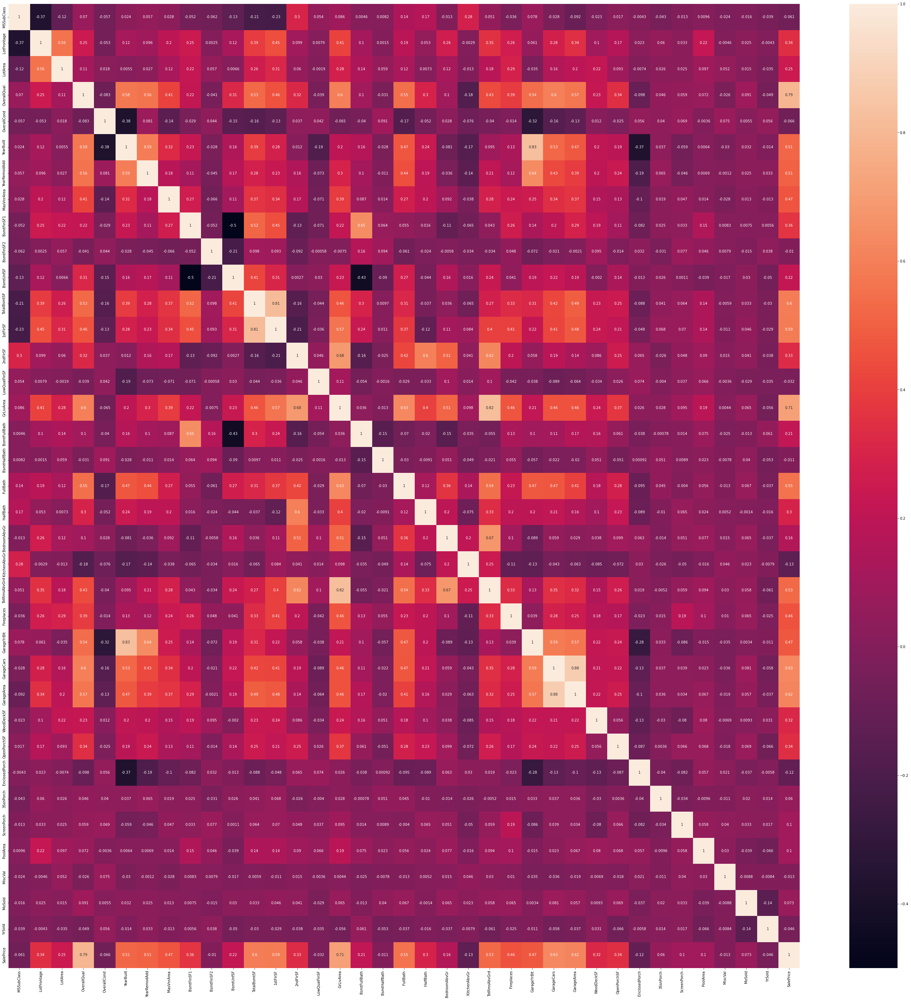

In [20]:
# plotting heat map to check correlation using Pearson

plt.figure(figsize=(50,50))                      
plot=sns.heatmap(data_num.corr(method = "pearson"), annot = True)
fig=plot.get_figure()
fig.savefig("heat.png")

<Figure size 1080x720 with 0 Axes>

<AxesSubplot:>

Text(0.5, 0, 'Feature')

Text(0, 0.5, 'column with target names')

Text(0.5, 1.0, 'correlation')

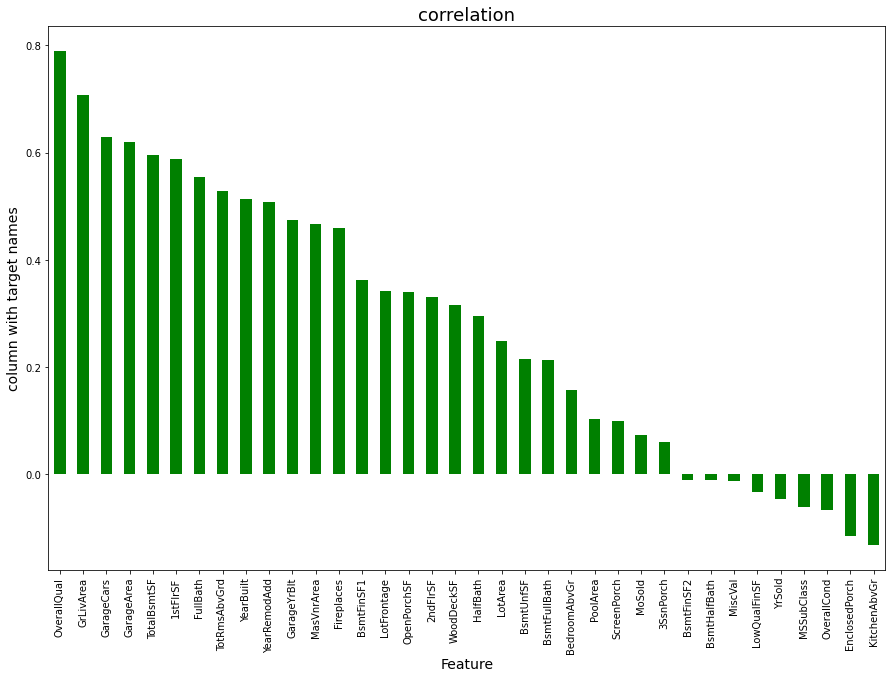

In [21]:
plt.figure(figsize=(15,10))
data_num.corr()["SalePrice"].sort_values(ascending=False).drop(["SalePrice"]).plot(kind='bar',color='g')
plt.xlabel('Feature',fontsize=14)
plt.ylabel('column with target names',fontsize=14)
plt.title('correlation',fontsize=18)
plt.show()

In [22]:
data_num.corr()

,MSSubClass,LotFrontage,LotArea,OverallQual,OverallCond,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtFinSF2,...,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SalePrice
MSSubClass,1.000000,-0.365220,-0.124151,0.070462,-0.056978,0.023988,0.056618,0.027868,-0.052236,-0.062403,...,-0.022609,0.017468,-0.004252,-0.043210,-0.013291,0.009583,-0.023503,-0.016015,-0.038595,-0.060775
LotFrontage,-0.365220,1.000000,0.557257,0.247809,-0.053345,0.118554,0.096050,0.202225,0.247780,0.002514,...,0.101751,0.167092,0.023118,0.059508,0.033111,0.223429,-0.004559,0.025046,-0.004296,0.341294
LotArea,-0.124151,0.557257,1.000000,0.107188,0.017513,0.005506,0.027228,0.121448,0.221851,0.056656,...,0.216720,0.093080,-0.007446,0.025794,0.025256,0.097107,0.051679,0.015141,-0.035399,0.249499
OverallQual,0.070462,0.247809,0.107188,1.000000,-0.083167,0.575800,0.555945,0.409163,0.219643,-0.040893,...,0.227137,0.341030,-0.098374,0.045919,0.059387,0.072247,-0.025786,0.090638,-0.048759,0.789185
OverallCond,-0.056978,-0.053345,0.017513,-0.083167,1.000000,-0.377731,0.080669,-0.137882,-0.028810,0.044336,...,0.012290,-0.024899,0.056074,0.040476,0.069463,-0.003603,0.075178,0.005519,0.055517,-0.065642
YearBuilt,0.023988,0.118554,0.005506,0.575800,-0.377731,1.000000,0.592829,0.323006,0.227933,-0.027682,...,0.204830,0.191069,-0.373544,0.037079,-0.058760,0.006408,-0.030008,0.031754,-0.013976,0.514408
YearRemodAdd,0.056618,0.096050,0.027228,0.555945,0.080669,0.592829,1.000000,0.181869,0.114430,-0.044694,...,0.197410,0.238755,-0.193574,0.064763,-0.046220,0.006874,-0.001199,0.024663,0.033265,0.507831
MasVnrArea,0.027868,0.202225,0.121448,0.409163,-0.137882,0.323006,0.181869,1.000000,0.267066,-0.065723,...,0.151978,0.131850,-0.102321,0.018721,0.046509,0.013590,-0.027583,0.013432,-0.013493,0.466386
BsmtFinSF1,-0.052236,0.247780,0.221851,0.219643,-0.028810,0.227933,0.114430,0.267066,1.000000,-0.052145,...,0.192939,0.108802,-0.082351,0.025485,0.033490,0.154769,0.008314,0.007482,0.005614,0.362874
BsmtFinSF2,-0.062403,0.002514,0.056656,-0.040893,0.044336,-0.027682,-0.044694,-0.065723,-0.052145,1.000000,...,0.094690,-0.014103,0.032081,-0.031263,0.076561,0.045990,0.007915,-0.014605,0.038438,-0.010151


## Data Visualization

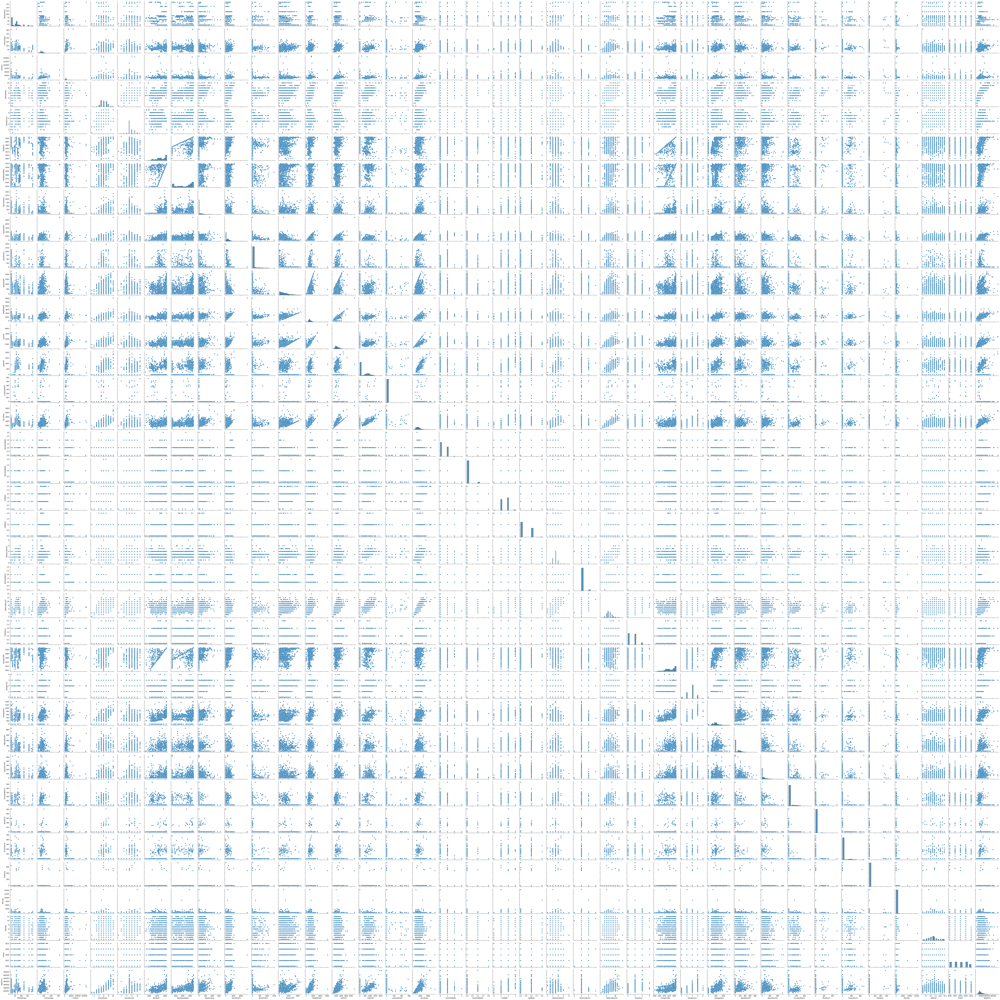

In [23]:
# Pair Plot
sns.pairplot(data)
fig2=plot.get_figure()
fig2.savefig("pairplot.png")

In [24]:
## Histogram for all the variables using plotly_express

for i in data.columns:
    fig = px.histogram(data, x= i, histfunc = "count", 
                       width=750, height=600, title = "Histogram for " + i, 
                       template="plotly_dark", cumulative=True)

    fig.show() 

In [25]:
def outlier(mydata):                        # Outlier Plotting
    for i in mydata.columns:
        fig = px.box(mydata, y= i, width=600, height=400, title=i, template="plotly_dark")
        fig.show()

In [26]:
outlier(mydata=data.drop(["SalePrice"],axis=1))

In [27]:
data2= copy.deepcopy(data) # Making a copy of the dataset

"Street","LandSlope" and "Condition2" are insignificant variables.

"BsmtFinSF1","OverallQual","YearBuilt","YearRemodAdd", 'BsmtUnfSF', 'TotalBsmtSF', '1stFlrSF', '2ndFlrSF', 'GrLivArea', 'BsmtFullBath', 'FullBath', 'HalfBath', 'BedroomAbvGr','GarageYrBlt', 'GarageArea',"TotRmsAbvGrd" and "GarageCars" are columns with multicollinearity


In [28]:
data2=data.drop(["Street","LandSlope","Condition2","BsmtFinSF1","OverallQual","YearBuilt","YearRemodAdd", 'BsmtUnfSF', 'TotalBsmtSF', '1stFlrSF', 
                 '2ndFlrSF', 'GrLivArea', 'BsmtFullBath', 'FullBath', 'HalfBath', 'BedroomAbvGr','GarageYrBlt', 'GarageArea',"TotRmsAbvGrd",
                 "GarageCars"], axis =1)

In [29]:
data_test=data_test.drop(["Street","LandSlope","Condition2","BsmtFinSF1","OverallQual","YearBuilt","YearRemodAdd", 'BsmtUnfSF', 'TotalBsmtSF', '1stFlrSF', 
                 '2ndFlrSF', 'GrLivArea', 'BsmtFullBath', 'FullBath', 'HalfBath', 'BedroomAbvGr','GarageYrBlt', 'GarageArea',"TotRmsAbvGrd",
                 "GarageCars"], axis =1)

### **Findings:**

- 1. It is found that Residential Low Density zoning has maximum count, for the feature general zoning classification of the sale.

- 2. In Paved streets we can observe maximum count, for the feature Type of road access to property.

- 3. Regular shaped property has maximum count, for the feature General shape of property.

- 4. Near Flat/Level property has maximum count, for the feature Flatness of the property.

- 5. Inside lot configured property has maximum count, for the feature Lot configuration.

- 6. Gentle sloped property has maximum count, for the feature Slope of property.

- 7.  If the property is located in North Ames then count is good compared to other locations, for the feature Physical locations within Ames city limits.

- 8. If the Proximity to various conditions-1 is normal then count is high for the feature Proximity to various conditions.

- 9. If the Proximity to various conditions-2 is normal then count is high for the feature Proximity to various conditions (if more than one is present).

- 10. Single-family Detached dwelling has maximum count for the feature Type of dwelling.

- 11. One story dwelling housestyle has maximum count for the feature Style of dwelling.

- 12. For Gable roof style the count is high for the feature Type of roof.

- 13. For Standard Shingle roof material the count is high for the feature Roof material.

- 14. For Vinyl Siding exterior-1 covering on house has maximum counts for the feature Exterior covering on house.

- 15. For Vinyl Siding exterior-2 covering on house has maximum counts for the feature Exterior covering on house (if more than one material).

- 16. For Masonry veneer type None has maximum count.

- 17.For Typical/Average(TA) quality of the material on the exterior has maximum count, for the feature Evaluates the quality of the material on the exterior (ExterQual).

- 18. For Typical/Average(TA) condition of the material on the exterior has maximum count for the feature Evaluates the present condition of the material on the exterior.

- 19. For Cinder Block and Poured Contrete foundations the count is maximum for the feature Type of foundation.

- 20. For good and average quality heights of the basement the count is high for the feature Evaluates the height of the basement.

- 21. For Typical/Average(TA) general condition of the basement the count is high for the feature Evaluates the general condition of the basement.

- 22. For No Exposure garden level walls the count is maximum for the feature Refers to walkout or garden level walls(BsmtExposure).

- 23. For unfinished Rating of basement finished area-1 the count is maximum for the feature Rating of basement finished area(BsmtFinType1).

- 24. For unfinished Rating of basement finished area-2 the count is maximum for the feature Rating of basement finished area (if multiple types)(BsmtFinType2).

- 25. For Gas forced warm air furnace type of heating the count is maximum for the feature Type of heating(Heating).

- 26. For Excellent Heating quality and condition the count is high for the feature Heating quality and condition(HeatingQC).

- 27. For Central air conditioning-yes has maximum count for the feature Central air conditioning(CentralAir).

- 28. For Standard Circuit Breakers & Romex Electrical system the count is high for the feature Electrical system(Electrical).

- 29. For Typical/Average(TA) and good Kitchen quality the count is maximum for the feature Kitchen quality(KitchenQual).

- 30. Typical Functionality has highest count for Home functionality (Assume typical unless deductions are warranted)(Functional).

- 31. For good Fireplace quality the count is high for the feature Fireplace quality(FireplaceQu).

- 32. If Garage location Attached to home then the count is high, for the feature Garage location(GarageType).

- 33. For Unfinished Interior of the garage the count is maximum, for the feature Interior finish of the garage(GarageFinish).

- 34. For Typical/Average(TA) Garage quality the count is high, for the feature Garage quality(GarageQual).

- 35. For Typical/Average(TA) Garage condition the count is high, for the feature Garage condition(GarageCond).

- 36. For Paved driveway the count is maximum, for the feature Paved driveway(PavedDrive).

- 37. For Warranty Deed - Conventional type of sales the count is maximum, for the feature Type of sale(SaleType).

- 38. For Normal sales condition the count is high, for the feature Condition of sale(SaleCondition).

- 39.As Linear feet of street connected to property(LotFrontage) is increseing sales is decreasing and the SalePrice is rangeing between 0-3 lakhs.

- 40.As Lot size in square feet(LotArea) is increseing sales is decreasing and the saleprice is in between 0-4 lakhs.

- 41.As Masonry veneer area in square feet(MasVnrArea) is increasing sales is decreasing and saleprice is rangeing between 0-4 lakhs.

- 42.As Type 1 finished square feet(BsmtFinSF1) is increseing sales is decreasing and the saleprice is in between 0-4 lakhs.

- 43.As Unfinished square feet of basement area(BsmtUnfSF) is increseing sales is decreasing and the saleprice is in between 0-4 lakhs. There are some outliers also.

- 44.As Total square feet of basement area(TotalBsmtSF) is increseing sales is decreasing and the saleprice is in between 0-4 lakhs.

- 45.As First Floor square feet(1stFlrSF) is increseing sales is decreasing and the saleprice is in between 0-4 lakhs.

- 46.As Second floor square feet(2ndFlrSF) is increseing sales is increasing in the range 500-1000 and the saleprice is in between 0-4 lakhs.

- 47.As Above grade (ground) living area square feet(GrLivArea) is increseing sales is decreasing and the saleprice is in between 0-4 lakhs.

- 48.As Size of garage in square feet(GarageArea) is increseing sales is increseing and the saleprice is in between 0-4 lakhs.

- 49.As Wood deck area in square feet(WoodDeckSF) is increseing sales is decreasing and the saleprice is in between 0-4 lakhs.

- 50.As Open porch area in square feet(OpenPorchSF) is increseing sales is decreasing and the saleprice is in between 0-4 lakhs.

- 51.As Year_SinceBuilt is increseing sales is decreasing and the saleprice is high for newly built building and the sales price is in between 0-4 lakhs.

- 52.As Since Remodel date (same as construction date if no remodeling or additions)(Year_SinceRemodAdded) is increseing sales is decreasing and the saleprice is in between 1-4 lakhs.

- 53.As Since Year garage was built(GarageAge) is increseing sales is decreasing and the saleprice is in between 0-4 lakhs.

- 54.For 1-STORY 1946 & NEWER ALL STYLES(20) and 2-STORY 1946 & NEWER(60) types of dwelling(MSSuubClass) the sales is good and SalePrice is also high.

- 55.As Rates the overall material and finish of the house(OverallQual) is increasing linearly sales is also increasing And SalePrice is also increasing linearly.

- 56.For 5(Average) overall condition of the house(OverallCond) the sales is high and SalePrice is also high. 

- 57.For 0 and 1 Basement full bathrooms(BsmtFullBath) the sales as well as SalePrice is high.

- 58.For 0 Basement half bathrooms(BsmtHalfBath) the sales as well as SalePrice is high.

- 59.For 1 and 2 Full bathrooms above grade(FullBath) the sales as well as SalePrice is high.

- 60.For 0 and 1 Half baths above grade(HalfBath) the sales as well as SalePrice is high. 

- 61.For 2, 3 and 4 Bedrooms above grade (does NOT include basement bedrooms)(BedroomAbvGr) the sales as well as SalePrice is high.

- 62.For 1 Kitchens above grade(KitchenAbvGr) the sales as well as SalePrice is high. 

- 63.For 4-9 Total rooms above grade (does not include bathrooms)(TotRmsAbvGrd) the sales as well as SalePrice is high.

- 64.For 0 and 1 Number of fireplaces(Fireplaces) the sales as well as SalePrice is high.

- 65.For 1 and 2 Size of garage in car capacity(GarageCars) the sales is high and for 3 Size of garage in car capacity(GarageCars) the SalePrice is high.

- 66.In between april to august for Month Sold(MoSold) the sales is good with SalePrice.

- 67.For all the Year_SinceSold the salePrice and sales both are same.

- 68. For Floating Village Residential(FV) and Residential Low Density(RL) zoning classification of the sale(MSZoning) the saleprice is high.

- 69. For paved type of road access to property(Street) the SalePrice is high.

- 70. For Slightly irregular(IR1), Moderately Irregular(IR2) and Irregular(IR3) shape of property(LotShape) the SalePrice is high.

- 71. For Hillside - Significant slope from side to side(HLS) Flatness of the property(LandContour) the SalePrice is High.

- 72. For Cul-de-sac(CulDSac) Lot configuration(LotConfig) the SalePrice is High.

- 73. For all types of Slope of property(LandSlope) i.e.,Gentle slope(Gtl), Moderate Slope(Mod) and Severe Slope(Sev) the SalePrice is High.

- 74. For Northridge(NoRidge) locations within Ames city limits(Neighborhood) the SalePrice is High.

- 75. For Within 200' of North-South Railroad(RRNn), Adjacent to postive off-site feature(PosA) and Near positive off-site feature--park, greenbelt, etc.(PosN) Proximity to various conditions(Condition1) has the maximum SalePrice.

- 76. For Adjacent to postive off-site feature(PosA) and Near positive off-site feature--park, greenbelt, etc.(PosN) Proximity to various conditions (if more than one is present)(Condition2) has maximum SalePrice.

- 77. For Single-family Detached(1Fam) and Townhouse End Unit(TwnhsE) type of dwelling(BldgType) the SalePrice is high.

- 78. For 2Story and Two and one-half story: 2nd level finished(2.5Fin) Style of dwelling(HouseStyle) the SalePrice is high.

- 79. For Shed Type of roof(RoofStyle) the SalePrice is high.

- 80. For Wood Shingles(WdShngl) Roof material(RoofMat1) the SalePrice is high.

- 81. For Cement Board(CemntBd), Imitation Stucco(ImStucc) and Stone type of Exterior covering on house(Exterior1st) the SalePrice is high.

- 82. For Cement Board(CemntBd), Imitation Stucco(ImStucc) and other Exterior covering on house (if more than one material)(Exterior2) has maximum SalePrice.

- 83. For Stone Masonry veneer type(MasvnrType) the SalePrice is high.

- 84. For Excellent(Ex) quality of the material on the exterior(ExterQual) the SalePrice is high.

- 85. For Excellent(Ex) present condition of the material on the exterior(ExterCond) the SalePrice is high.

- 86. For Poured Contrete(PConc) Type of foundation(Foundation) the SalePrice is high.

- 87. For Excellent(100+ inches)(Ex) height of the basement(BsmtQual) the SalePrice is high.

- 88. For Good(Gd) general condition of the basement(BsmtCond) the SalePrice is high.

- 89. For Good Exposure(Gd) of walkout or garden level walls(BsmtExposure) has maximum SalePrice.

- 90. For Good Living Quarters(GLQ) of basement finished area(BsmtFinType1) has maximum SalePrice.

- 91. For Good Living Quarters(GLQ) and Average Living Quarters(ALQ) of basement finished area (if multiple types)(BsmtFinType2) has maximum SalePrice. 

- 92. For Gas forced warm air furnace(GasA) and	Gas hot water or steam heat(GasW) Type of heating(Heating) has high SalePrice.

- 93. For Excellent(Ex) Heating quality and condition(HeatingQC) the SalePriceis high.

- 94. For building having Central air conditioning(CentralAir) the SalePrice is high.

- 95. For Standard Circuit Breakers & Romex(Sbrkr) of Electrical system(Electrical) the SalePrice is Maximum.

- 96. For Excellent(Ex) Kitchen quality(KitchenQual) the SalePrice is high.

- 97. For Typical Functionality(Typ) type of Home functionality (Assume typical unless deductions are warranted)(Functional) the SalePrice is high.

- 98. For Excellent - Exceptional Masonry Fireplace(Ex) of Fireplace quality(FireplaceQual) has highest SalePrice. 

- 99. For Built-In (Garage part of house - typically has room above garage)(BuiltIn) Garage location(GarageType) the SalePrice is maximum.

- 100. For Completely finished(Fin) Interior of the garage(GarageFinish) the SalePrice is high.

- 101. For Excellent(Ex) Garage quality(GarageQual) the SalePrice is high.

- 102. For Typical/Average(TA) and Good(Gd) Garage condition(GarageCond) the SalePrice is high.

- 103. For having Paved driveway(PavedDrive) the SalePriceis high.

- 104. For Home just constructed and sold(New) and Contract 15% Down payment regular terms(Con) of type of sale(SaleType) has highest SalePrice.

- 105. For Home was not completed when last assessed (associated with New Homes)(Partial) Condition of sale(SalesCondition) the SalePrice is maximum.

In [124]:
data_cat1 = pd.DataFrame()
data_num1 = pd.DataFrame()
for i in data2.columns:
    if data2[i].dtype == "O":
        data_cat1[i] = data2[i]
    else:
        data_num1[i] = data2[i]
        


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [32]:
test_cat = pd.DataFrame()
test_num = pd.DataFrame()
for i in data_test.columns:
    if data_test[i].dtype == "O":
        test_cat[i] = data_test[i]
    else:
        test_num[i] = data_test[i]
        


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

### Outlier Treatment

In [33]:
#### For train data

In [34]:
for i in data_num1.drop(['SalePrice'],axis=1).columns:
    data_num1[i] = np.where(data_num1[i] > (data_num1[i].quantile(0.75) + (data_num1[i].quantile(0.75) - data_num1[i].quantile(0.25))*1.5),
                           (data_num1[i].quantile(0.75) + (data_num1[i].quantile(0.75) - data_num1[i].quantile(0.25))*1.5),
                          np.where(data_num1[i] < (data_num1[i].quantile(0.25) - (data_num1[i].quantile(0.75) - data_num1[i].quantile(0.25))*1.5),
                           (data_num1[i].quantile(0.25) - (data_num1[i].quantile(0.75) - data_num1[i].quantile(0.25))*1.5),data_num1[i]))
    

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [35]:
#### For test data

In [36]:
for i in test_num.columns:
    test_num[i] = np.where(test_num[i] > (test_num[i].quantile(0.75) + (test_num[i].quantile(0.75) - test_num[i].quantile(0.25))*1.5),
                           (test_num[i].quantile(0.75) + (test_num[i].quantile(0.75) - test_num[i].quantile(0.25))*1.5),
                          np.where(test_num[i] < (test_num[i].quantile(0.25) - (test_num[i].quantile(0.75) - test_num[i].quantile(0.25))*1.5),
                           (test_num[i].quantile(0.25) - (test_num[i].quantile(0.75) - test_num[i].quantile(0.25))*1.5),test_num[i]))
    

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [37]:
outlier(mydata= data_num1.drop(["SalePrice"],axis=1))

In [38]:
data_num1.skew()

MSSubClass       1.016094
LotFrontage      0.089302
LotArea          0.184194
OverallCond      0.519895
MasVnrArea       1.286029
BsmtFinSF2       0.000000
LowQualFinSF     0.000000
BsmtHalfBath     0.000000
KitchenAbvGr     0.000000
Fireplaces       0.593950
WoodDeckSF       1.060148
OpenPorchSF      1.154030
EnclosedPorch    0.000000
3SsnPorch        0.000000
ScreenPorch      0.000000
PoolArea         0.000000
MiscVal          0.000000
MoSold           0.220979
YrSold           0.115765
SalePrice        1.953878
dtype: float64

In [39]:
col= ["MSSubClass","OverallCond","MasVnrArea","Fireplaces","WoodDeckSF","OpenPorchSF"]

In [40]:
# Removing skewness using Yeo-Johnson
# Removing data skewness
pt = PowerTransformer(method='yeo-johnson',standardize='True')
    
data_num1[col]= pt.fit_transform(data_num1[col].values)
#data_noskewtab= pd.DataFrame(data_noskew)
#data_noskewtab.columns = col

print(data_num1.skew())

MSSubClass       0.040499
LotFrontage      0.089302
LotArea          0.184194
OverallCond      0.001645
MasVnrArea       0.425788
BsmtFinSF2       0.000000
LowQualFinSF     0.000000
BsmtHalfBath     0.000000
KitchenAbvGr     0.000000
Fireplaces       0.080577
WoodDeckSF       0.110460
OpenPorchSF     -0.020712
EnclosedPorch    0.000000
3SsnPorch        0.000000
ScreenPorch      0.000000
PoolArea         0.000000
MiscVal          0.000000
MoSold           0.220979
YrSold           0.115765
SalePrice        1.953878
dtype: float64


In [41]:
col2= ["MSSubClass","OverallCond","MasVnrArea","Fireplaces","WoodDeckSF","OpenPorchSF"]

In [42]:
# Removing skewness using Yeo-Johnson
# Removing data skewness
pt = PowerTransformer(method='yeo-johnson',standardize='True')
    
test_num[col2]= pt.fit_transform(test_num[col2].values)
#data_noskewtab= pd.DataFrame(data_noskew)
#data_noskewtab.columns = col

print(test_num.skew())

MSSubClass       0.068571
LotFrontage      0.088100
LotArea          0.244662
OverallCond     -0.022384
MasVnrArea       0.367591
BsmtFinSF2       0.000000
LowQualFinSF     0.000000
BsmtHalfBath     0.000000
KitchenAbvGr     0.000000
Fireplaces       0.076669
WoodDeckSF       0.206896
OpenPorchSF     -0.092905
EnclosedPorch    0.000000
3SsnPorch        0.000000
ScreenPorch      0.000000
PoolArea         0.000000
MiscVal          0.000000
MoSold           0.186504
YrSold           0.018412
dtype: float64


In [43]:
# Encoding Variables
enc = LabelEncoder()
for i in data_cat1:
    data_cat1[i] = enc.fit_transform(data_cat1[i])

In [44]:
data_pre= pd.concat([data_cat1,data_num1], axis=1)

<IPython.core.display.Javascript object>

In [45]:
# Encoding Variables
enc = LabelEncoder()
for i in data_cat1:
    test_cat[i] = enc.fit_transform(test_cat[i])

In [46]:
data_test2= pd.concat([test_cat,test_num], axis=1)

<IPython.core.display.Javascript object>

<Figure size 1440x2880 with 0 Axes>

<AxesSubplot:xlabel='MSZoning', ylabel='Density'>

Text(0.5, 0, 'MSZoning')

<AxesSubplot:xlabel='LotShape', ylabel='Density'>

Text(0.5, 0, 'LotShape')

<AxesSubplot:xlabel='LandContour', ylabel='Density'>

Text(0.5, 0, 'LandContour')

<AxesSubplot:xlabel='Utilities', ylabel='Density'>

Text(0.5, 0, 'Utilities')

<AxesSubplot:xlabel='LotConfig', ylabel='Density'>

Text(0.5, 0, 'LotConfig')

<AxesSubplot:xlabel='Neighborhood', ylabel='Density'>

Text(0.5, 0, 'Neighborhood')

<AxesSubplot:xlabel='Condition1', ylabel='Density'>

Text(0.5, 0, 'Condition1')

<AxesSubplot:xlabel='BldgType', ylabel='Density'>

Text(0.5, 0, 'BldgType')

<AxesSubplot:xlabel='HouseStyle', ylabel='Density'>

Text(0.5, 0, 'HouseStyle')

<AxesSubplot:xlabel='RoofStyle', ylabel='Density'>

Text(0.5, 0, 'RoofStyle')

<AxesSubplot:xlabel='RoofMatl', ylabel='Density'>

Text(0.5, 0, 'RoofMatl')

<AxesSubplot:xlabel='Exterior1st', ylabel='Density'>

Text(0.5, 0, 'Exterior1st')

<AxesSubplot:xlabel='Exterior2nd', ylabel='Density'>

Text(0.5, 0, 'Exterior2nd')

<AxesSubplot:xlabel='MasVnrType', ylabel='Density'>

Text(0.5, 0, 'MasVnrType')

<AxesSubplot:xlabel='ExterQual', ylabel='Density'>

Text(0.5, 0, 'ExterQual')

<AxesSubplot:xlabel='ExterCond', ylabel='Density'>

Text(0.5, 0, 'ExterCond')

<AxesSubplot:xlabel='Foundation', ylabel='Density'>

Text(0.5, 0, 'Foundation')

<AxesSubplot:xlabel='BsmtQual', ylabel='Density'>

Text(0.5, 0, 'BsmtQual')

<AxesSubplot:xlabel='BsmtCond', ylabel='Density'>

Text(0.5, 0, 'BsmtCond')

<AxesSubplot:xlabel='BsmtExposure', ylabel='Density'>

Text(0.5, 0, 'BsmtExposure')

<AxesSubplot:xlabel='BsmtFinType1', ylabel='Density'>

Text(0.5, 0, 'BsmtFinType1')

<AxesSubplot:xlabel='BsmtFinType2', ylabel='Density'>

Text(0.5, 0, 'BsmtFinType2')

<AxesSubplot:xlabel='Heating', ylabel='Density'>

Text(0.5, 0, 'Heating')

<AxesSubplot:xlabel='HeatingQC', ylabel='Density'>

Text(0.5, 0, 'HeatingQC')

<AxesSubplot:xlabel='CentralAir', ylabel='Density'>

Text(0.5, 0, 'CentralAir')

<AxesSubplot:xlabel='Electrical', ylabel='Density'>

Text(0.5, 0, 'Electrical')

<AxesSubplot:xlabel='KitchenQual', ylabel='Density'>

Text(0.5, 0, 'KitchenQual')

<AxesSubplot:xlabel='Functional', ylabel='Density'>

Text(0.5, 0, 'Functional')

<AxesSubplot:xlabel='FireplaceQu', ylabel='Density'>

Text(0.5, 0, 'FireplaceQu')

<AxesSubplot:xlabel='GarageType', ylabel='Density'>

Text(0.5, 0, 'GarageType')

<AxesSubplot:xlabel='GarageFinish', ylabel='Density'>

Text(0.5, 0, 'GarageFinish')

<AxesSubplot:xlabel='GarageQual', ylabel='Density'>

Text(0.5, 0, 'GarageQual')

<AxesSubplot:xlabel='GarageCond', ylabel='Density'>

Text(0.5, 0, 'GarageCond')

<AxesSubplot:xlabel='PavedDrive', ylabel='Density'>

Text(0.5, 0, 'PavedDrive')

<AxesSubplot:xlabel='SaleType', ylabel='Density'>

Text(0.5, 0, 'SaleType')

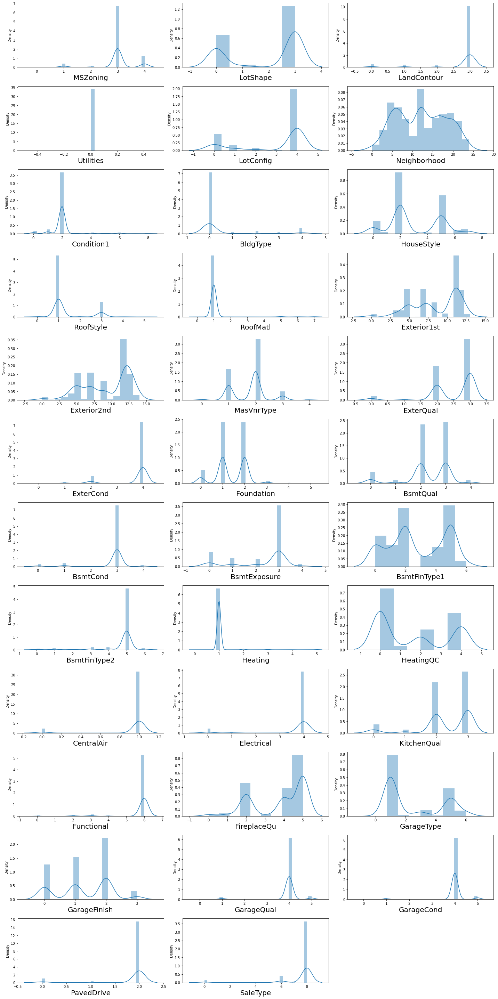

In [47]:
#Distribution plot for all numerical columns
plt.figure(figsize = (20,40))
plotnumber = 1
for column in data_pre:
    if plotnumber <=35:
        ax = plt.subplot(12,3,plotnumber)
        sns.distplot(data_pre[column])
        plt.xlabel(column,fontsize = 20)
    plotnumber+=1
plt.tight_layout()

<Figure size 1440x9360 with 0 Axes>

<AxesSubplot:>

<AxesSubplot:xlabel='MSZoning', ylabel='SalePrice'>

Text(0.5, 1.0, 'SalePrice VS MSZoning')

(array([-0.5,  0. ,  0.5,  1. ,  1.5,  2. ,  2.5,  3. ,  3.5,  4. ,  4.5]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

(array([-200000.,       0.,  200000.,  400000.,  600000.,  800000.]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

Text(0.5, 0, 'MSZoning')

Text(0, 0.5, 'SalePrice')

<AxesSubplot:>

<AxesSubplot:xlabel='LotShape', ylabel='SalePrice'>

Text(0.5, 1.0, 'SalePrice VS LotShape')

(array([-0.5,  0. ,  0.5,  1. ,  1.5,  2. ,  2.5,  3. ,  3.5]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

(array([-200000.,       0.,  200000.,  400000.,  600000.,  800000.]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

Text(0.5, 0, 'LotShape')

Text(0, 0.5, 'SalePrice')

<AxesSubplot:>

<AxesSubplot:xlabel='LandContour', ylabel='SalePrice'>

Text(0.5, 1.0, 'SalePrice VS LandContour')

(array([-0.5,  0. ,  0.5,  1. ,  1.5,  2. ,  2.5,  3. ,  3.5]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

(array([-200000.,       0.,  200000.,  400000.,  600000.,  800000.]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

Text(0.5, 0, 'LandContour')

Text(0, 0.5, 'SalePrice')

<AxesSubplot:>

<AxesSubplot:xlabel='Utilities', ylabel='SalePrice'>

Text(0.5, 1.0, 'SalePrice VS Utilities')

(array([-0.06, -0.04, -0.02,  0.  ,  0.02,  0.04,  0.06]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

(array([-200000.,       0.,  200000.,  400000.,  600000.,  800000.]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

Text(0.5, 0, 'Utilities')

Text(0, 0.5, 'SalePrice')

<AxesSubplot:>

<AxesSubplot:xlabel='LotConfig', ylabel='SalePrice'>

Text(0.5, 1.0, 'SalePrice VS LotConfig')

(array([-0.5,  0. ,  0.5,  1. ,  1.5,  2. ,  2.5,  3. ,  3.5,  4. ,  4.5]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

(array([-200000.,       0.,  200000.,  400000.,  600000.,  800000.]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

Text(0.5, 0, 'LotConfig')

Text(0, 0.5, 'SalePrice')

<AxesSubplot:>

<AxesSubplot:xlabel='Neighborhood', ylabel='SalePrice'>

Text(0.5, 1.0, 'SalePrice VS Neighborhood')

(array([-5.,  0.,  5., 10., 15., 20., 25., 30.]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

(array([-200000.,       0.,  200000.,  400000.,  600000.,  800000.]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

Text(0.5, 0, 'Neighborhood')

Text(0, 0.5, 'SalePrice')

<AxesSubplot:>

<AxesSubplot:xlabel='Condition1', ylabel='SalePrice'>

Text(0.5, 1.0, 'SalePrice VS Condition1')

(array([-1.,  0.,  1.,  2.,  3.,  4.,  5.,  6.,  7.,  8.,  9.]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

(array([-200000.,       0.,  200000.,  400000.,  600000.,  800000.]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

Text(0.5, 0, 'Condition1')

Text(0, 0.5, 'SalePrice')

<AxesSubplot:>

<AxesSubplot:xlabel='BldgType', ylabel='SalePrice'>

Text(0.5, 1.0, 'SalePrice VS BldgType')

(array([-0.5,  0. ,  0.5,  1. ,  1.5,  2. ,  2.5,  3. ,  3.5,  4. ,  4.5]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

(array([-200000.,       0.,  200000.,  400000.,  600000.,  800000.]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

Text(0.5, 0, 'BldgType')

Text(0, 0.5, 'SalePrice')

<AxesSubplot:>

<AxesSubplot:xlabel='HouseStyle', ylabel='SalePrice'>

Text(0.5, 1.0, 'SalePrice VS HouseStyle')

(array([-1.,  0.,  1.,  2.,  3.,  4.,  5.,  6.,  7.,  8.]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

(array([-200000.,       0.,  200000.,  400000.,  600000.,  800000.]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

Text(0.5, 0, 'HouseStyle')

Text(0, 0.5, 'SalePrice')

<AxesSubplot:>

<AxesSubplot:xlabel='RoofStyle', ylabel='SalePrice'>

Text(0.5, 1.0, 'SalePrice VS RoofStyle')

(array([-1.,  0.,  1.,  2.,  3.,  4.,  5.,  6.]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

(array([-200000.,       0.,  200000.,  400000.,  600000.,  800000.]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

Text(0.5, 0, 'RoofStyle')

Text(0, 0.5, 'SalePrice')

<AxesSubplot:>

<AxesSubplot:xlabel='RoofMatl', ylabel='SalePrice'>

Text(0.5, 1.0, 'SalePrice VS RoofMatl')

(array([-1.,  0.,  1.,  2.,  3.,  4.,  5.,  6.,  7.,  8.]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

(array([-200000.,       0.,  200000.,  400000.,  600000.,  800000.]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

Text(0.5, 0, 'RoofMatl')

Text(0, 0.5, 'SalePrice')

<AxesSubplot:>

<AxesSubplot:xlabel='Exterior1st', ylabel='SalePrice'>

Text(0.5, 1.0, 'SalePrice VS Exterior1st')

(array([-2.,  0.,  2.,  4.,  6.,  8., 10., 12., 14.]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

(array([-200000.,       0.,  200000.,  400000.,  600000.,  800000.]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

Text(0.5, 0, 'Exterior1st')

Text(0, 0.5, 'SalePrice')

<AxesSubplot:>

<AxesSubplot:xlabel='Exterior2nd', ylabel='SalePrice'>

Text(0.5, 1.0, 'SalePrice VS Exterior2nd')

(array([-2.,  0.,  2.,  4.,  6.,  8., 10., 12., 14., 16.]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

(array([-200000.,       0.,  200000.,  400000.,  600000.,  800000.]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

Text(0.5, 0, 'Exterior2nd')

Text(0, 0.5, 'SalePrice')

<AxesSubplot:>

<AxesSubplot:xlabel='MasVnrType', ylabel='SalePrice'>

Text(0.5, 1.0, 'SalePrice VS MasVnrType')

(array([-0.5,  0. ,  0.5,  1. ,  1.5,  2. ,  2.5,  3. ,  3.5,  4. ,  4.5]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

(array([-200000.,       0.,  200000.,  400000.,  600000.,  800000.]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

Text(0.5, 0, 'MasVnrType')

Text(0, 0.5, 'SalePrice')

<AxesSubplot:>

<AxesSubplot:xlabel='ExterQual', ylabel='SalePrice'>

Text(0.5, 1.0, 'SalePrice VS ExterQual')

(array([-0.5,  0. ,  0.5,  1. ,  1.5,  2. ,  2.5,  3. ,  3.5]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

(array([-200000.,       0.,  200000.,  400000.,  600000.,  800000.]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

Text(0.5, 0, 'ExterQual')

Text(0, 0.5, 'SalePrice')

<AxesSubplot:>

<AxesSubplot:xlabel='ExterCond', ylabel='SalePrice'>

Text(0.5, 1.0, 'SalePrice VS ExterCond')

(array([-0.5,  0. ,  0.5,  1. ,  1.5,  2. ,  2.5,  3. ,  3.5,  4. ,  4.5]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

(array([-200000.,       0.,  200000.,  400000.,  600000.,  800000.]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

Text(0.5, 0, 'ExterCond')

Text(0, 0.5, 'SalePrice')

<AxesSubplot:>

<AxesSubplot:xlabel='Foundation', ylabel='SalePrice'>

Text(0.5, 1.0, 'SalePrice VS Foundation')

(array([-1.,  0.,  1.,  2.,  3.,  4.,  5.,  6.]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

(array([-200000.,       0.,  200000.,  400000.,  600000.,  800000.]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

Text(0.5, 0, 'Foundation')

Text(0, 0.5, 'SalePrice')

<AxesSubplot:>

<AxesSubplot:xlabel='BsmtQual', ylabel='SalePrice'>

Text(0.5, 1.0, 'SalePrice VS BsmtQual')

(array([-0.5,  0. ,  0.5,  1. ,  1.5,  2. ,  2.5,  3. ,  3.5,  4. ,  4.5]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

(array([-200000.,       0.,  200000.,  400000.,  600000.,  800000.]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

Text(0.5, 0, 'BsmtQual')

Text(0, 0.5, 'SalePrice')

<AxesSubplot:>

<AxesSubplot:xlabel='BsmtCond', ylabel='SalePrice'>

Text(0.5, 1.0, 'SalePrice VS BsmtCond')

(array([-0.5,  0. ,  0.5,  1. ,  1.5,  2. ,  2.5,  3. ,  3.5,  4. ,  4.5]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

(array([-200000.,       0.,  200000.,  400000.,  600000.,  800000.]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

Text(0.5, 0, 'BsmtCond')

Text(0, 0.5, 'SalePrice')

<AxesSubplot:>

<AxesSubplot:xlabel='BsmtExposure', ylabel='SalePrice'>

Text(0.5, 1.0, 'SalePrice VS BsmtExposure')

(array([-0.5,  0. ,  0.5,  1. ,  1.5,  2. ,  2.5,  3. ,  3.5,  4. ,  4.5]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

(array([-200000.,       0.,  200000.,  400000.,  600000.,  800000.]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

Text(0.5, 0, 'BsmtExposure')

Text(0, 0.5, 'SalePrice')

<AxesSubplot:>

<AxesSubplot:xlabel='BsmtFinType1', ylabel='SalePrice'>

Text(0.5, 1.0, 'SalePrice VS BsmtFinType1')

(array([-1.,  0.,  1.,  2.,  3.,  4.,  5.,  6.,  7.]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

(array([-200000.,       0.,  200000.,  400000.,  600000.,  800000.]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

Text(0.5, 0, 'BsmtFinType1')

Text(0, 0.5, 'SalePrice')

<AxesSubplot:>

<AxesSubplot:xlabel='BsmtFinType2', ylabel='SalePrice'>

Text(0.5, 1.0, 'SalePrice VS BsmtFinType2')

(array([-1.,  0.,  1.,  2.,  3.,  4.,  5.,  6.,  7.]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

(array([-200000.,       0.,  200000.,  400000.,  600000.,  800000.]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

Text(0.5, 0, 'BsmtFinType2')

Text(0, 0.5, 'SalePrice')

<AxesSubplot:>

<AxesSubplot:xlabel='Heating', ylabel='SalePrice'>

Text(0.5, 1.0, 'SalePrice VS Heating')

(array([-1.,  0.,  1.,  2.,  3.,  4.,  5.,  6.]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

(array([-200000.,       0.,  200000.,  400000.,  600000.,  800000.]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

Text(0.5, 0, 'Heating')

Text(0, 0.5, 'SalePrice')

<AxesSubplot:>

<AxesSubplot:xlabel='HeatingQC', ylabel='SalePrice'>

Text(0.5, 1.0, 'SalePrice VS HeatingQC')

(array([-0.5,  0. ,  0.5,  1. ,  1.5,  2. ,  2.5,  3. ,  3.5,  4. ,  4.5]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

(array([-200000.,       0.,  200000.,  400000.,  600000.,  800000.]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

Text(0.5, 0, 'HeatingQC')

Text(0, 0.5, 'SalePrice')

<AxesSubplot:>

<AxesSubplot:xlabel='CentralAir', ylabel='SalePrice'>

Text(0.5, 1.0, 'SalePrice VS CentralAir')

(array([-0.2,  0. ,  0.2,  0.4,  0.6,  0.8,  1. ,  1.2]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

(array([-200000.,       0.,  200000.,  400000.,  600000.,  800000.]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

Text(0.5, 0, 'CentralAir')

Text(0, 0.5, 'SalePrice')

<AxesSubplot:>

<AxesSubplot:xlabel='Electrical', ylabel='SalePrice'>

Text(0.5, 1.0, 'SalePrice VS Electrical')

(array([-0.5,  0. ,  0.5,  1. ,  1.5,  2. ,  2.5,  3. ,  3.5,  4. ,  4.5]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

(array([-200000.,       0.,  200000.,  400000.,  600000.,  800000.]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

Text(0.5, 0, 'Electrical')

Text(0, 0.5, 'SalePrice')

<AxesSubplot:>

<AxesSubplot:xlabel='KitchenQual', ylabel='SalePrice'>

Text(0.5, 1.0, 'SalePrice VS KitchenQual')

(array([-0.5,  0. ,  0.5,  1. ,  1.5,  2. ,  2.5,  3. ,  3.5]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

(array([-200000.,       0.,  200000.,  400000.,  600000.,  800000.]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

Text(0.5, 0, 'KitchenQual')

Text(0, 0.5, 'SalePrice')

<AxesSubplot:>

<AxesSubplot:xlabel='Functional', ylabel='SalePrice'>

Text(0.5, 1.0, 'SalePrice VS Functional')

(array([-1.,  0.,  1.,  2.,  3.,  4.,  5.,  6.,  7.]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

(array([-200000.,       0.,  200000.,  400000.,  600000.,  800000.]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

Text(0.5, 0, 'Functional')

Text(0, 0.5, 'SalePrice')

<AxesSubplot:>

<AxesSubplot:xlabel='FireplaceQu', ylabel='SalePrice'>

Text(0.5, 1.0, 'SalePrice VS FireplaceQu')

(array([-1.,  0.,  1.,  2.,  3.,  4.,  5.,  6.]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

(array([-200000.,       0.,  200000.,  400000.,  600000.,  800000.]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

Text(0.5, 0, 'FireplaceQu')

Text(0, 0.5, 'SalePrice')

<AxesSubplot:>

<AxesSubplot:xlabel='GarageType', ylabel='SalePrice'>

Text(0.5, 1.0, 'SalePrice VS GarageType')

(array([-1.,  0.,  1.,  2.,  3.,  4.,  5.,  6.,  7.]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

(array([-200000.,       0.,  200000.,  400000.,  600000.,  800000.]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

Text(0.5, 0, 'GarageType')

Text(0, 0.5, 'SalePrice')

<AxesSubplot:>

<AxesSubplot:xlabel='GarageFinish', ylabel='SalePrice'>

Text(0.5, 1.0, 'SalePrice VS GarageFinish')

(array([-0.5,  0. ,  0.5,  1. ,  1.5,  2. ,  2.5,  3. ,  3.5]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

(array([-200000.,       0.,  200000.,  400000.,  600000.,  800000.]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

Text(0.5, 0, 'GarageFinish')

Text(0, 0.5, 'SalePrice')

<AxesSubplot:>

<AxesSubplot:xlabel='GarageQual', ylabel='SalePrice'>

Text(0.5, 1.0, 'SalePrice VS GarageQual')

(array([-1.,  0.,  1.,  2.,  3.,  4.,  5.,  6.]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

(array([-200000.,       0.,  200000.,  400000.,  600000.,  800000.]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

Text(0.5, 0, 'GarageQual')

Text(0, 0.5, 'SalePrice')

<AxesSubplot:>

<AxesSubplot:xlabel='GarageCond', ylabel='SalePrice'>

Text(0.5, 1.0, 'SalePrice VS GarageCond')

(array([-1.,  0.,  1.,  2.,  3.,  4.,  5.,  6.]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

(array([-200000.,       0.,  200000.,  400000.,  600000.,  800000.]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

Text(0.5, 0, 'GarageCond')

Text(0, 0.5, 'SalePrice')

<AxesSubplot:>

<AxesSubplot:xlabel='PavedDrive', ylabel='SalePrice'>

Text(0.5, 1.0, 'SalePrice VS PavedDrive')

(array([-0.25,  0.  ,  0.25,  0.5 ,  0.75,  1.  ,  1.25,  1.5 ,  1.75,
         2.  ,  2.25]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

(array([-200000.,       0.,  200000.,  400000.,  600000.,  800000.]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

Text(0.5, 0, 'PavedDrive')

Text(0, 0.5, 'SalePrice')

<AxesSubplot:>

<AxesSubplot:xlabel='SaleType', ylabel='SalePrice'>

Text(0.5, 1.0, 'SalePrice VS SaleType')

(array([-1.,  0.,  1.,  2.,  3.,  4.,  5.,  6.,  7.,  8.,  9.]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

(array([-200000.,       0.,  200000.,  400000.,  600000.,  800000.]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

Text(0.5, 0, 'SaleType')

Text(0, 0.5, 'SalePrice')

<AxesSubplot:>

<AxesSubplot:xlabel='SaleCondition', ylabel='SalePrice'>

Text(0.5, 1.0, 'SalePrice VS SaleCondition')

(array([-1.,  0.,  1.,  2.,  3.,  4.,  5.,  6.]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

(array([-200000.,       0.,  200000.,  400000.,  600000.,  800000.]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

Text(0.5, 0, 'SaleCondition')

Text(0, 0.5, 'SalePrice')

<AxesSubplot:>

<AxesSubplot:xlabel='MSSubClass', ylabel='SalePrice'>

Text(0.5, 1.0, 'SalePrice VS MSSubClass')

(array([-1.5, -1. , -0.5,  0. ,  0.5,  1. ,  1.5,  2. ]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

(array([-200000.,       0.,  200000.,  400000.,  600000.,  800000.]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

Text(0.5, 0, 'MSSubClass')

Text(0, 0.5, 'SalePrice')

<AxesSubplot:>

<AxesSubplot:xlabel='LotFrontage', ylabel='SalePrice'>

Text(0.5, 1.0, 'SalePrice VS LotFrontage')

(array([ 20.,  30.,  40.,  50.,  60.,  70.,  80.,  90., 100., 110., 120.]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

(array([-200000.,       0.,  200000.,  400000.,  600000.,  800000.]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

Text(0.5, 0, 'LotFrontage')

Text(0, 0.5, 'SalePrice')

<AxesSubplot:>

<AxesSubplot:xlabel='LotArea', ylabel='SalePrice'>

Text(0.5, 1.0, 'SalePrice VS LotArea')

(array([    0.,  2000.,  4000.,  6000.,  8000., 10000., 12000., 14000.,
        16000., 18000., 20000.]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

(array([-200000.,       0.,  200000.,  400000.,  600000.,  800000.]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

Text(0.5, 0, 'LotArea')

Text(0, 0.5, 'SalePrice')

<AxesSubplot:>

<AxesSubplot:xlabel='OverallCond', ylabel='SalePrice'>

Text(0.5, 1.0, 'SalePrice VS OverallCond')

(array([-3., -2., -1.,  0.,  1.,  2.]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

(array([-200000.,       0.,  200000.,  400000.,  600000.,  800000.]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

Text(0.5, 0, 'OverallCond')

Text(0, 0.5, 'SalePrice')

<AxesSubplot:>

<AxesSubplot:xlabel='MasVnrArea', ylabel='SalePrice'>

Text(0.5, 1.0, 'SalePrice VS MasVnrArea')

(array([-1. , -0.5,  0. ,  0.5,  1. ,  1.5]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

(array([-200000.,       0.,  200000.,  400000.,  600000.,  800000.]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

Text(0.5, 0, 'MasVnrArea')

Text(0, 0.5, 'SalePrice')

<AxesSubplot:>

<AxesSubplot:xlabel='BsmtFinSF2', ylabel='SalePrice'>

Text(0.5, 1.0, 'SalePrice VS BsmtFinSF2')

(array([-0.06, -0.04, -0.02,  0.  ,  0.02,  0.04,  0.06]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

(array([-200000.,       0.,  200000.,  400000.,  600000.,  800000.]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

Text(0.5, 0, 'BsmtFinSF2')

Text(0, 0.5, 'SalePrice')

<AxesSubplot:>

<AxesSubplot:xlabel='LowQualFinSF', ylabel='SalePrice'>

Text(0.5, 1.0, 'SalePrice VS LowQualFinSF')

(array([-0.06, -0.04, -0.02,  0.  ,  0.02,  0.04,  0.06]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

(array([-200000.,       0.,  200000.,  400000.,  600000.,  800000.]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

Text(0.5, 0, 'LowQualFinSF')

Text(0, 0.5, 'SalePrice')

<AxesSubplot:>

<AxesSubplot:xlabel='BsmtHalfBath', ylabel='SalePrice'>

Text(0.5, 1.0, 'SalePrice VS BsmtHalfBath')

(array([-0.06, -0.04, -0.02,  0.  ,  0.02,  0.04,  0.06]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

(array([-200000.,       0.,  200000.,  400000.,  600000.,  800000.]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

Text(0.5, 0, 'BsmtHalfBath')

Text(0, 0.5, 'SalePrice')

<AxesSubplot:>

<AxesSubplot:xlabel='KitchenAbvGr', ylabel='SalePrice'>

Text(0.5, 1.0, 'SalePrice VS KitchenAbvGr')

(array([0.94, 0.96, 0.98, 1.  , 1.02, 1.04, 1.06]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

(array([-200000.,       0.,  200000.,  400000.,  600000.,  800000.]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

Text(0.5, 0, 'KitchenAbvGr')

Text(0, 0.5, 'SalePrice')

<AxesSubplot:>

<AxesSubplot:xlabel='Fireplaces', ylabel='SalePrice'>

Text(0.5, 1.0, 'SalePrice VS Fireplaces')

(array([-1.5, -1. , -0.5,  0. ,  0.5,  1. ,  1.5,  2. ,  2.5]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

(array([-200000.,       0.,  200000.,  400000.,  600000.,  800000.]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

Text(0.5, 0, 'Fireplaces')

Text(0, 0.5, 'SalePrice')

<AxesSubplot:>

<AxesSubplot:xlabel='WoodDeckSF', ylabel='SalePrice'>

Text(0.5, 1.0, 'SalePrice VS WoodDeckSF')

(array([-1.5, -1. , -0.5,  0. ,  0.5,  1. ,  1.5]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

(array([-200000.,       0.,  200000.,  400000.,  600000.,  800000.]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

Text(0.5, 0, 'WoodDeckSF')

Text(0, 0.5, 'SalePrice')

<AxesSubplot:>

<AxesSubplot:xlabel='OpenPorchSF', ylabel='SalePrice'>

Text(0.5, 1.0, 'SalePrice VS OpenPorchSF')

(array([-1.5, -1. , -0.5,  0. ,  0.5,  1. ,  1.5]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

(array([-200000.,       0.,  200000.,  400000.,  600000.,  800000.]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

Text(0.5, 0, 'OpenPorchSF')

Text(0, 0.5, 'SalePrice')

<AxesSubplot:>

<AxesSubplot:xlabel='EnclosedPorch', ylabel='SalePrice'>

Text(0.5, 1.0, 'SalePrice VS EnclosedPorch')

(array([-0.06, -0.04, -0.02,  0.  ,  0.02,  0.04,  0.06]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

(array([-200000.,       0.,  200000.,  400000.,  600000.,  800000.]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

Text(0.5, 0, 'EnclosedPorch')

Text(0, 0.5, 'SalePrice')

<AxesSubplot:>

<AxesSubplot:xlabel='3SsnPorch', ylabel='SalePrice'>

Text(0.5, 1.0, 'SalePrice VS 3SsnPorch')

(array([-0.06, -0.04, -0.02,  0.  ,  0.02,  0.04,  0.06]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

(array([-200000.,       0.,  200000.,  400000.,  600000.,  800000.]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

Text(0.5, 0, '3SsnPorch')

Text(0, 0.5, 'SalePrice')

<AxesSubplot:>

<AxesSubplot:xlabel='ScreenPorch', ylabel='SalePrice'>

Text(0.5, 1.0, 'SalePrice VS ScreenPorch')

(array([-0.06, -0.04, -0.02,  0.  ,  0.02,  0.04,  0.06]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

(array([-200000.,       0.,  200000.,  400000.,  600000.,  800000.]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

Text(0.5, 0, 'ScreenPorch')

Text(0, 0.5, 'SalePrice')

<AxesSubplot:>

<AxesSubplot:xlabel='PoolArea', ylabel='SalePrice'>

Text(0.5, 1.0, 'SalePrice VS PoolArea')

(array([-0.06, -0.04, -0.02,  0.  ,  0.02,  0.04,  0.06]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

(array([-200000.,       0.,  200000.,  400000.,  600000.,  800000.]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

Text(0.5, 0, 'PoolArea')

Text(0, 0.5, 'SalePrice')

<AxesSubplot:>

<AxesSubplot:xlabel='MiscVal', ylabel='SalePrice'>

Text(0.5, 1.0, 'SalePrice VS MiscVal')

(array([-0.06, -0.04, -0.02,  0.  ,  0.02,  0.04,  0.06]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

(array([-200000.,       0.,  200000.,  400000.,  600000.,  800000.]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

Text(0.5, 0, 'MiscVal')

Text(0, 0.5, 'SalePrice')

<AxesSubplot:>

<AxesSubplot:xlabel='MoSold', ylabel='SalePrice'>

Text(0.5, 1.0, 'SalePrice VS MoSold')

(array([ 0.,  2.,  4.,  6.,  8., 10., 12., 14.]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

(array([-200000.,       0.,  200000.,  400000.,  600000.,  800000.]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

Text(0.5, 0, 'MoSold')

Text(0, 0.5, 'SalePrice')

<AxesSubplot:>

<AxesSubplot:xlabel='YrSold', ylabel='SalePrice'>

Text(0.5, 1.0, 'SalePrice VS YrSold')

(array([2005.5, 2006. , 2006.5, 2007. , 2007.5, 2008. , 2008.5, 2009. ,
        2009.5, 2010. , 2010.5]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

(array([-200000.,       0.,  200000.,  400000.,  600000.,  800000.]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

Text(0.5, 0, 'YrSold')

Text(0, 0.5, 'SalePrice')

<AxesSubplot:>

<AxesSubplot:xlabel='SalePrice', ylabel='SalePrice'>

Text(0.5, 1.0, 'SalePrice VS SalePrice')

(array([-100000.,       0.,  100000.,  200000.,  300000.,  400000.,
         500000.,  600000.,  700000.,  800000.]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

(array([-200000.,       0.,  200000.,  400000.,  600000.,  800000.]),
 [Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, ''),
  Text(0, 0, '')])

Text(0.5, 0, 'SalePrice')

Text(0, 0.5, 'SalePrice')

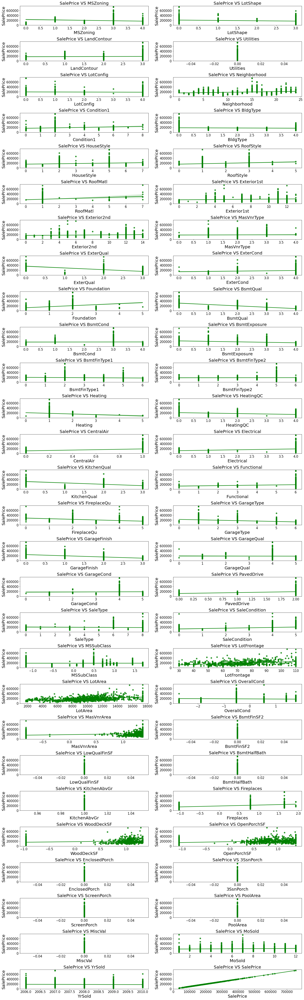

In [48]:
#regplot for numerical columns
col= data_pre.columns

plt.figure(figsize=(20,130))
for i in range(len(col)):
    plt.subplot(56,2,i+1)
    sns.regplot(x=data_pre[col[i]] , y=data_pre['SalePrice'],color="g")
    plt.title(f"SalePrice VS {col[i]}",fontsize=20)
    plt.xticks(fontsize=15)  
    plt.yticks(fontsize=15)
    plt.xlabel(col[i],fontsize = 20)
    plt.ylabel('SalePrice',fontsize = 20)
    plt.tight_layout()

## Data Pre-processing

### Missing Value Imputation

In [50]:
impute_1= SimpleImputer(strategy= "mean")
impute_2= IterativeImputer(max_iter=10, random_state= 0)
impute_3= KNNImputer(n_neighbors=9)
model= LinearRegression()

<IPython.core.display.Javascript object>

In [51]:
pipe1 = Pipeline([
    ('impute',impute_1),
    ('model',model),
])    
pipe2 = Pipeline([
    ('impute',impute_2),
    ('model',model),
])
pipe3 = Pipeline([
    ('impute',impute_3),
    ('model',model),  
    
])

In [52]:
def pre_process(data, target, pipe):
    
    data_reset_index = data.reset_index(drop=True)
    
# Create Global Variable
    global X
    global y
    global X_train
    global X_test
    global y_train
    global y_test
    global y_pred

# Segregate Feature & Target Variables
    X = data_reset_index.drop(target, axis=1)
    y = data_reset_index[target]

# Split train & Test

    X_train,  X_test, y_train, y_test = train_test_split(X,y, test_size= 0.3, random_state=1)

# Pipe.fit, pipe.predict and accuracy
    
    pipe.fit(X_train,y_train)
    
    y_pred = pipe.predict(X_test)
    
    score = np.sqrt(metrics.mean_squared_error(y_pred, y_test))
    
    return score

In [53]:
pre_process(data= data_pre,
           target='SalePrice',
           pipe= pipe1)

<IPython.core.display.Javascript object>

42540.152814065295

In [54]:
pre_process(data= data_pre,
           target='SalePrice',
           pipe= pipe2)

<IPython.core.display.Javascript object>

42578.80283773444

In [55]:
pre_process(data= data_pre,
           target='SalePrice',
           pipe= pipe3)

<IPython.core.display.Javascript object>

42589.645468508395

In [85]:
data_features= data_pre.drop(["SalePrice"],axis=1)
data_label=data_pre["SalePrice"]

In [86]:
ft_train = pd.DataFrame(impute_2.fit_transform(data_features))
ft_train.columns = data_features.columns

<IPython.core.display.Javascript object>

In [87]:
data_pre2= pd.concat([ft_train,data_label],axis=1)

<IPython.core.display.Javascript object>

In [59]:
for i in ft_train:
    print("For ",i,":" , "\n")
    print("The Unique values for " ,i ," = ", ft_train[i].nunique(),"\n")
    print(ft_train[i].value_counts())
    print("\n","\n","XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX","\n")

For  MSZoning : 

The Unique values for  MSZoning  =  5 

3.0    928
4.0    163
1.0     52
2.0     16
0.0      9
Name: MSZoning, dtype: int64

 
 XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX 

For  LotShape : 

The Unique values for  LotShape  =  4 

3.0    740
0.0    390
1.0     32
2.0      6
Name: LotShape, dtype: int64

 
 XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX 

For  LandContour : 

The Unique values for  LandContour  =  4 

3.0    1046
0.0      50
1.0      42
2.0      30
Name: LandContour, dtype: int64

 
 XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX 

For  Utilities : 

The Unique values for  Utilities  =  1 

0.0    1168
Name: Utilities, dtype: int64

 
 XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX 

For  LotConfig : 

The Unique values for  LotConfig  =  5 

4.0    842
0.0    222
1.0     69
2.0     33
3.0      2
Name: LotConfig, dtype: int64

 
 XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX 

For  Neighborhood : 


### Missing Value Imputation for test dataset

In [82]:
data_features2= data_test2

In [83]:
ft_test = pd.DataFrame(impute_2.fit_transform(data_features2))
ft_test.columns = data_features.columns

<IPython.core.display.Javascript object>

In [84]:
data_test2= pd.DataFrame(ft_test)

<IPython.core.display.Javascript object>

In [63]:
for i in data_pre2:
    print("For ",i,":" , "\n")
    print("The Unique values for " ,i ," = ", data_pre2[i].nunique(),"\n")
    print(data_pre2[i].value_counts())
    print("\n","\n","XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX","\n")

For  MSZoning : 

The Unique values for  MSZoning  =  4 

2.0    223
3.0     55
1.0     13
0.0      1
Name: MSZoning, dtype: int64

 
 XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX 

For  LotShape : 

The Unique values for  LotShape  =  4 

3.0    185
0.0     94
1.0      9
2.0      4
Name: LotShape, dtype: int64

 
 XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX 

For  LandContour : 

The Unique values for  LandContour  =  4 

3.0    265
0.0     13
1.0      8
2.0      6
Name: LandContour, dtype: int64

 
 XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX 

For  Utilities : 

The Unique values for  Utilities  =  2 

0.0    291
1.0      1
Name: Utilities, dtype: int64

 
 XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX 

For  LotConfig : 

The Unique values for  LotConfig  =  5 

4.0    210
0.0     41
1.0     25
2.0     14
3.0      2
Name: LotConfig, dtype: int64

 
 XXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXXX 

For  Neighborhood : 

The 

### Train Test Split

In [64]:
def split (data,target):
    data_reset_index = data.reset_index(drop=True)
# Data split
    global x
    global y
    global x_train
    global y_train
    global x_test
    global y_test
# Segregate Feature & Target Variables
    x = data_reset_index.drop(target, axis=1)
    y = data_reset_index[target]
    x_train,x_test,y_train,y_test = train_test_split(x,y, test_size=0.3, random_state=3)
    
    print(x_train.info())
    ("\n")
    print(x_test.info())
    ("\n")
    print(y_train.shape)
    ("\n")
    print(y_test.shape)
    ("\n")

In [88]:
split(data=data_pre2,
      target="SalePrice")

<class 'pandas.core.frame.DataFrame'>
Int64Index: 817 entries, 613 to 952
Data columns (total 55 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   MSZoning       817 non-null    float64
 1   LotShape       817 non-null    float64
 2   LandContour    817 non-null    float64
 3   Utilities      817 non-null    float64
 4   LotConfig      817 non-null    float64
 5   Neighborhood   817 non-null    float64
 6   Condition1     817 non-null    float64
 7   BldgType       817 non-null    float64
 8   HouseStyle     817 non-null    float64
 9   RoofStyle      817 non-null    float64
 10  RoofMatl       817 non-null    float64
 11  Exterior1st    817 non-null    float64
 12  Exterior2nd    817 non-null    float64
 13  MasVnrType     817 non-null    float64
 14  ExterQual      817 non-null    float64
 15  ExterCond      817 non-null    float64
 16  Foundation     817 non-null    float64
 17  BsmtQual       817 non-null    float64
 18  BsmtCond

### Scaling the data

In [89]:
scale_1= StandardScaler()
scale_2= MinMaxScaler()
scale_3= RobustScaler()
model= LinearRegression()

In [90]:
pipe1 = Pipeline([
    ('Scale',scale_1),
    ('model',model),
])    
pipe2 = Pipeline([
    ('Scale',scale_2),
    ('model',model),
])
pipe3 = Pipeline([
    ('Scale',scale_3),
    ('model',model),  
    
])

In [91]:
# Create Function Name 
def pre_process(data, pipe):

# Pipe.fit, pipe.predict and accuracy
    
    pipe.fit(x_train,y_train)
    
    y_pred = pipe.predict(x_test)
    
    score = np.sqrt(metrics.mean_squared_error(y_pred, y_test))
    
    return score

In [92]:
pre_process(data= data_pre2,
           pipe= pipe1)

<IPython.core.display.Javascript object>

38302.535147041526

In [93]:
pre_process(data= data_pre2,
           pipe= pipe2)

<IPython.core.display.Javascript object>

38297.099883934774

In [94]:
pre_process(data= data_pre2,
           pipe= pipe3)

<IPython.core.display.Javascript object>

38296.667636142345

Since Standard Scalar scores the most, I will choose that method.

In [95]:
scalar= StandardScaler()
scalar.fit(x_train)
x_trainsc =  scalar.transform(x_train)
x_testsc  =  scalar.transform(x_test)


StandardScaler()

### Principal Component Analysis (PCA)

In [96]:
pca = PCA(n_components = 0.5)
pca.fit(x_trainsc)
x_train_model = pca.transform(x_trainsc)
x_test_model = pca.transform(x_testsc)
ex_variance=np.var(x_train_model,axis=0)
ex_variance_ratio = ex_variance/np.sum(ex_variance)

print("shape of x_train_pca", x_train_model.shape)
print('')    
print("Explained Variance Ratio for Training Dataset: \n", ex_variance_ratio)

print(" ")

ex_variance_1 = np.var(x_test_model , axis=0)
ex_variance_ratio_1 = ex_variance_1 / np.sum(ex_variance_1)
    
print("Explained Variance Ratio for Test Dataset: \n", ex_variance_ratio_1) 
print(" ")

PCA(n_components=0.5)

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

shape of x_train_pca (817, 11)

Explained Variance Ratio for Training Dataset: 
 [0.24721955 0.12366913 0.10531819 0.07967236 0.07693674 0.06954405
 0.06458659 0.06377248 0.05934974 0.05554759 0.05438358]
 


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Explained Variance Ratio for Test Dataset: 
 [0.23439781 0.12298754 0.11617301 0.08654715 0.08493148 0.06073734
 0.06878861 0.07608045 0.04855989 0.05345605 0.04734068]
 


## Model Building

In [97]:
lr = LinearRegression()
lr.fit(x_trainsc, y_train)


model = sm.OLS(y_train, x_trainsc).fit()


y_pred = model.predict(x_testsc)

print("Linear Regression Train Score: ", lr.score(x_trainsc , y_train))

print("Linear Regression Test Score: ", lr.score(x_testsc , y_test))

print('Mean Absolute Error:', np.round(metrics.mean_absolute_error(y_test, y_pred),2))  
print('Mean Squared Error:', np.round(metrics.mean_squared_error(y_test, y_pred),2))  
print('Root Mean Squared Error:', np.round(np.sqrt(metrics.mean_squared_error(y_test, y_pred)),2))
print(model.summary())

LinearRegression()

Linear Regression Train Score:  0.7240303849900338
Linear Regression Test Score:  0.7424137520633305


<IPython.core.display.Javascript object>

Mean Absolute Error: 181086.34


<IPython.core.display.Javascript object>

Mean Squared Error: 34258197501.69


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Root Mean Squared Error: 185089.7
                                 OLS Regression Results                                
Dep. Variable:              SalePrice   R-squared (uncentered):                   0.119
Model:                            OLS   Adj. R-squared (uncentered):              0.067
Method:                 Least Squares   F-statistic:                              2.310
Date:                Thu, 01 Sep 2022   Prob (F-statistic):                    4.43e-06
Time:                        16:07:47   Log-Likelihood:                         -11076.
No. Observations:                 817   AIC:                                  2.224e+04
Df Residuals:                     772   BIC:                                  2.245e+04
Df Model:                          45                                                  
Covariance Type:            nonrobust                                                  
                 coef    std err          t      P>|t|      [0.025      0.975]
-------

In [98]:
# Cross Validation
rfe = RFE(lr, n_features_to_select=6)             
rfe = rfe.fit(x, y)

r2 = sklearn.metrics.r2_score(y_test, y_pred)

scores = cross_val_score(lr, x, y, scoring='r2', cv=5)
scores   

# create a KFold object with 5 splits 
folds = KFold(n_splits = 5, shuffle = True, random_state = 100)
scores = cross_val_score(lr, x, y, scoring='r2', cv=folds)
scores  

scores = cross_val_score(lr, x, y, scoring='neg_mean_squared_error', cv=5)
scores

<IPython.core.display.Javascript object>

array([0.71057585, 0.68930309, 0.63565277, 0.77080842, 0.69513994])

array([0.68754396, 0.67950754, 0.75649584, 0.66596748, 0.72304133])

array([-1.95054705e+09, -2.20892945e+09, -2.13314860e+09, -1.52448568e+09,
       -1.40670189e+09])

In [99]:
### Elastic Net

In [100]:
lm_elastic1 = ElasticNet()

lm_elastic1.fit(x_trainsc, y_train)



y_pred_elastic = lm_elastic1.predict(x_testsc)


print("Elastic Net Train Score: ", lm_elastic1.score(x_trainsc , y_train))

print("Elastic Net Test Score: ", lm_elastic1.score(x_testsc , y_test))


print('Mean Absolute Error: \n', np.round(metrics.mean_absolute_error(y_test, y_pred_elastic),2)) 

print(" ")

print('Mean Squared Error: \n', np.round(metrics.mean_squared_error(y_test, y_pred_elastic),2))

print(" ")

print('Root Mean Squared Error: \n', np.round(np.sqrt(metrics.mean_squared_error(y_test, y_pred_elastic)),2))
print(" ")

y_pred = lm_elastic1.predict(x_testsc)
r2 = sklearn.metrics.r2_score(y_test, y_pred)
print("R2= ",r2)

coeff_used_003 = np.sum(lm_elastic1.coef_ != 0)

print("Coefficient used: ",coeff_used_003)

ElasticNet()

Elastic Net Train Score:  0.7045560161146383
Elastic Net Test Score:  0.7426224734112197


<IPython.core.display.Javascript object>

Mean Absolute Error: 
 26647.38
 


<IPython.core.display.Javascript object>

Mean Squared Error: 
 1465895424.86
 


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Root Mean Squared Error: 
 38287.01
 


<IPython.core.display.Javascript object>

R2=  0.7426224734112197


<IPython.core.display.Javascript object>

Coefficient used:  45


In [101]:
rfe = RFE(lm_elastic1, n_features_to_select=6)             
rfe = rfe.fit(x_trainsc, y_train)

r2 = sklearn.metrics.r2_score(y_test, y_pred)

scores = cross_val_score(lm_elastic1, x, y, scoring='r2', cv=5)
scores   

# create a KFold object with 5 splits 
folds = KFold(n_splits = 5, shuffle = True, random_state = 100)
scores = cross_val_score(lm_elastic1, x, y, scoring='r2', cv=folds)
scores  

scores = cross_val_score(lm_elastic1, x, y, scoring='neg_mean_squared_error', cv=5)
scores

<IPython.core.display.Javascript object>

array([0.6928475 , 0.66865423, 0.64028269, 0.73954746, 0.68780896])

array([0.66455583, 0.67401116, 0.73905034, 0.65142429, 0.69276251])

array([-2.07002565e+09, -2.35573449e+09, -2.10604178e+09, -1.73242041e+09,
       -1.44052891e+09])

In [102]:
## Tuning Hyperparameters

# step-1: create a cross-validation scheme
folds = KFold(n_splits = 3, shuffle = True, random_state = 100)

# step-2: specify range of hyperparameters to tune
hyper_params = [{'normalize':[True, False],'random_state':list(range(0, 10)), 'tol': list(range(-10, 100, 20)), 
                 'selection': ['cyclic', 'random']}]


# step-3: perform grid search
# 3.1 specify model
lm_elastic = ElasticNet()

lm_elastic.fit(x_trainsc, y_train)
            

# 3.2 call GridSearchCV()
model_cv = GridSearchCV(estimator = lm_elastic,
                        param_grid = hyper_params, 
                        scoring= 'neg_mean_absolute_error', 
                        cv = 3,
                        verbose=1,
                        return_train_score=True)
    

# fit the model
grid_result= model_cv.fit(x_trainsc, y_train)   
print('Best Score: ', grid_result.best_score_)

print('Best Params: ', grid_result.best_params_)

ElasticNet()

Fitting 3 folds for each of 240 candidates, totalling 720 fits
Best Score:  -31569.23125396152
Best Params:  {'normalize': False, 'random_state': 7, 'selection': 'random', 'tol': 10}


In [103]:
lm_elastic2 = ElasticNet( normalize= False, random_state= 7, selection='cyclic', tol= 10)

lm_elastic2.fit(x_trainsc, y_train)



y_pred_elastic = lm_elastic2.predict(x_testsc)


print("Elastic Net Train Score: ", lm_elastic2.score(x_trainsc , y_train))

print("Elastic Net Test Score: ", lm_elastic2.score(x_testsc , y_test))


print('Mean Absolute Error: \n', np.round(metrics.mean_absolute_error(y_test, y_pred_elastic),2)) 

print(" ")

print('Mean Squared Error: \n', np.round(metrics.mean_squared_error(y_test, y_pred_elastic),2))

print(" ")

print('Root Mean Squared Error: \n', np.round(np.sqrt(metrics.mean_squared_error(y_test, y_pred_elastic)),2))
print(" ")

y_pred = lm_elastic2.predict(x_testsc)
r2 = sklearn.metrics.r2_score(y_test, y_pred)
print("R2= ",r2)

coeff_used_003 = np.sum(lm_elastic2.coef_ != 0)

print("Coefficient used: ",coeff_used_003)

ElasticNet(normalize=False, random_state=7, tol=10)

Elastic Net Train Score:  0.6030527967401957
Elastic Net Test Score:  0.6283424337815966


<IPython.core.display.Javascript object>

Mean Absolute Error: 
 34650.46
 


<IPython.core.display.Javascript object>

Mean Squared Error: 
 2116778155.24
 


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Root Mean Squared Error: 
 46008.46
 


<IPython.core.display.Javascript object>

R2=  0.6283424337815966


<IPython.core.display.Javascript object>

Coefficient used:  45


### Support Vector Regressor

In [104]:
svm1 = SVR()
svm1.fit(x_trainsc, y_train)



y_pred_svm = svm1.predict(x_testsc)


print("Support Vector Model Train Score: ", svm1.score(x_trainsc , y_train))

print("Support Vector Model Test Score: ", svm1.score(x_testsc , y_test))


print('Mean Absolute Error: \n', np.round(metrics.mean_absolute_error(y_test, y_pred_svm),2)) 

print(" ")

print('Mean Squared Error: \n', np.round(metrics.mean_squared_error(y_test, y_pred_svm),2))

print(" ")

print('Root Mean Squared Error: \n', np.round(np.sqrt(metrics.mean_squared_error(y_test, y_pred_svm)),2))

print(" ")

y_pred = svm1.predict(x_testsc)
r2 = sklearn.metrics.r2_score(y_test, y_pred)
print("R2= ",r2)

SVR()

Support Vector Model Train Score:  -0.04447621678878688
Support Vector Model Test Score:  -0.04129787951000541


<IPython.core.display.Javascript object>

Mean Absolute Error: 
 55051.95
 


<IPython.core.display.Javascript object>

Mean Squared Error: 
 5930719040.31
 


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Root Mean Squared Error: 
 77011.16
 


<IPython.core.display.Javascript object>

R2=  -0.04129787951000541


In [105]:
# create dataset for CV
X, y = make_classification(n_samples=50, n_features=15, random_state=1)
# prepare the cross-validation procedure
cv = KFold(n_splits=10, random_state=1, shuffle=True)
# create model
model = SVR()
# evaluate model
scores = cross_val_score(model, X, y, scoring='r2', cv=cv, n_jobs=-1)
# report performance
print('Accuracy: ' , scores)


Accuracy:  [0.         0.70517961 0.78992613 0.33913382 0.1005017  0.74017756
 0.53629186 0.7316379  0.55894937 0.33513406]


In [106]:
## Tuning Hyperparameter

# step-1: create a cross-validation scheme
folds = KFold(n_splits = 2, shuffle = True, random_state = 50)

# step-2: specify range of hyperparameters to tune

hyper_params = [{'kernel':['linear','poly','rbf','sigmoid'],
                'gamma': ['scale','auto'],
                'C':[0,0.1,0.2,0.5,1]}]



# step-3: perform grid search
# 3.1 specify model
svm = SVR()

svm.fit(x_trainsc, y_train)
            

# 3.2 call GridSearchCV()
model_cv = GridSearchCV(estimator = svm,
                        param_grid = hyper_params, 
                        scoring= 'neg_mean_absolute_error', 
                        cv = 3,
                        verbose=1,
                        return_train_score=True)
    

# fit the model
grid_result= model_cv.fit(x_trainsc, y_train)   
print('Best Score: ', grid_result.best_score_)

print('Best Params: ', grid_result.best_params_)

SVR()

Fitting 3 folds for each of 40 candidates, totalling 120 fits
Best Score:  -54137.510165692736
Best Params:  {'C': 1, 'gamma': 'scale', 'kernel': 'linear'}


In [107]:
svm2 = SVR(C= 1, gamma= 'scale', kernel= 'linear')
svm2.fit(x_trainsc, y_train)



y_pred_svm = svm2.predict(x_testsc)


print("Support Vector Model Train Score: ", svm2.score(x_trainsc , y_train))

print("Support Vector Model Test Score: ", svm2.score(x_testsc , y_test))


print('Mean Absolute Error: \n', np.round(metrics.mean_absolute_error(y_test, y_pred_svm),2)) 

print(" ")

print('Mean Squared Error: \n', np.round(metrics.mean_squared_error(y_test, y_pred_svm),2))

print(" ")

print('Root Mean Squared Error: \n', np.round(np.sqrt(metrics.mean_squared_error(y_test, y_pred_svm)),2))

print(" ")

y_pred = svm2.predict(x_testsc)
r2 = sklearn.metrics.r2_score(y_test, y_pred)
print("R2= ",r2)

SVR(C=1, kernel='linear')

Support Vector Model Train Score:  0.017084849321910678
Support Vector Model Test Score:  0.024389356455696287


<IPython.core.display.Javascript object>

Mean Absolute Error: 
 52628.3
 


<IPython.core.display.Javascript object>

Mean Squared Error: 
 5556596948.34
 


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Root Mean Squared Error: 
 74542.58
 


<IPython.core.display.Javascript object>

R2=  0.024389356455696287


### Decision Tree Regressor

In [108]:
dTree1 = DecisionTreeRegressor(random_state=1)
dTree1.fit(x_trainsc, y_train)
y_predict = dTree1.predict(x_testsc)

print("Decision Tree Model Train Score: ", dTree1.score(x_trainsc , y_train))

print("Decision Tree Model Test Score: ", dTree1.score(x_testsc , y_test))


print('Mean Absolute Error: \n', np.round(metrics.mean_absolute_error(y_test, y_predict),2)) 

print(" ")

print('Mean Squared Error: \n', np.round(metrics.mean_squared_error(y_test, y_predict),2))

print(" ")

print('Root Mean Squared Error: \n', np.round(np.sqrt(metrics.mean_squared_error(y_test, y_predict)),2))

print(" ")

y_pred = dTree1.predict(x_testsc)
r2 = sklearn.metrics.r2_score(y_test, y_pred)
print("R2= ",r2)

DecisionTreeRegressor(random_state=1)

Decision Tree Model Train Score:  1.0
Decision Tree Model Test Score:  0.5648914868099516


<IPython.core.display.Javascript object>

Mean Absolute Error: 
 34802.99
 


<IPython.core.display.Javascript object>

Mean Squared Error: 
 2478163448.28
 


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Root Mean Squared Error: 
 49781.16
 


<IPython.core.display.Javascript object>

R2=  0.5648914868099516


DecisionTreeRegressor(max_depth=1)

DecisionTreeRegressor(max_depth=2)

DecisionTreeRegressor(max_depth=3)

DecisionTreeRegressor(max_depth=4)

DecisionTreeRegressor(max_depth=5)

DecisionTreeRegressor(max_depth=6)

DecisionTreeRegressor(max_depth=7)

DecisionTreeRegressor(max_depth=8)

DecisionTreeRegressor(max_depth=9)

DecisionTreeRegressor(max_depth=1)

DecisionTreeRegressor(max_depth=2)

DecisionTreeRegressor(max_depth=3)

DecisionTreeRegressor(max_depth=4)

DecisionTreeRegressor(max_depth=5)

DecisionTreeRegressor(max_depth=6)

DecisionTreeRegressor(max_depth=7)

DecisionTreeRegressor(max_depth=8)

DecisionTreeRegressor(max_depth=9)

Text(0.5, 0, 'Tree depth')

Text(7.5, 1.17, 'optimum = 7')

Text(0, 0.5, 'Mean squared error')

Text(0.5, 1.0, 'Hyperparameter Tuning')

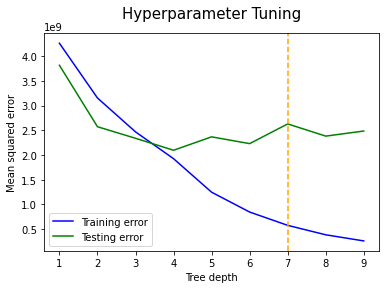

In [109]:
# Plotting
max_depths = range(1, 10)
training_error = []
for max_depth in max_depths:
    model_1 = DecisionTreeRegressor(max_depth=max_depth)
    model_1.fit(x_trainsc, y_train)
    training_error.append(mse(y_train, model_1.predict(x_trainsc)))
    
testing_error = []
for max_depth in max_depths:
    model_2 = DecisionTreeRegressor(max_depth=max_depth)
    model_2.fit(x_trainsc, y_train)
    testing_error.append(mse(y_test, model_2.predict(x_testsc)))

plt.plot(max_depths, training_error, color='blue', label='Training error')
plt.plot(max_depths, testing_error, color='green', label='Testing error')
plt.xlabel('Tree depth')
plt.axvline(x=7, color='orange', linestyle='--')
plt.annotate('optimum = 7', xy=(7.5, 1.17), color='red')
plt.ylabel('Mean squared error')
plt.title('Hyperparameter Tuning', pad=15, size=15)
plt.legend()

In [110]:
## Hyperparameter tuning

# step-1: create a cross-validation scheme
folds = KFold(n_splits = 3, shuffle = True, random_state = 50)

# step-2: specify range of hyperparameters to tune

hyper_params = [{'criterion':['squared_error','friedman_mse','absolute_error','poisson'],
                 'max_features':['auto','sqrt','log2'],
                'random_state':[0,3,5,7,]}]



# step-3: perform grid search
# 3.1 specify model
dTree = DecisionTreeRegressor()

dTree.fit(x_trainsc, y_train)
            

# 3.2 call GridSearchCV()
model_cv = GridSearchCV(estimator = dTree,
                        param_grid = hyper_params, 
                        scoring= 'r2', 
                        cv = 3,
                        verbose=1,
                        return_train_score=True)
    

# fit the model
grid_result= model_cv.fit(x_trainsc, y_train)   
print('Best Score: ', grid_result.best_score_)

print('Best Params: ', grid_result.best_params_)

DecisionTreeRegressor()

Fitting 3 folds for each of 48 candidates, totalling 144 fits
Best Score:  0.5305462500905409
Best Params:  {'criterion': 'poisson', 'max_features': 'auto', 'random_state': 3}


In [111]:
dTree2 = DecisionTreeRegressor(criterion='poisson',  max_features='auto', random_state=3)
dTree2.fit(x_trainsc, y_train)
y_predict = dTree2.predict(x_testsc)

print("Decision Tree Model Train Score: ", dTree2.score(x_trainsc , y_train))

print("Decision Tree Model Test Score: ", dTree2.score(x_testsc , y_test))


print('Mean Absolute Error: \n', np.round(metrics.mean_absolute_error(y_test, y_predict),2)) 

print(" ")

print('Mean Squared Error: \n', np.round(metrics.mean_squared_error(y_test, y_predict),2))

print(" ")

print('Root Mean Squared Error: \n', np.round(np.sqrt(metrics.mean_squared_error(y_test, y_predict)),2))

print(" ")

y_pred = dTree2.predict(x_testsc)
r2 = sklearn.metrics.r2_score(y_test, y_pred)
print("R2= ",r2)

DecisionTreeRegressor(criterion='poisson', max_features='auto', random_state=3)

Decision Tree Model Train Score:  1.0
Decision Tree Model Test Score:  0.5945878812541459


<IPython.core.display.Javascript object>

Mean Absolute Error: 
 35055.05
 


<IPython.core.display.Javascript object>

Mean Squared Error: 
 2309027435.02
 


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Root Mean Squared Error: 
 48052.34
 


<IPython.core.display.Javascript object>

R2=  0.5945878812541459


### Random Forest Regressor

In [112]:
rf_model1= RandomForestRegressor()
rf_model1.fit(x_trainsc, y_train)
rf_model_predict = rf_model1.predict(x_testsc)

print("Random Forest Model Train Score: ", rf_model1.score(x_trainsc , y_train))

print("Random Forest Model Test Score: ", rf_model1.score(x_testsc , y_test))


print('Mean Absolute Error: \n', np.round(metrics.mean_absolute_error(y_test, rf_model_predict),2)) 

print(" ")

print('Mean Squared Error: \n', np.round(metrics.mean_squared_error(y_test, rf_model_predict),2))

print(" ")

print('Root Mean Squared Error: \n', np.round(np.sqrt(metrics.mean_squared_error(y_test, rf_model_predict)),2))

print(" ")

y_pred = rf_model1.predict(x_testsc)
r2 = sklearn.metrics.r2_score(y_test, y_pred)
print("R2= ",r2)

RandomForestRegressor()

Random Forest Model Train Score:  0.962632287311268
Random Forest Model Test Score:  0.7878250164257823


<IPython.core.display.Javascript object>

Mean Absolute Error: 
 23570.49
 


<IPython.core.display.Javascript object>

Mean Squared Error: 
 1208444038.66
 


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Root Mean Squared Error: 
 34762.68
 


<IPython.core.display.Javascript object>

R2=  0.7878250164257823


In [113]:
## Hyperparameter tuning

# step-1: create a cross-validation scheme
folds = KFold(n_splits = 3, shuffle = True, random_state = 25)

# step-2: specify range of hyperparameters to tune

hyper_params = [{'criterion':['squared_error','absolute_error','poisson'],
                'max_features':['log2','sqrt',None],
                'random_state':[1,3,5,7],}]



# step-3: perform grid search
# 3.1 specify model
rf = RandomForestRegressor()

rf.fit(x_trainsc, y_train)
            

# 3.2 call GridSearchCV()
model_cv = GridSearchCV(estimator = rf,
                        param_grid = hyper_params, 
                        scoring= 'r2', 
                        cv = 3,
                        verbose=1,
                        return_train_score=True)
    

# fit the model
grid_result= model_cv.fit(x_trainsc, y_train)   
print('Best Score: ', grid_result.best_score_)

print('Best Params: ', grid_result.best_params_)

RandomForestRegressor()

Fitting 3 folds for each of 36 candidates, totalling 108 fits
Best Score:  0.7543077051152217
Best Params:  {'criterion': 'absolute_error', 'max_features': 'sqrt', 'random_state': 3}


In [114]:
rf_model2= RandomForestRegressor( criterion='absolute_error', max_features= 'sqrt', random_state=3)
rf_model2.fit(x_trainsc, y_train)
rf_model_predict = rf_model2.predict(x_testsc)

print("Random Forest Model Train Score: ", rf_model2.score(x_trainsc , y_train))

print("Random Forest Model Test Score: ", rf_model2.score(x_testsc , y_test))


print('Mean Absolute Error: \n', np.round(metrics.mean_absolute_error(y_test, rf_model_predict),2)) 

print(" ")

print('Mean Squared Error: \n', np.round(metrics.mean_squared_error(y_test, rf_model_predict),2))

print(" ")

print('Root Mean Squared Error: \n', np.round(np.sqrt(metrics.mean_squared_error(y_test, rf_model_predict)),2))

print(" ")

y_pred = rf_model2.predict(x_testsc)
r2 = sklearn.metrics.r2_score(y_test, y_pred)
print("R2= ",r2)

RandomForestRegressor(criterion='absolute_error', max_features='sqrt',
                      random_state=3)

Random Forest Model Train Score:  0.9578300774830446
Random Forest Model Test Score:  0.7793143028810064


<IPython.core.display.Javascript object>

Mean Absolute Error: 
 23736.37
 


<IPython.core.display.Javascript object>

Mean Squared Error: 
 1256916864.6
 


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Root Mean Squared Error: 
 35453.02
 


<IPython.core.display.Javascript object>

R2=  0.7793143028810064


### Gradient Boosting Algorithm

In [115]:
gb_model1= GradientBoostingRegressor()
gb_model1.fit(x_trainsc, y_train)
gb_model_predict = gb_model1.predict(x_testsc)

print("Gradient Boosting Model Train Score: ", gb_model1.score(x_trainsc , y_train))

print("Gradient Boosting Model Test Score: ", gb_model1.score(x_testsc , y_test))


print('Mean Absolute Error: \n', np.round(metrics.mean_absolute_error(y_test, gb_model_predict),2)) 

print(" ")

print('Mean Squared Error: \n', np.round(metrics.mean_squared_error(y_test, gb_model_predict),2))

print(" ")

print('Root Mean Squared Error: \n', np.round(np.sqrt(metrics.mean_squared_error(y_test, gb_model_predict)),2))

y_pred = gb_model1.predict(x_testsc)
r2 = sklearn.metrics.r2_score(y_test, y_pred)
print("R2= ",r2)

GradientBoostingRegressor()

Gradient Boosting Model Train Score:  0.9299098006127352
Gradient Boosting Model Test Score:  0.8086371900770324


<IPython.core.display.Javascript object>

Mean Absolute Error: 
 22974.11
 


<IPython.core.display.Javascript object>

Mean Squared Error: 
 1089908164.37
 


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Root Mean Squared Error: 
 33013.76


<IPython.core.display.Javascript object>

R2=  0.8086371900770324


In [116]:
# step-1: create a cross-validation scheme
folds = KFold(n_splits = 3, shuffle = True, random_state = 50)

# step-2: specify range of hyperparameters to tune

hyper_params = [{'loss':['squared_error','absolute_error','huber', 'quantile'],
                 'learning_rate': [0,0.1,1,3,5,7,10],
                'criterion':['friedman_mse','squared_error','mse']}]



# step-3: perform grid search
# 3.1 specify model
gb_model= GradientBoostingRegressor()

gb_model.fit(x_trainsc, y_train)
            

# 3.2 call GridSearchCV()
model_cv = GridSearchCV(estimator = gb_model,
                        param_grid = hyper_params, 
                        scoring= 'r2', 
                        cv = 3,
                        verbose=1,
                        return_train_score=True)
    

# fit the model
grid_result= model_cv.fit(x_trainsc, y_train)   
print('Best Score: ', grid_result.best_score_)

print('Best Params: ', grid_result.best_params_)

GradientBoostingRegressor()

Fitting 3 folds for each of 84 candidates, totalling 252 fits
Best Score:  0.7419578800723698
Best Params:  {'criterion': 'mse', 'learning_rate': 0.1, 'loss': 'huber'}


In [117]:
gb_model2= GradientBoostingRegressor( criterion= 'squared_error', learning_rate= 0.1, loss= 'huber')
gb_model2.fit(x_trainsc, y_train)
gb_model_predict = gb_model2.predict(x_testsc)

print("Gradient Boosting Model Train Score: ", gb_model2.score(x_trainsc , y_train))

print("Gradient Boosting Model Test Score: ", gb_model2.score(x_testsc , y_test))


print('Mean Absolute Error: \n', np.round(metrics.mean_absolute_error(y_test, gb_model_predict),2)) 

print(" ")

print('Mean Squared Error: \n', np.round(metrics.mean_squared_error(y_test, gb_model_predict),2))

print(" ")

print('Root Mean Squared Error: \n', np.round(np.sqrt(metrics.mean_squared_error(y_test, gb_model_predict)),2))

y_pred = gb_model2.predict(x_testsc)
r2 = sklearn.metrics.r2_score(y_test, y_pred)
print("R2= ",r2)

GradientBoostingRegressor(criterion='squared_error', loss='huber')

Gradient Boosting Model Train Score:  0.8804285968735319
Gradient Boosting Model Test Score:  0.8033198937730514


<IPython.core.display.Javascript object>

Mean Absolute Error: 
 23032.47
 


<IPython.core.display.Javascript object>

Mean Squared Error: 
 1120192861.05
 


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Root Mean Squared Error: 
 33469.28


<IPython.core.display.Javascript object>

R2=  0.8033198937730514


### Ada Boost Algorithm

In [118]:
adb_model1= AdaBoostRegressor()
adb_model1.fit(x_trainsc, y_train)
adb_model_predict = adb_model1.predict(x_testsc)

print("Ada  Boosting Model Train Score: ", adb_model1.score(x_trainsc , y_train))

print("Ada Boosting Model Test Score: ", adb_model1.score(x_testsc , y_test))


print('Mean Absolute Error: \n', np.round(metrics.mean_absolute_error(y_test, adb_model_predict),2)) 

print(" ")

print('Mean Squared Error: \n', np.round(metrics.mean_squared_error(y_test, adb_model_predict),2))

print(" ")

print('Root Mean Squared Error: \n', np.round(np.sqrt(metrics.mean_squared_error(y_test, adb_model_predict)),2))

y_pred = adb_model1.predict(x_testsc)
r2 = sklearn.metrics.r2_score(y_test, y_pred)
print("R2= ",r2)

AdaBoostRegressor()

Ada  Boosting Model Train Score:  0.7880947003318808
Ada Boosting Model Test Score:  0.664767267441203


<IPython.core.display.Javascript object>

Mean Absolute Error: 
 33811.51
 


<IPython.core.display.Javascript object>

Mean Squared Error: 
 1909320271.41
 


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Root Mean Squared Error: 
 43695.77


<IPython.core.display.Javascript object>

R2=  0.664767267441203


In [119]:
# step-1: create a cross-validation scheme
folds = KFold(n_splits =5, shuffle = True, random_state = 50)

# step-2: specify range of hyperparameters to tune

hyper_params = [{'loss':['linear', 'square', 'exponential'],
                 'learning_rate': [1,5,7,10],
                'random_state':[1,3,5,7]}]



# step-3: perform grid search
# 3.1 specify model
adb_model= AdaBoostRegressor()

adb_model.fit(x_trainsc, y_train)
            

# 3.2 call GridSearchCV()
model_cv = GridSearchCV(estimator = adb_model,
                        param_grid = hyper_params, 
                        scoring= 'r2', 
                        cv = 3,
                        verbose=1,
                        return_train_score=True)
    

# fit the model
grid_result= model_cv.fit(x_trainsc, y_train)   
print('Best Score: ', grid_result.best_score_)

print('Best Params: ', grid_result.best_params_)

AdaBoostRegressor()

Fitting 3 folds for each of 48 candidates, totalling 144 fits
Best Score:  0.6612581896456176
Best Params:  {'learning_rate': 1, 'loss': 'exponential', 'random_state': 3}


In [120]:
adb_model2= AdaBoostRegressor(learning_rate=1, loss='exponential', random_state=3)
adb_model2.fit(x_trainsc, y_train)
adb_model_predict = adb_model2.predict(x_testsc)

print("Ada  Boosting Model Train Score: ", adb_model2.score(x_trainsc , y_train))

print("Ada Boosting Model Test Score: ", adb_model2.score(x_testsc , y_test))


print('Mean Absolute Error: \n', np.round(metrics.mean_absolute_error(y_test, adb_model_predict),2)) 

print(" ")

print('Mean Squared Error: \n', np.round(metrics.mean_squared_error(y_test, adb_model_predict),2))

print(" ")

print('Root Mean Squared Error: \n', np.round(np.sqrt(metrics.mean_squared_error(y_test, adb_model_predict)),2))

y_pred = adb_model2.predict(x_testsc)
r2 = sklearn.metrics.r2_score(y_test, y_pred)
print("R2= ",r2)

AdaBoostRegressor(learning_rate=1, loss='exponential', random_state=3)

Ada  Boosting Model Train Score:  0.7836485817236131
Ada Boosting Model Test Score:  0.6773756976975297


<IPython.core.display.Javascript object>

Mean Absolute Error: 
 33248.84
 


<IPython.core.display.Javascript object>

Mean Squared Error: 
 1837508872.51
 


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Root Mean Squared Error: 
 42866.17


<IPython.core.display.Javascript object>

R2=  0.6773756976975297


In [121]:
# Save the trained regression model as a pickle string.
saved_model = pickle.dumps(gb_model1)

In [122]:
Predicted_Price = gb_model1.predict(data_test2)
Predicted_Price

array([176883.70056957, 150109.42910437, 209343.93927816, 130165.99999528,
       154262.70184   , 112131.93087522, 129696.52253605, 150376.62711577,
       145473.02649356, 168164.16701221, 121189.44834264, 166769.21680086,
       120995.74531632, 174810.92146128, 175737.53305006, 142646.09887901,
       130760.25122314, 117613.19944866, 113982.49595953, 164808.52818784,
       122714.50033155, 155756.07038814, 155728.17392858, 112155.34943799,
       132070.94708108, 153008.37005844, 133817.98501065, 177211.12403226,
       164581.38055725, 144045.31050387, 118417.7136768 , 121063.6497833 ,
       173030.31636316, 153787.82280978, 135818.80719754, 137571.92477986,
       173377.72107067, 130940.34733131, 188215.22480699, 146380.24077448,
       130760.25122314, 173778.15873565, 148209.77668573, 139728.91527278,
       111026.85922121, 142556.30204142, 137961.9070456 , 112587.59346318,
       175294.06655901, 252456.4560467 , 142734.03418167, 188161.01452421,
       124019.33174047, 1

<Figure size 720x360 with 0 Axes>

Text(0.5, 0, 'Actual')

Text(0, 0.5, 'Predicted')

Text(0.5, 1.0, 'GradientBoostingRegressor()')

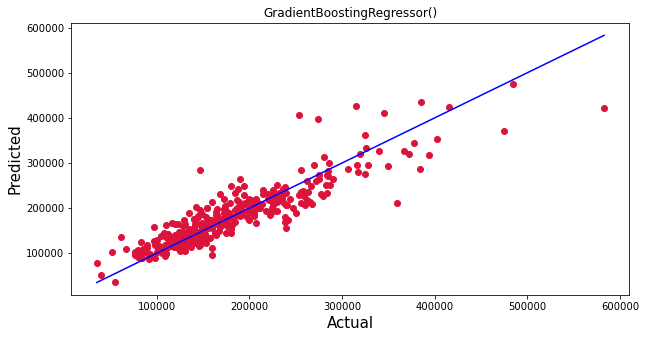

In [131]:
#Prediction
prediction_plt = gb_model1.predict(x_testsc)
plt.figure(figsize=(10,5))
plt.scatter(y_test, prediction_plt, c='crimson')
p1 = max(max(prediction_plt), max(y_test))
p2 = min(min(prediction_plt), min(y_test))
plt.plot([p1, p2], [p1, p2], 'b-')
plt.xlabel('Actual', fontsize=15)
plt.ylabel('Predicted', fontsize=15)
plt.title(gb_model1)
plt.show()

In [123]:
Prediction = pd.DataFrame()
Prediction['Price'] = Predicted_Price
Prediction

<IPython.core.display.Javascript object>

,Price
0,176883.700570
1,150109.429104
2,209343.939278
3,130165.999995
4,154262.701840
...,...
287,172694.335658
288,117613.199449
289,161843.183202
290,165230.715606


## Conclusion:

The important variables impacting the sales are :
'MSZoning', 'LotShape', 'LandContour', 'Utilities', 'LotConfig', 'Neighborhood', 'Condition1', 'BldgType', 'HouseStyle', 'RoofStyle', 'RoofMatl', 'Exterior1st', 'Exterior2nd', 'MasVnrType', 'ExterQual', 'ExterCond', 'Foundation', 'BsmtQual', 'BsmtCond', 'BsmtExposure','BsmtFinType1', 'BsmtFinType2', 'Heating', 'HeatingQC', 'CentralAir', 'Electrical', 'KitchenQual', 'Functional', 'FireplaceQu', 'GarageType', 'GarageFinish', 'GarageQual', 'GarageCond', 'PavedDrive', 'SaleType',
'SaleCondition', 'MSSubClass', 'LotFrontage', 'LotArea', 'OverallCond', 'MasVnrArea', 'BsmtFinSF2', 'LowQualFinSF', 'BsmtHalfBath', 'KitchenAbvGr', 'Fireplaces', 'WoodDeckSF', 'OpenPorchSF', 'EnclosedPorch', '3SsnPorch', 'ScreenPorch', 'PoolArea', 'MiscVal', 'MoSold', 'YrSold', 'SalePrice'

The above gradient boosting alorithm is used to predict the Sales Price.